In [1]:
import torch
from torchvision import datasets, transforms
from torch.utils.data import DataLoader
import matplotlib.pyplot as plt

import numpy as np

from models.MLPGAN import GAN as MLPGAN
from models.DCGAN import GAN as DCGAN
from models.D2GAN import GAN as D2GAN
from models.DropoutGAN import GAN as DropoutGAN
from models.D2DropoutGAN import GAN as D2DropoutGAN

from definitions import create_grid, GANScore
from classifier.cifar10 import get_classifier as get_classifier_cifar
from classifier.mnist import train_classifier as train_classifier_mnist, get_classifier as get_classifier_mnist

In [2]:
transform = transforms.Compose([
    transforms.Resize(32),
    transforms.ToTensor(),
    transforms.Normalize(mean=0.5, std=0.5),
    transforms.Lambda(lambda x: torch.flatten(x)),

])

score_transform = transforms.Compose([
        transforms.Lambda(lambda x: (x + 1) / 2),
        transforms.Normalize(mean=0.5, std=0.5)
])

plt.gray()
dataset = datasets.MNIST(root="./data", download=True, transform=transform)
data_loader = DataLoader(dataset=dataset, batch_size=64, shuffle=True, drop_last=True)
#classifier = train_classifier_mnist(data_loader, 10, 'cuda')
#torch.save(classifier, 'classifier/mnist_classifier.pt')
classifier = get_classifier_mnist()

img_shape = (1, 32, 32)

<Figure size 640x480 with 0 Axes>

In [ ]:
score_transform = transforms.Compose([
        transforms.Lambda(lambda x: (x + 1) / 2),
        transforms.Normalize( mean=[0.4914, 0.4822, 0.4465],
                            std = [0.2471, 0.2435, 0.2616])
])

transform = transforms.Compose([
    transforms.ToTensor(),
    transforms.Normalize(mean=0.5, std=0.5),
    transforms.Lambda(lambda x: torch.flatten(x)),

])

dataset = datasets.CIFAR10(root="./data", download=True, transform=transform)
data_loader = DataLoader(dataset=dataset, batch_size=64, shuffle=True, drop_last=True)
classifier = get_classifier_cifar()

img_shape = (3, 32, 32)

In [3]:
#gan = MLPGAN((1, 28, 28))
#gan = DCGAN((1, 28, 28)).to('cuda')

#gan = D2GAN(img_shape)
#gan = DropoutGAN((1, 28, 28), 5, 0.5)
gan = D2DropoutGAN(img_shape, 5, 0.5)

In [4]:
gan_score = GANScore()
runs = 100

gan_score.calc_marginal_dataset(dataset)

In [5]:
z = torch.from_numpy(np.random.uniform(-1, 1, size=(runs, 5, gan.generator.input_length))).float()
file = open('stats.csv', 'w')
file.write('epoch,gen_loss,disc_loss,inception,mode\n')

40

epoch 0:
batch 0 gen loss: -0.4774779677391052, discr loss: 7.511960983276367


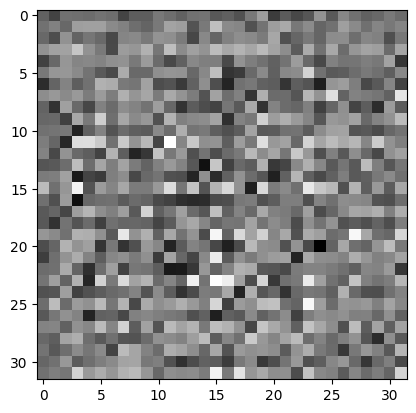

batch 100 gen loss: 0.5516263842582703, discr loss: -1.654569149017334


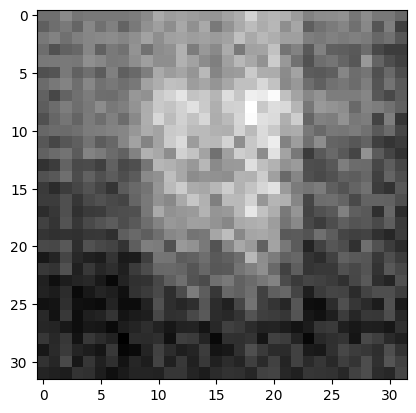

batch 200 gen loss: 0.5097917914390564, discr loss: -0.7301346063613892


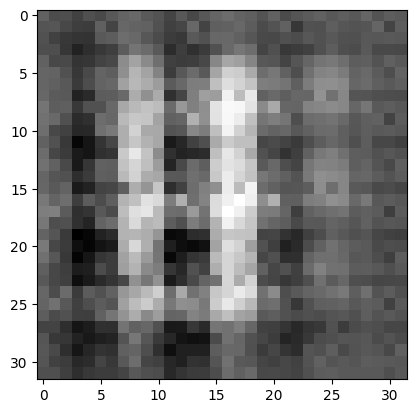

batch 300 gen loss: 0.24838119745254517, discr loss: 2.6521100997924805


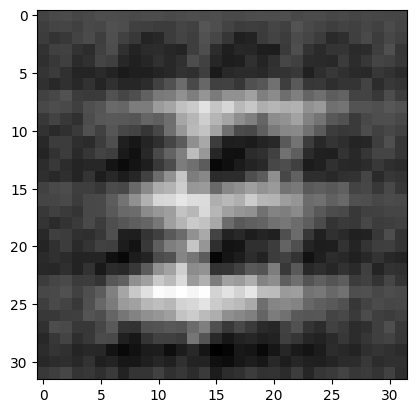

batch 400 gen loss: 0.551382839679718, discr loss: -3.254016876220703


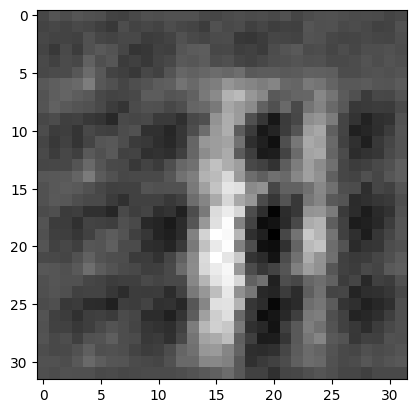

batch 500 gen loss: 0.0032027103006839752, discr loss: -0.7142626643180847


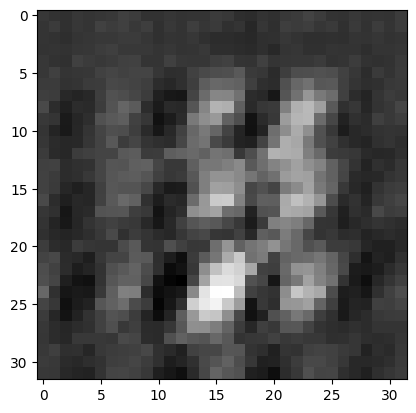

batch 600 gen loss: -0.20164264738559723, discr loss: 2.9749181270599365


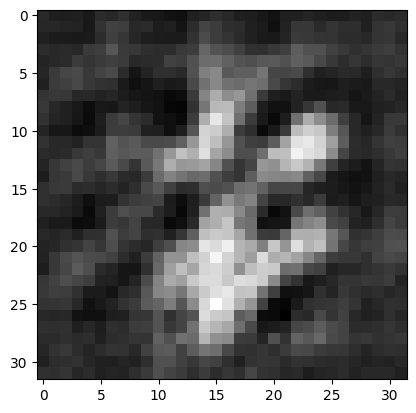

batch 700 gen loss: -0.06791791319847107, discr loss: 5.389767646789551


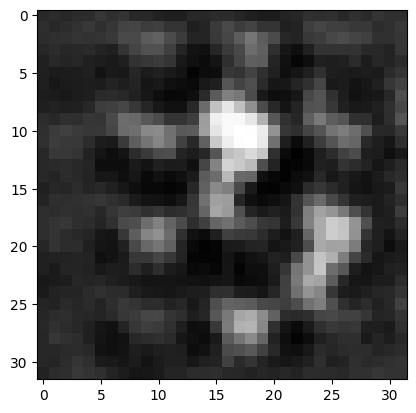

batch 800 gen loss: -0.44156643748283386, discr loss: 2.6031336784362793


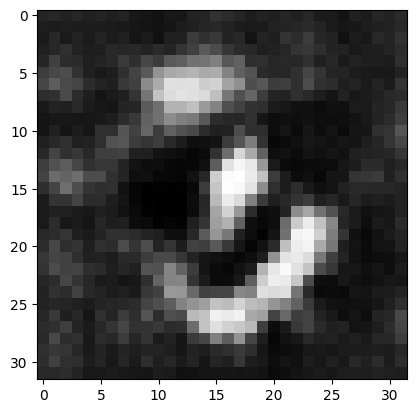

batch 900 gen loss: 0.005528546869754791, discr loss: -0.595912754535675


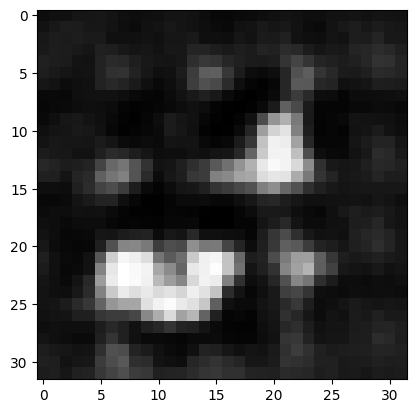

/home/daniel/.local/lib/python3.10/site-packages/torch/nn/modules/container.py:139: UserWarning: Implicit dimension choice for softmax has been deprecated. Change the call to include dim=X as an argument.
  input = module(input)


168.20045471191406 147.36508178710938


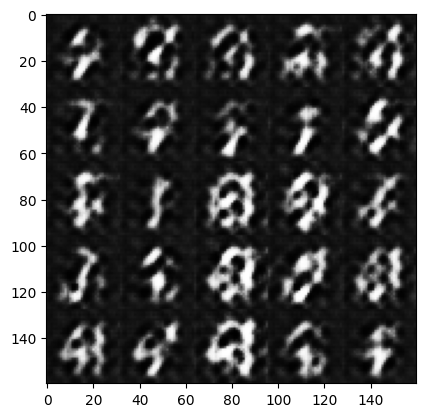

epoch 1:
batch 0 gen loss: 0.05607891082763672, discr loss: 1.6710565090179443


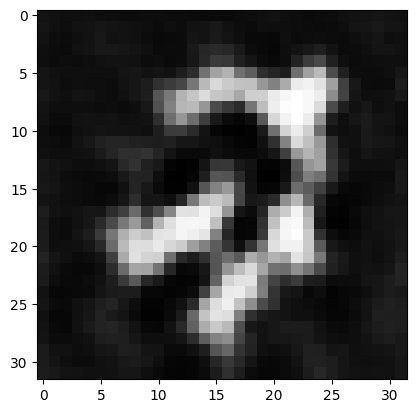

batch 100 gen loss: -0.4535011053085327, discr loss: 1.5046430826187134


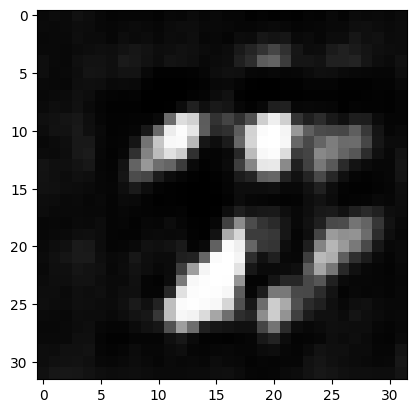

batch 200 gen loss: -0.50441575050354, discr loss: 2.8021838665008545


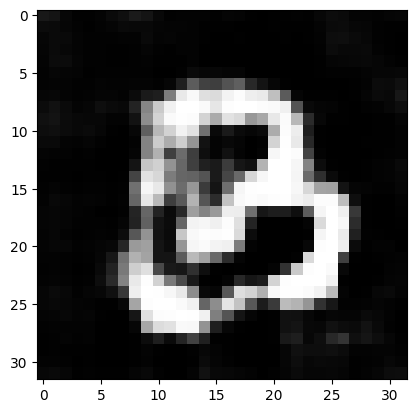

batch 300 gen loss: -0.5296459794044495, discr loss: 3.750828504562378


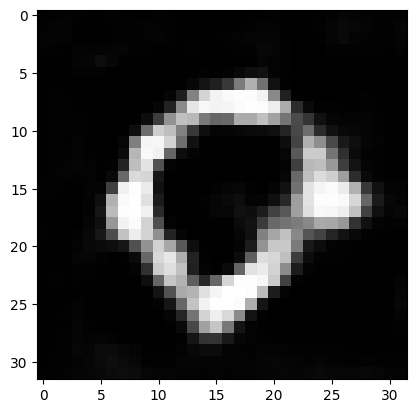

batch 400 gen loss: -0.5579222440719604, discr loss: 3.1423304080963135


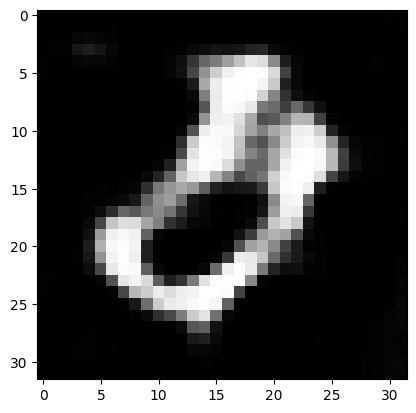

batch 500 gen loss: -0.5574164986610413, discr loss: 2.718749761581421


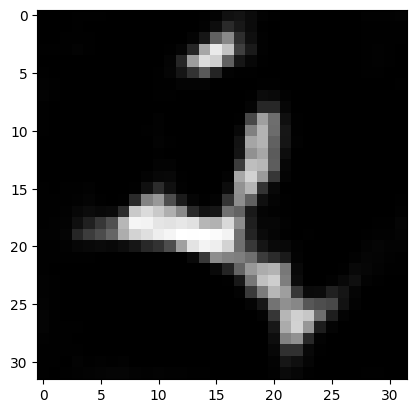

batch 600 gen loss: -0.12965065240859985, discr loss: 2.7685296535491943


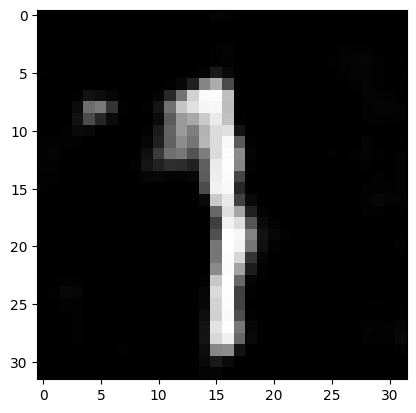

batch 700 gen loss: -0.47938430309295654, discr loss: 2.583544969558716


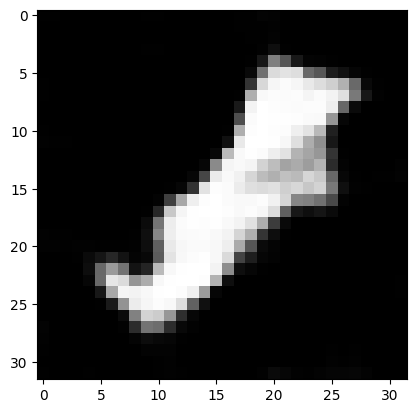

batch 800 gen loss: -0.8822836875915527, discr loss: 2.271496295928955


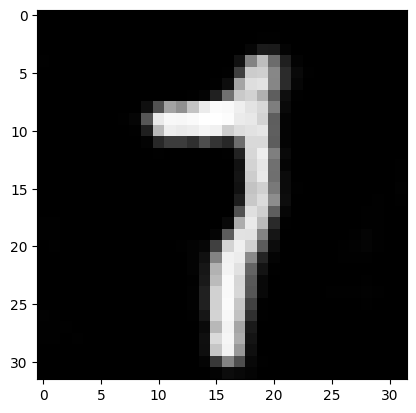

batch 900 gen loss: -0.7973427772521973, discr loss: 3.1103765964508057


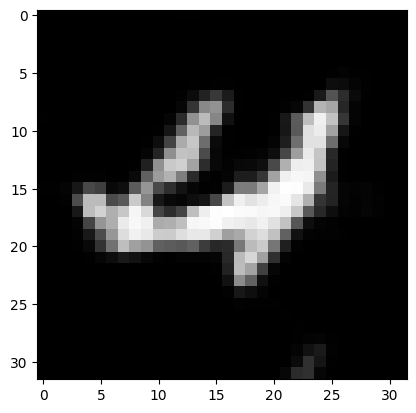

-469.7881164550781 2582.652587890625


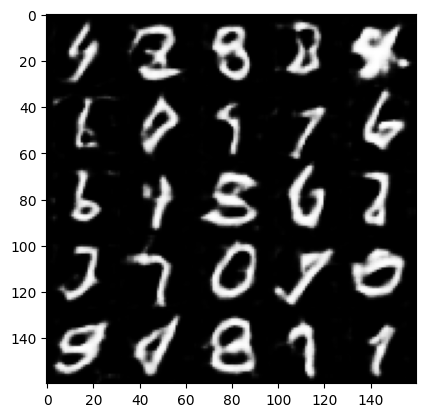

epoch 2:
batch 0 gen loss: -0.9321112036705017, discr loss: 2.8437318801879883


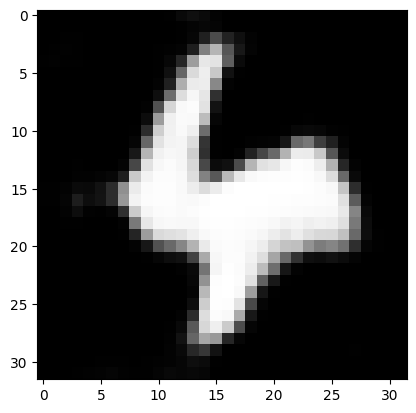

batch 100 gen loss: -0.4297528862953186, discr loss: 2.7838447093963623


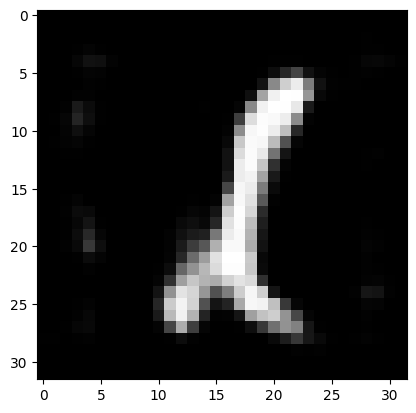

batch 200 gen loss: -0.31820768117904663, discr loss: 2.3416171073913574


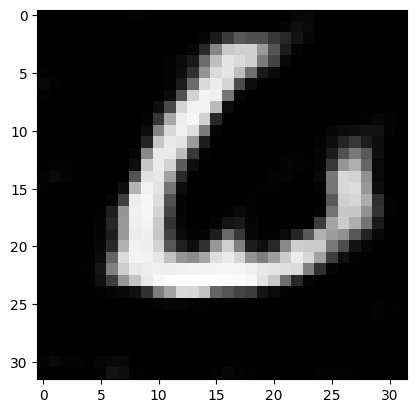

batch 300 gen loss: -0.5102285146713257, discr loss: 2.6299326419830322


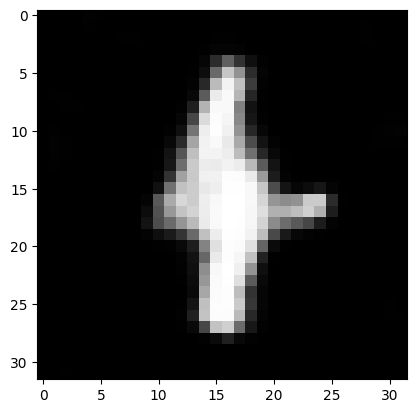

batch 400 gen loss: -0.39850398898124695, discr loss: 1.8121554851531982


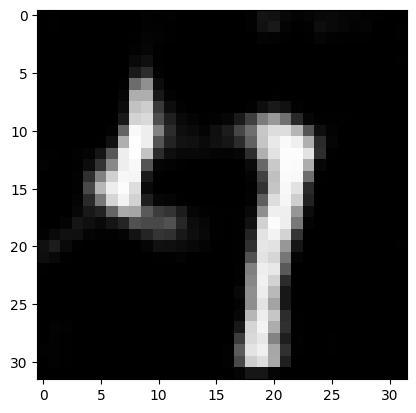

batch 500 gen loss: -0.5980819463729858, discr loss: 1.054465651512146


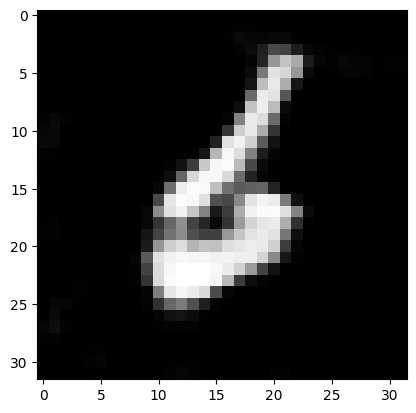

batch 600 gen loss: -0.035321637988090515, discr loss: 4.654336452484131


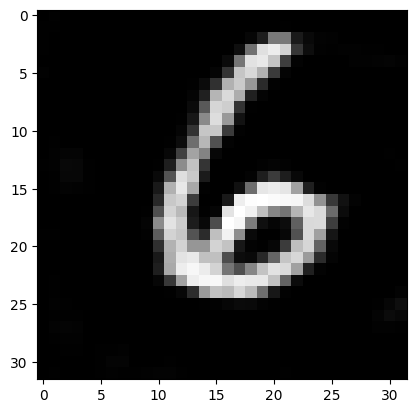

batch 700 gen loss: -0.18195664882659912, discr loss: 2.1290268898010254


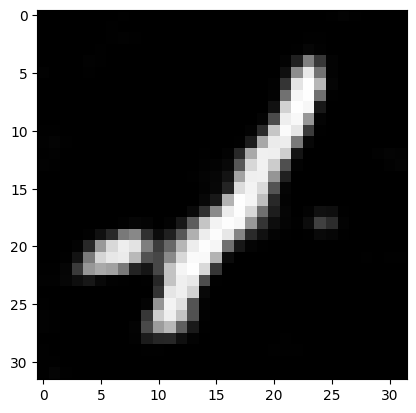

batch 800 gen loss: -0.5941826105117798, discr loss: 2.323272943496704


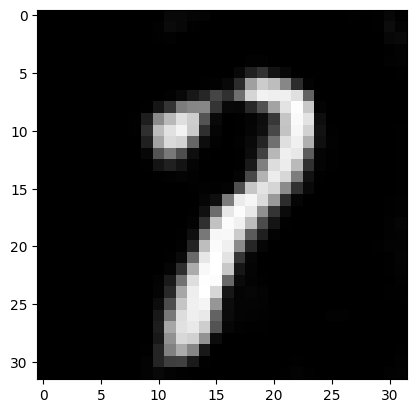

batch 900 gen loss: -0.39473840594291687, discr loss: 2.404569625854492


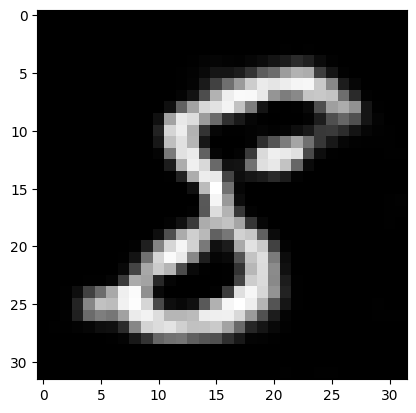

-570.962890625 2716.59423828125


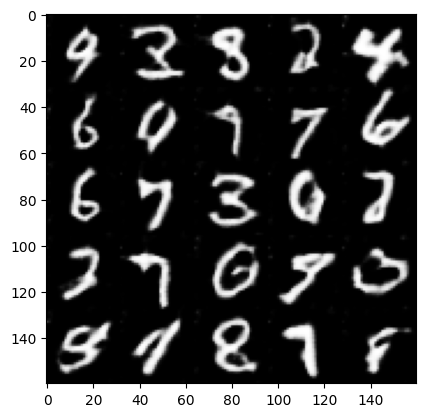

epoch 3:
batch 0 gen loss: -0.26152774691581726, discr loss: 1.276983618736267


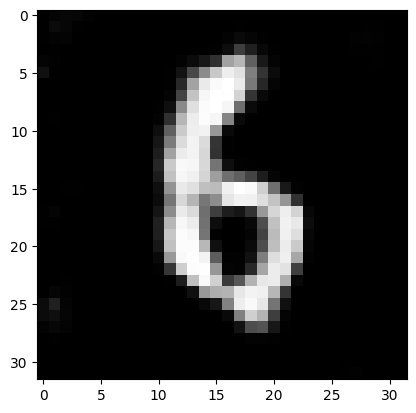

batch 100 gen loss: -0.4853556752204895, discr loss: 4.388449668884277


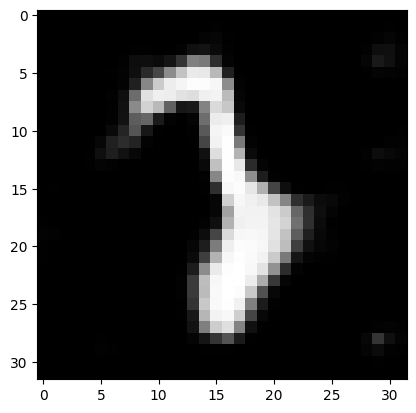

batch 200 gen loss: -0.29727819561958313, discr loss: 1.135565996170044


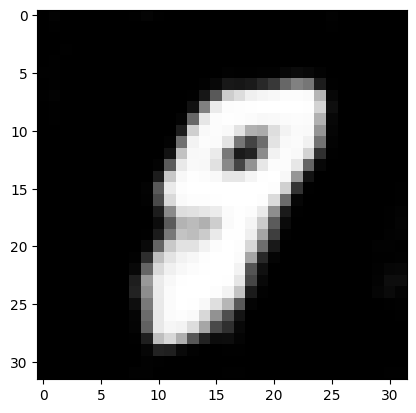

batch 300 gen loss: 0.03590608015656471, discr loss: -0.12742555141448975


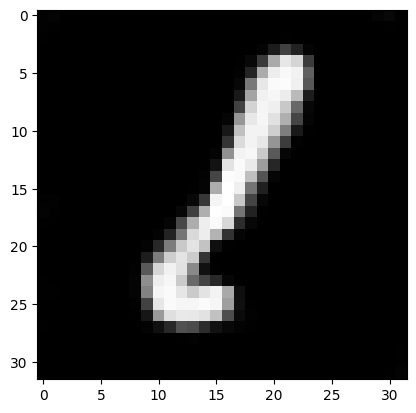

batch 400 gen loss: -1.055509328842163, discr loss: 2.79211163520813


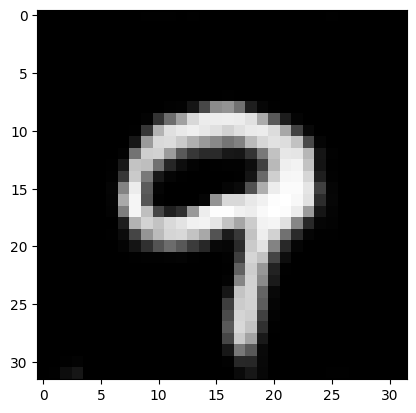

batch 500 gen loss: -1.4697169065475464, discr loss: 3.6594693660736084


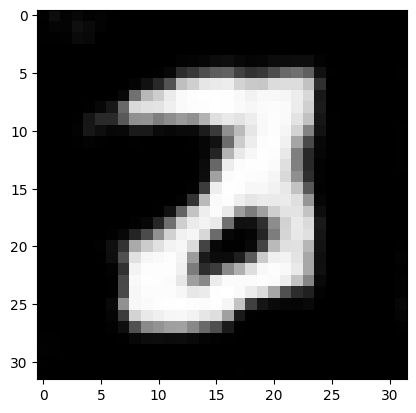

batch 600 gen loss: -0.014603838324546814, discr loss: 1.635389804840088


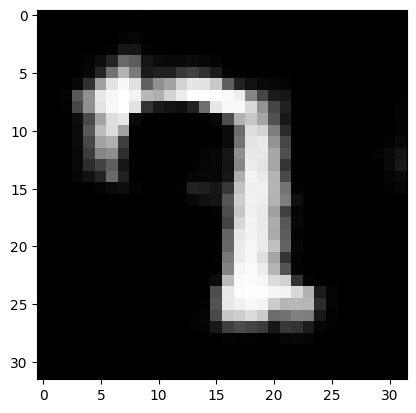

batch 700 gen loss: -0.10381191968917847, discr loss: 0.739940881729126


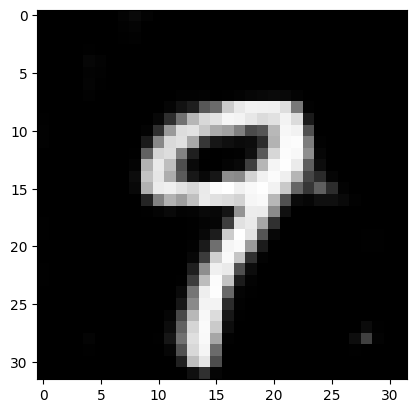

batch 800 gen loss: -0.5565065741539001, discr loss: 0.05101895332336426


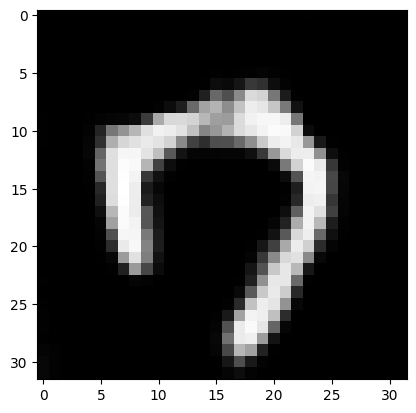

batch 900 gen loss: -1.16422700881958, discr loss: 3.717984437942505


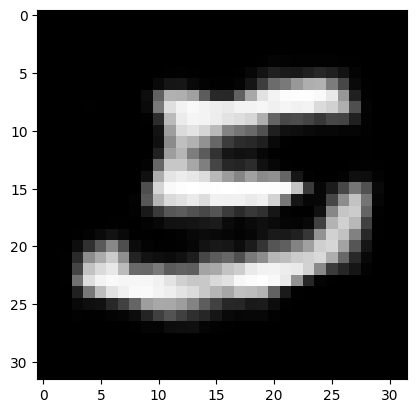

-403.87353515625 1558.0816650390625


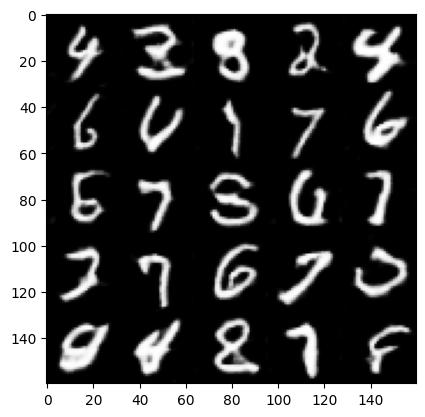

epoch 4:
batch 0 gen loss: -0.42168551683425903, discr loss: 0.9275221824645996


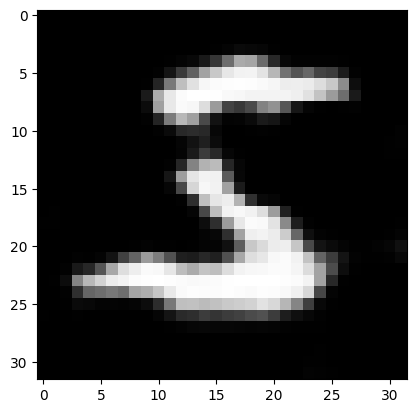

batch 100 gen loss: -0.8620388507843018, discr loss: 1.6812832355499268


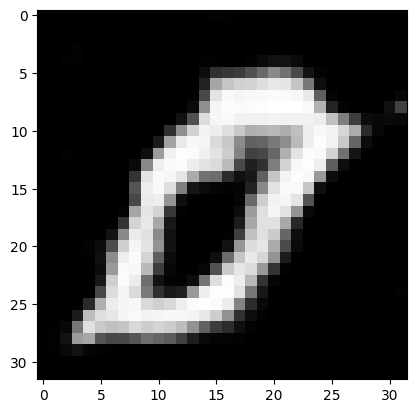

batch 200 gen loss: 0.21889685094356537, discr loss: -0.035501301288604736


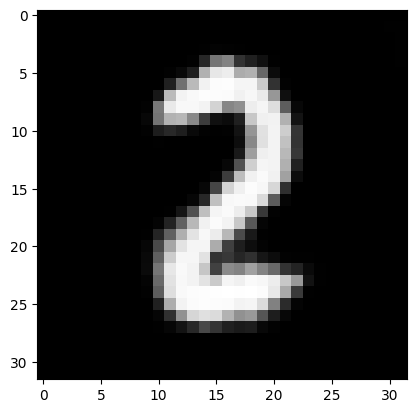

batch 300 gen loss: -0.17637981474399567, discr loss: -0.430635005235672


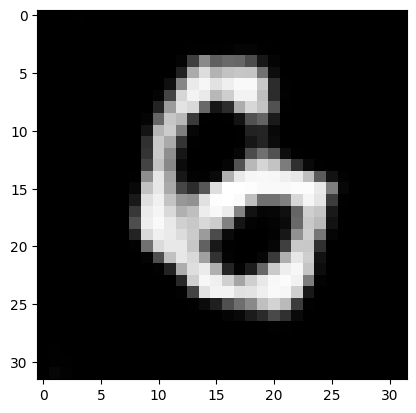

batch 400 gen loss: -0.8528086543083191, discr loss: 0.3740631341934204


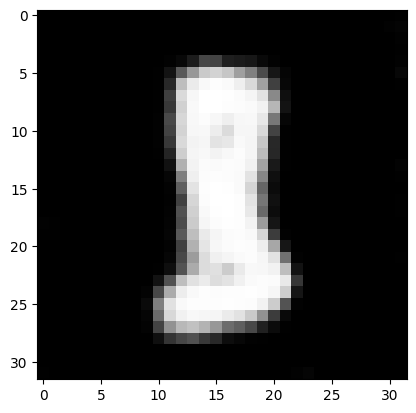

batch 500 gen loss: 0.1520053893327713, discr loss: 0.2738214135169983


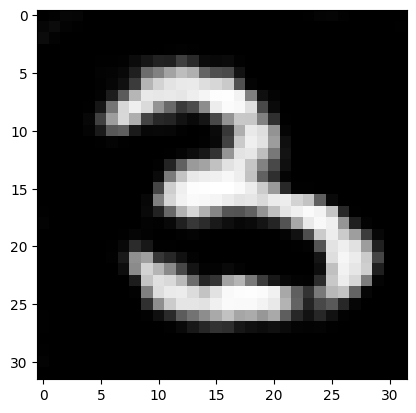

batch 600 gen loss: 0.19071929156780243, discr loss: -1.2845795154571533


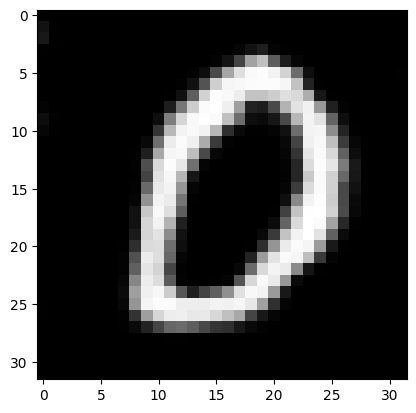

batch 700 gen loss: -0.16054387390613556, discr loss: -0.7709945440292358


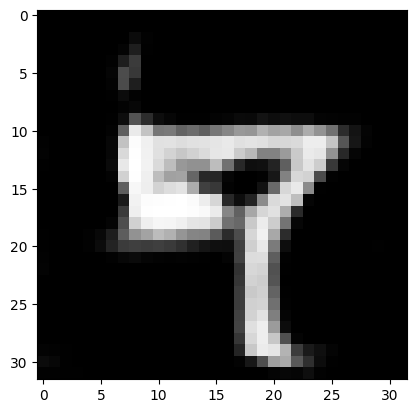

batch 800 gen loss: -1.2511796951293945, discr loss: 0.669538676738739


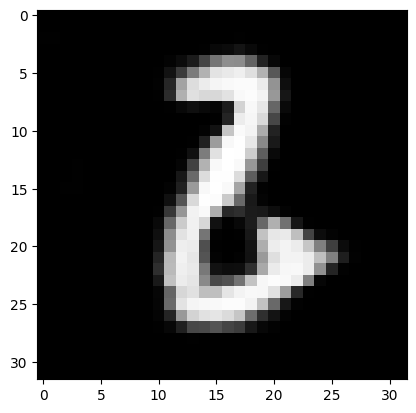

batch 900 gen loss: 0.048342108726501465, discr loss: 0.3942538797855377


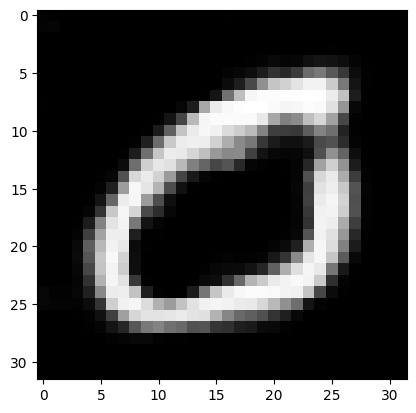

-252.09986877441406 -75.9223403930664


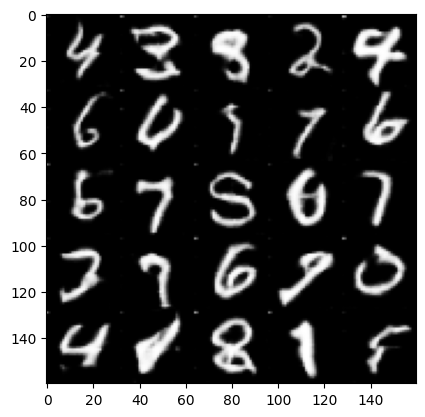

epoch 5:
batch 0 gen loss: 0.22033506631851196, discr loss: -1.9286404848098755


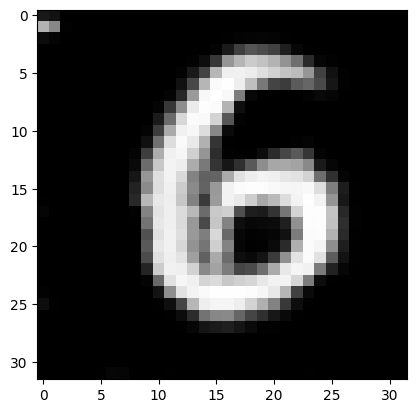

batch 100 gen loss: -0.4203382134437561, discr loss: -2.0730204582214355


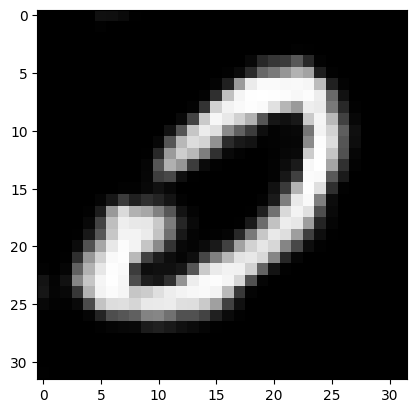

batch 200 gen loss: 0.15191960334777832, discr loss: -2.657313585281372


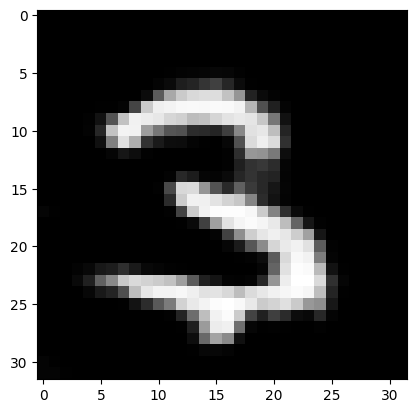

batch 300 gen loss: 0.3729217052459717, discr loss: -1.6482703685760498


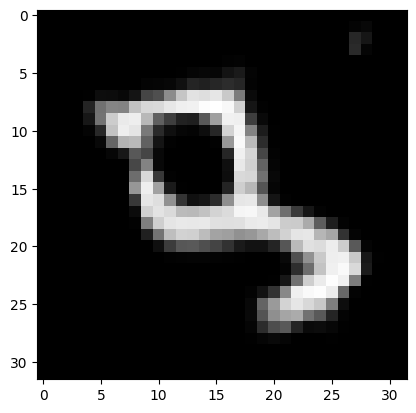

batch 400 gen loss: 0.0377831906080246, discr loss: -2.851557493209839


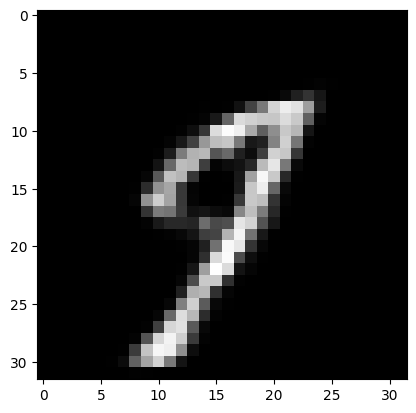

batch 500 gen loss: 0.1223887950181961, discr loss: -2.998612403869629


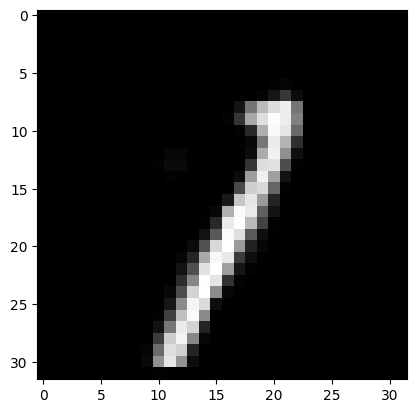

batch 600 gen loss: 0.2102285921573639, discr loss: -1.7097997665405273


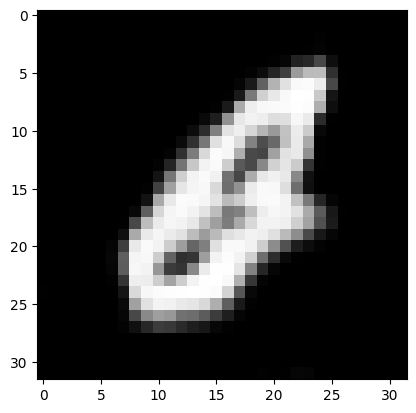

batch 700 gen loss: -0.5290989875793457, discr loss: 2.371055841445923


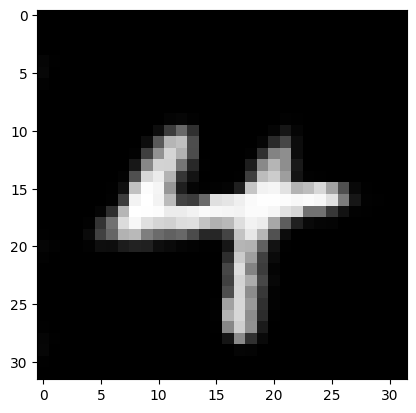

batch 800 gen loss: 0.34293052554130554, discr loss: 0.7535521984100342


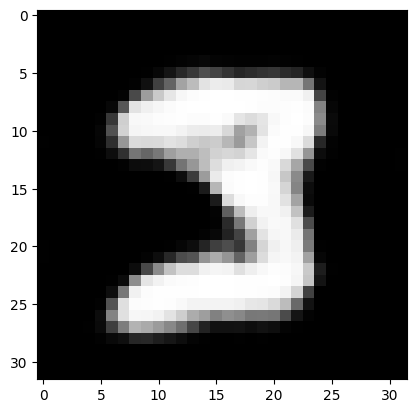

batch 900 gen loss: -0.022699221968650818, discr loss: 0.19848769903182983


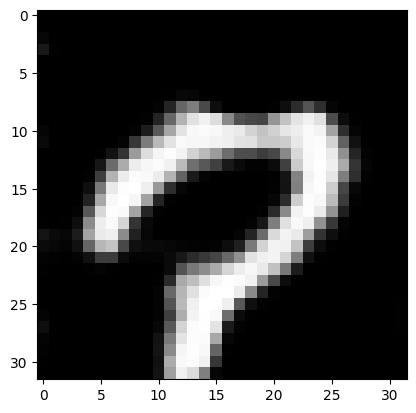

19.256845474243164 -1281.416259765625


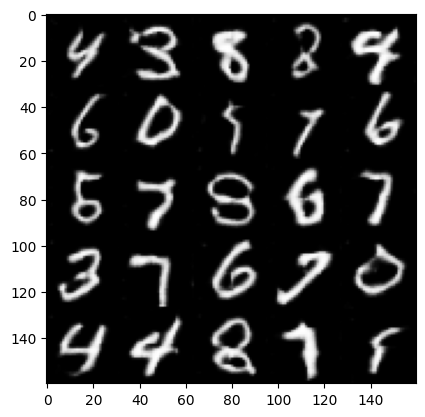

epoch 6:
batch 0 gen loss: -0.2894282341003418, discr loss: -1.0271836519241333


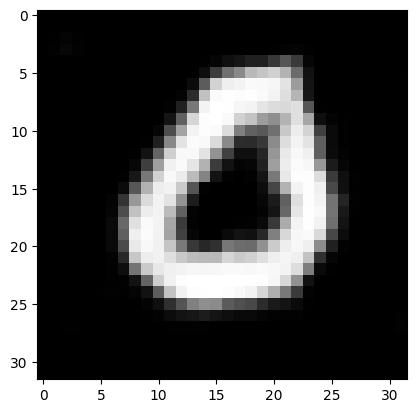

batch 100 gen loss: 0.3728265166282654, discr loss: -1.055112600326538


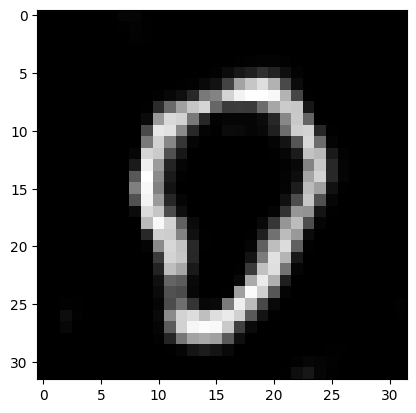

batch 200 gen loss: -0.7759333252906799, discr loss: -2.497472047805786


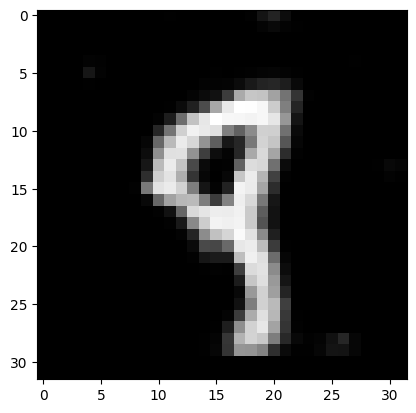

batch 300 gen loss: 0.016665443778038025, discr loss: -2.2138993740081787


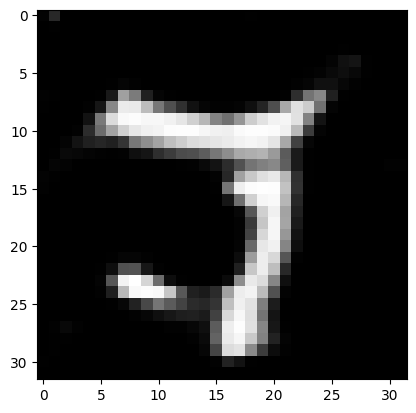

batch 400 gen loss: 0.47220978140830994, discr loss: -0.39737460017204285


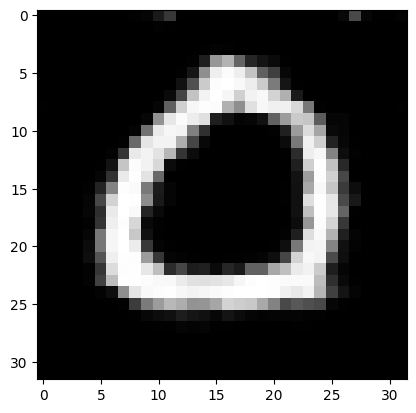

batch 500 gen loss: -0.516029953956604, discr loss: -0.6249414682388306


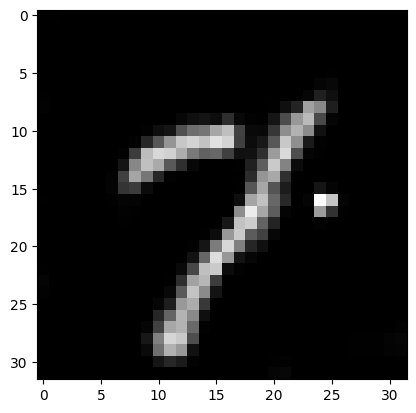

batch 600 gen loss: 0.5637704133987427, discr loss: -5.731466293334961


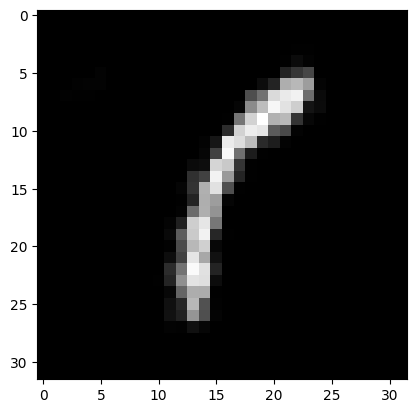

batch 700 gen loss: 1.161019206047058, discr loss: -4.12334680557251


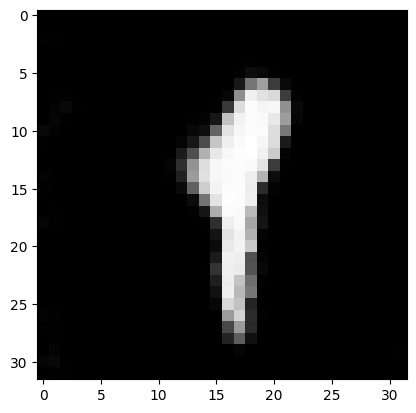

batch 800 gen loss: -0.29299771785736084, discr loss: -5.092452526092529


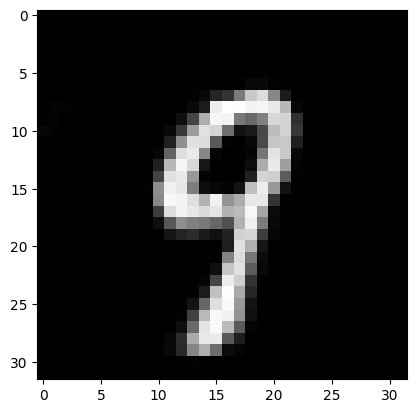

batch 900 gen loss: 0.195105642080307, discr loss: -2.9922261238098145


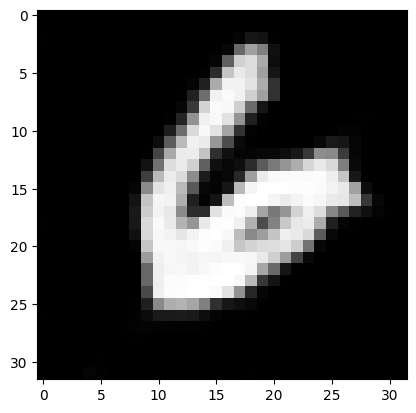

259.74676513671875 -2683.543701171875


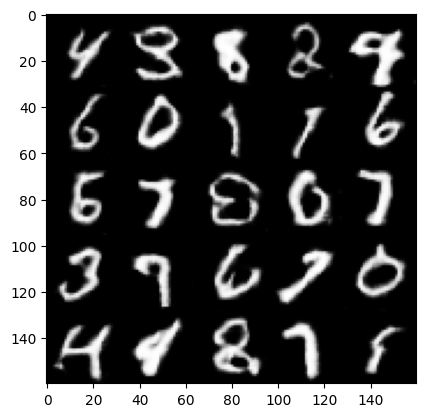

epoch 7:
batch 0 gen loss: -1.584389567375183, discr loss: 2.226512908935547


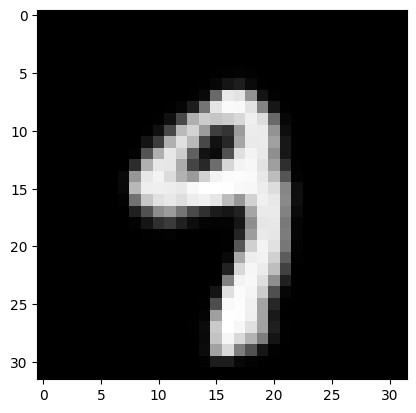

batch 100 gen loss: -2.8820700645446777, discr loss: 0.08864331245422363


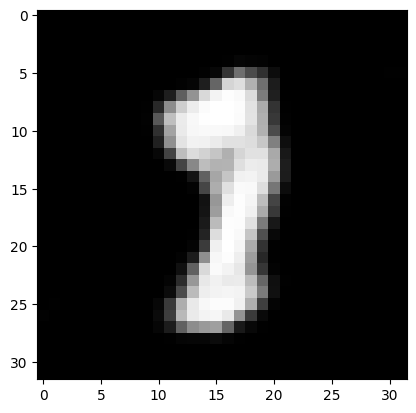

batch 200 gen loss: -0.0392242893576622, discr loss: -1.0724743604660034


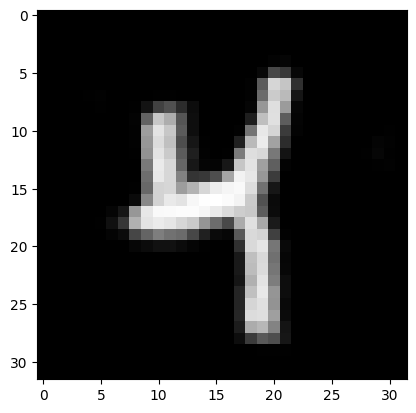

batch 300 gen loss: -0.07905393838882446, discr loss: -0.941886305809021


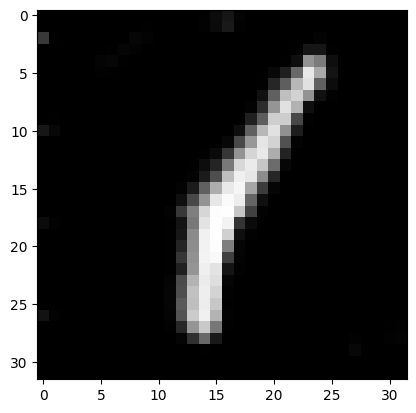

batch 400 gen loss: -0.7329329252243042, discr loss: -0.9371798038482666


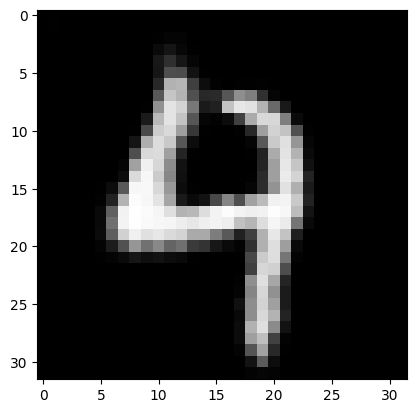

batch 500 gen loss: 0.4721206724643707, discr loss: -3.831087827682495


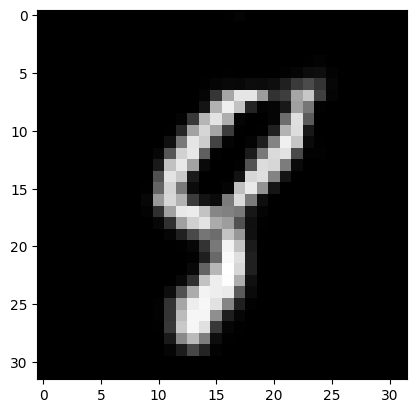

batch 600 gen loss: 0.2031668871641159, discr loss: -1.2904835939407349


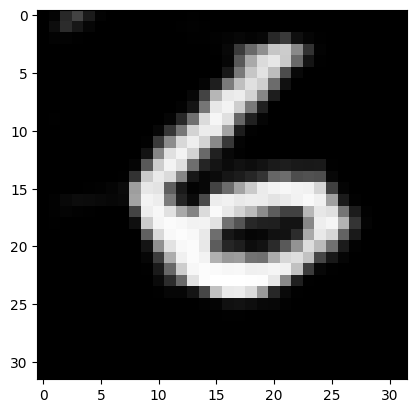

batch 700 gen loss: 0.8955393433570862, discr loss: -0.9397047758102417


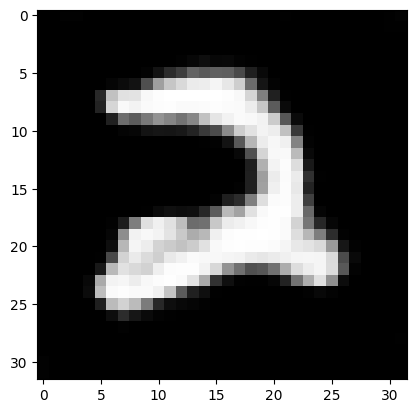

batch 800 gen loss: -1.1905912160873413, discr loss: -3.008531093597412


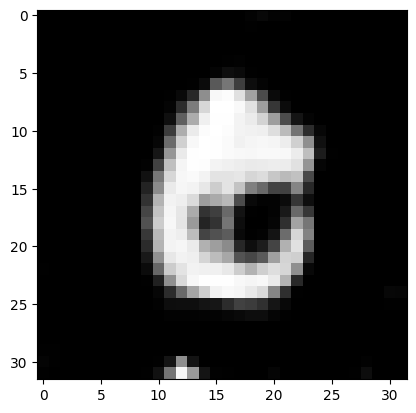

batch 900 gen loss: 0.3473816514015198, discr loss: -1.4965252876281738


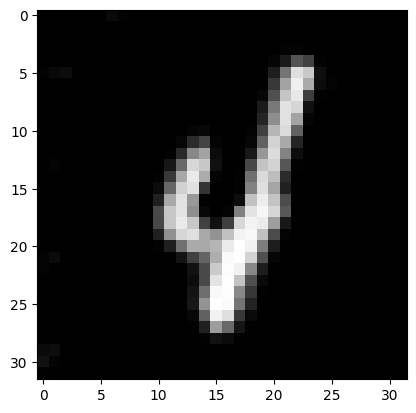

-82.49605560302734 -2056.472412109375


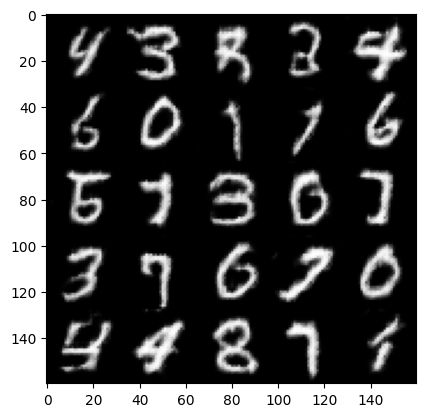

epoch 8:
batch 0 gen loss: -0.8703734874725342, discr loss: 3.1578917503356934


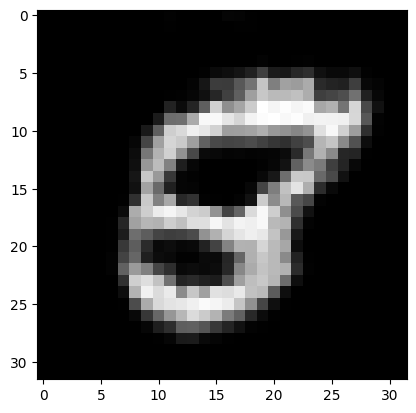

batch 100 gen loss: 1.490023136138916, discr loss: -5.200943946838379


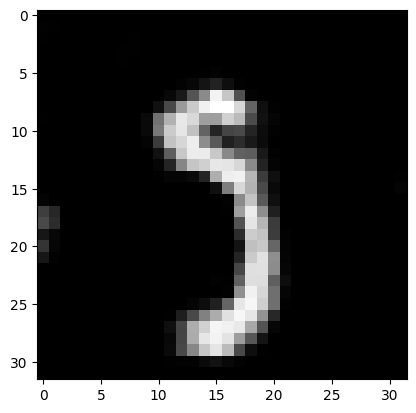

batch 200 gen loss: 0.637772798538208, discr loss: -1.2884712219238281


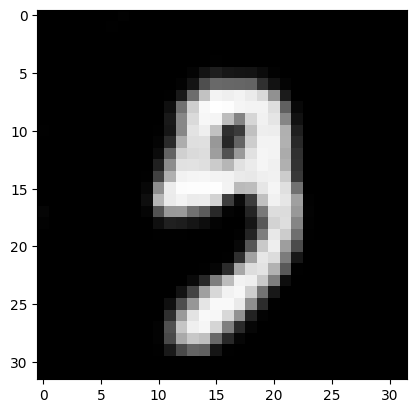

batch 300 gen loss: 0.23362654447555542, discr loss: -2.1618616580963135


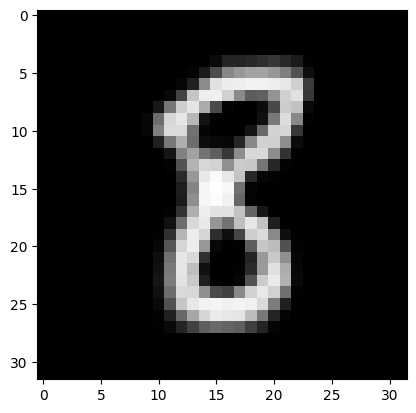

batch 400 gen loss: 0.8558887243270874, discr loss: -2.16821551322937


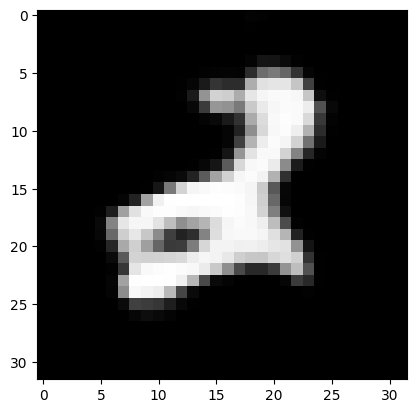

batch 500 gen loss: -0.0909661203622818, discr loss: -0.35656678676605225


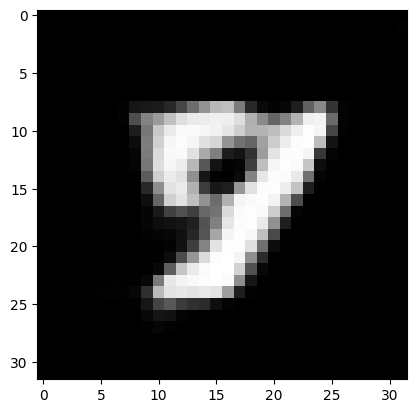

batch 600 gen loss: -0.2257426679134369, discr loss: -0.7895412445068359


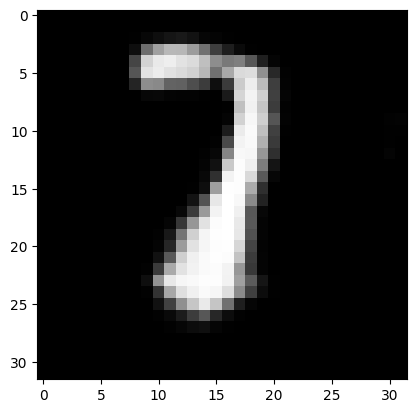

batch 700 gen loss: 0.7209393978118896, discr loss: -2.4749600887298584


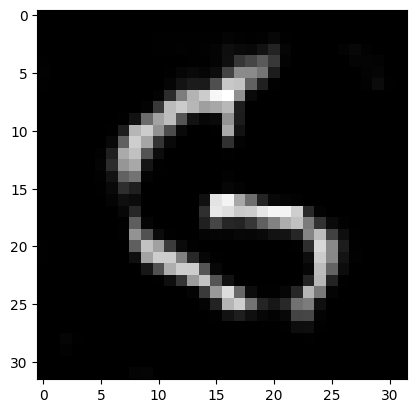

batch 800 gen loss: 0.620994508266449, discr loss: -2.976494789123535


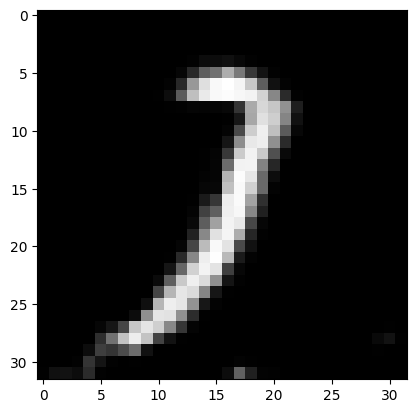

batch 900 gen loss: 0.724947452545166, discr loss: -5.585955619812012


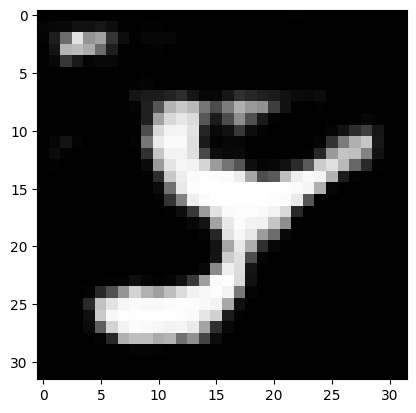

185.1700897216797 -2203.556640625


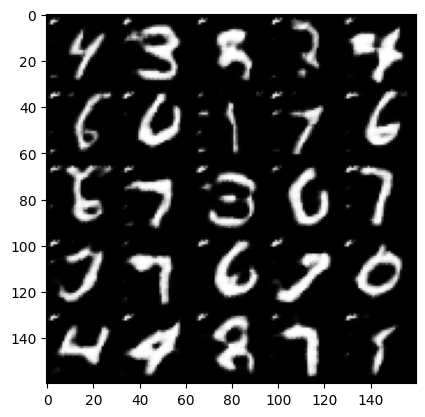

epoch 9:
batch 0 gen loss: 1.2376623153686523, discr loss: -6.421814918518066


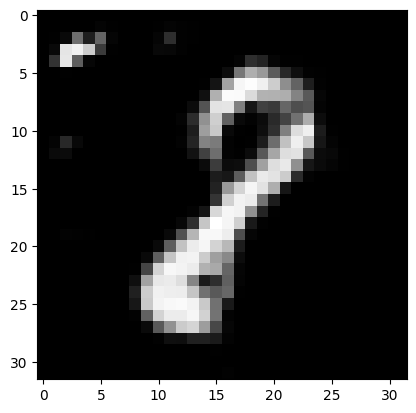

batch 100 gen loss: 0.7702332735061646, discr loss: -4.954632759094238


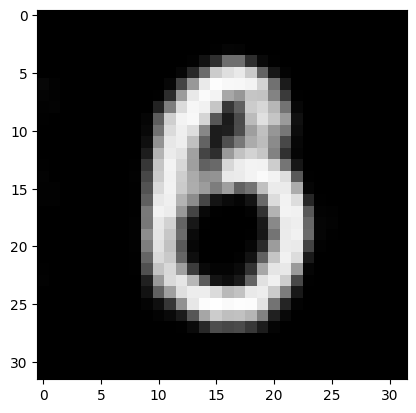

batch 200 gen loss: 0.001493401825428009, discr loss: -4.4657087326049805


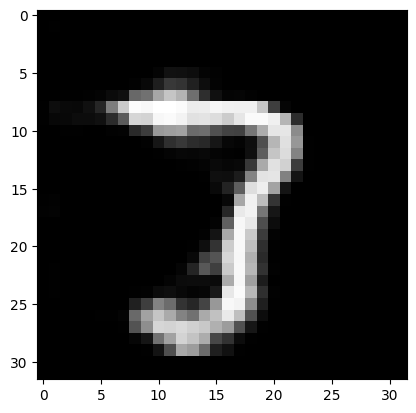

batch 300 gen loss: 0.6910256147384644, discr loss: -4.982831954956055


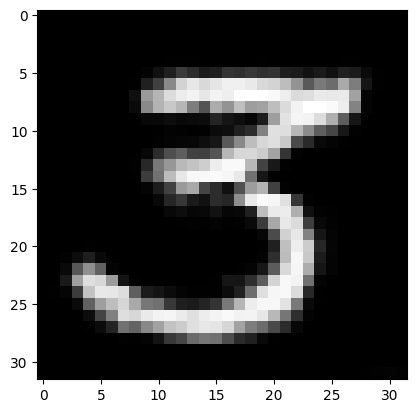

batch 400 gen loss: 0.6192721128463745, discr loss: -6.389344215393066


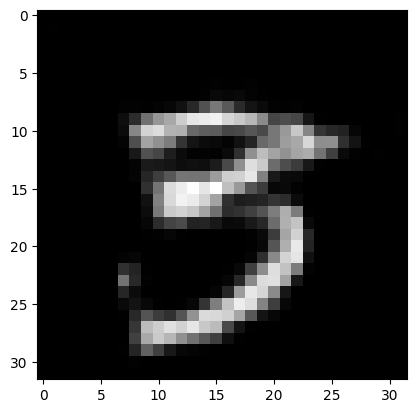

batch 500 gen loss: 0.5960491299629211, discr loss: -2.8846969604492188


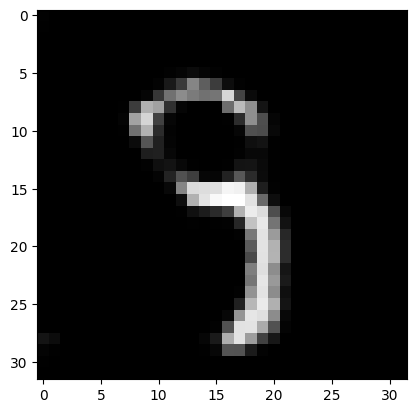

batch 600 gen loss: 0.40357762575149536, discr loss: -4.388077259063721


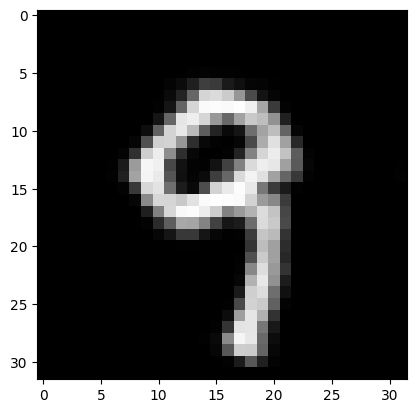

batch 700 gen loss: 0.3135533034801483, discr loss: 2.9924168586730957


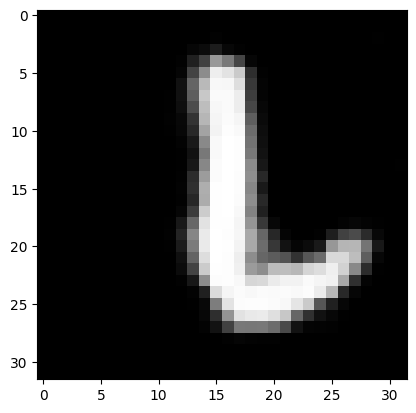

batch 800 gen loss: 0.45064854621887207, discr loss: 0.09234395623207092


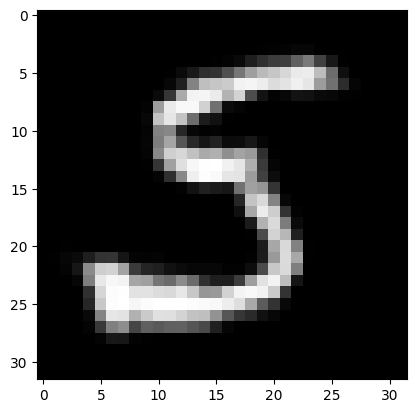

batch 900 gen loss: 0.5750135779380798, discr loss: -2.648710250854492


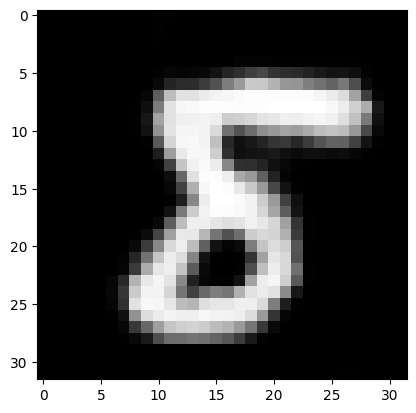

407.01617431640625 -3377.7080078125


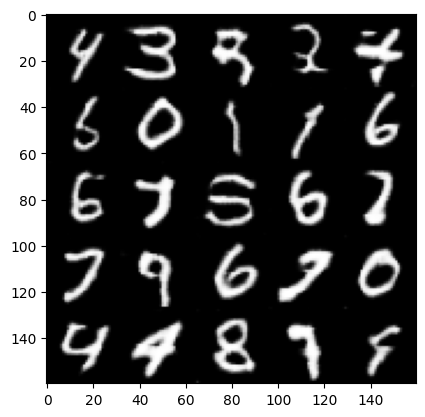

epoch 10:
batch 0 gen loss: 1.210946798324585, discr loss: -3.099872350692749


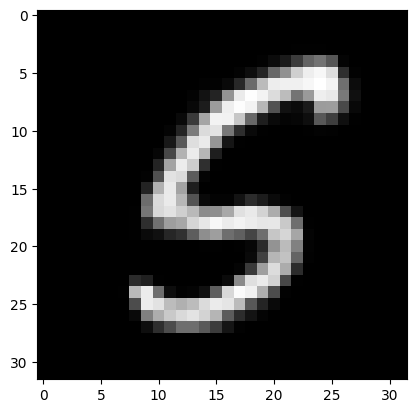

batch 100 gen loss: -0.11875024437904358, discr loss: -1.5482522249221802


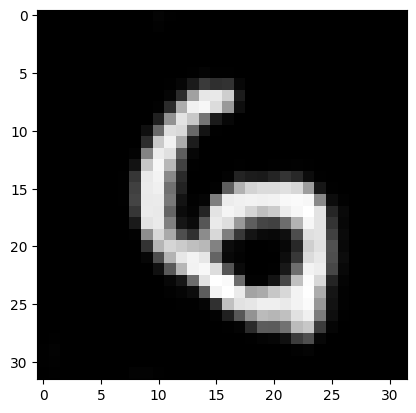

batch 200 gen loss: 0.7841091156005859, discr loss: -3.4011566638946533


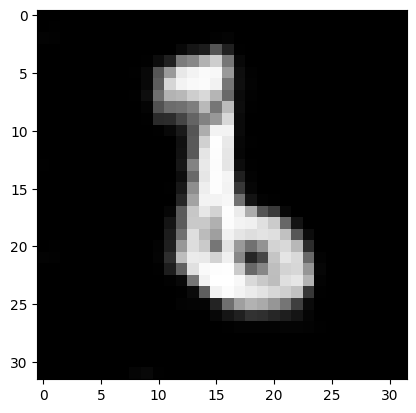

batch 300 gen loss: -1.0683051347732544, discr loss: -3.4900026321411133


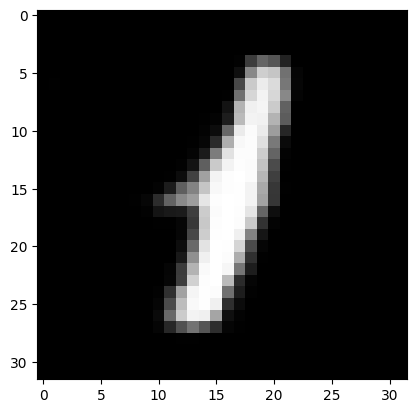

batch 400 gen loss: 1.1642603874206543, discr loss: -4.404665470123291


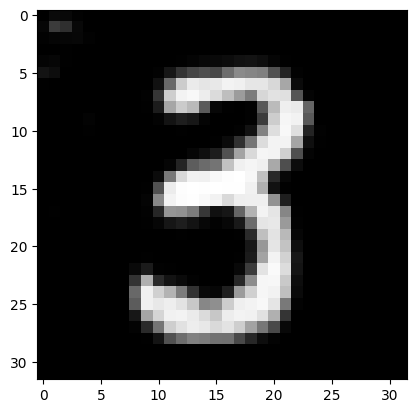

batch 500 gen loss: 0.6212579011917114, discr loss: -3.65537691116333


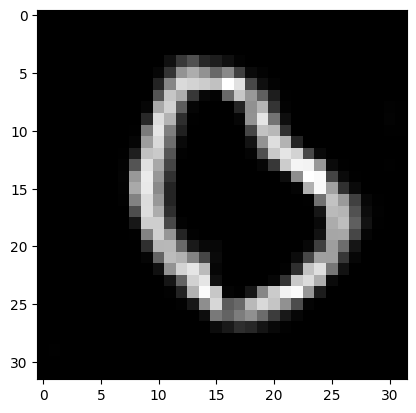

batch 600 gen loss: 0.2767173647880554, discr loss: -4.477545738220215


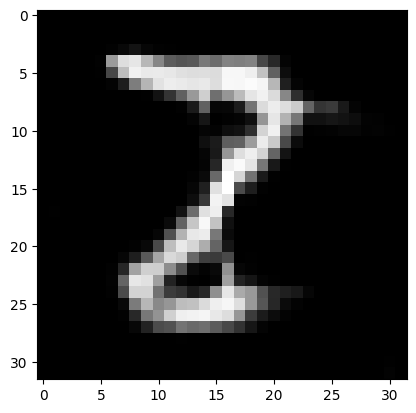

batch 700 gen loss: 0.3889942169189453, discr loss: -5.155219078063965


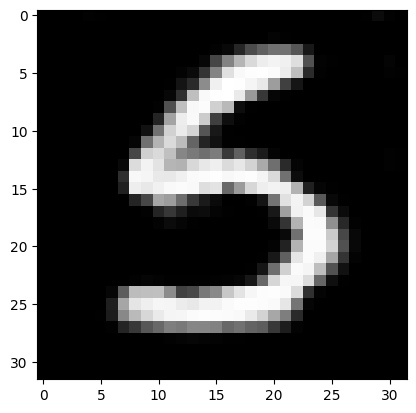

batch 800 gen loss: 0.562031090259552, discr loss: -5.430257797241211


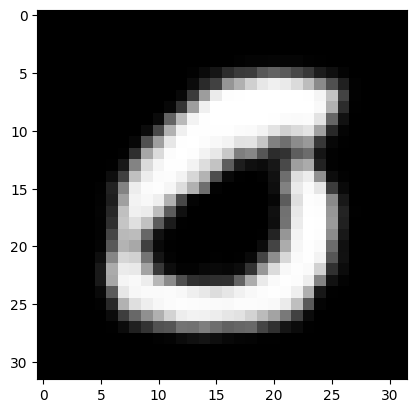

batch 900 gen loss: 1.5535149574279785, discr loss: -6.822715759277344


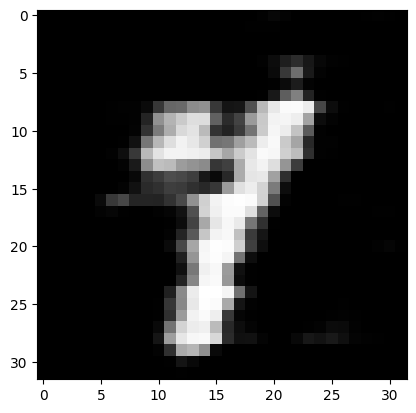

246.20367431640625 -3482.3720703125


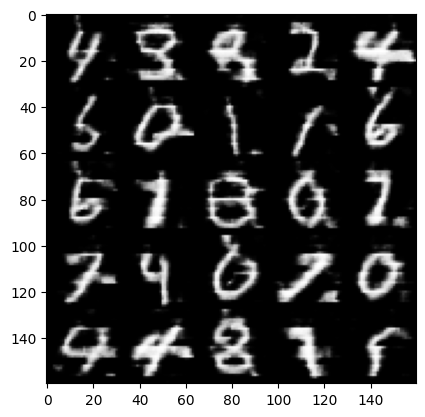

epoch 11:
batch 0 gen loss: 1.7259693145751953, discr loss: -7.2197346687316895


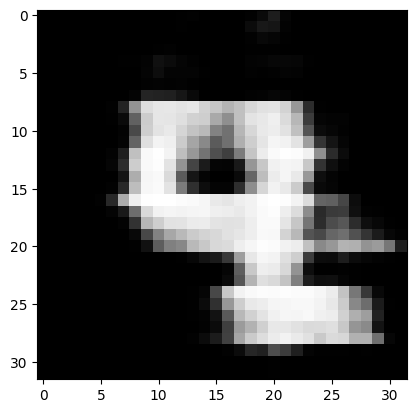

batch 100 gen loss: 1.4746100902557373, discr loss: 3.280432939529419


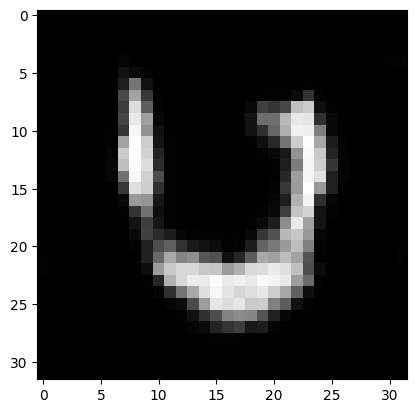

batch 200 gen loss: 0.5193015336990356, discr loss: 2.3089051246643066


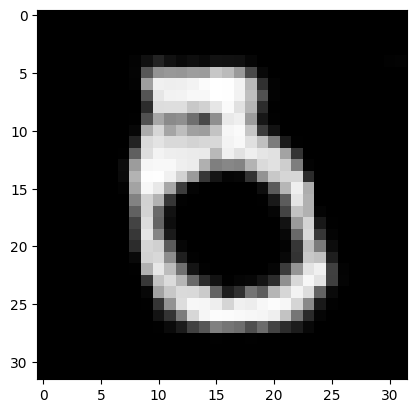

batch 300 gen loss: 0.4150104522705078, discr loss: 1.933658480644226


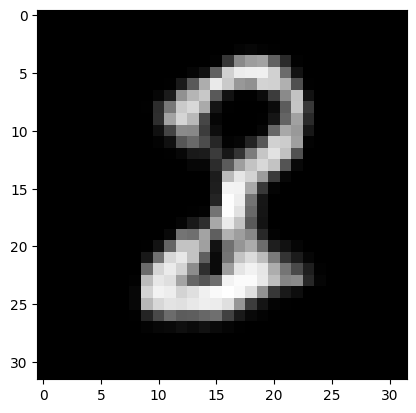

batch 400 gen loss: -1.917428731918335, discr loss: 4.833968162536621


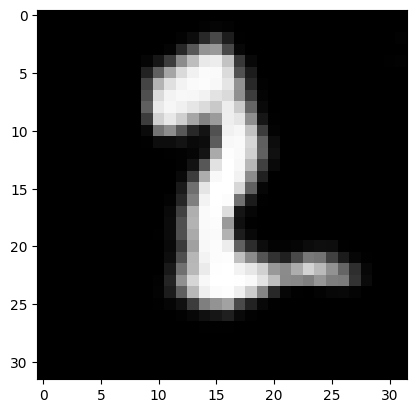

batch 500 gen loss: 0.7611861824989319, discr loss: 6.3586907386779785


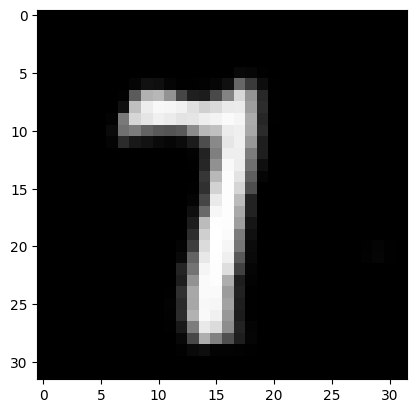

batch 600 gen loss: -0.042586058378219604, discr loss: 7.601920127868652


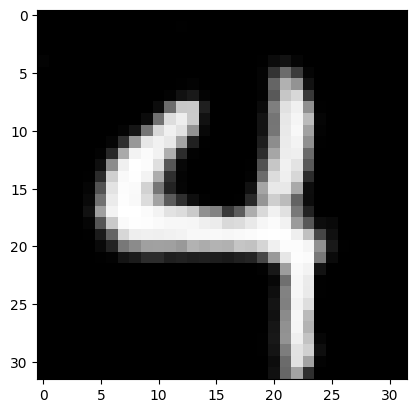

batch 700 gen loss: 0.4095366597175598, discr loss: 6.481692314147949


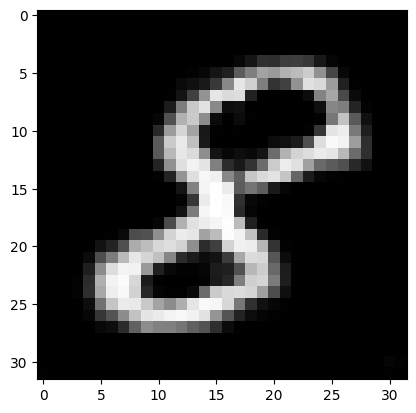

batch 800 gen loss: 1.0733023881912231, discr loss: 4.852655410766602


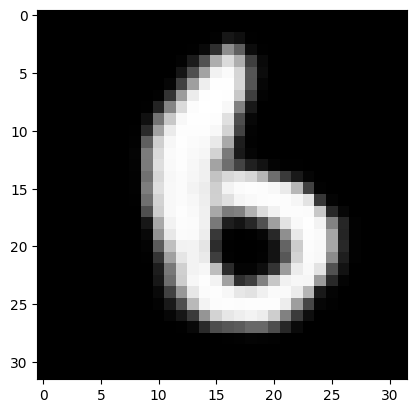

batch 900 gen loss: 0.1118004247546196, discr loss: 13.551918029785156


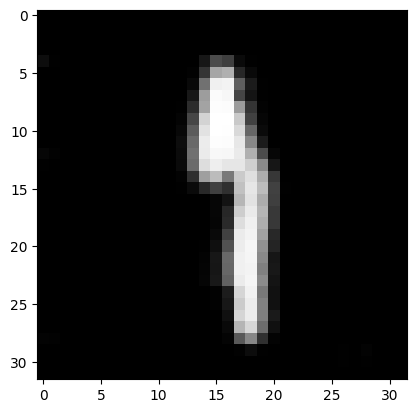

373.9837951660156 4672.26416015625


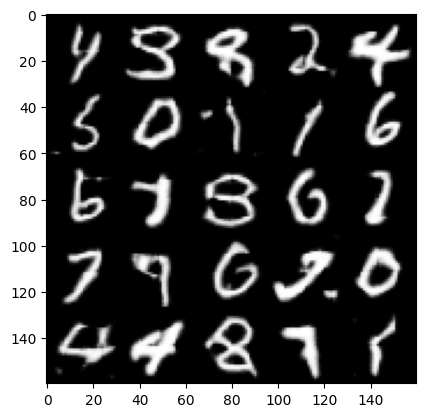

epoch 12:
batch 0 gen loss: -0.020282745361328125, discr loss: 13.024231910705566


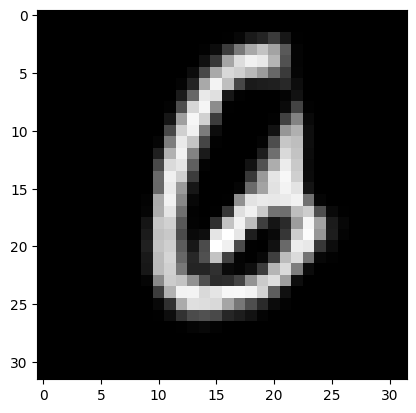

batch 100 gen loss: 0.05252265930175781, discr loss: 13.780797004699707


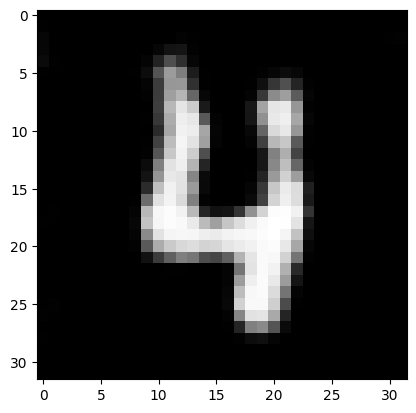

batch 200 gen loss: 0.7277994155883789, discr loss: 12.21496868133545


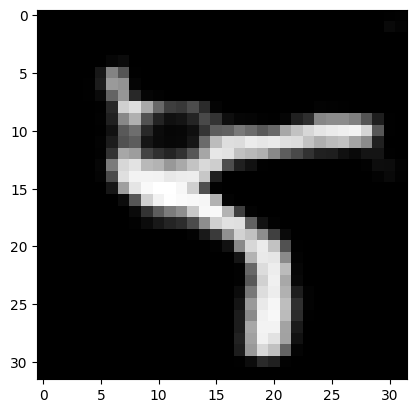

batch 300 gen loss: 0.10245120525360107, discr loss: 6.599278926849365


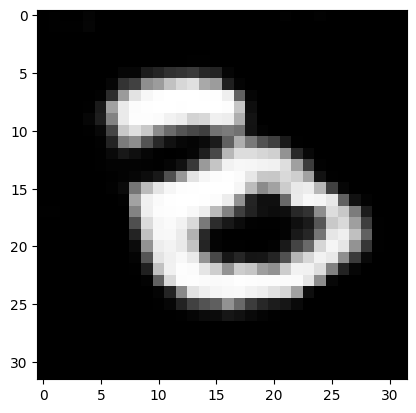

batch 400 gen loss: 0.427222341299057, discr loss: 4.543780326843262


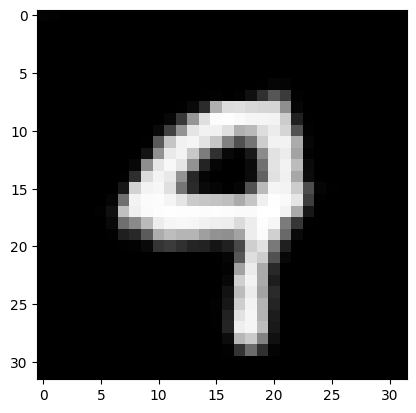

batch 500 gen loss: 1.2999857664108276, discr loss: 4.614040374755859


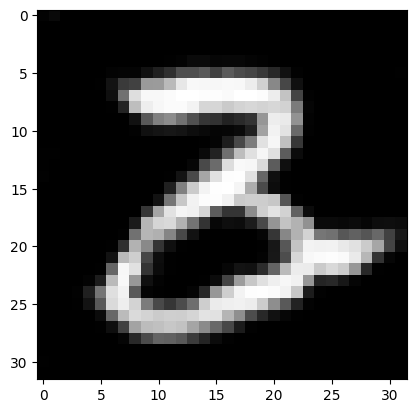

batch 600 gen loss: 0.9872764348983765, discr loss: 3.2642030715942383


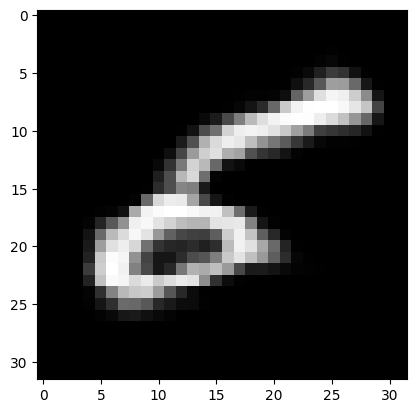

batch 700 gen loss: 0.5702471137046814, discr loss: 4.242809295654297


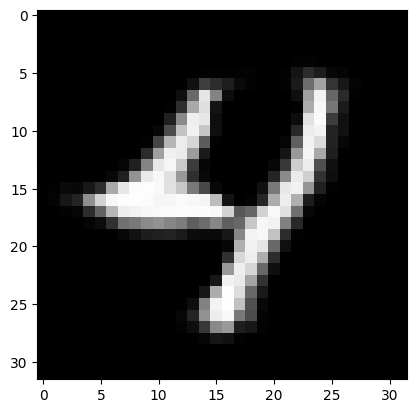

batch 800 gen loss: -0.4161917567253113, discr loss: 6.084558486938477


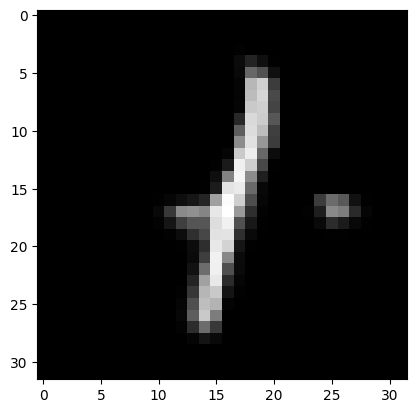

batch 900 gen loss: 0.25111711025238037, discr loss: 5.441245079040527


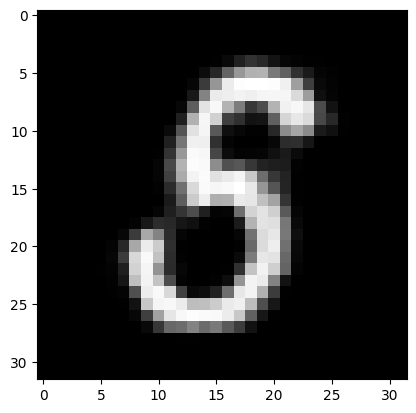

402.34588623046875 6671.11181640625


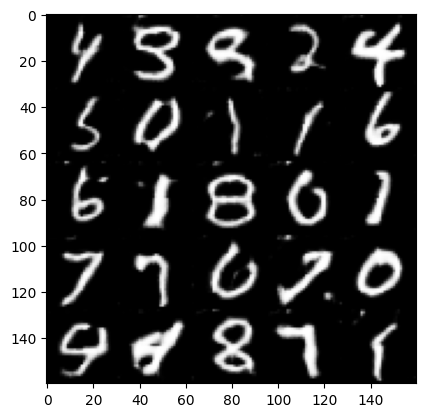

epoch 13:
batch 0 gen loss: -1.2886171340942383, discr loss: 6.351332664489746


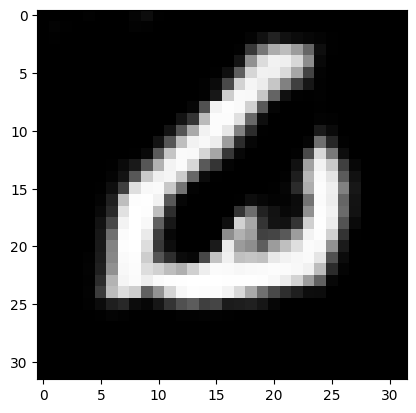

batch 100 gen loss: 0.33982035517692566, discr loss: 5.655972480773926


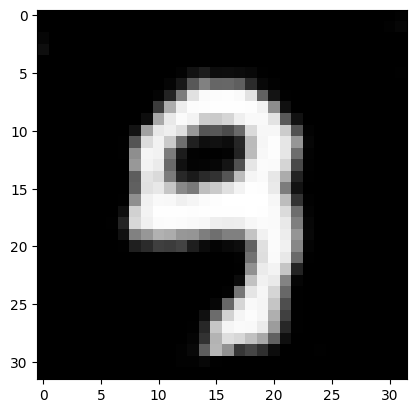

batch 200 gen loss: 1.0531980991363525, discr loss: 2.698845386505127


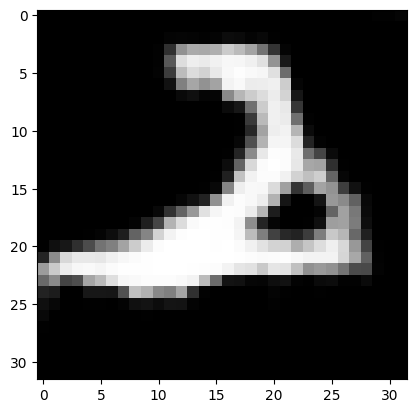

batch 300 gen loss: 0.18849870562553406, discr loss: 4.153055191040039


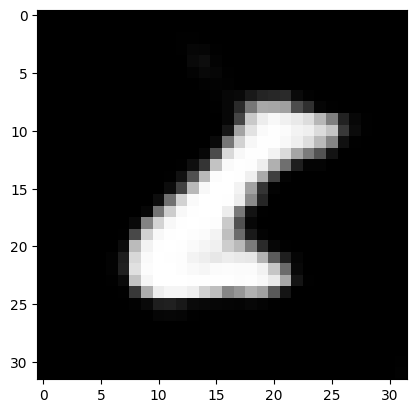

batch 400 gen loss: 1.6411986351013184, discr loss: 2.427938461303711


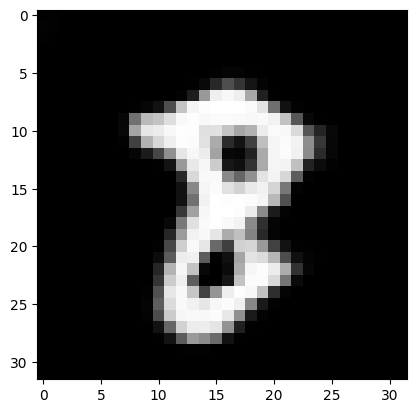

batch 500 gen loss: 1.0561336278915405, discr loss: 3.1819307804107666


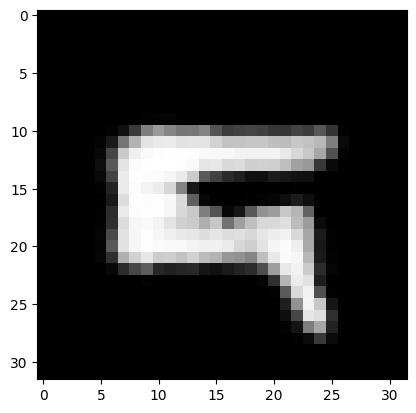

batch 600 gen loss: -0.07301944494247437, discr loss: 9.949336051940918


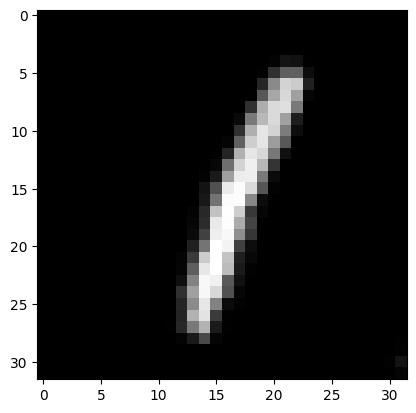

batch 700 gen loss: 0.12034153938293457, discr loss: 5.267906665802002


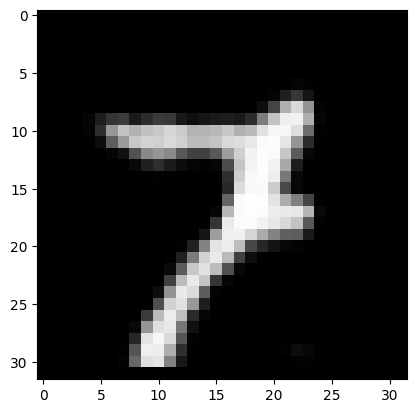

batch 800 gen loss: 0.7333121299743652, discr loss: 3.8592121601104736


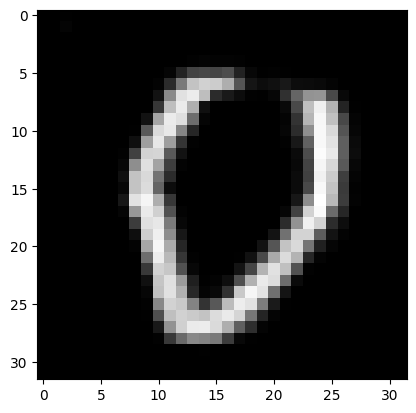

batch 900 gen loss: -3.9635562896728516, discr loss: 9.662694931030273


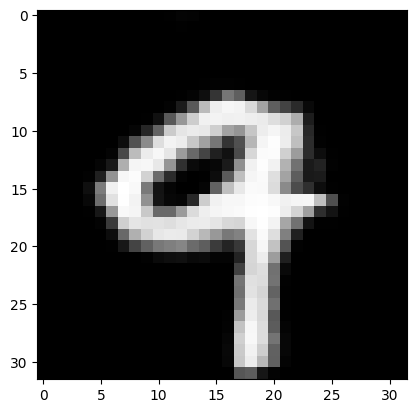

124.00568389892578 4958.0576171875


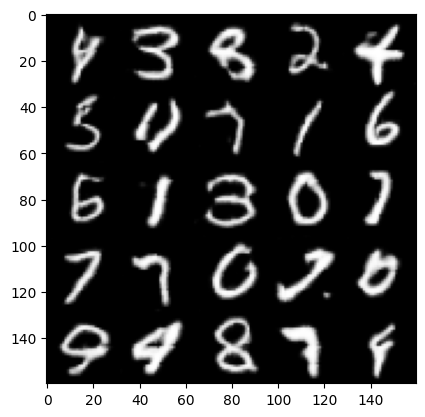

epoch 14:
batch 0 gen loss: 0.5680934190750122, discr loss: 7.583855628967285


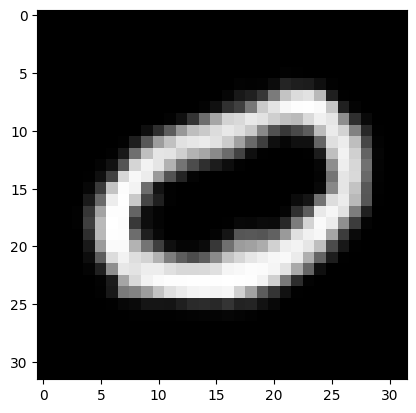

batch 100 gen loss: -3.2847537994384766, discr loss: 7.522641181945801


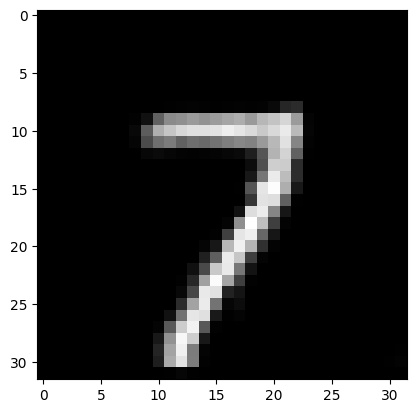

batch 200 gen loss: -3.6245760917663574, discr loss: 13.337636947631836


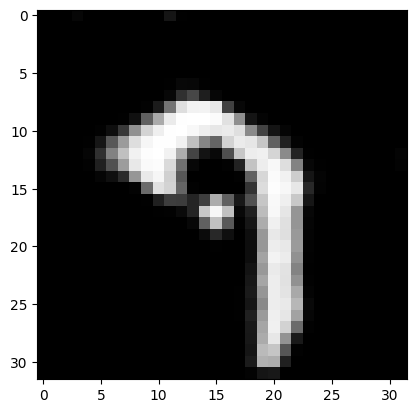

batch 300 gen loss: -2.884333848953247, discr loss: 9.568018913269043


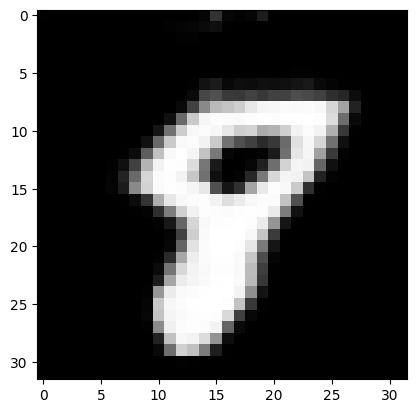

batch 400 gen loss: 0.8236014246940613, discr loss: 9.445032119750977


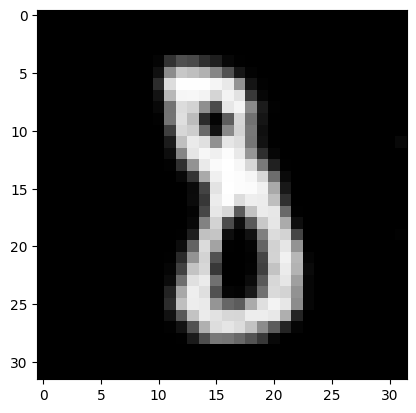

batch 500 gen loss: -2.9848825931549072, discr loss: 9.876083374023438


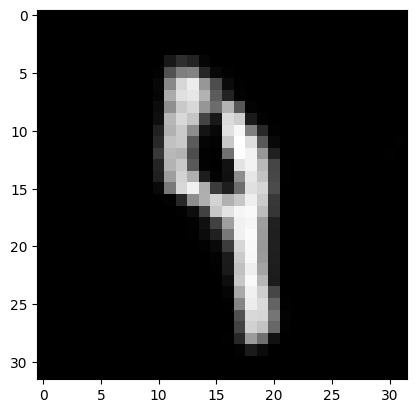

batch 600 gen loss: 0.6613781452178955, discr loss: 10.784378051757812


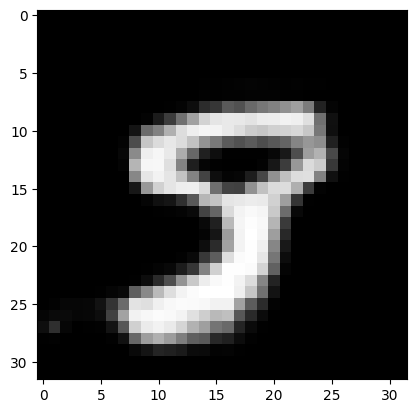

batch 700 gen loss: -2.9569931030273438, discr loss: 9.465655326843262


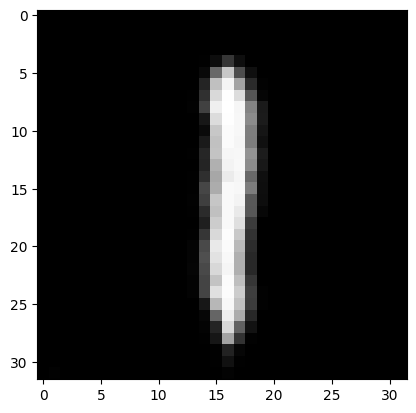

batch 800 gen loss: -3.7344679832458496, discr loss: 12.124072074890137


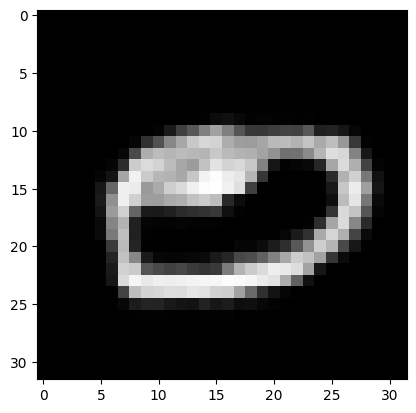

batch 900 gen loss: 0.9101874232292175, discr loss: 9.947588920593262


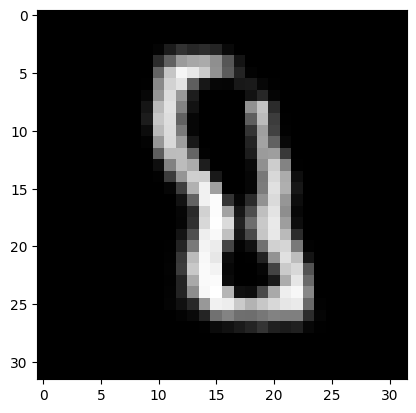

-1573.716796875 9226.3203125


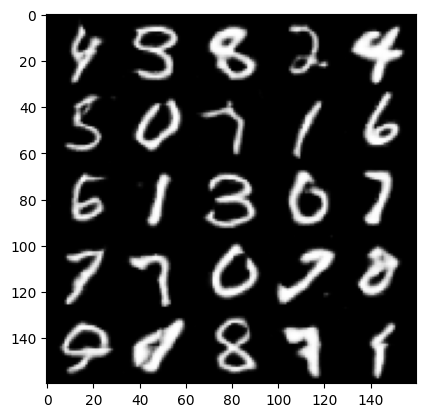

epoch 15:
batch 0 gen loss: 0.6899476647377014, discr loss: 8.255880355834961


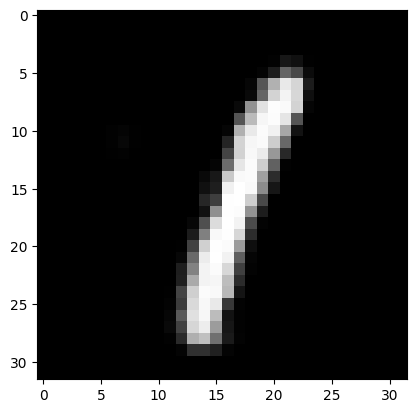

batch 100 gen loss: -7.521354675292969, discr loss: 13.302200317382812


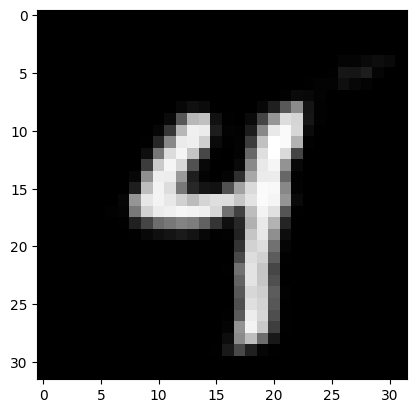

batch 200 gen loss: -3.0382940769195557, discr loss: 10.011701583862305


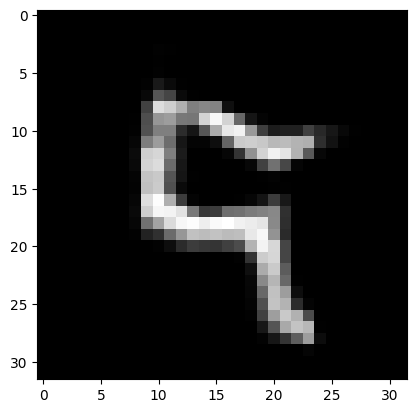

batch 300 gen loss: 0.48000046610832214, discr loss: 13.932806968688965


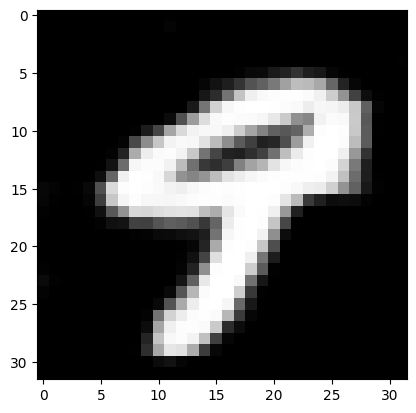

batch 400 gen loss: -1.6435747146606445, discr loss: 13.717524528503418


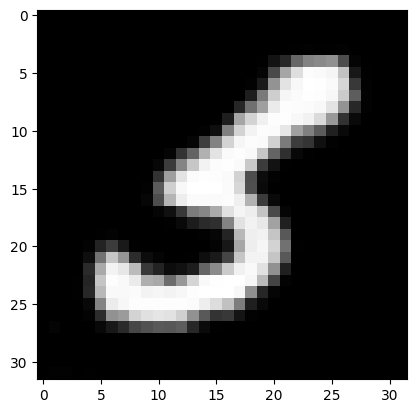

batch 500 gen loss: -4.112197399139404, discr loss: 13.22881031036377


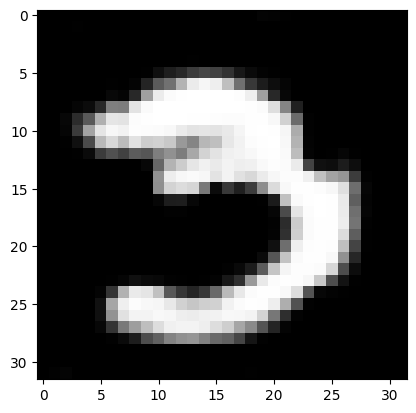

batch 600 gen loss: -0.31538352370262146, discr loss: 8.670920372009277


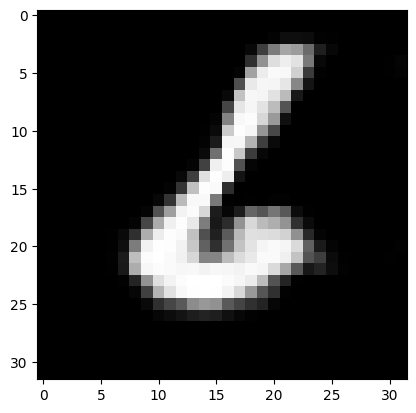

batch 700 gen loss: 0.31392642855644226, discr loss: 7.95762825012207


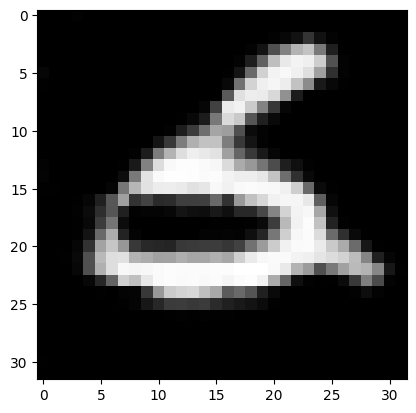

batch 800 gen loss: -3.4274542331695557, discr loss: 7.613518238067627


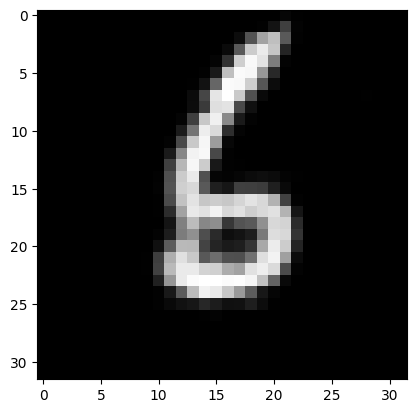

batch 900 gen loss: 0.34537193179130554, discr loss: 7.653942584991455


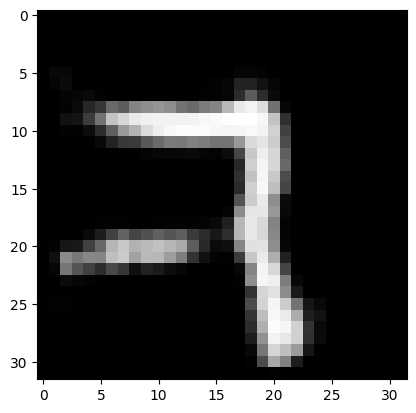

-2704.3828125 10087.7880859375


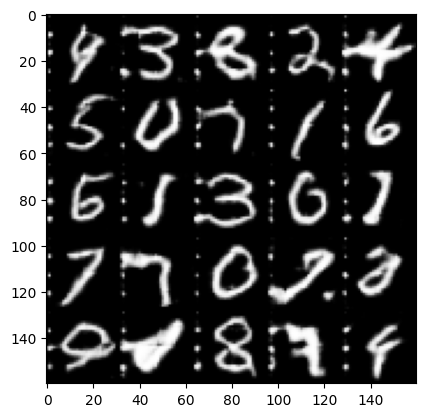

epoch 16:
batch 0 gen loss: -3.609205961227417, discr loss: 6.763449192047119


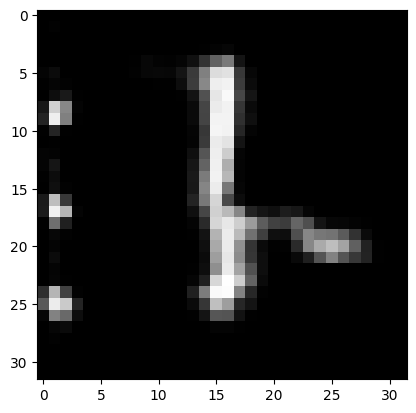

batch 100 gen loss: -3.2267603874206543, discr loss: 7.703090190887451


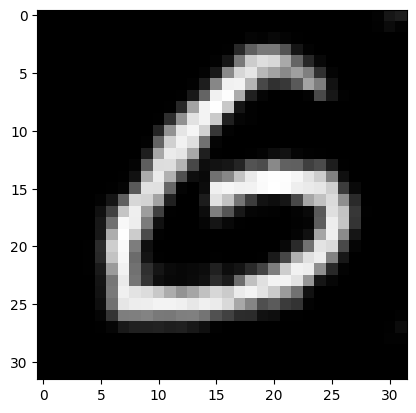

batch 200 gen loss: 0.810090184211731, discr loss: 15.672954559326172


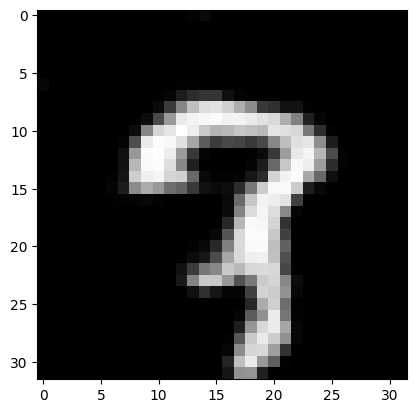

batch 300 gen loss: -2.2073240280151367, discr loss: 7.252587795257568


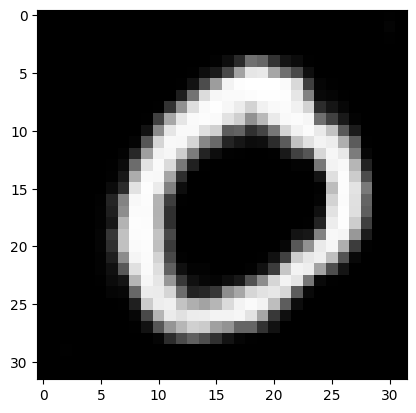

batch 400 gen loss: 0.01246345043182373, discr loss: 5.622567176818848


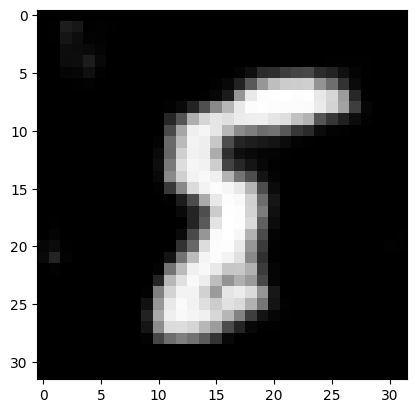

batch 500 gen loss: -1.0807676315307617, discr loss: 7.692859649658203


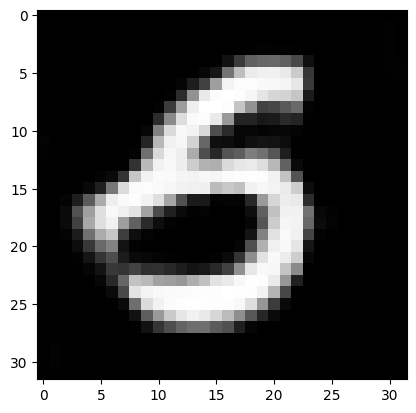

batch 600 gen loss: 0.3316449522972107, discr loss: 6.340837478637695


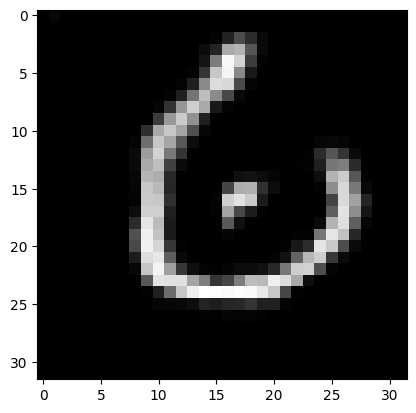

batch 700 gen loss: 1.7339857816696167, discr loss: 3.396472215652466


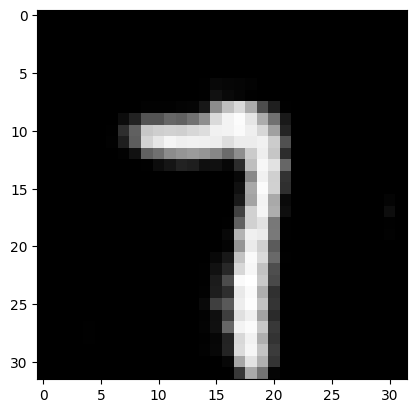

batch 800 gen loss: 0.24890051782131195, discr loss: 3.0589611530303955


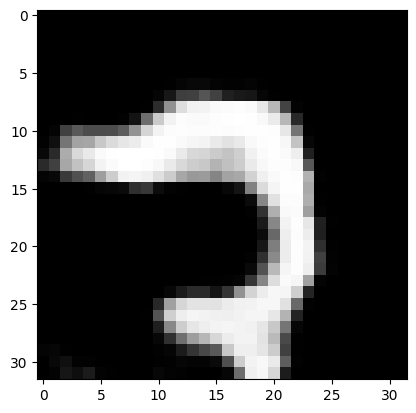

batch 900 gen loss: 0.7336265444755554, discr loss: 5.281727313995361


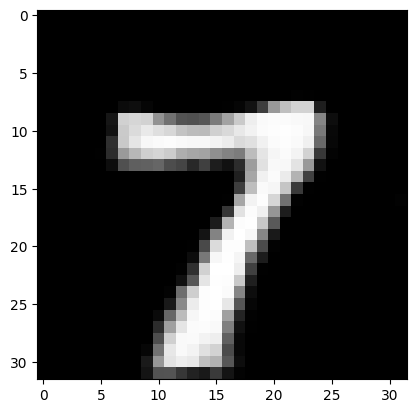

-166.80836486816406 6102.728515625


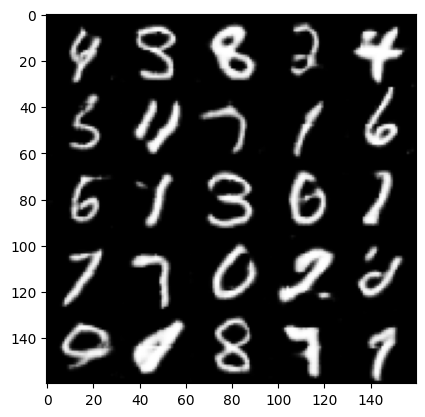

epoch 17:
batch 0 gen loss: 0.6238459348678589, discr loss: 3.3184449672698975


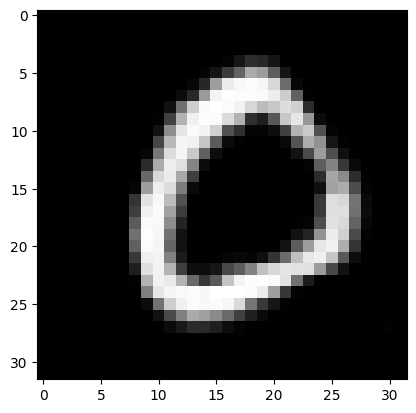

batch 100 gen loss: -0.5052685737609863, discr loss: 7.5037736892700195


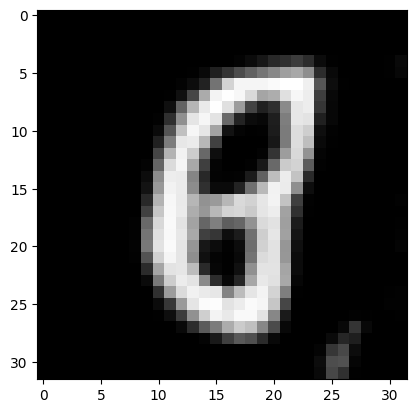

batch 200 gen loss: -0.5576224327087402, discr loss: 4.687157154083252


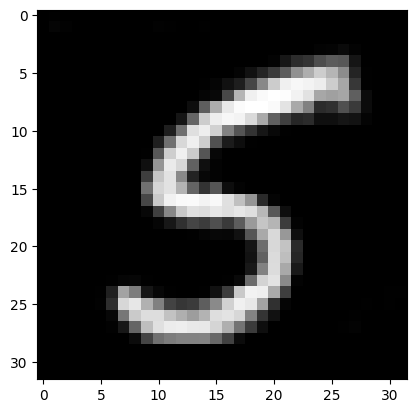

batch 300 gen loss: 0.07877521961927414, discr loss: 3.425828218460083


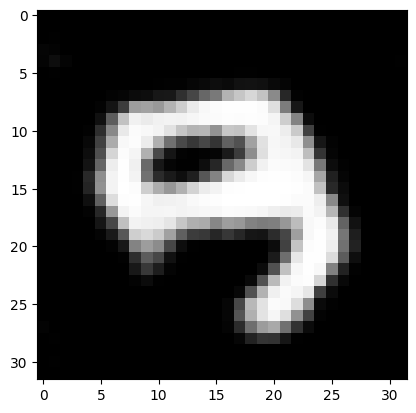

batch 400 gen loss: 1.756063461303711, discr loss: 4.836608409881592


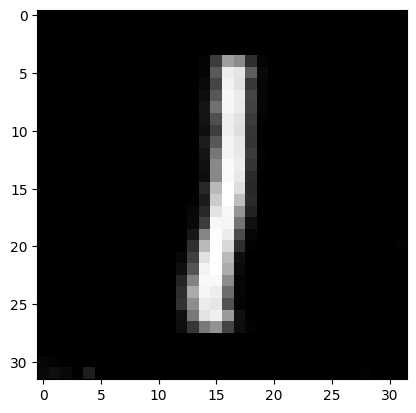

batch 500 gen loss: 0.06215047836303711, discr loss: 6.192607879638672


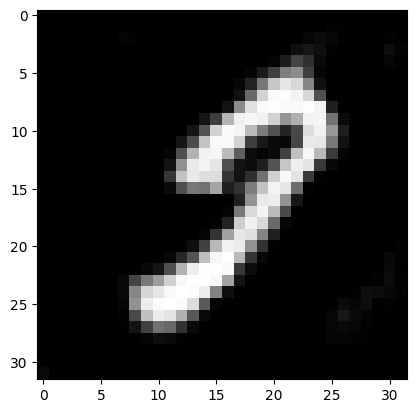

batch 600 gen loss: 0.453626811504364, discr loss: 4.656819820404053


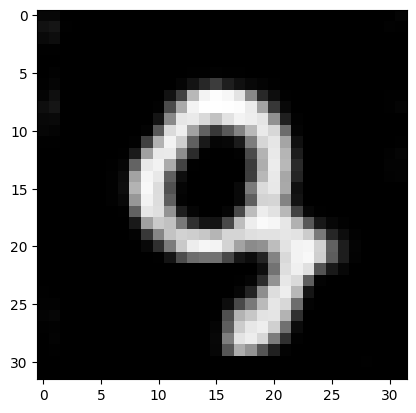

batch 700 gen loss: 0.6881656646728516, discr loss: 5.705947399139404


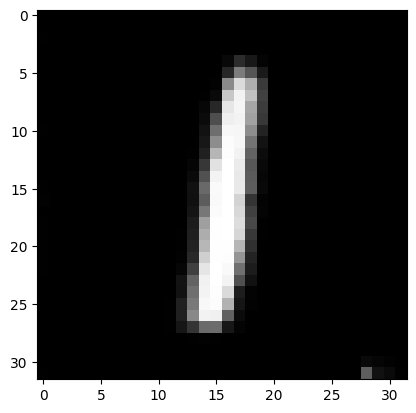

batch 800 gen loss: 0.6633118391036987, discr loss: 13.01708984375


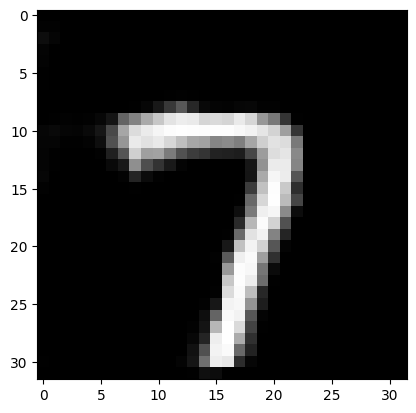

batch 900 gen loss: 0.37395179271698, discr loss: 12.8200101852417


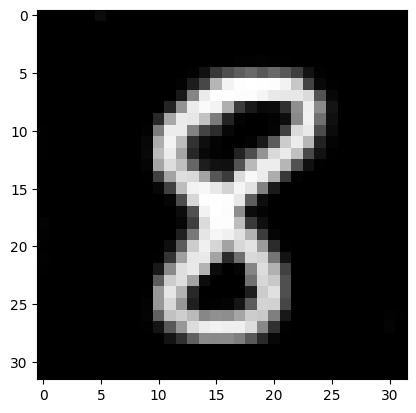

443.8323974609375 6347.228515625


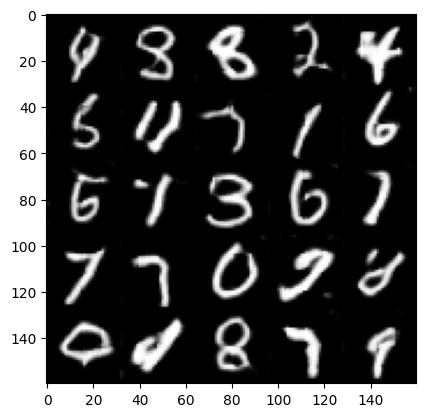

epoch 18:
batch 0 gen loss: 0.5056667327880859, discr loss: 13.1806058883667


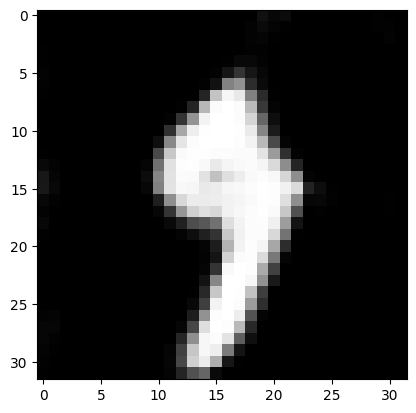

batch 100 gen loss: 0.8171652555465698, discr loss: 13.30733585357666


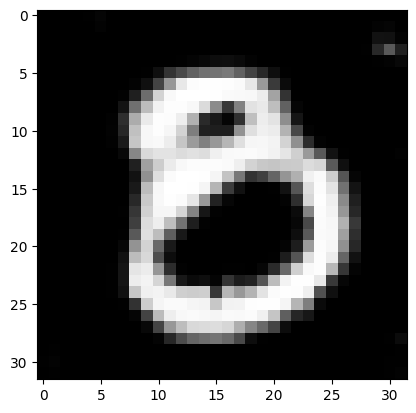

batch 200 gen loss: 0.08977381885051727, discr loss: 12.603784561157227


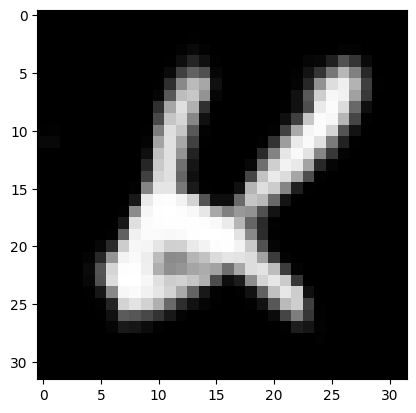

batch 300 gen loss: 0.9015758037567139, discr loss: 12.467864990234375


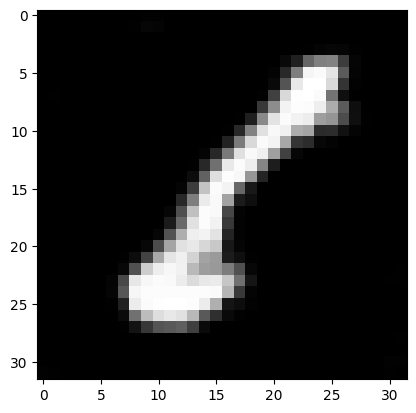

batch 400 gen loss: 0.8587222695350647, discr loss: 13.741246223449707


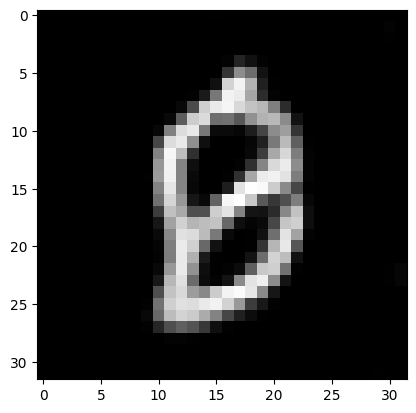

batch 500 gen loss: 1.0103415250778198, discr loss: 12.307720184326172


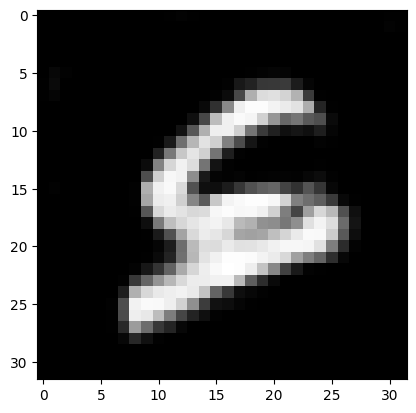

batch 600 gen loss: 0.937964916229248, discr loss: 10.993091583251953


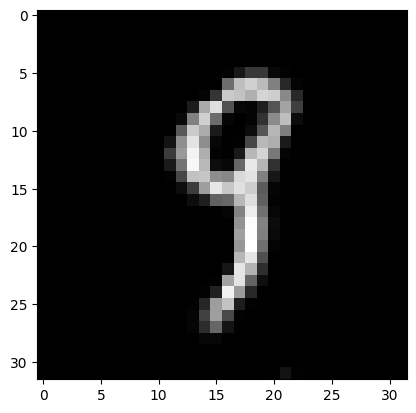

batch 700 gen loss: 0.492524653673172, discr loss: 13.029561996459961


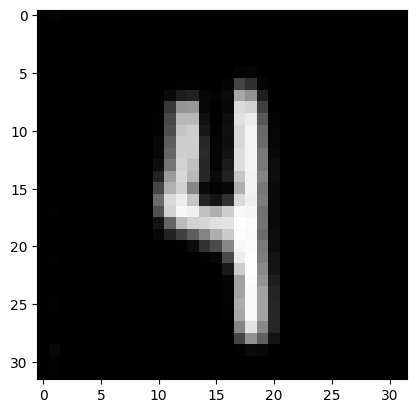

batch 800 gen loss: -2.7435450553894043, discr loss: 13.523996353149414


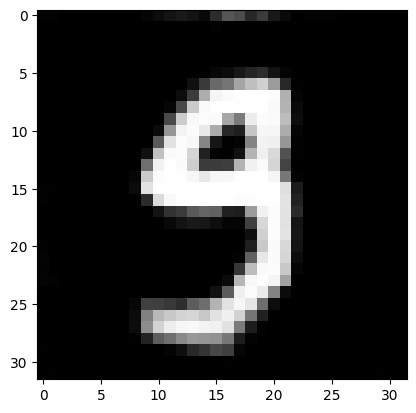

batch 900 gen loss: -1.693732500076294, discr loss: 14.517715454101562


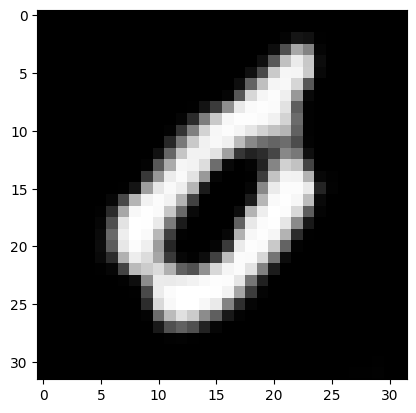

489.57196044921875 12296.025390625


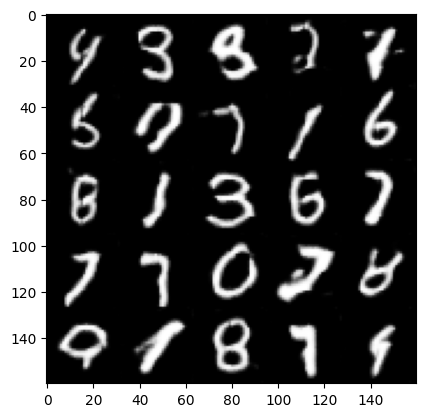

epoch 19:
batch 0 gen loss: 0.4327218532562256, discr loss: 16.459747314453125


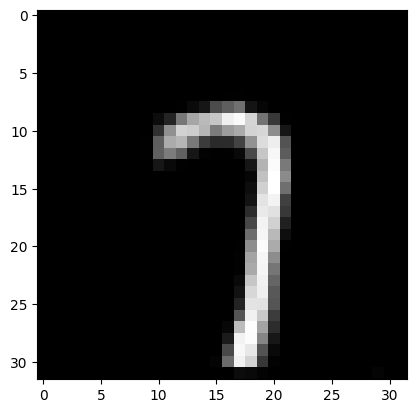

batch 100 gen loss: 0.7285780906677246, discr loss: 16.711809158325195


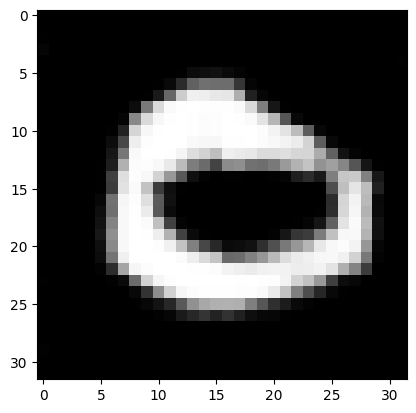

batch 200 gen loss: -2.978757619857788, discr loss: 16.134082794189453


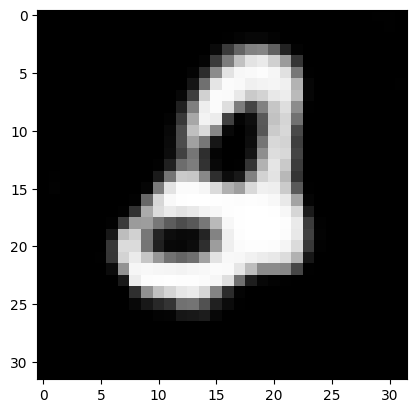

batch 300 gen loss: -3.7831385135650635, discr loss: 16.56983184814453


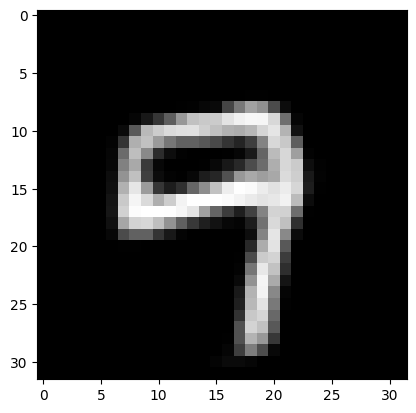

batch 400 gen loss: 0.3804042637348175, discr loss: 18.850330352783203


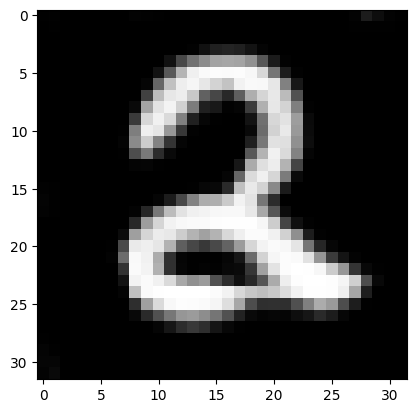

batch 500 gen loss: -6.982507705688477, discr loss: 18.146543502807617


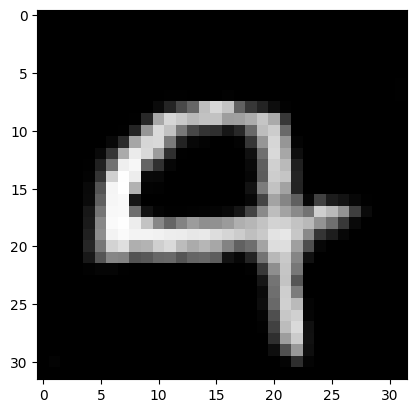

batch 600 gen loss: 0.3342064917087555, discr loss: 17.906509399414062


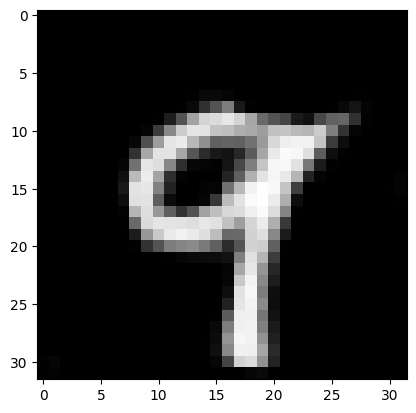

batch 700 gen loss: 0.7062457203865051, discr loss: 17.062021255493164


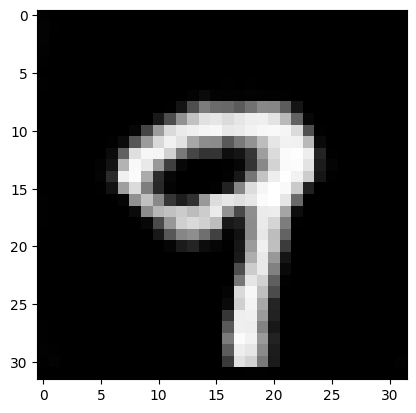

batch 800 gen loss: 0.1465054601430893, discr loss: 15.055691719055176


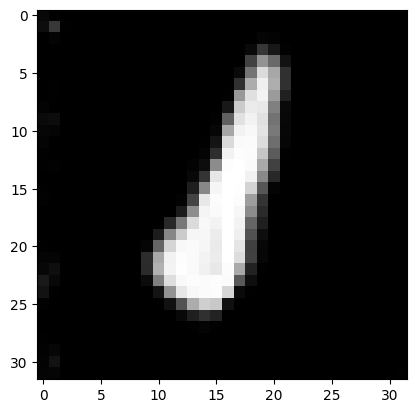

batch 900 gen loss: -2.9145026206970215, discr loss: 14.62585735321045


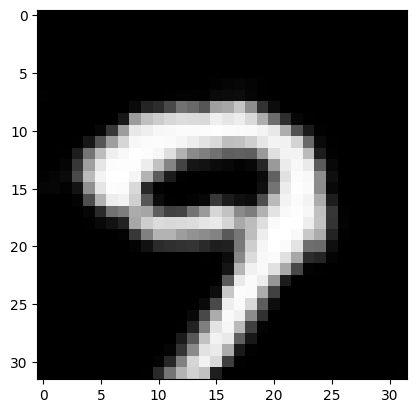

-2129.22021484375 16123.3681640625


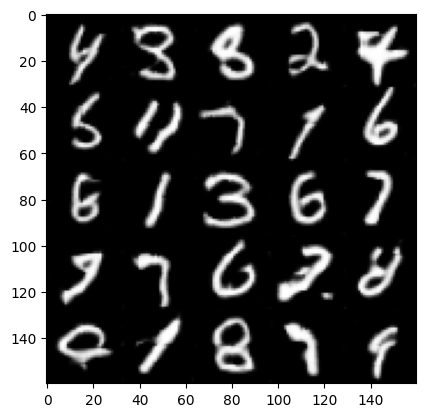

epoch 20:
batch 0 gen loss: -3.6032304763793945, discr loss: 16.08704948425293


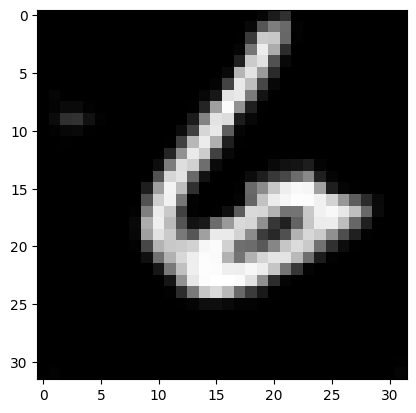

batch 100 gen loss: 0.4701506197452545, discr loss: 15.163067817687988


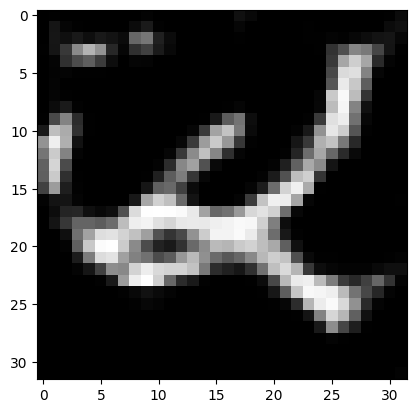

batch 200 gen loss: 0.7735145092010498, discr loss: 16.163522720336914


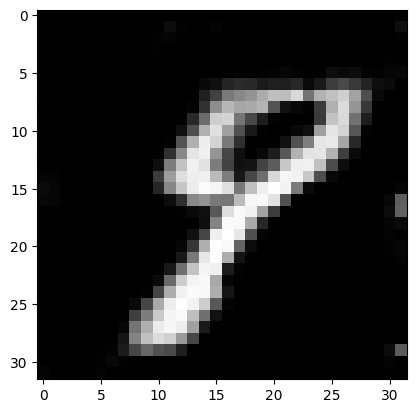

batch 300 gen loss: -3.333300828933716, discr loss: 14.670424461364746


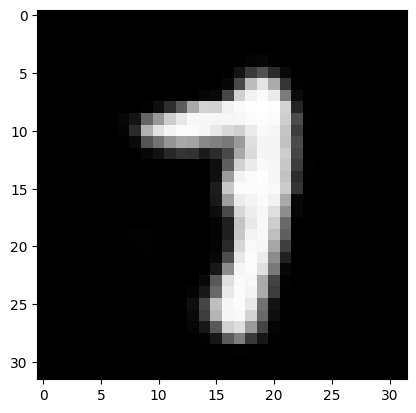

batch 400 gen loss: 0.7669955492019653, discr loss: 14.101966857910156


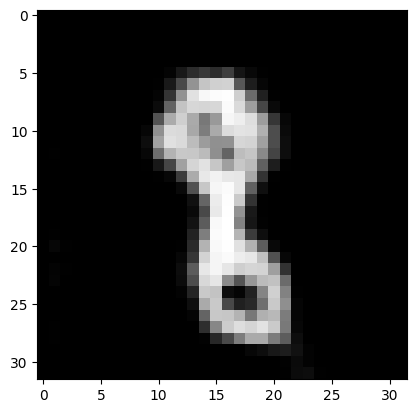

batch 500 gen loss: -1.1667968034744263, discr loss: 18.591522216796875


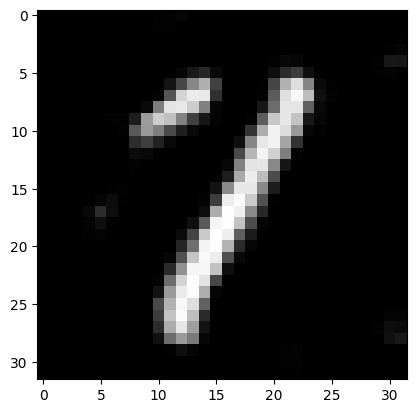

batch 600 gen loss: 0.09065712988376617, discr loss: 15.89806842803955


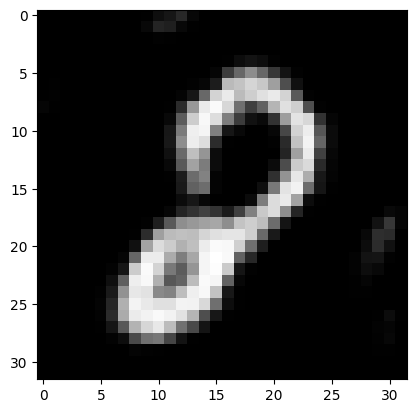

batch 700 gen loss: -3.21551513671875, discr loss: 15.470749855041504


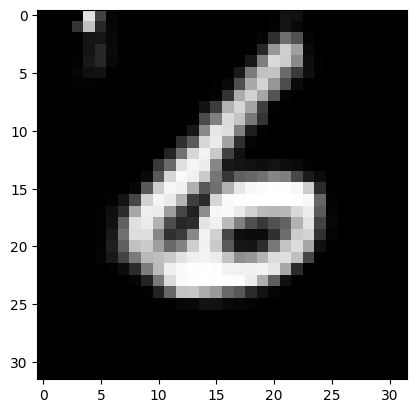

batch 800 gen loss: -3.280613422393799, discr loss: 15.931727409362793


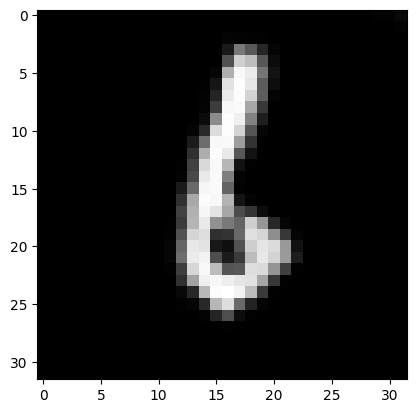

batch 900 gen loss: -2.735534906387329, discr loss: 15.581255912780762


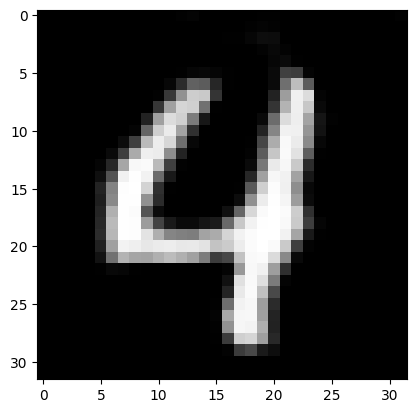

-1455.3499755859375 14422.87109375


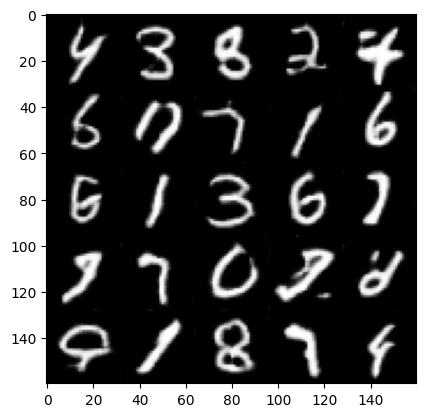

epoch 21:
batch 0 gen loss: 1.0891066789627075, discr loss: 14.780791282653809


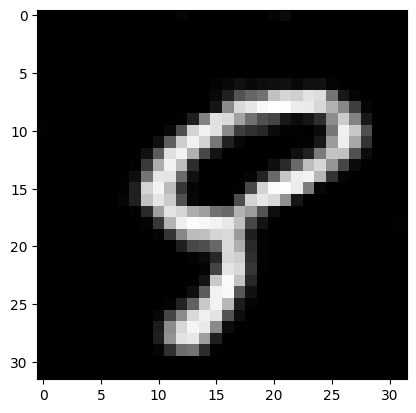

batch 100 gen loss: -0.5182898044586182, discr loss: 16.547521591186523


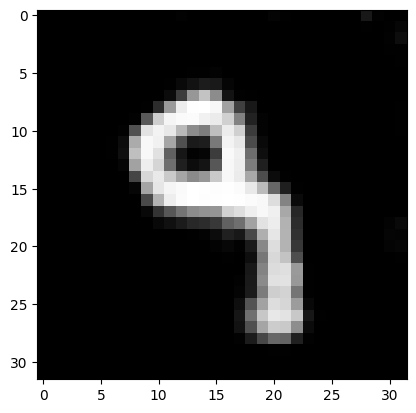

batch 200 gen loss: -5.290273189544678, discr loss: 18.138872146606445


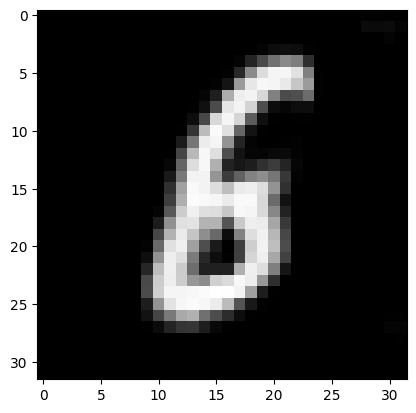

batch 300 gen loss: 0.5312850475311279, discr loss: 22.996898651123047


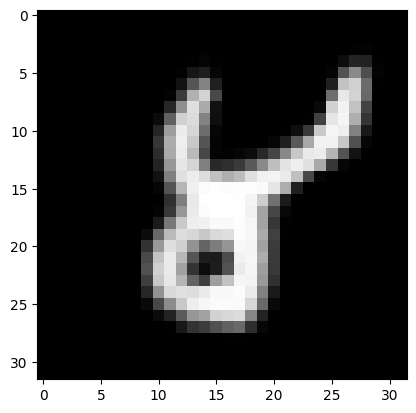

batch 400 gen loss: -2.961212635040283, discr loss: 22.43000030517578


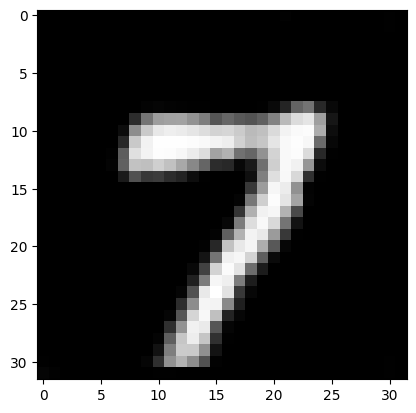

batch 500 gen loss: 1.064577341079712, discr loss: 22.19890785217285


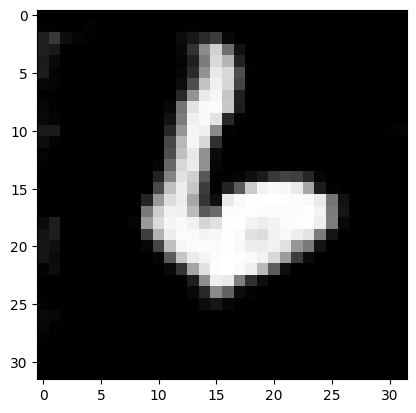

batch 600 gen loss: 0.22017543017864227, discr loss: 24.46884536743164


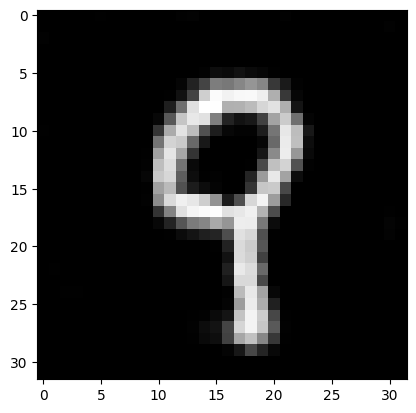

batch 700 gen loss: -3.5886013507843018, discr loss: 24.72263526916504


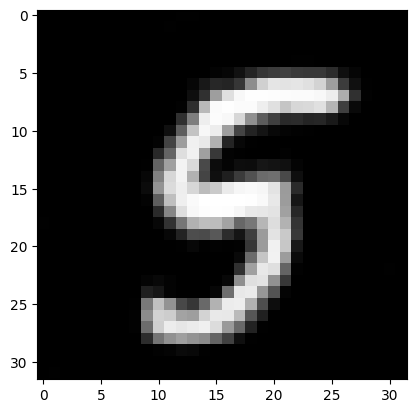

batch 800 gen loss: 1.063782811164856, discr loss: 24.177589416503906


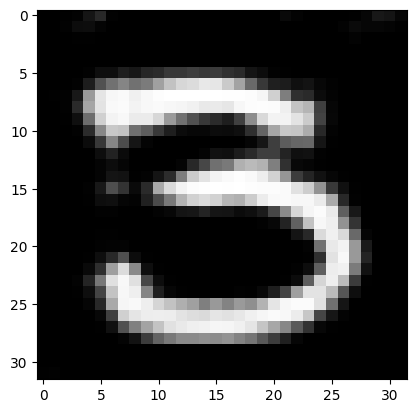

batch 900 gen loss: 0.9787956476211548, discr loss: 24.149677276611328


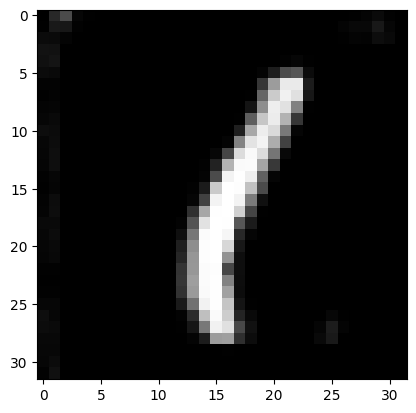

-1354.9007568359375 20339.70703125


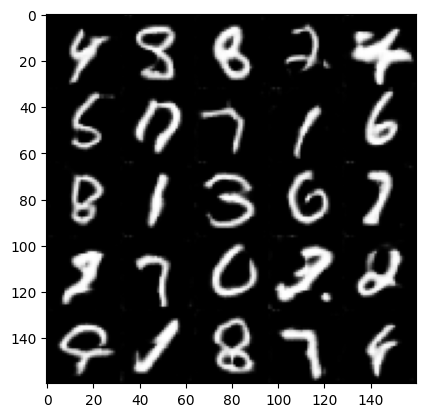

epoch 22:
batch 0 gen loss: -0.39571091532707214, discr loss: 25.751741409301758


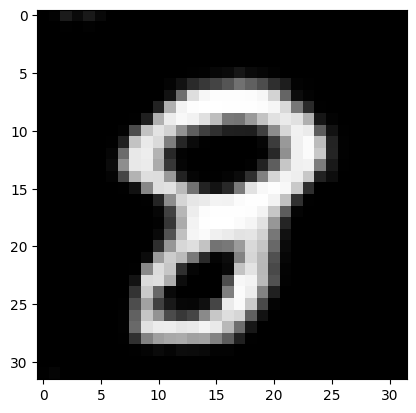

batch 100 gen loss: 0.7809097170829773, discr loss: 23.94578742980957


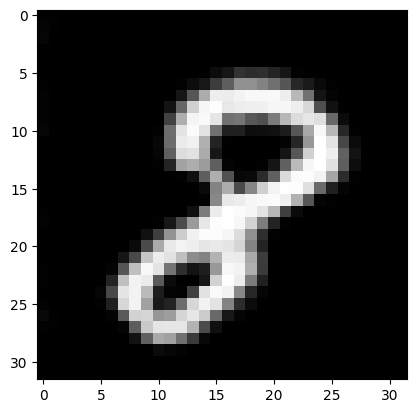

batch 200 gen loss: -0.02552487701177597, discr loss: 23.901081085205078


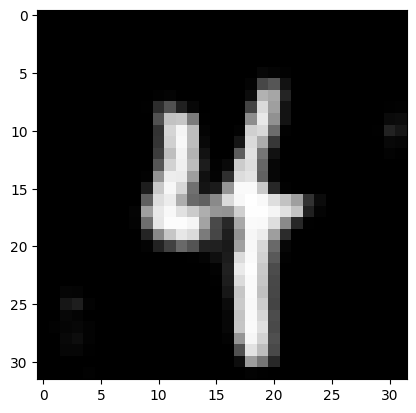

batch 300 gen loss: 0.4214000403881073, discr loss: 24.223352432250977


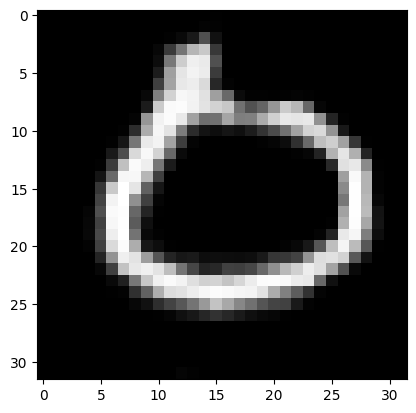

batch 400 gen loss: 0.48857101798057556, discr loss: 24.546302795410156


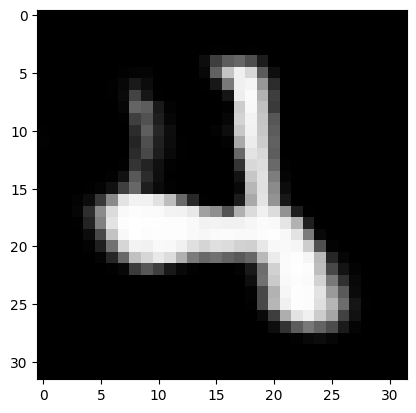

batch 500 gen loss: -6.617400646209717, discr loss: 26.892183303833008


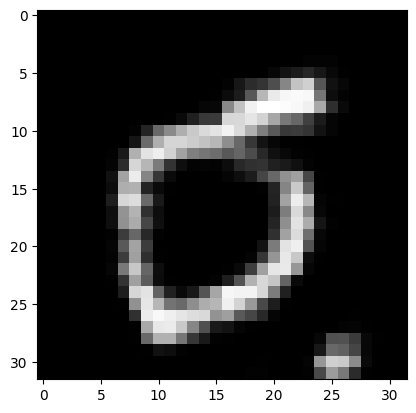

batch 600 gen loss: 0.8902460336685181, discr loss: 25.184303283691406


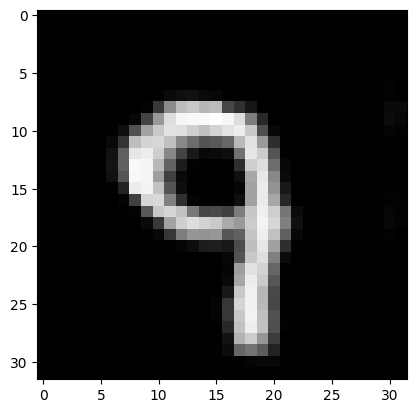

batch 700 gen loss: 0.6751230955123901, discr loss: 19.821836471557617


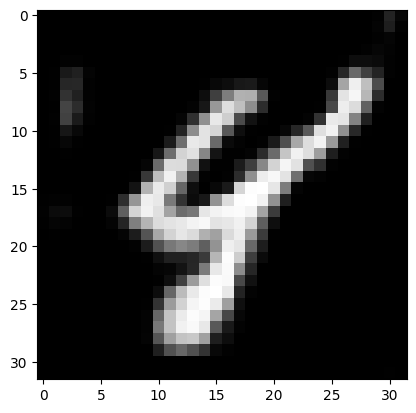

batch 800 gen loss: 0.4500771760940552, discr loss: 22.54184913635254


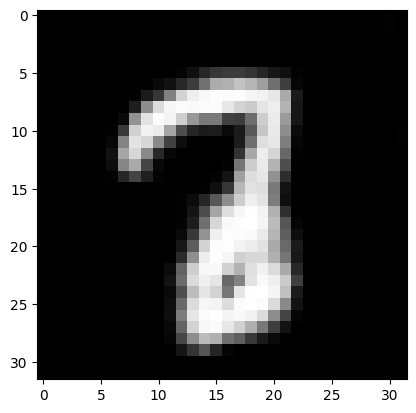

batch 900 gen loss: 0.5587120056152344, discr loss: 22.97495460510254


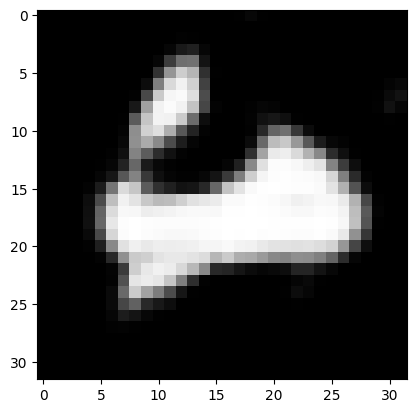

-977.6135864257812 22137.501953125


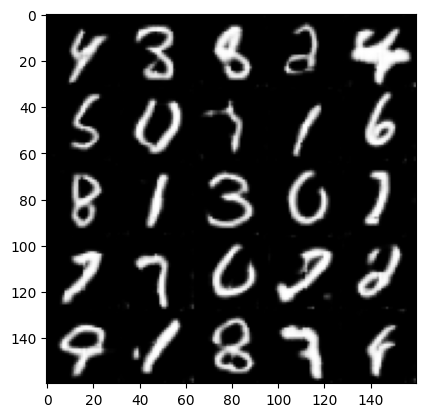

epoch 23:
batch 0 gen loss: 0.7832772135734558, discr loss: 22.926685333251953


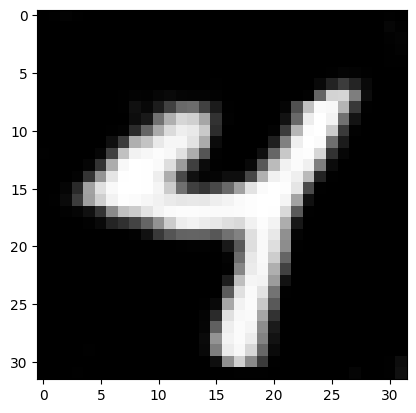

batch 100 gen loss: 0.7204499244689941, discr loss: 19.42312240600586


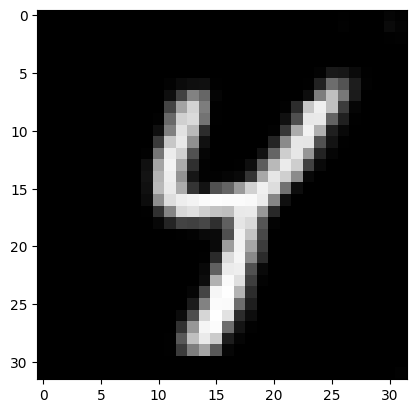

batch 200 gen loss: 0.9520732164382935, discr loss: 18.497100830078125


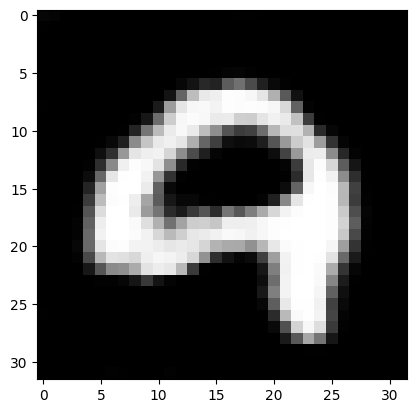

batch 300 gen loss: 0.2421187162399292, discr loss: 20.692598342895508


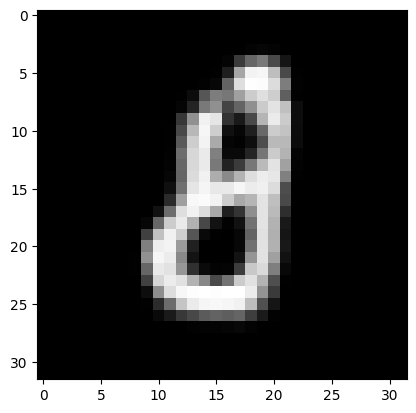

batch 400 gen loss: 0.8133041858673096, discr loss: 19.147817611694336


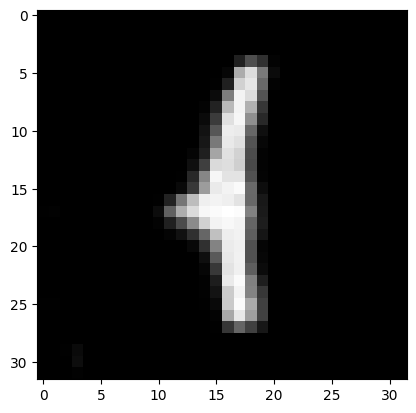

batch 500 gen loss: 0.5606170892715454, discr loss: 18.55961799621582


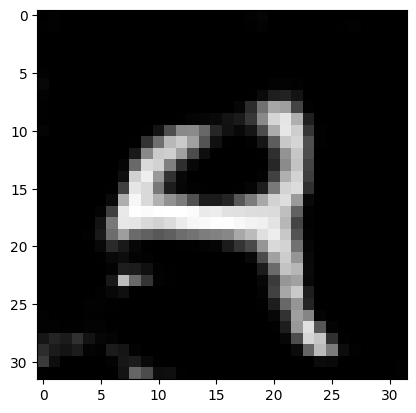

batch 600 gen loss: 1.1800663471221924, discr loss: 20.98288345336914


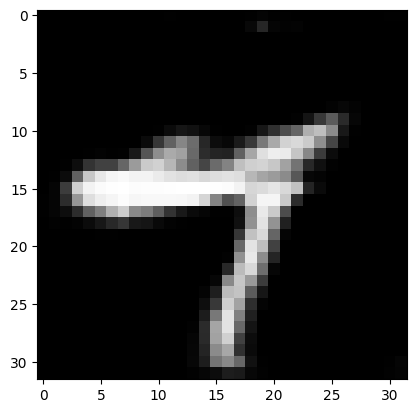

batch 700 gen loss: 0.9954439401626587, discr loss: 23.44695472717285


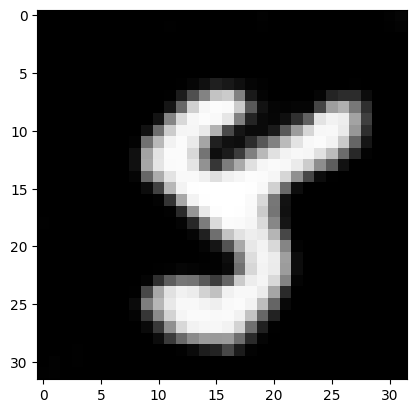

batch 800 gen loss: 0.8881757855415344, discr loss: 19.488449096679688


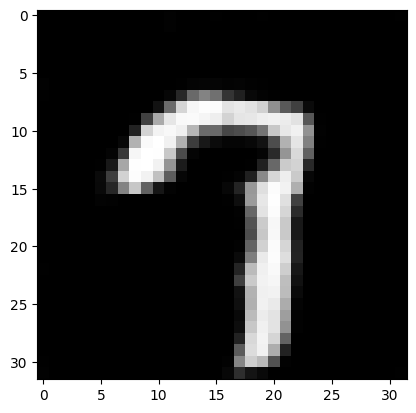

batch 900 gen loss: 1.2061820030212402, discr loss: 18.236812591552734


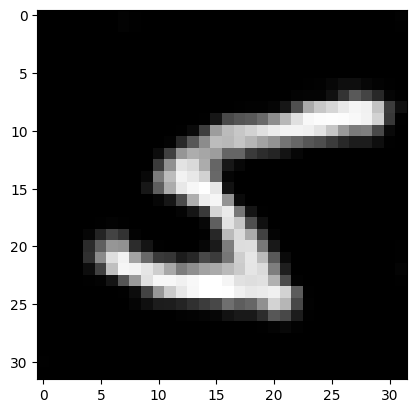

630.1083984375 18368.4140625


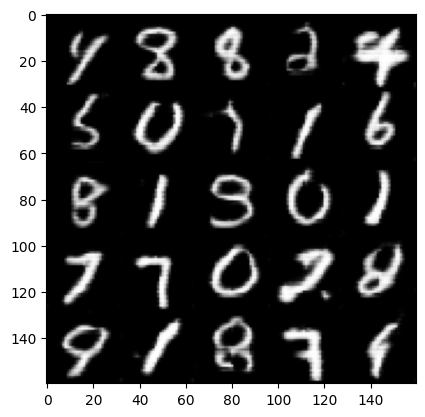

epoch 24:
batch 0 gen loss: 1.0194144248962402, discr loss: 17.660621643066406


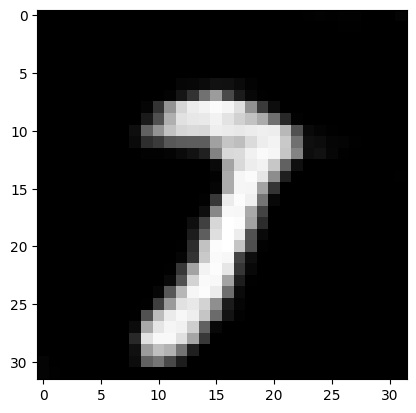

batch 100 gen loss: 0.962335467338562, discr loss: 17.805131912231445


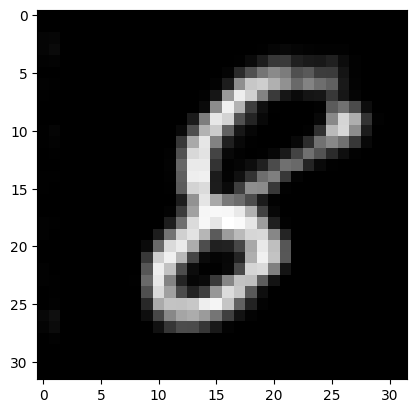

batch 200 gen loss: 1.3640965223312378, discr loss: 18.324583053588867


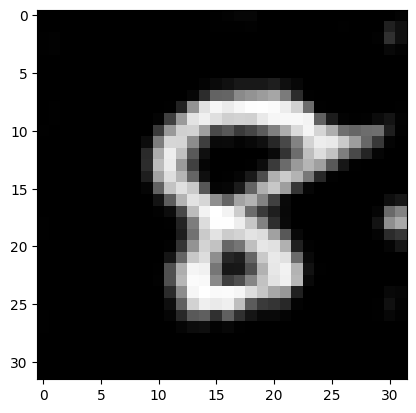

batch 300 gen loss: 0.6581198573112488, discr loss: 22.254785537719727


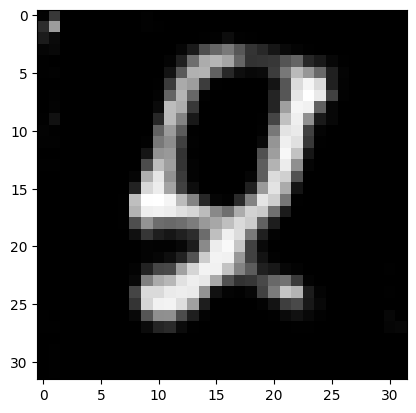

batch 400 gen loss: 0.7552024126052856, discr loss: 21.906190872192383


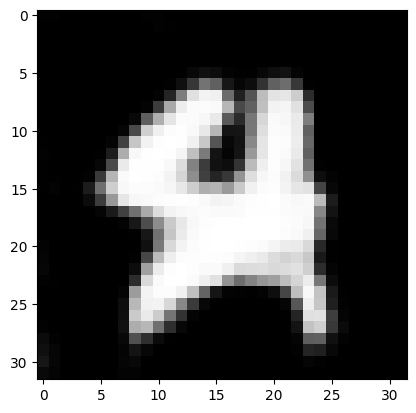

batch 500 gen loss: -2.744786262512207, discr loss: 26.147518157958984


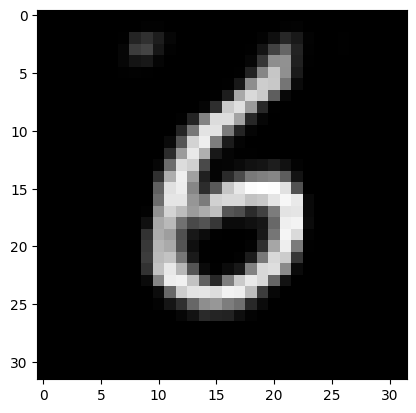

batch 600 gen loss: 0.5688276886940002, discr loss: 23.936153411865234


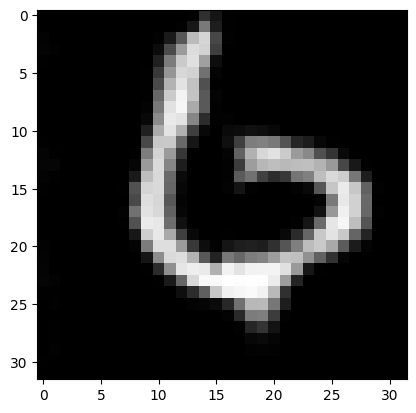

batch 700 gen loss: 0.9362409114837646, discr loss: 22.736263275146484


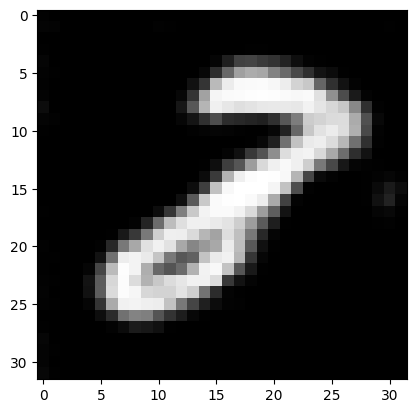

batch 800 gen loss: 0.8121126890182495, discr loss: 22.034324645996094


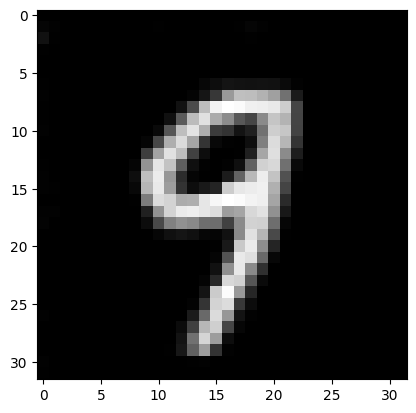

batch 900 gen loss: -6.6932477951049805, discr loss: 26.34027671813965


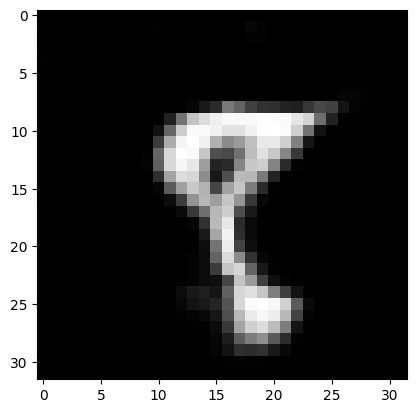

-664.337646484375 20281.56640625


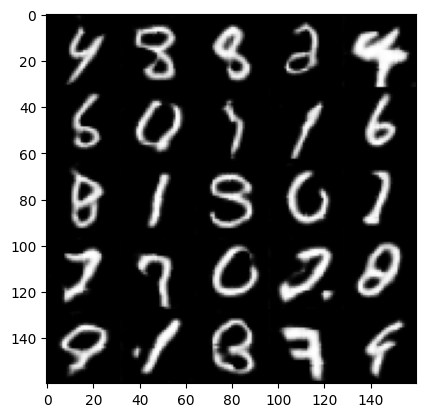

epoch 25:
batch 0 gen loss: -2.828989028930664, discr loss: 26.401683807373047


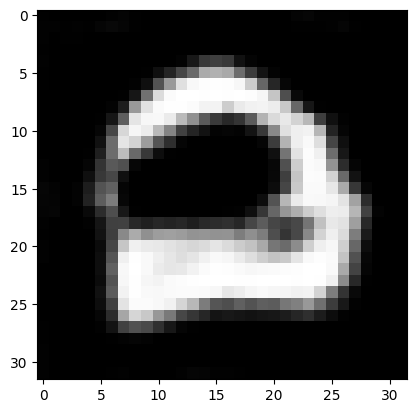

batch 100 gen loss: -7.368282794952393, discr loss: 26.341724395751953


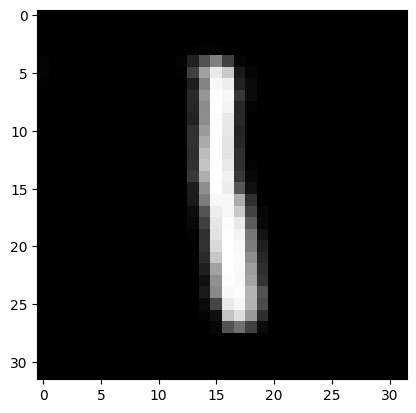

batch 200 gen loss: -0.9529566168785095, discr loss: 23.50139808654785


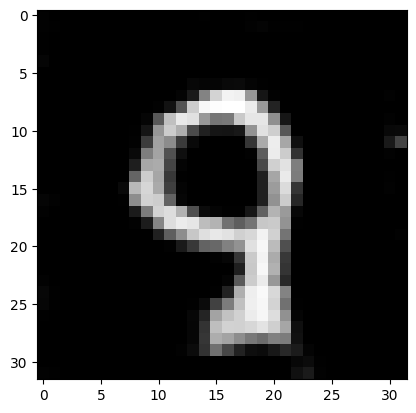

batch 300 gen loss: 0.05162668228149414, discr loss: 23.74985694885254


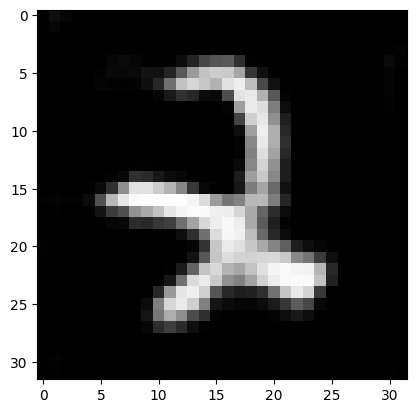

batch 400 gen loss: 0.2471192330121994, discr loss: 23.41120719909668


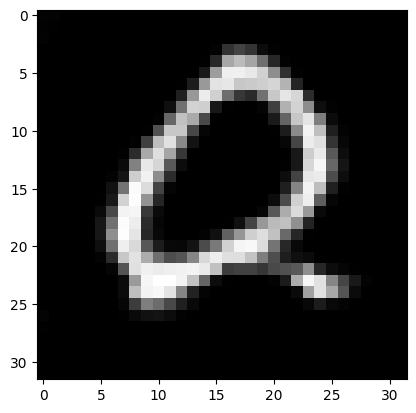

batch 500 gen loss: 0.6890634298324585, discr loss: 22.687803268432617


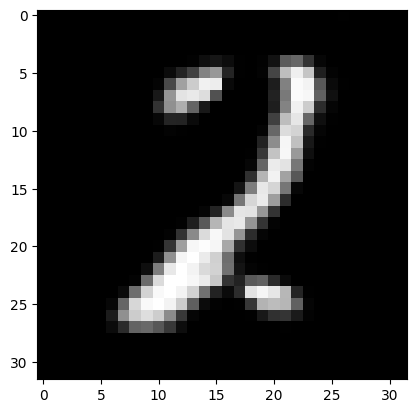

batch 600 gen loss: -2.663313388824463, discr loss: 22.08460807800293


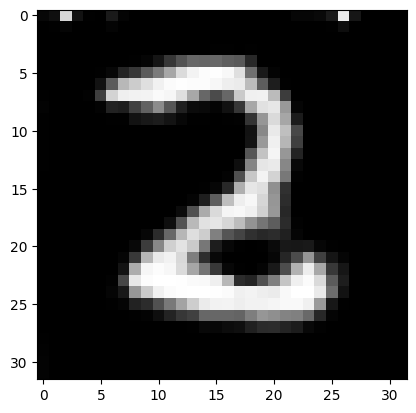

batch 700 gen loss: 0.7841499447822571, discr loss: 24.373029708862305


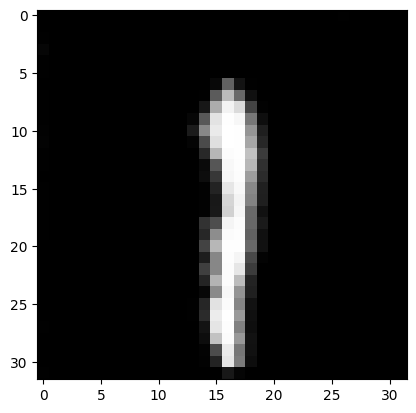

batch 800 gen loss: -3.6841366291046143, discr loss: 24.082883834838867


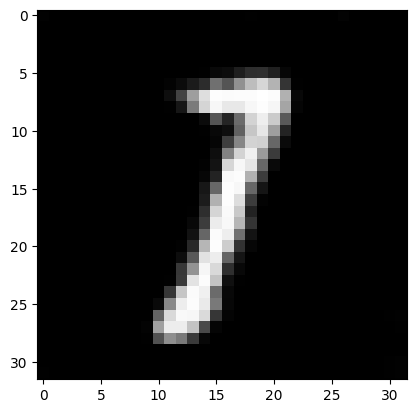

batch 900 gen loss: -2.902405023574829, discr loss: 28.818649291992188


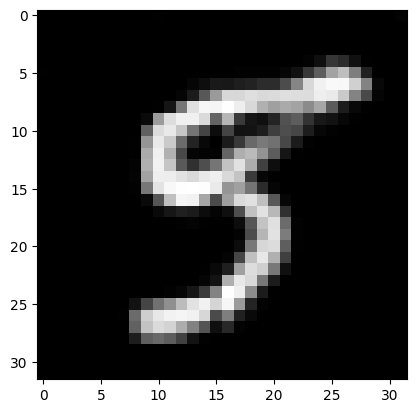

-1634.338623046875 23142.291015625


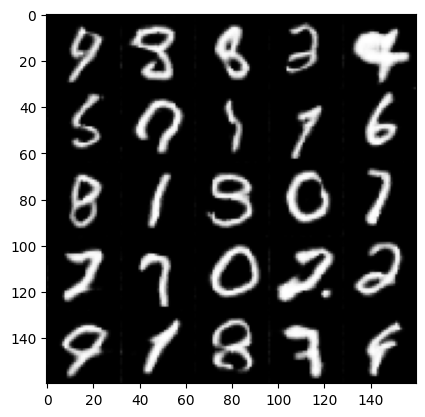

epoch 26:
batch 0 gen loss: 1.0078463554382324, discr loss: 28.94001007080078


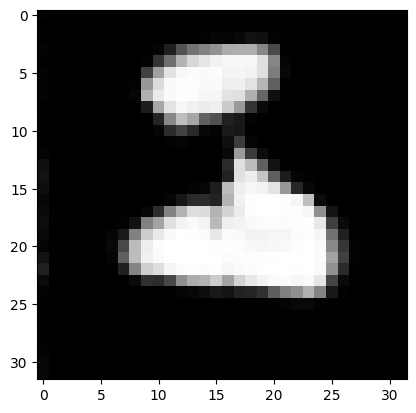

batch 100 gen loss: -3.279568672180176, discr loss: 28.600767135620117


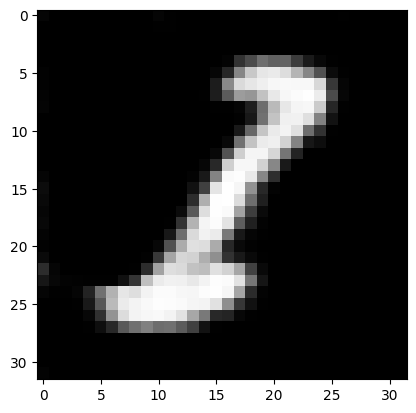

batch 200 gen loss: -3.284978151321411, discr loss: 28.885189056396484


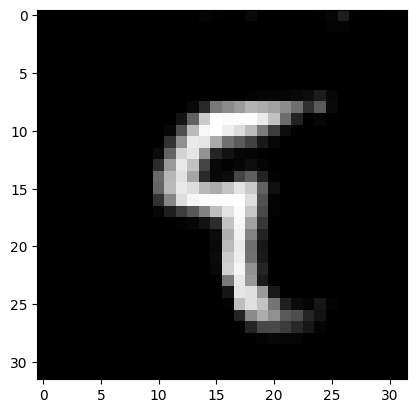

batch 300 gen loss: -3.3638598918914795, discr loss: 31.80252456665039


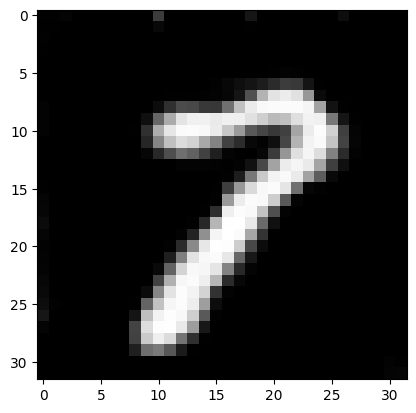

batch 400 gen loss: -13.659810066223145, discr loss: 33.250762939453125


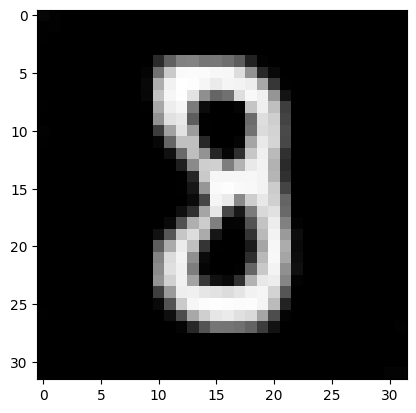

batch 500 gen loss: 0.07671549171209335, discr loss: 28.8234806060791


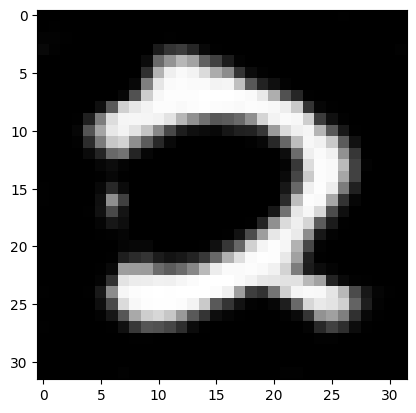

batch 600 gen loss: -7.324694633483887, discr loss: 28.089717864990234


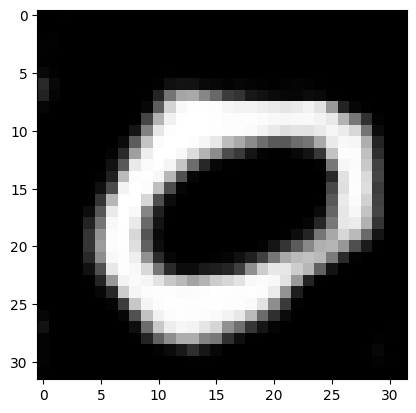

batch 700 gen loss: -7.3682732582092285, discr loss: 28.14545440673828


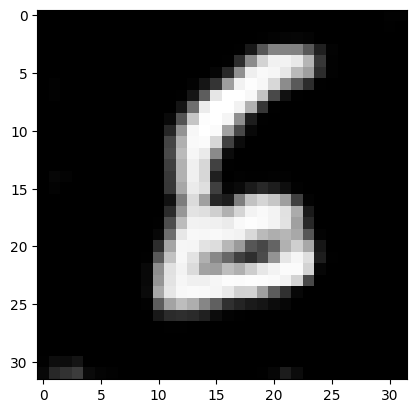

batch 800 gen loss: -3.324423313140869, discr loss: 27.864521026611328


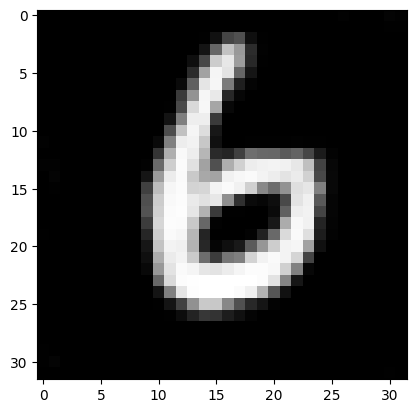

batch 900 gen loss: -3.387681722640991, discr loss: 28.169635772705078


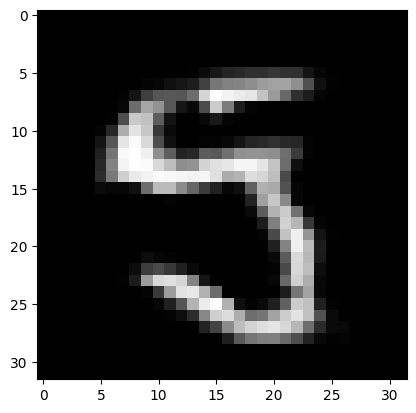

-3660.60693359375 27309.6171875


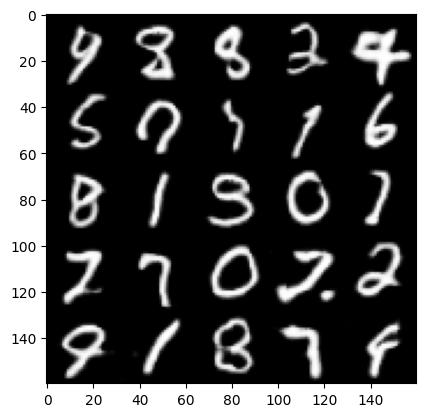

epoch 27:
batch 0 gen loss: -3.537713050842285, discr loss: 28.451431274414062


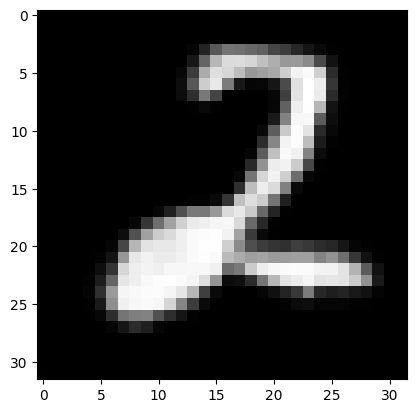

batch 100 gen loss: -6.885441303253174, discr loss: 31.96976661682129


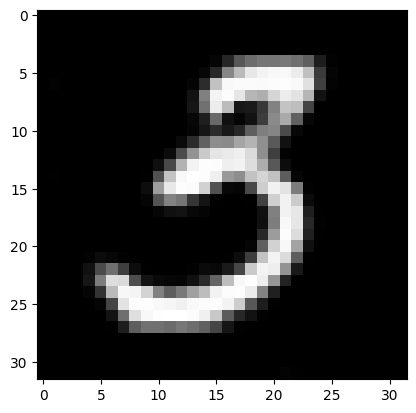

batch 200 gen loss: -7.037168502807617, discr loss: 35.9549674987793


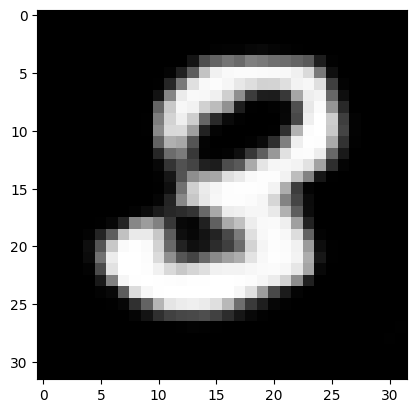

batch 300 gen loss: -7.3682732582092285, discr loss: 30.30298614501953


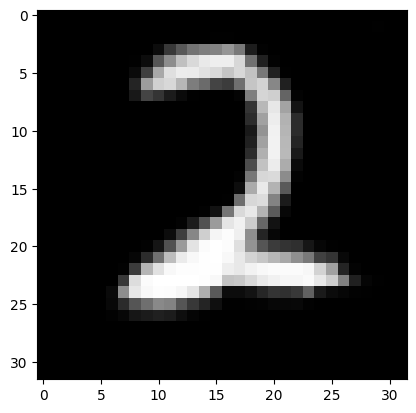

batch 400 gen loss: -6.855825424194336, discr loss: 39.81088638305664


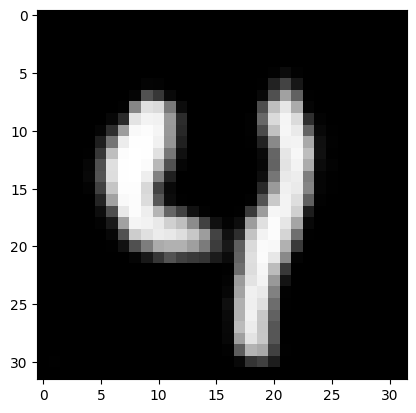

batch 500 gen loss: -3.6841366291046143, discr loss: 30.868452072143555


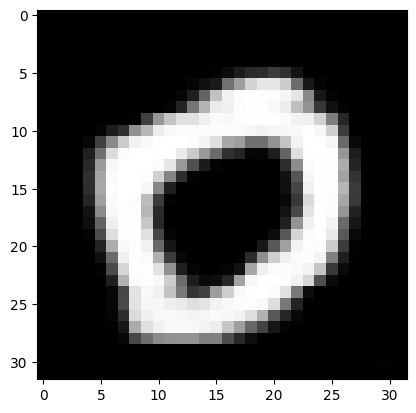

batch 600 gen loss: -4.426763534545898, discr loss: 34.028541564941406


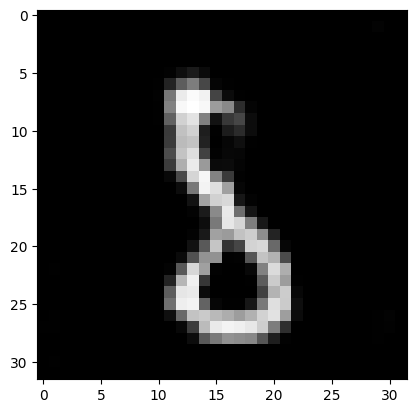

batch 700 gen loss: -3.6254239082336426, discr loss: 32.12114334106445


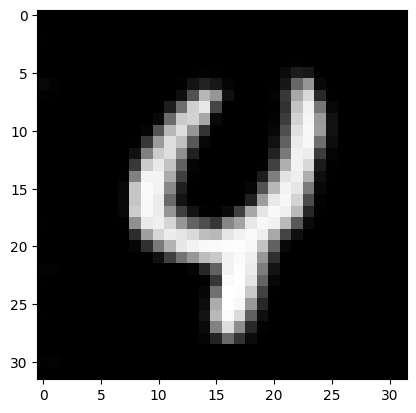

batch 800 gen loss: -7.128693580627441, discr loss: 31.96910858154297


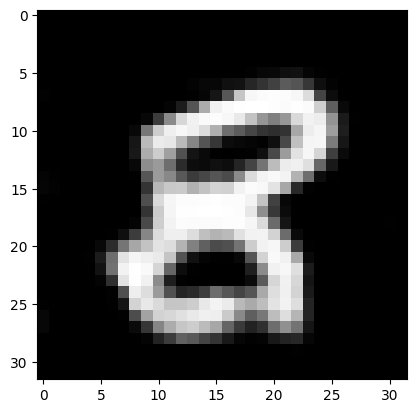

batch 900 gen loss: -6.842151641845703, discr loss: 31.803436279296875


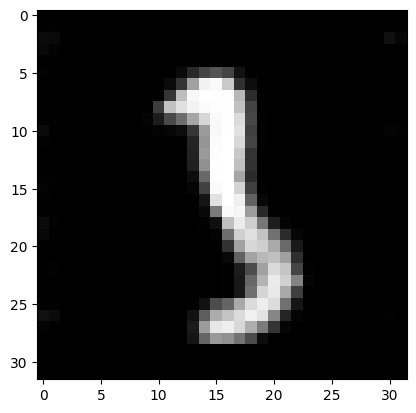

-4567.28662109375 29283.0546875


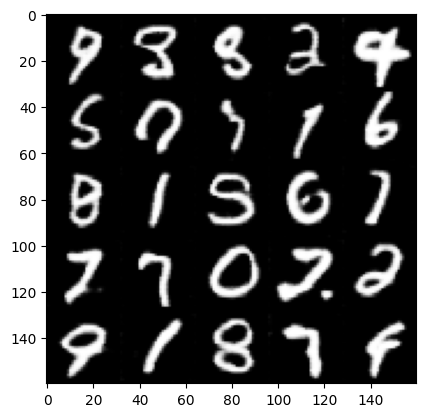

epoch 28:
batch 0 gen loss: -6.959159851074219, discr loss: 31.6490478515625


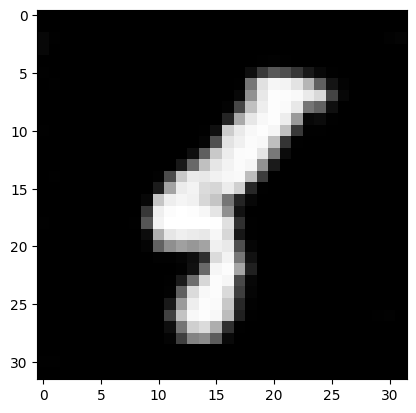

batch 100 gen loss: -3.2462806701660156, discr loss: 31.446231842041016


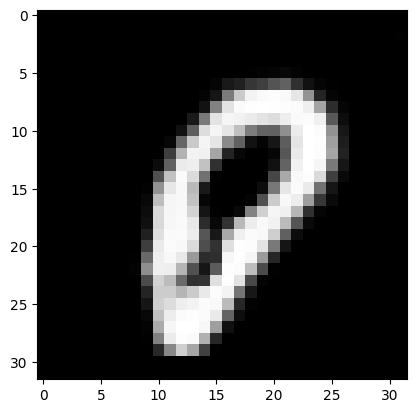

batch 200 gen loss: -3.6841366291046143, discr loss: 32.03567123413086


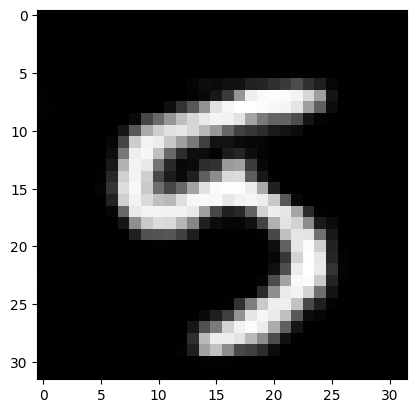

batch 300 gen loss: -6.9222002029418945, discr loss: 31.654109954833984


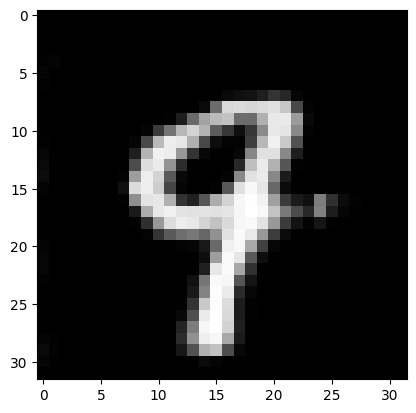

batch 400 gen loss: -6.9002814292907715, discr loss: 30.67241668701172


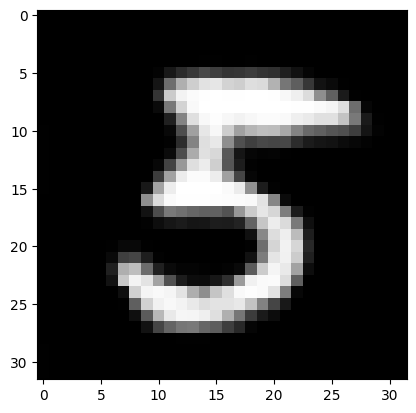

batch 500 gen loss: -6.848679542541504, discr loss: 29.884496688842773


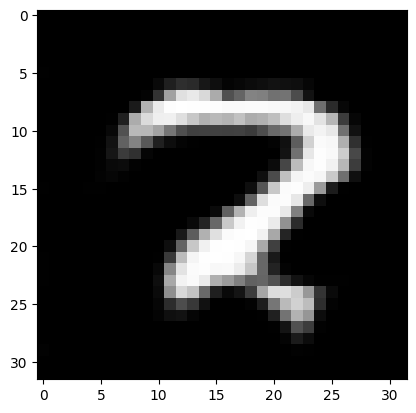

batch 600 gen loss: -6.417825698852539, discr loss: 31.284988403320312


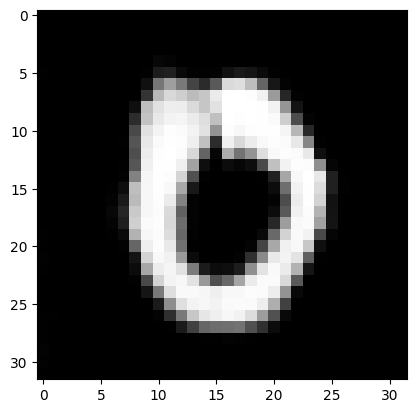

batch 700 gen loss: -6.356228351593018, discr loss: 30.597461700439453


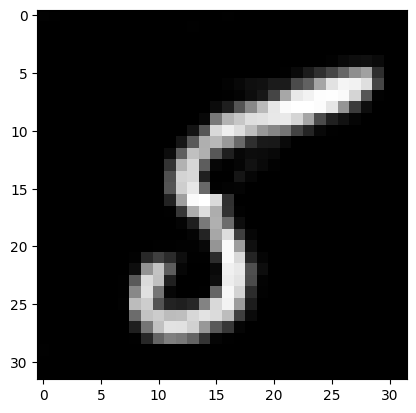

batch 800 gen loss: 0.5644416809082031, discr loss: 31.598876953125


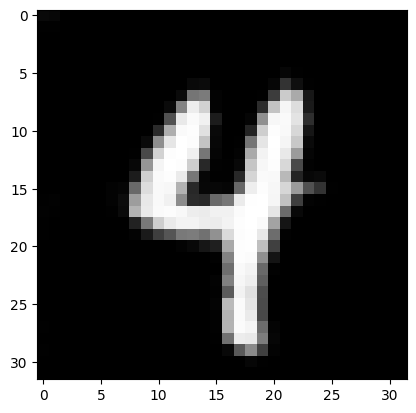

batch 900 gen loss: 0.5611944198608398, discr loss: 28.138959884643555


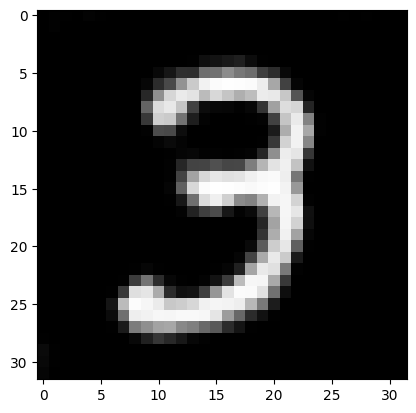

-4529.55908203125 28956.44921875


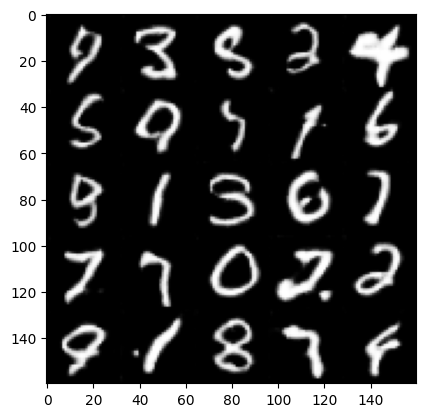

epoch 29:
batch 0 gen loss: -6.818181991577148, discr loss: 28.42451286315918


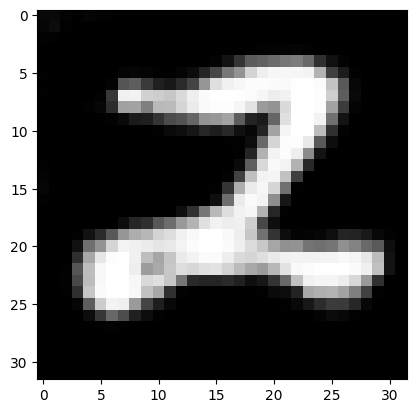

batch 100 gen loss: -3.1265785694122314, discr loss: 33.48553466796875


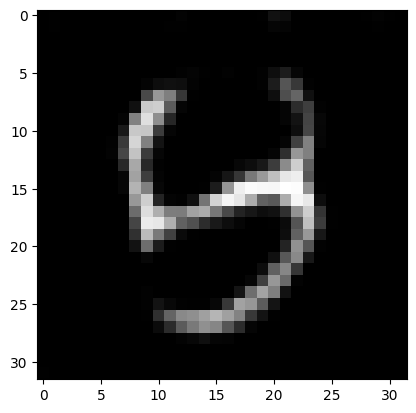

batch 200 gen loss: -3.6841366291046143, discr loss: 31.47841453552246


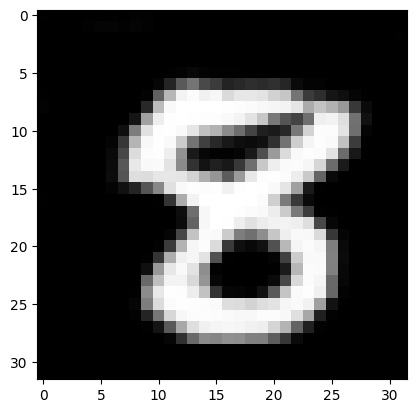

batch 300 gen loss: -3.084926128387451, discr loss: 27.435823440551758


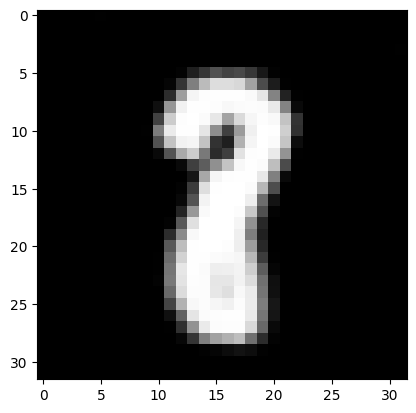

batch 400 gen loss: -6.866132736206055, discr loss: 27.24858283996582


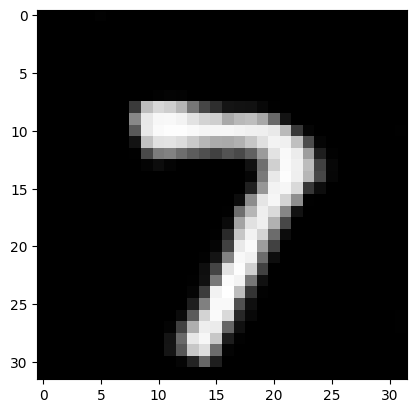

batch 500 gen loss: -3.1354150772094727, discr loss: 26.218833923339844


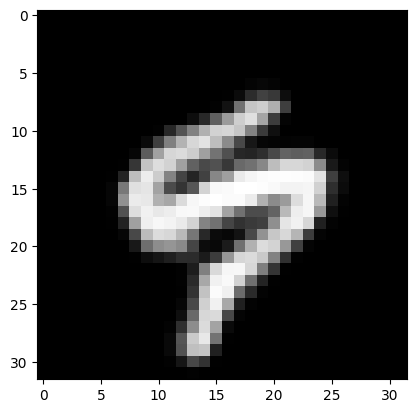

batch 600 gen loss: -3.6841366291046143, discr loss: 30.070953369140625


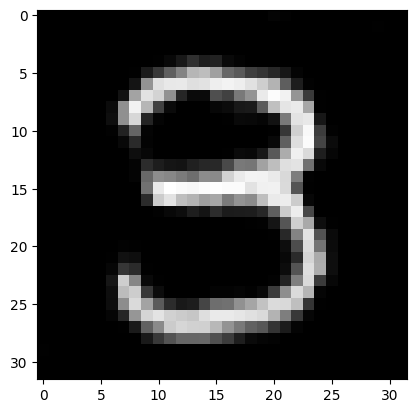

batch 700 gen loss: -3.4695091247558594, discr loss: 26.544734954833984


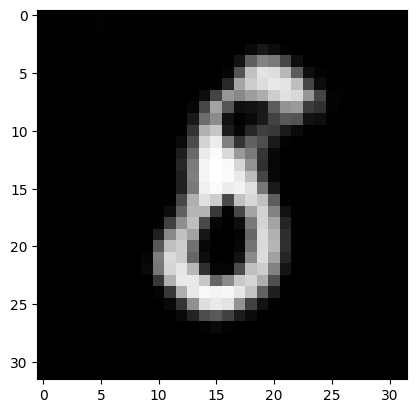

batch 800 gen loss: 0.5602883696556091, discr loss: 26.38568115234375


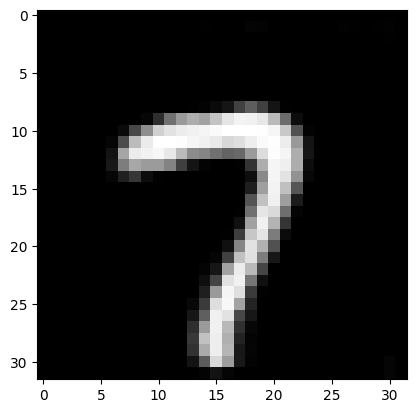

batch 900 gen loss: -3.6841366291046143, discr loss: 30.264848709106445


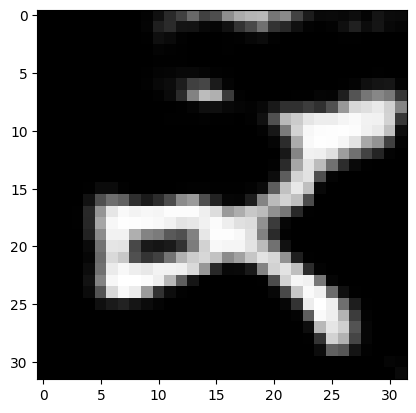

-3418.315185546875 26620.353515625


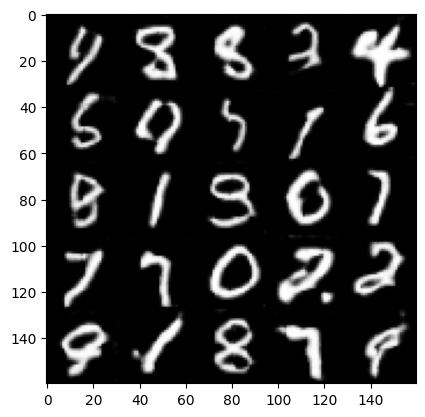

epoch 30:
batch 0 gen loss: -5.560486793518066, discr loss: 29.403562545776367


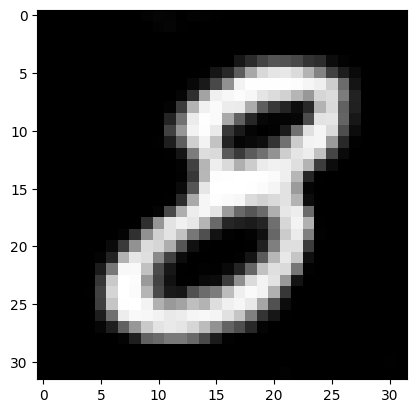

batch 100 gen loss: 0.5397384762763977, discr loss: 27.344806671142578


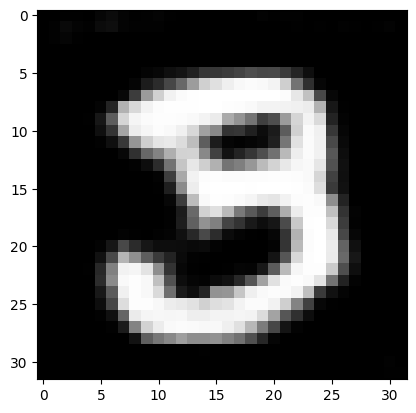

batch 200 gen loss: 0.1317780464887619, discr loss: 26.959630966186523


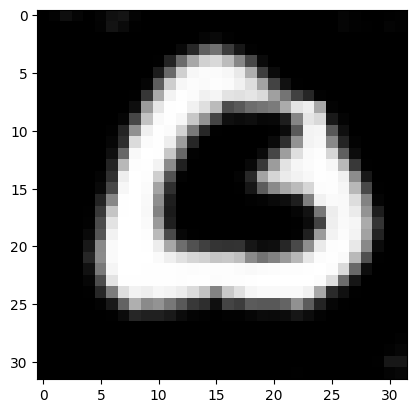

batch 300 gen loss: -3.443777084350586, discr loss: 30.5701904296875


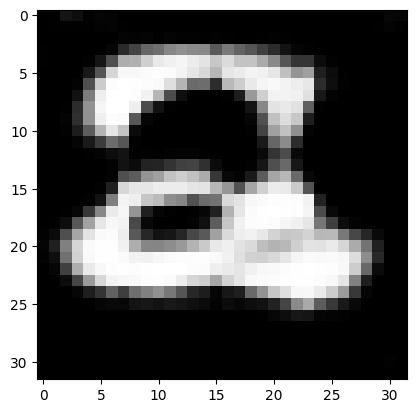

batch 400 gen loss: 0.3014492094516754, discr loss: 36.30164337158203


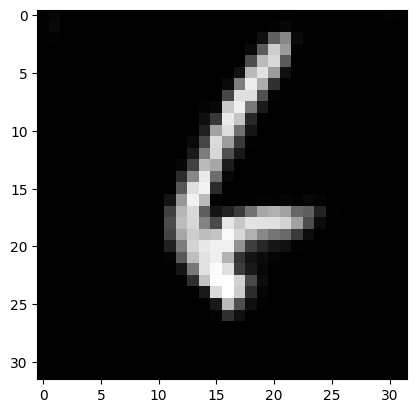

batch 500 gen loss: 0.31554585695266724, discr loss: 35.02713394165039


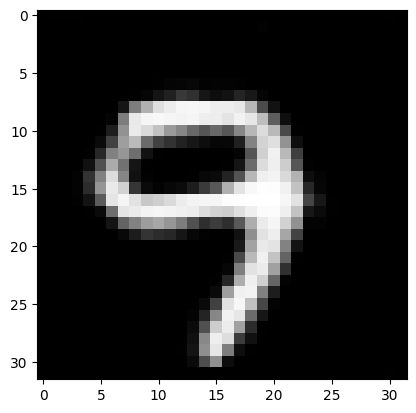

batch 600 gen loss: -3.3013503551483154, discr loss: 27.873214721679688


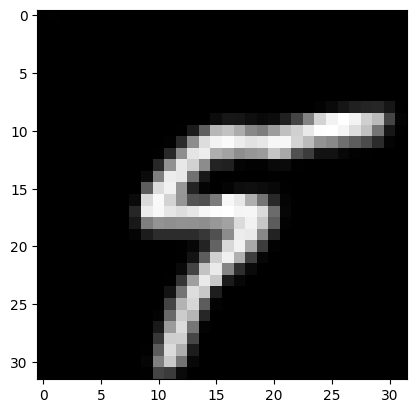

batch 700 gen loss: 0.3155132234096527, discr loss: 26.475976943969727


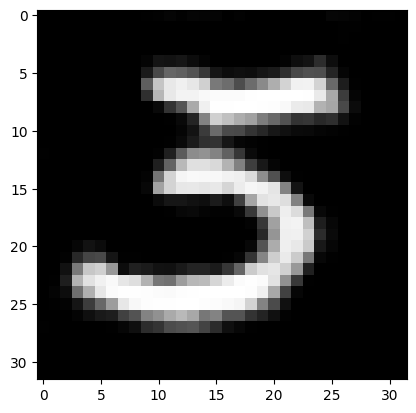

batch 800 gen loss: -3.6841366291046143, discr loss: 27.111906051635742


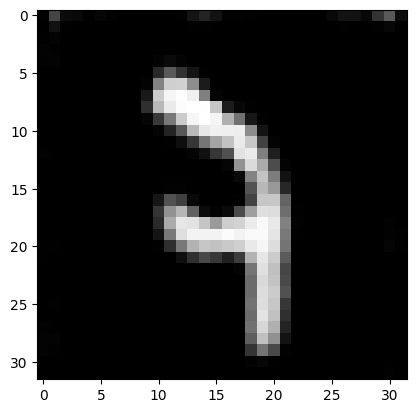

batch 900 gen loss: -3.6841366291046143, discr loss: 26.877155303955078


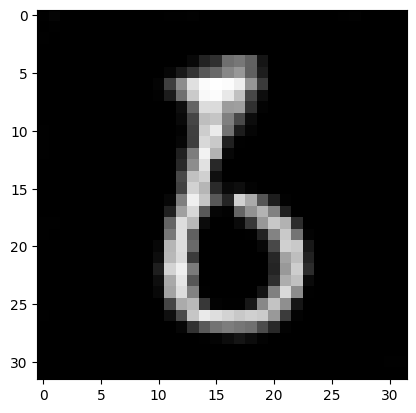

-3350.27783203125 28066.73046875


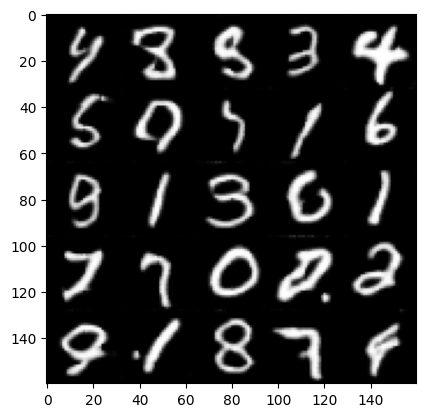

epoch 31:
batch 0 gen loss: -3.1378374099731445, discr loss: 26.533878326416016


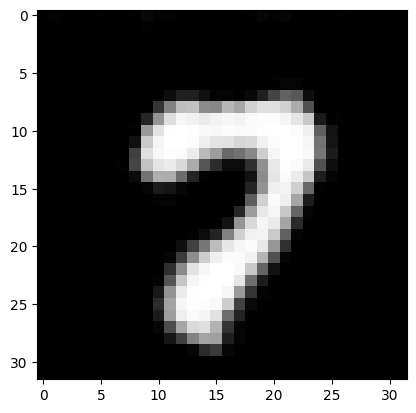

batch 100 gen loss: 0.44891420006752014, discr loss: 26.15020179748535


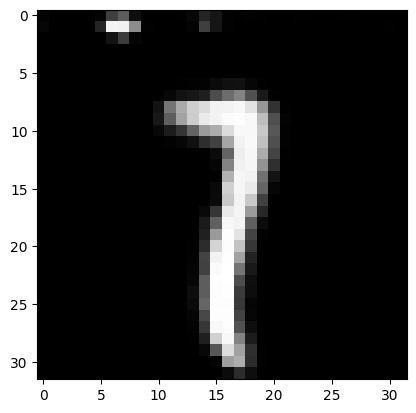

batch 200 gen loss: -3.6841366291046143, discr loss: 35.85940933227539


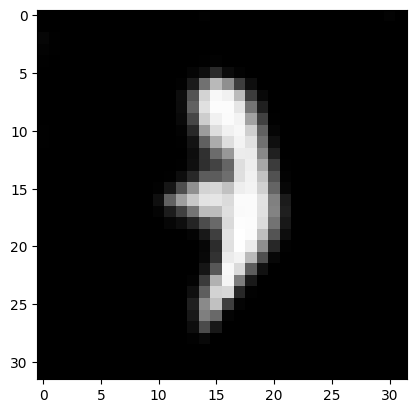

batch 300 gen loss: 1.0700528621673584, discr loss: 34.76887893676758


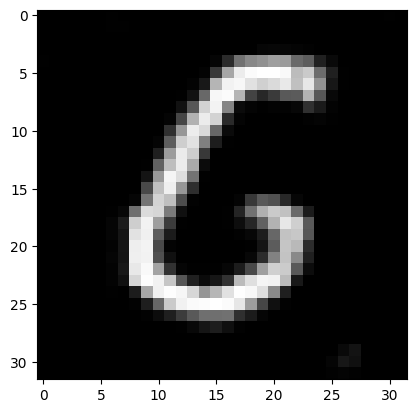

batch 400 gen loss: -3.306985378265381, discr loss: 34.6802864074707


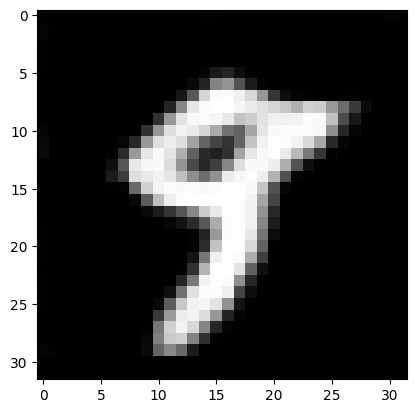

batch 500 gen loss: -3.1499621868133545, discr loss: 38.913246154785156


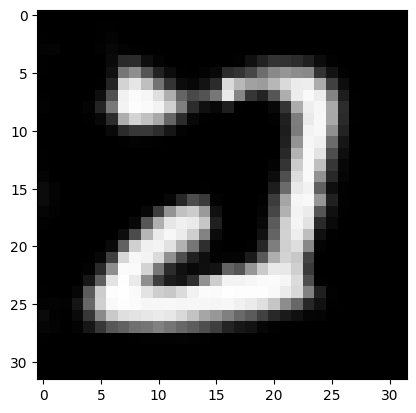

batch 600 gen loss: -6.5022993087768555, discr loss: 38.58401107788086


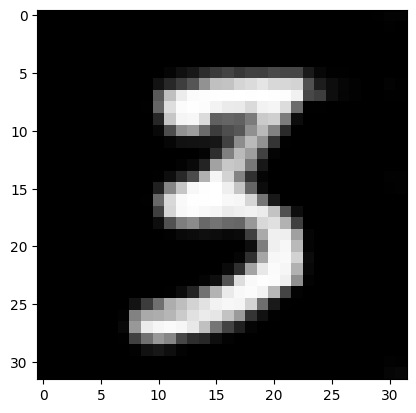

batch 700 gen loss: -6.4988837242126465, discr loss: 38.583229064941406


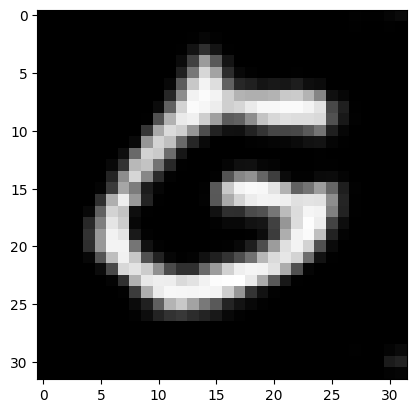

batch 800 gen loss: -6.452028274536133, discr loss: 38.52702713012695


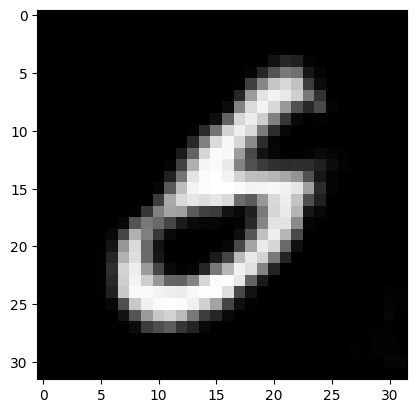

batch 900 gen loss: -6.767221927642822, discr loss: 38.888065338134766


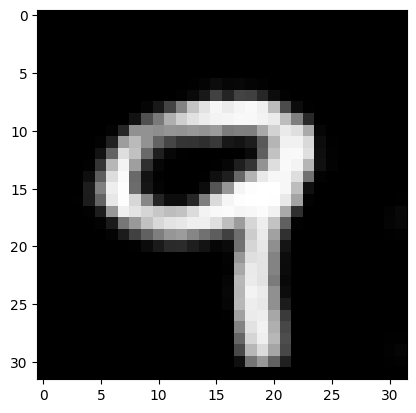

-3964.9345703125 32987.0


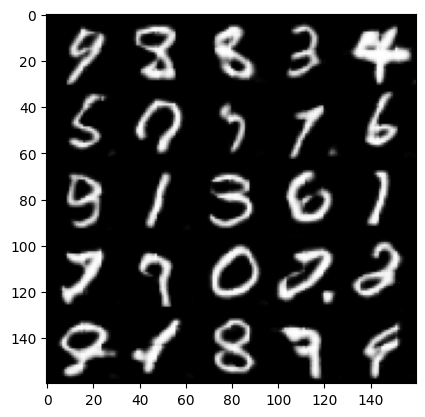

epoch 32:
batch 0 gen loss: -3.285348415374756, discr loss: 38.74366760253906


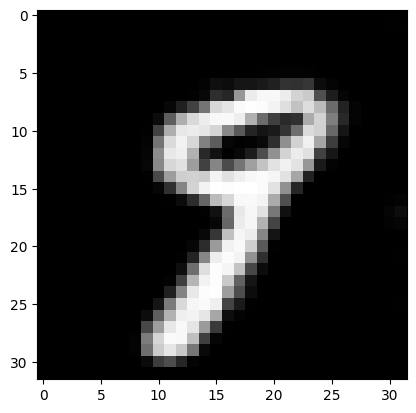

batch 100 gen loss: -6.91207218170166, discr loss: 38.495182037353516


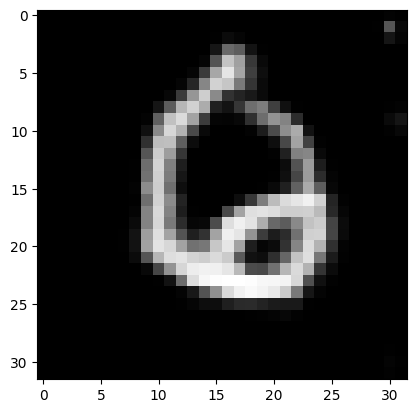

batch 200 gen loss: -10.519308090209961, discr loss: 38.39606475830078


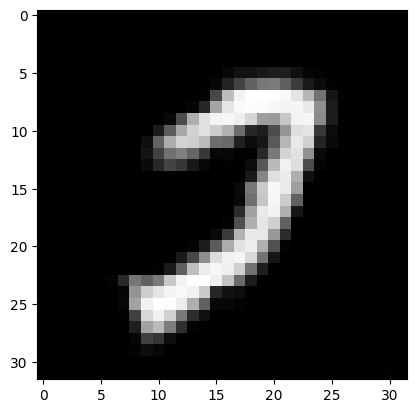

batch 300 gen loss: -6.8259148597717285, discr loss: 38.320220947265625


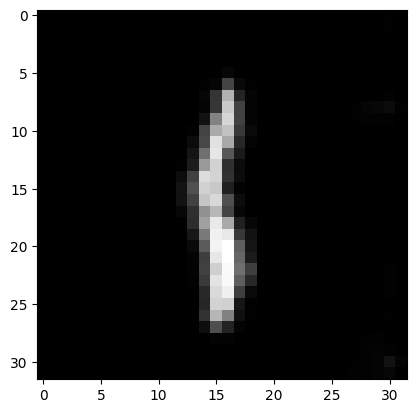

batch 400 gen loss: 0.5556641817092896, discr loss: 39.47350311279297


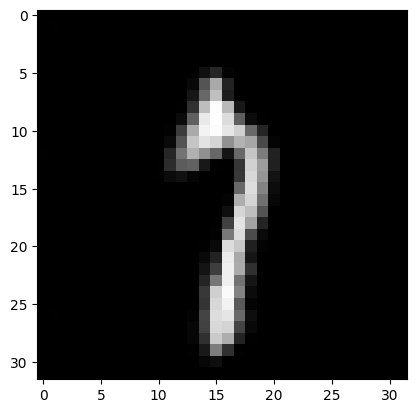

batch 500 gen loss: -7.3682732582092285, discr loss: 38.55521011352539


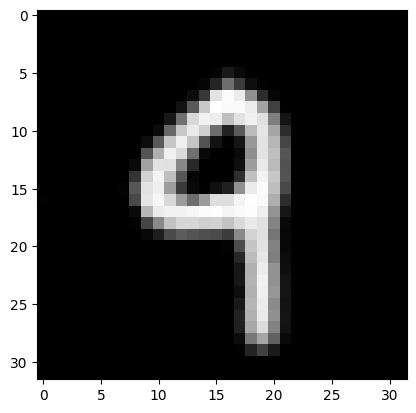

batch 600 gen loss: -7.3682732582092285, discr loss: 38.33164596557617


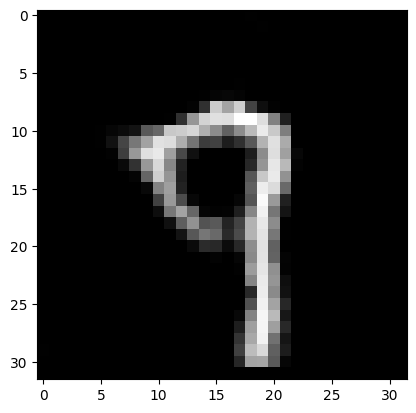

batch 700 gen loss: -6.240907669067383, discr loss: 38.30427551269531


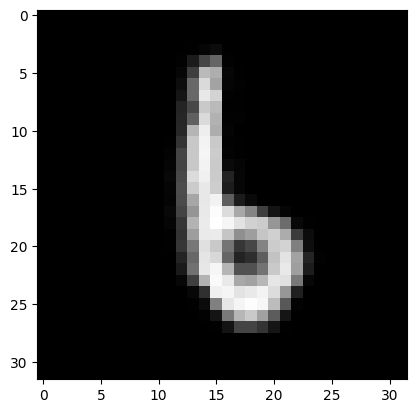

batch 800 gen loss: -3.130741596221924, discr loss: 38.291072845458984


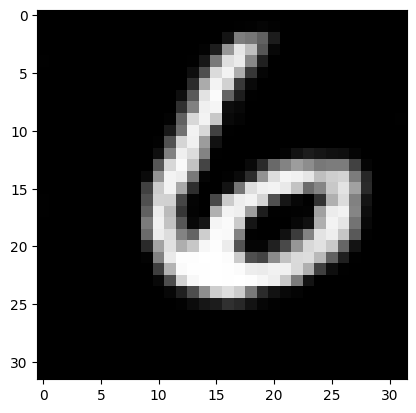

batch 900 gen loss: -3.6841366291046143, discr loss: 38.266578674316406


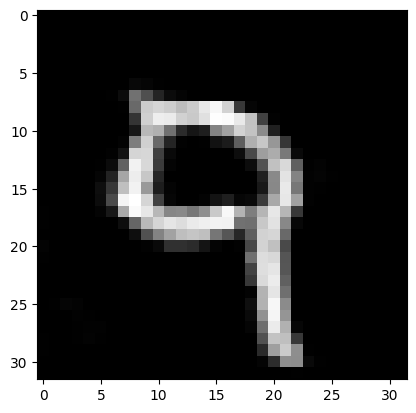

-4850.09423828125 36156.17578125


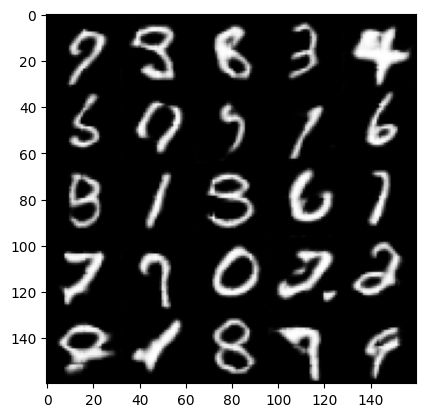

epoch 33:
batch 0 gen loss: -3.1858723163604736, discr loss: 38.355628967285156


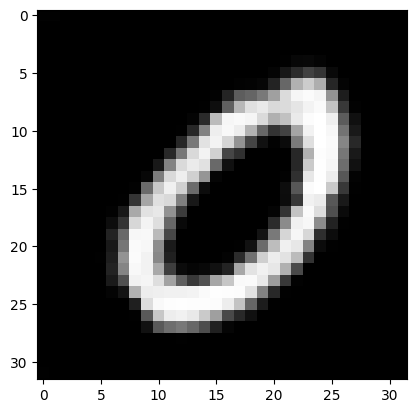

batch 100 gen loss: -3.121049165725708, discr loss: 38.890838623046875


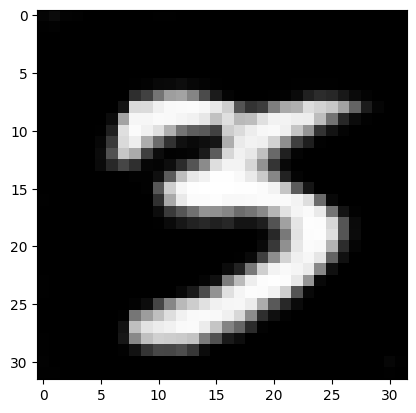

batch 200 gen loss: -6.828160762786865, discr loss: 39.083011627197266


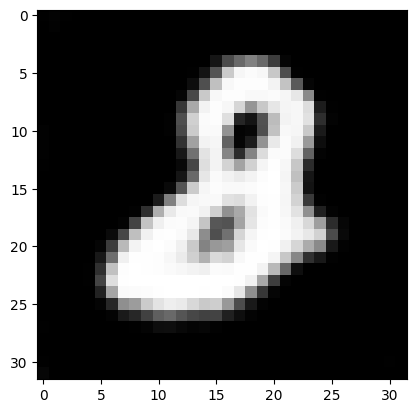

batch 300 gen loss: -3.133908987045288, discr loss: 45.27780532836914


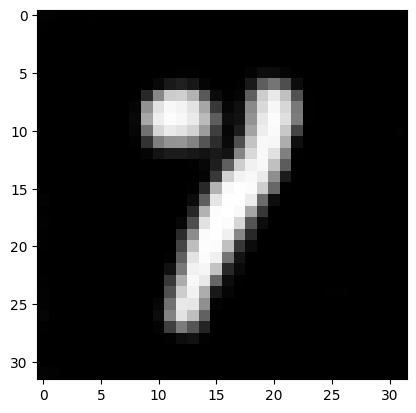

batch 400 gen loss: -3.6841366291046143, discr loss: 39.41991424560547


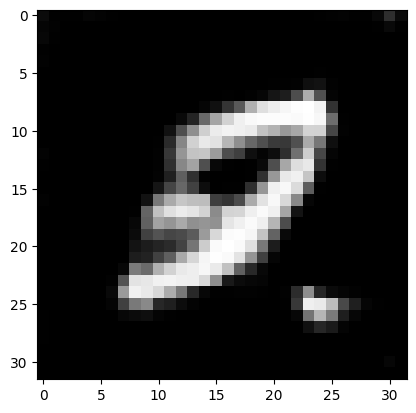

batch 500 gen loss: -11.010305404663086, discr loss: 39.46270751953125


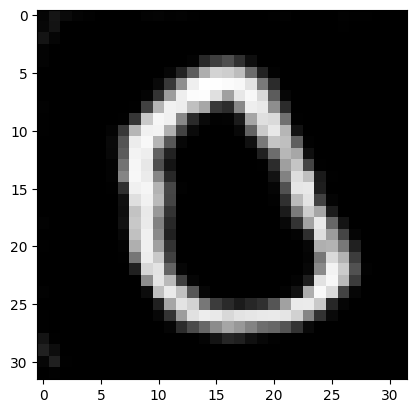

batch 600 gen loss: -7.3682732582092285, discr loss: 39.212646484375


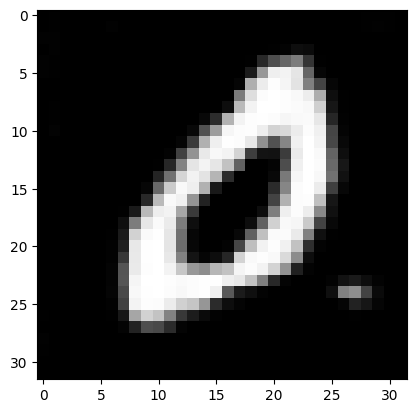

batch 700 gen loss: -3.208897829055786, discr loss: 35.96372985839844


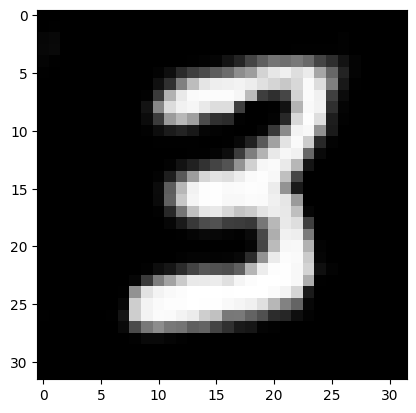

batch 800 gen loss: 0.6225376725196838, discr loss: 32.362388610839844


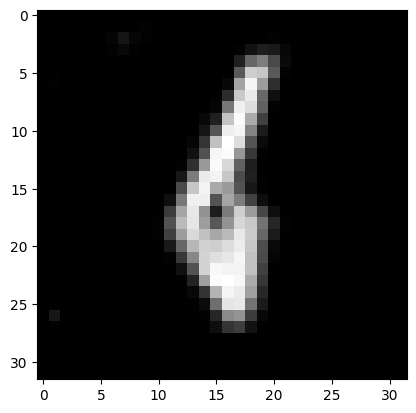

batch 900 gen loss: -1.3470125198364258, discr loss: 32.85359191894531


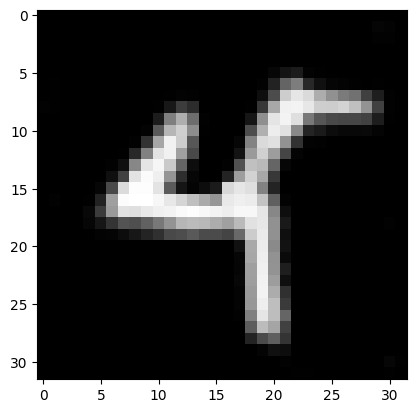

-4291.90966796875 35680.921875


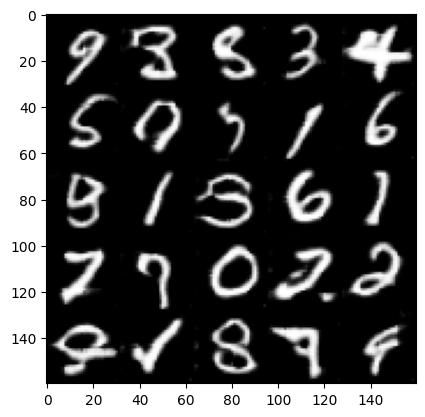

epoch 34:
batch 0 gen loss: -3.842345952987671, discr loss: 31.853744506835938


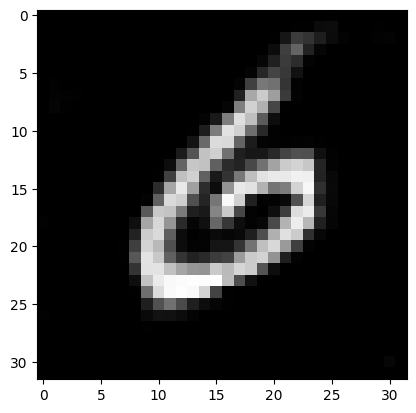

batch 100 gen loss: 0.338615745306015, discr loss: 28.103939056396484


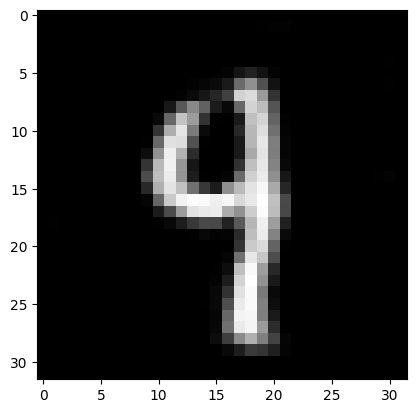

batch 200 gen loss: 1.0981100797653198, discr loss: 27.581703186035156


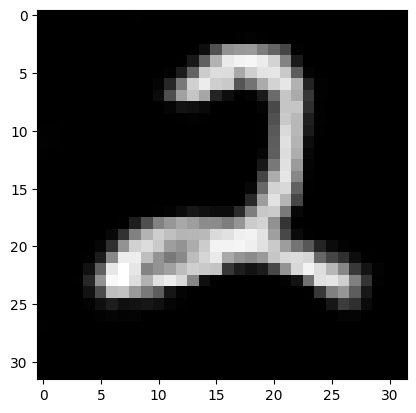

batch 300 gen loss: 0.6903610229492188, discr loss: 27.7435245513916


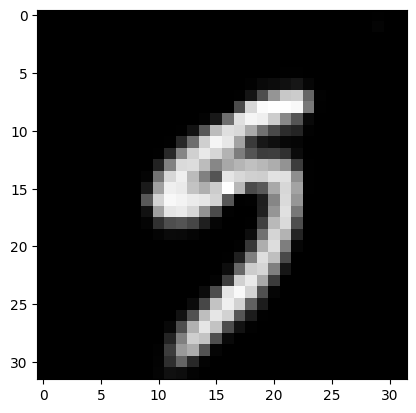

batch 400 gen loss: -1.0177390575408936, discr loss: 29.740304946899414


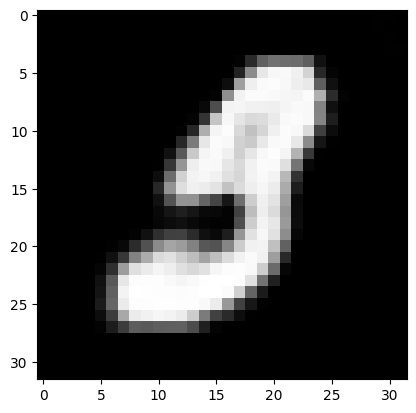

batch 500 gen loss: 0.6662935614585876, discr loss: 26.394203186035156


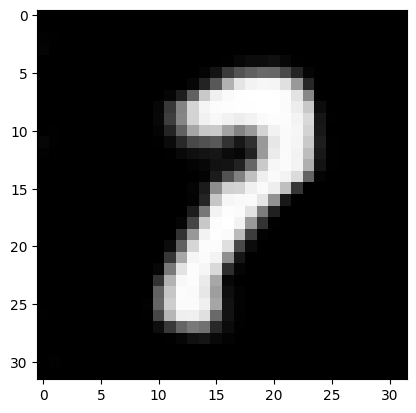

batch 600 gen loss: 0.5009669065475464, discr loss: 30.32343864440918


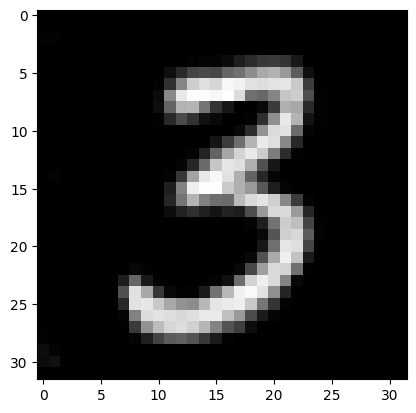

batch 700 gen loss: -8.05264663696289, discr loss: 36.49138259887695


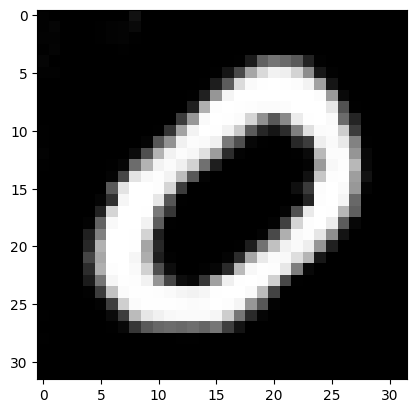

batch 800 gen loss: 0.174203559756279, discr loss: 31.83135986328125


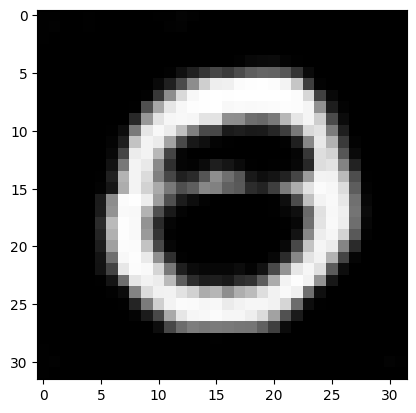

batch 900 gen loss: 1.1350531578063965, discr loss: 31.262832641601562


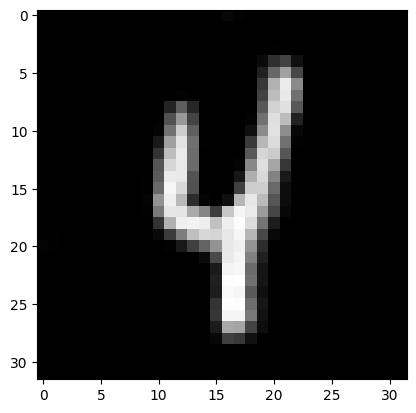

-552.8018798828125 28444.171875


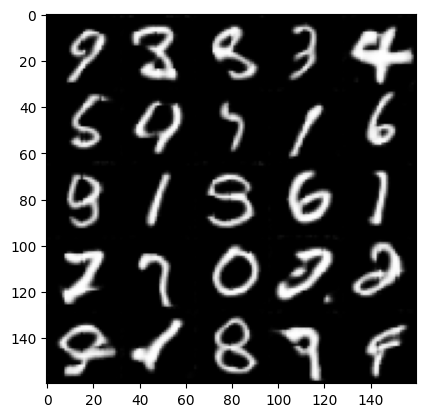

epoch 35:
batch 0 gen loss: -3.6002464294433594, discr loss: 31.99217414855957


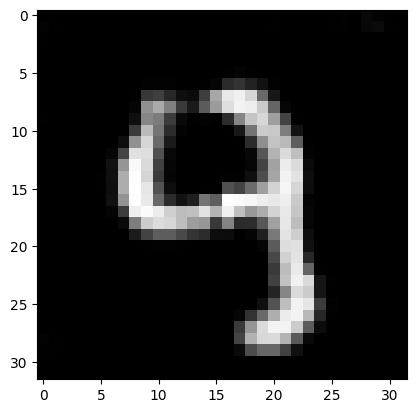

batch 100 gen loss: 0.0693088173866272, discr loss: 31.10502052307129


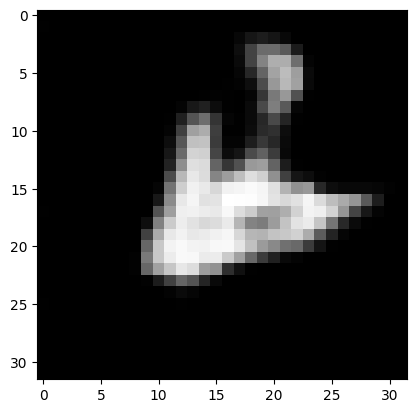

batch 200 gen loss: -2.9349961280822754, discr loss: 31.26954460144043


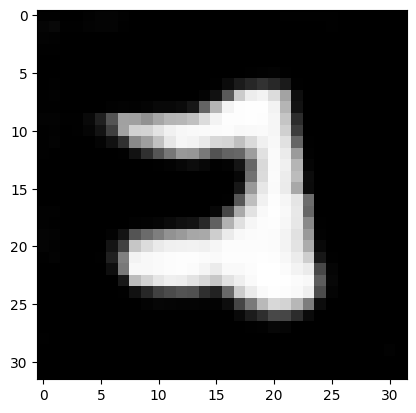

batch 300 gen loss: 0.33164629340171814, discr loss: 30.937572479248047


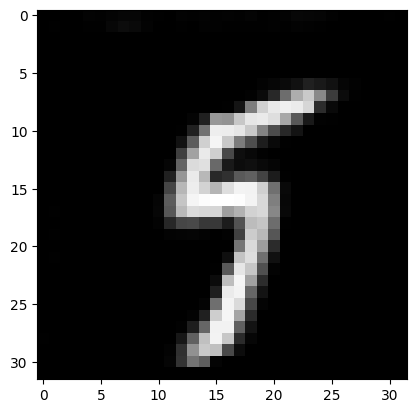

batch 400 gen loss: -7.748171806335449, discr loss: 35.16029357910156


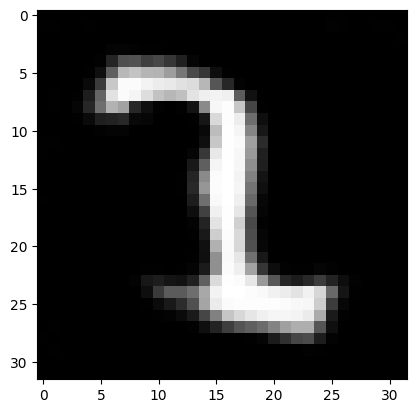

batch 500 gen loss: 0.5951988697052002, discr loss: 35.42719650268555


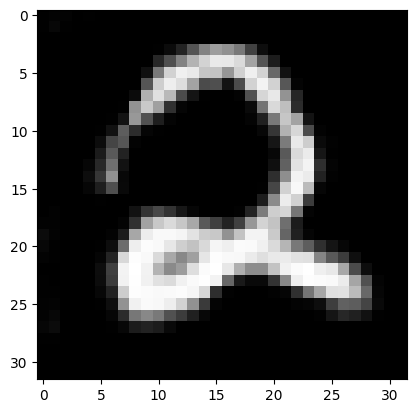

batch 600 gen loss: -0.049158815294504166, discr loss: 35.15433883666992


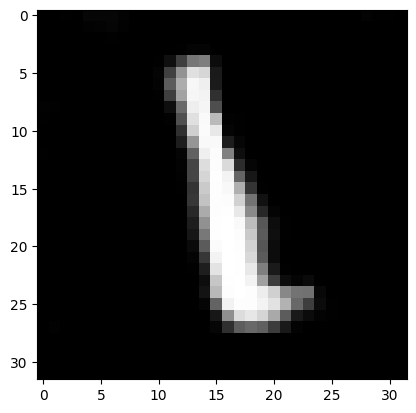

batch 700 gen loss: -3.832740545272827, discr loss: 35.86042404174805


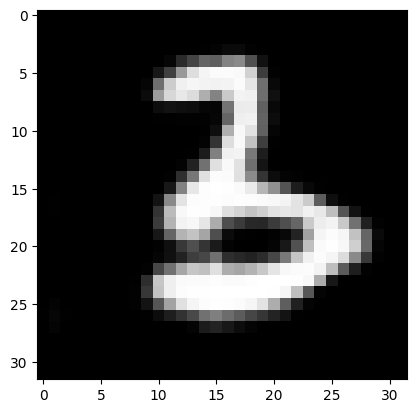

batch 800 gen loss: 0.0, discr loss: 35.49858474731445


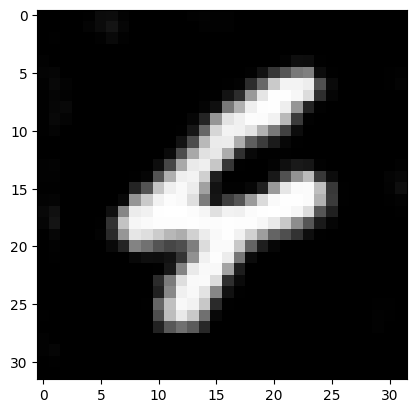

batch 900 gen loss: -7.283439636230469, discr loss: 36.56533432006836


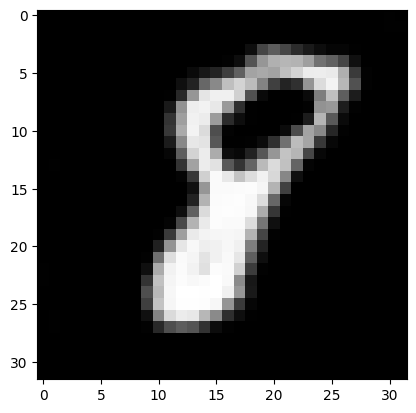

-2527.3271484375 31723.90234375


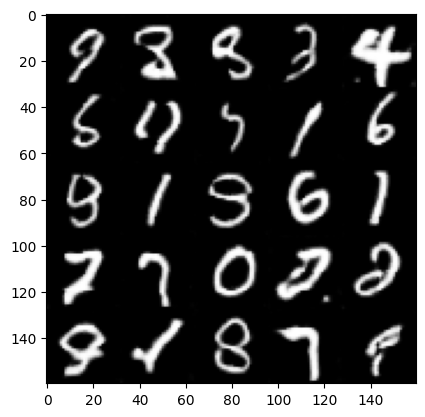

epoch 36:
batch 0 gen loss: 0.2604714334011078, discr loss: 36.07109451293945


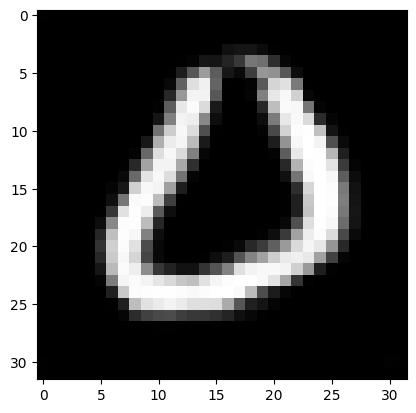

batch 100 gen loss: -2.920013427734375, discr loss: 34.68982696533203


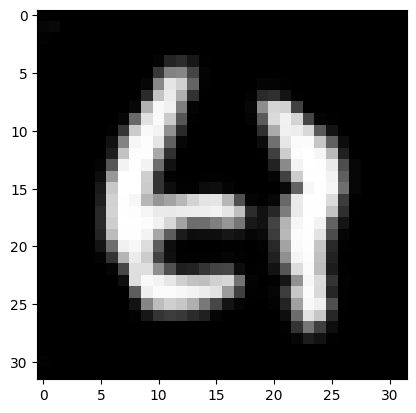

batch 200 gen loss: -2.5139713287353516, discr loss: 34.599918365478516


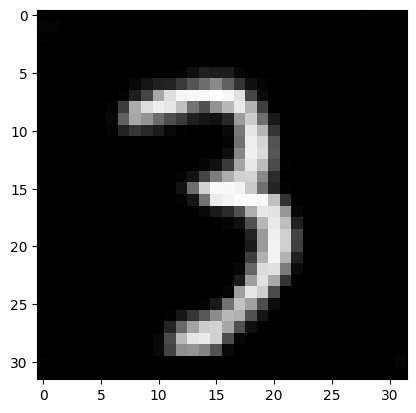

batch 300 gen loss: 0.7980595827102661, discr loss: 35.895511627197266


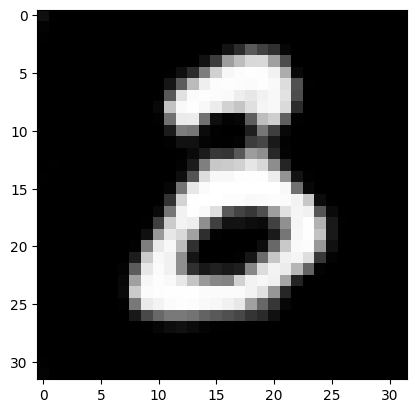

batch 400 gen loss: -7.011558532714844, discr loss: 35.07221603393555


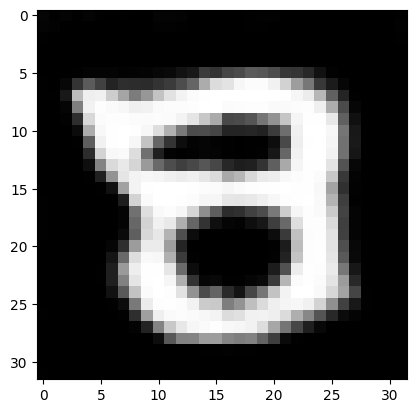

batch 500 gen loss: -7.3682966232299805, discr loss: 34.446346282958984


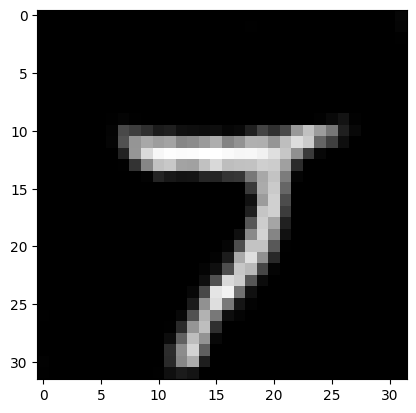

batch 600 gen loss: -2.7084860801696777, discr loss: 34.24970245361328


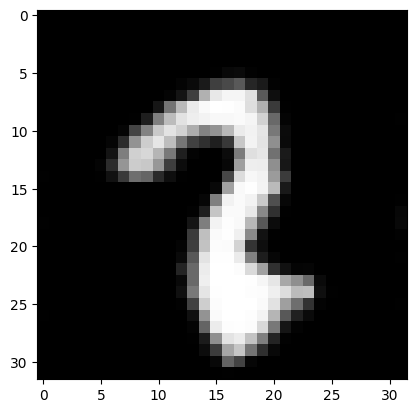

batch 700 gen loss: -2.6089961528778076, discr loss: 34.22062301635742


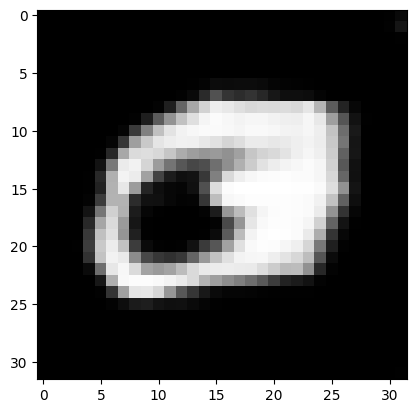

batch 800 gen loss: -6.461356163024902, discr loss: 34.276065826416016


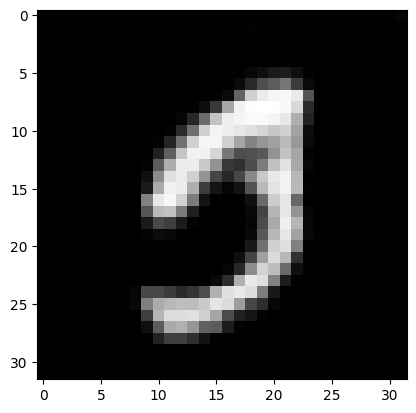

batch 900 gen loss: -3.1876280307769775, discr loss: 34.219844818115234


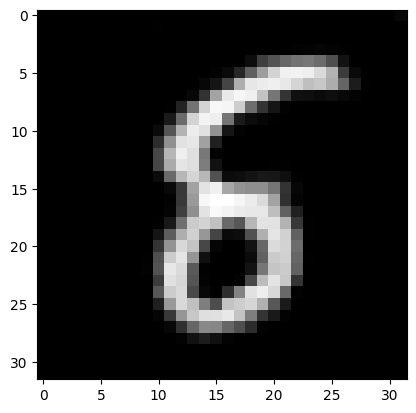

-2860.01171875 32716.72265625


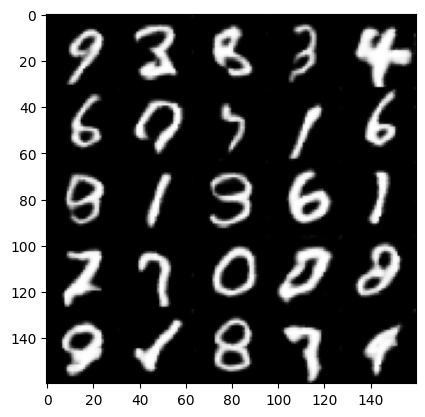

epoch 37:
batch 0 gen loss: -3.1199300289154053, discr loss: 34.05783462524414


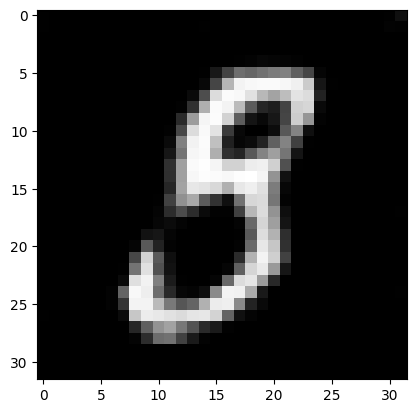

batch 100 gen loss: -3.8223156929016113, discr loss: 40.69377899169922


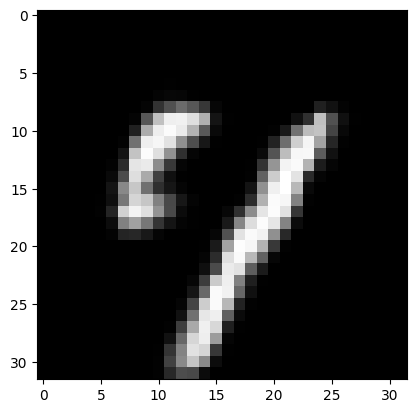

batch 200 gen loss: -7.263227462768555, discr loss: 39.21934509277344


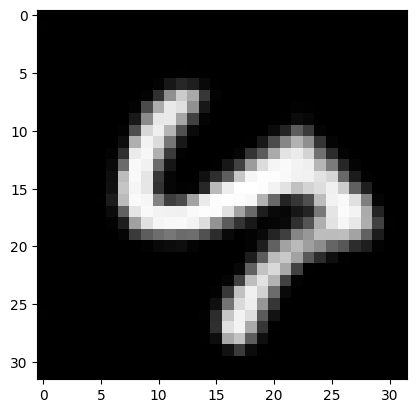

batch 300 gen loss: -3.6841366291046143, discr loss: 35.40837097167969


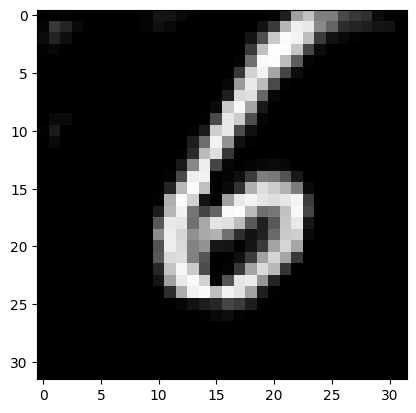

batch 400 gen loss: -3.3498599529266357, discr loss: 35.223960876464844


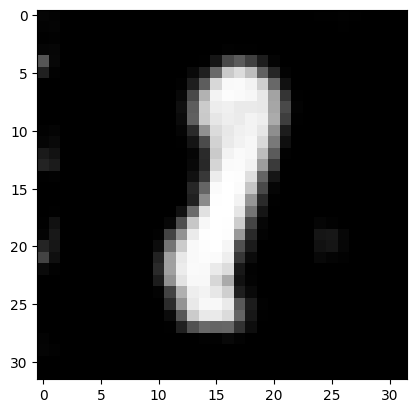

batch 500 gen loss: -3.3036632537841797, discr loss: 34.913543701171875


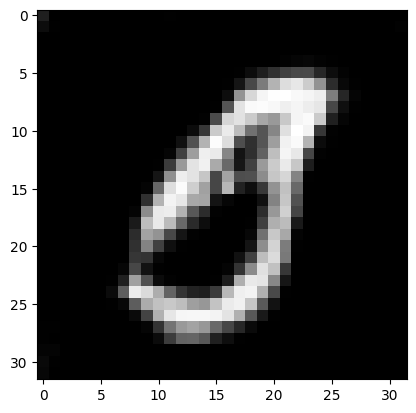

batch 600 gen loss: -2.796224355697632, discr loss: 34.98932647705078


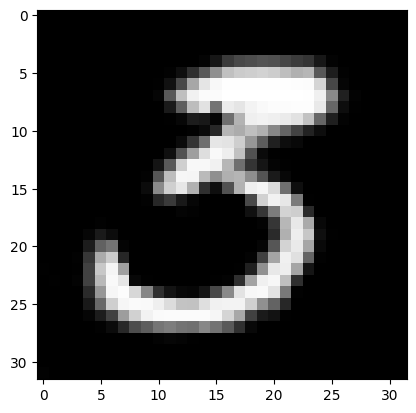

batch 700 gen loss: -6.591586112976074, discr loss: 35.161537170410156


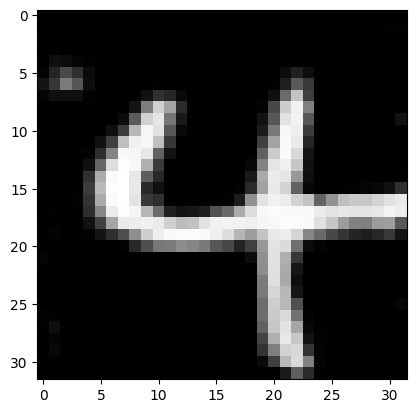

batch 800 gen loss: 0.9754131436347961, discr loss: 34.80315399169922


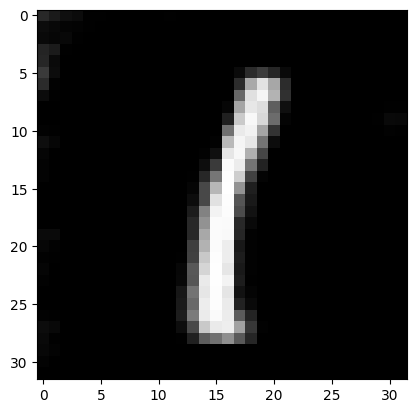

batch 900 gen loss: 0.09815143793821335, discr loss: 34.86298370361328


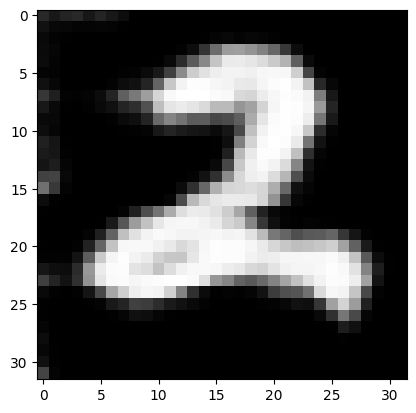

-3522.476318359375 33724.91015625


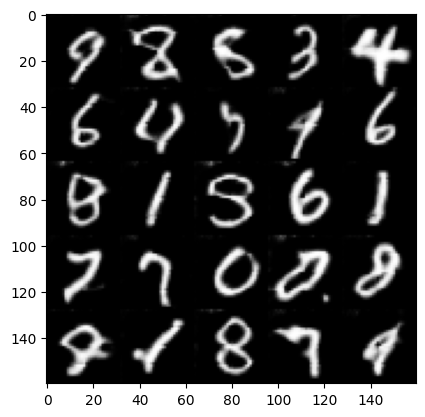

epoch 38:
batch 0 gen loss: 0.5308571457862854, discr loss: 34.66934585571289


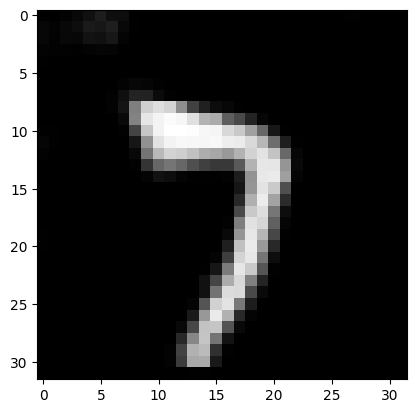

batch 100 gen loss: -2.865276336669922, discr loss: 34.909271240234375


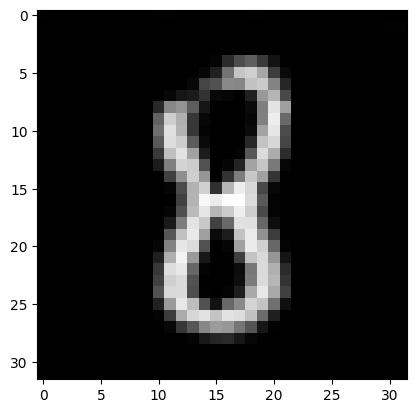

batch 200 gen loss: -3.120331287384033, discr loss: 34.28642654418945


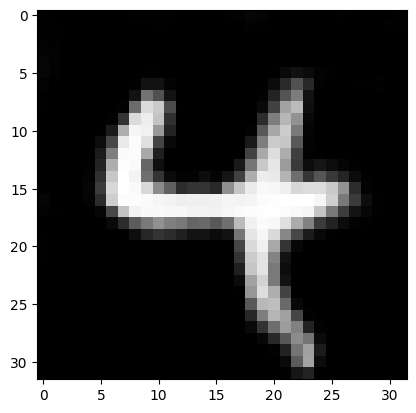

batch 300 gen loss: -2.904365062713623, discr loss: 31.864418029785156


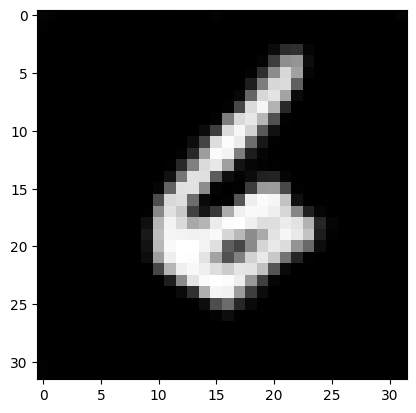

batch 400 gen loss: -2.387185573577881, discr loss: 31.051626205444336


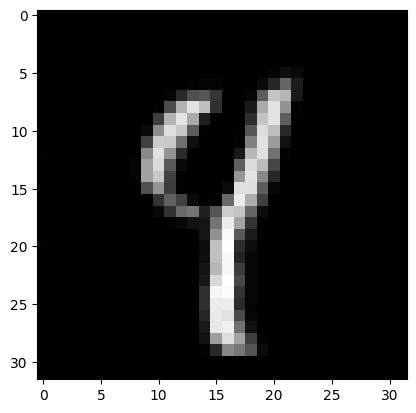

batch 500 gen loss: 0.5059828758239746, discr loss: 30.68438148498535


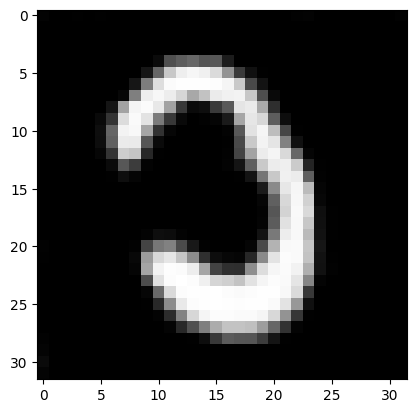

batch 600 gen loss: -3.1586501598358154, discr loss: 30.595251083374023


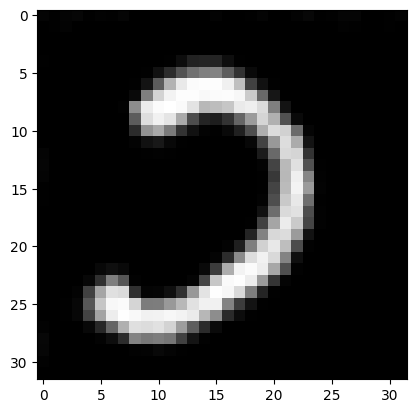

batch 700 gen loss: 1.6115609407424927, discr loss: 30.26263999938965


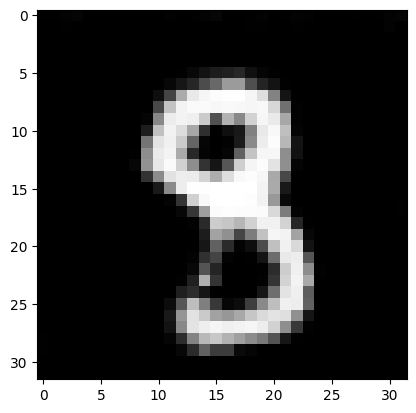

batch 800 gen loss: 0.5132313370704651, discr loss: 32.771846771240234


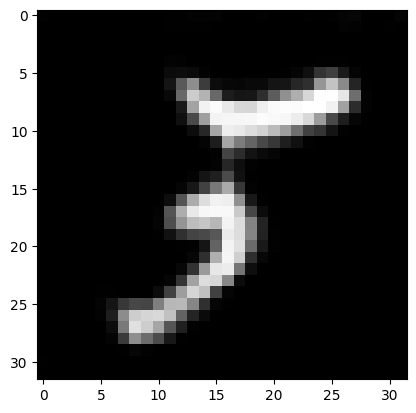

batch 900 gen loss: -2.2453365325927734, discr loss: 31.4459285736084


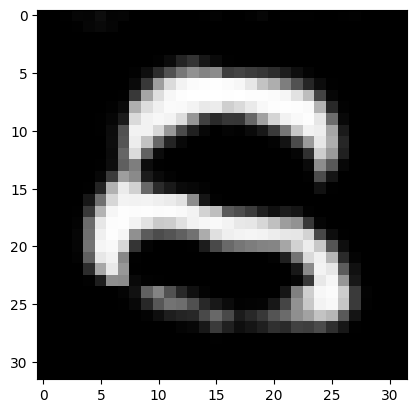

-1359.544921875 30478.2265625


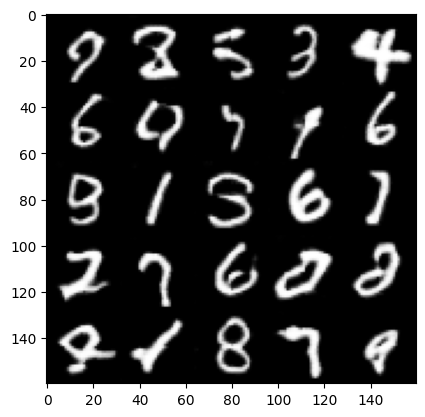

epoch 39:
batch 0 gen loss: 0.5710642337799072, discr loss: 32.936702728271484


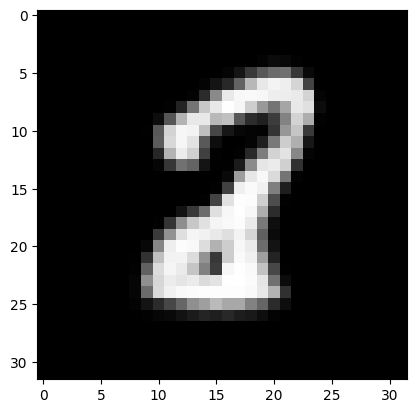

batch 100 gen loss: -3.062743663787842, discr loss: 32.379146575927734


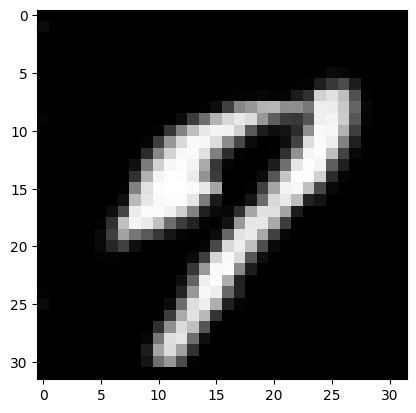

batch 200 gen loss: -3.471745491027832, discr loss: 34.55314636230469


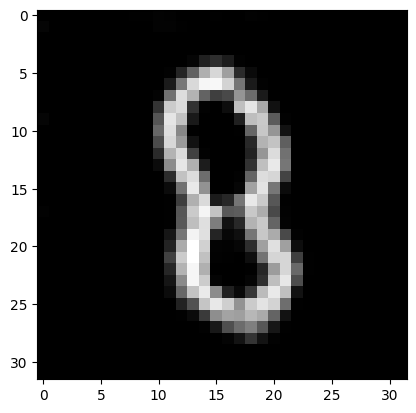

batch 300 gen loss: 0.23082034289836884, discr loss: 31.994094848632812


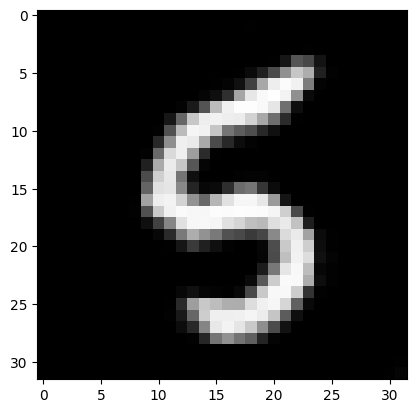

batch 400 gen loss: -3.1240851879119873, discr loss: 31.296463012695312


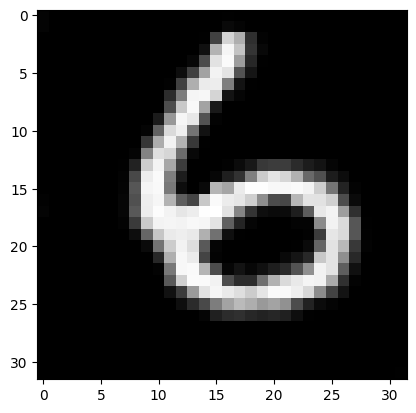

batch 500 gen loss: 1.5126864910125732, discr loss: 30.16388511657715


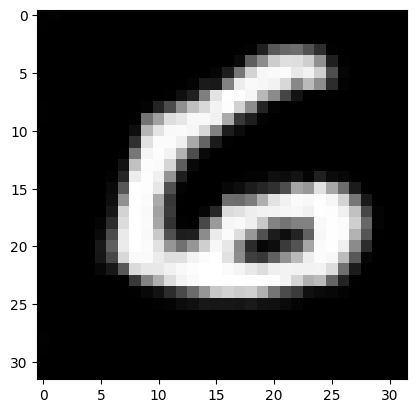

batch 600 gen loss: 0.0, discr loss: 30.5314884185791


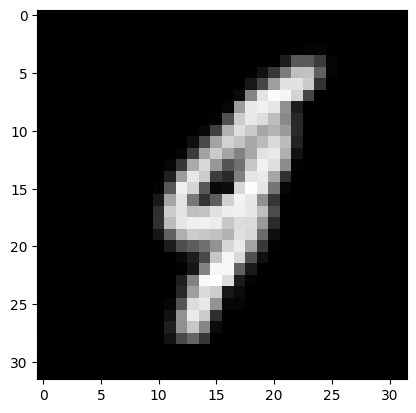

batch 700 gen loss: 1.0774519443511963, discr loss: 28.702882766723633


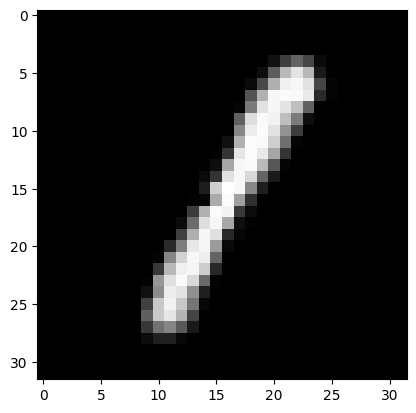

batch 800 gen loss: -3.6841366291046143, discr loss: 35.7485466003418


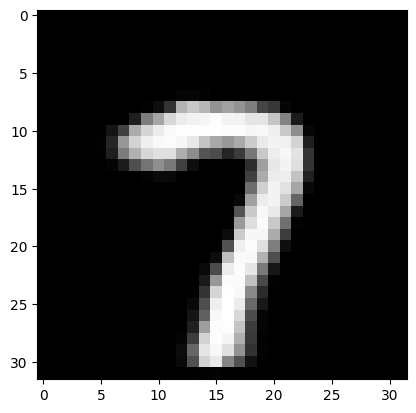

batch 900 gen loss: -3.3215789794921875, discr loss: 32.143089294433594


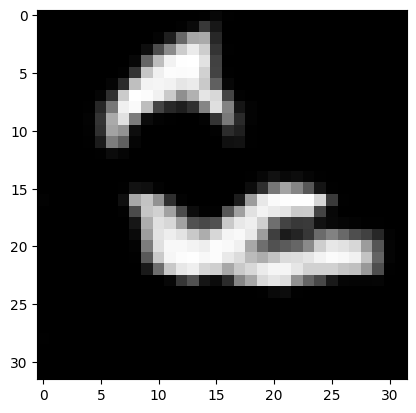

-988.2938232421875 29422.234375


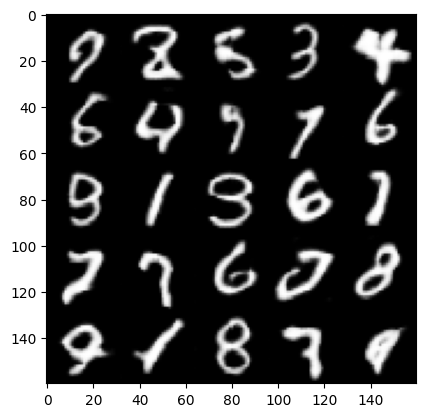

epoch 40:
batch 0 gen loss: 0.8915021419525146, discr loss: 30.77541732788086


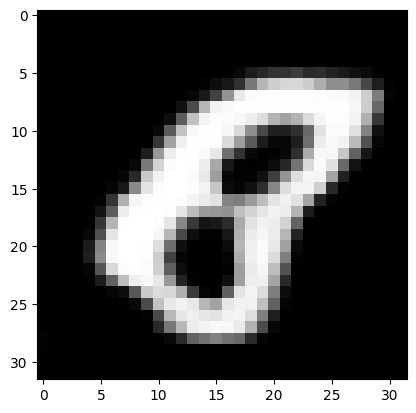

batch 100 gen loss: 0.8485963940620422, discr loss: 32.34828186035156


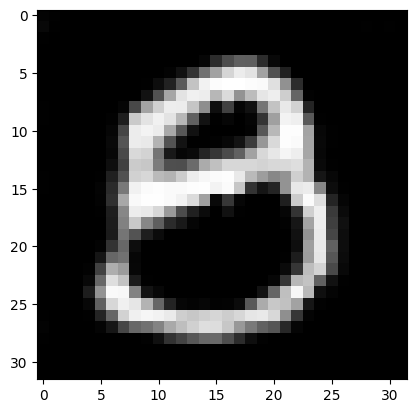

batch 200 gen loss: -3.2463877201080322, discr loss: 38.713008880615234


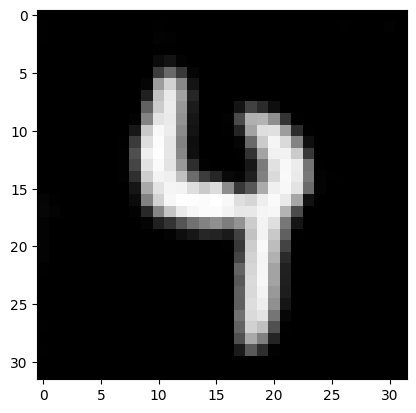

batch 300 gen loss: -3.167997360229492, discr loss: 38.5426139831543


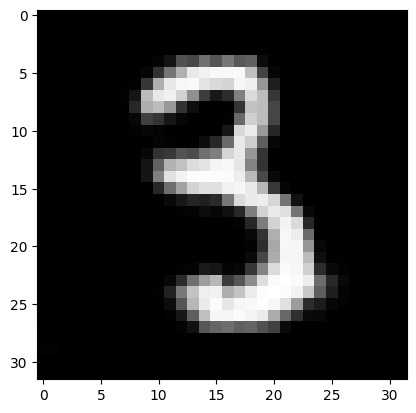

batch 400 gen loss: -3.1564760208129883, discr loss: 35.219459533691406


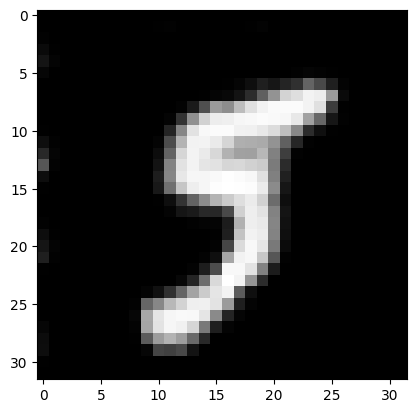

batch 500 gen loss: -6.819734573364258, discr loss: 34.91948318481445


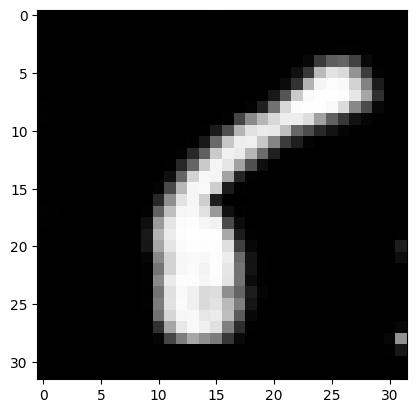

batch 600 gen loss: -2.712233304977417, discr loss: 34.4735107421875


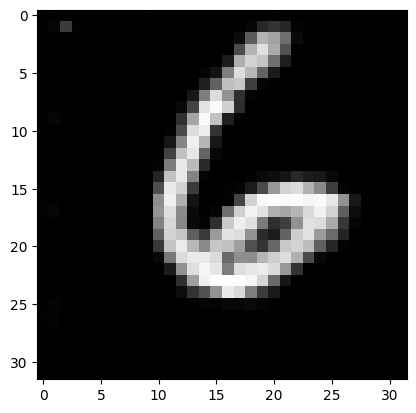

batch 700 gen loss: -3.6841366291046143, discr loss: 38.37271499633789


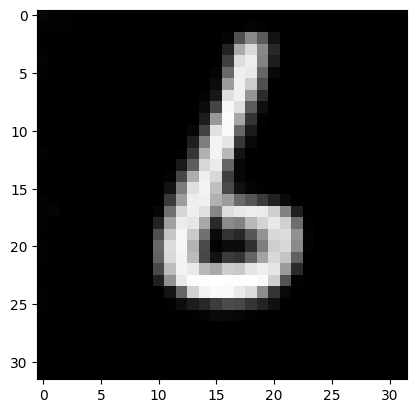

batch 800 gen loss: 0.5364736914634705, discr loss: 35.10486602783203


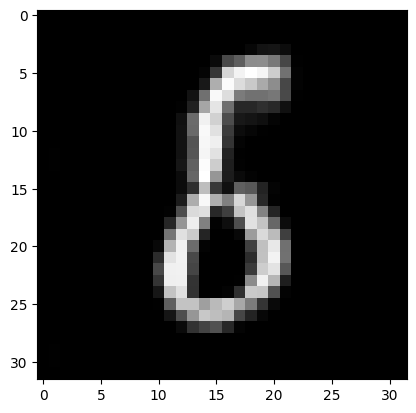

batch 900 gen loss: 0.8919302821159363, discr loss: 34.45899200439453


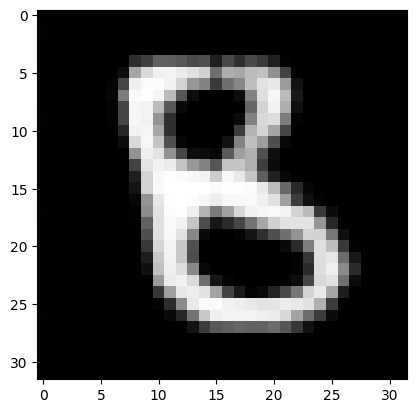

-3155.69189453125 33291.5625


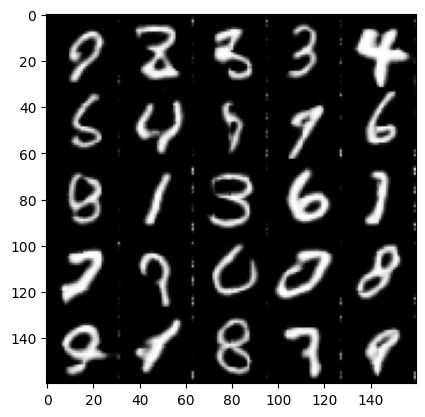

epoch 41:
batch 0 gen loss: -6.471146583557129, discr loss: 34.418235778808594


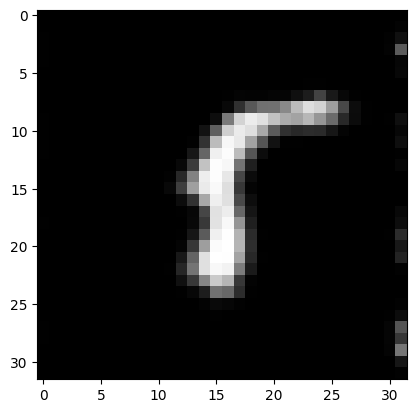

batch 100 gen loss: -2.6410536766052246, discr loss: 35.54292678833008


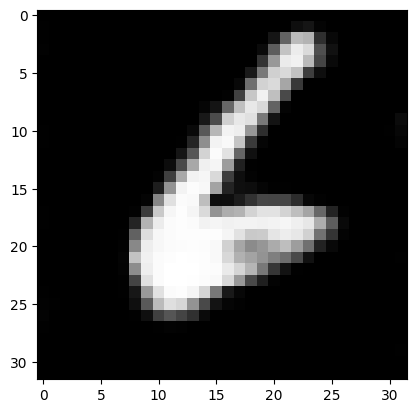

batch 200 gen loss: -6.883647441864014, discr loss: 34.64753723144531


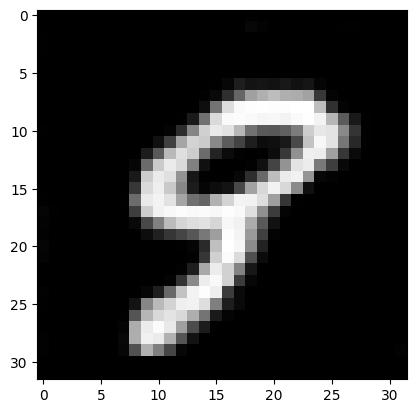

batch 300 gen loss: 0.542400598526001, discr loss: 34.35564041137695


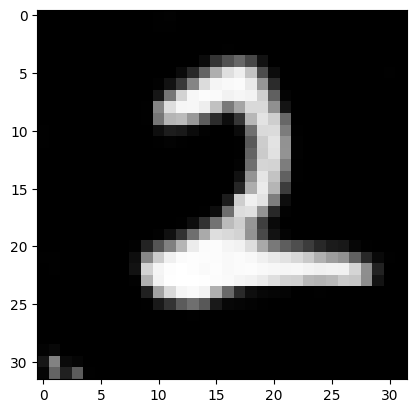

batch 400 gen loss: -6.355518341064453, discr loss: 34.16082763671875


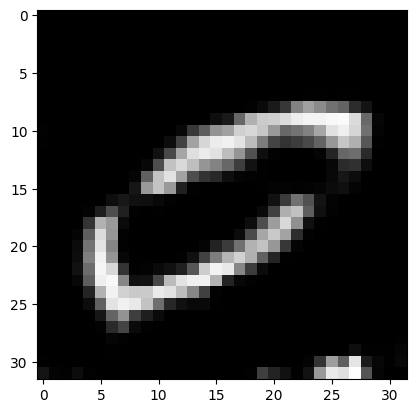

batch 500 gen loss: -2.731003999710083, discr loss: 34.17243576049805


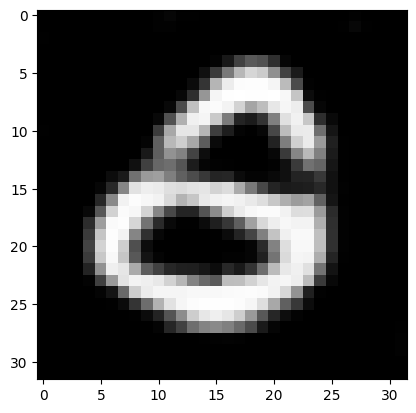

batch 600 gen loss: -3.0444998741149902, discr loss: 34.606082916259766


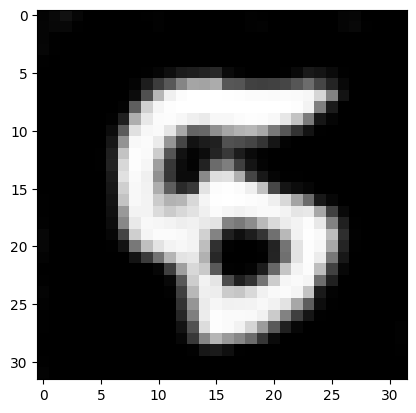

batch 700 gen loss: -3.203619956970215, discr loss: 34.64795684814453


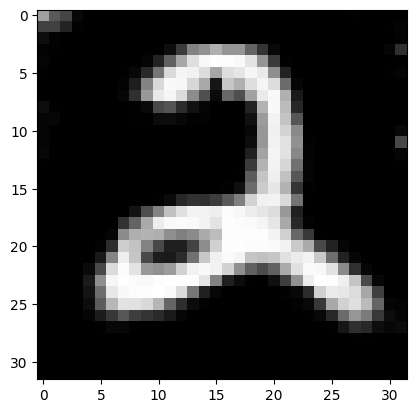

batch 800 gen loss: -2.5883989334106445, discr loss: 34.232418060302734


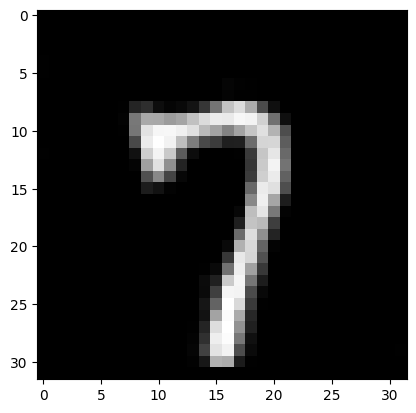

batch 900 gen loss: -6.443960189819336, discr loss: 34.21004867553711


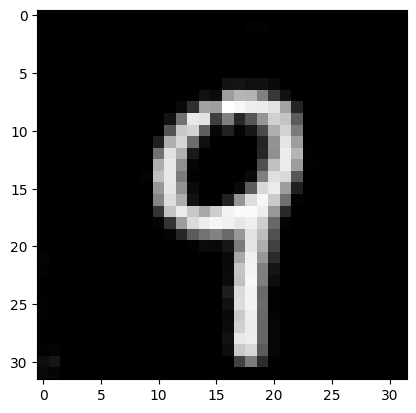

-2931.113037109375 32468.99609375


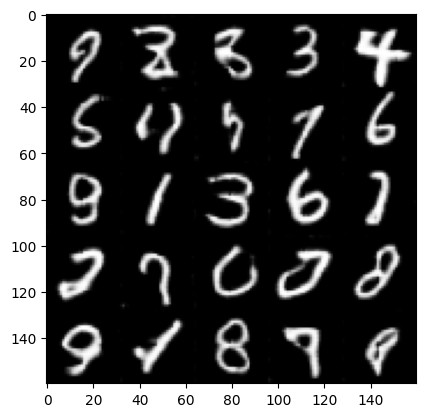

epoch 42:
batch 0 gen loss: -2.763209342956543, discr loss: 34.23643112182617


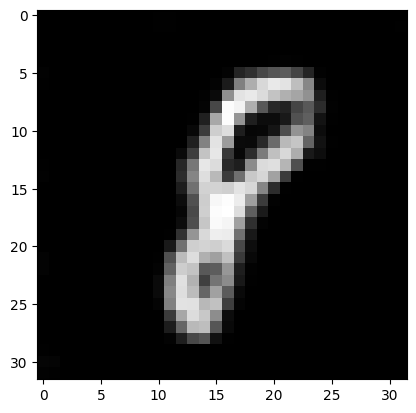

batch 100 gen loss: 0.2603505551815033, discr loss: 35.29677200317383


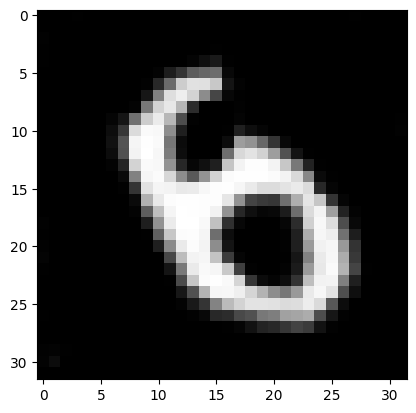

batch 200 gen loss: -3.332085132598877, discr loss: 35.14788055419922


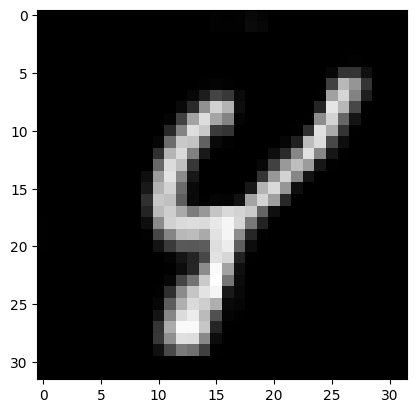

batch 300 gen loss: -6.885697364807129, discr loss: 34.686771392822266


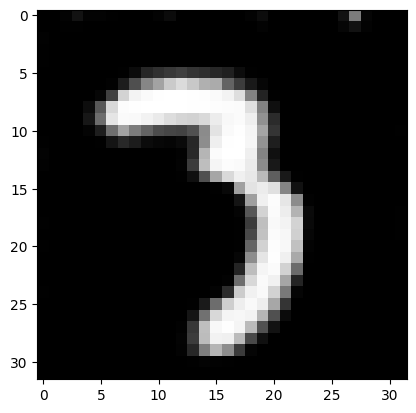

batch 400 gen loss: 1.0701353549957275, discr loss: 38.55802917480469


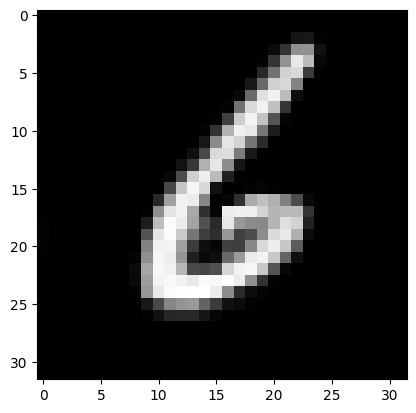

batch 500 gen loss: -10.478981018066406, discr loss: 42.52040481567383


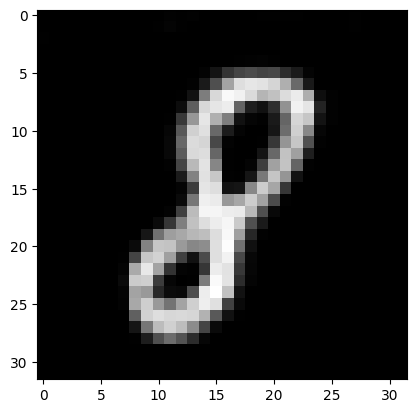

batch 600 gen loss: 0.5668542981147766, discr loss: 42.817203521728516


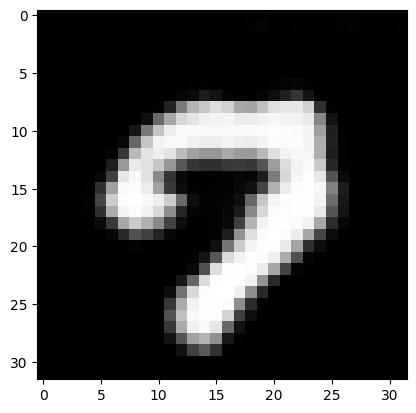

batch 700 gen loss: -6.791215419769287, discr loss: 42.47958755493164


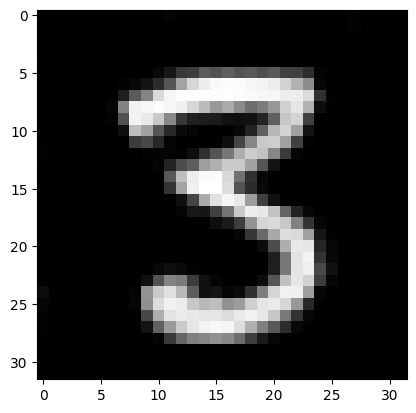

batch 800 gen loss: -3.6841366291046143, discr loss: 42.462162017822266


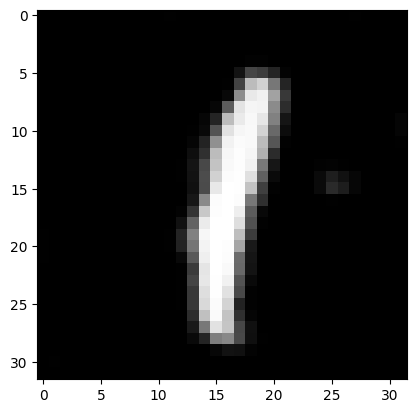

batch 900 gen loss: -7.3682732582092285, discr loss: 42.46125030517578


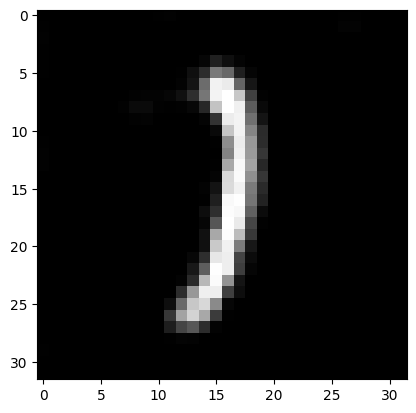

-5242.22412109375 36986.640625


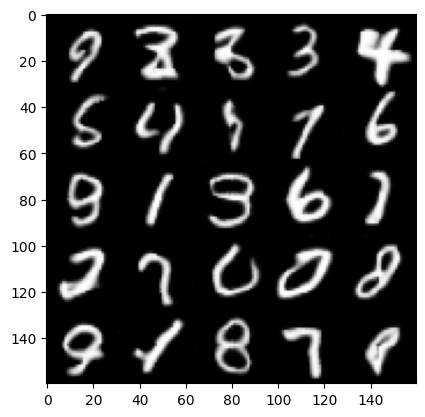

epoch 43:
batch 0 gen loss: -7.3682732582092285, discr loss: 42.533756256103516


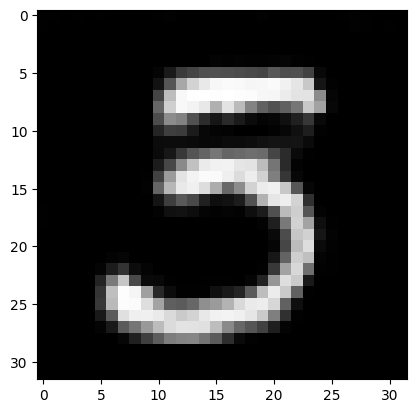

batch 100 gen loss: -6.80784797668457, discr loss: 44.03289794921875


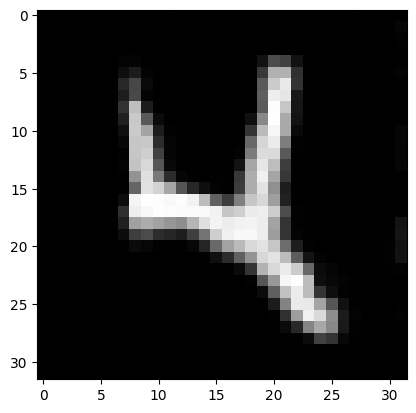

batch 200 gen loss: -7.546774387359619, discr loss: 44.17917251586914


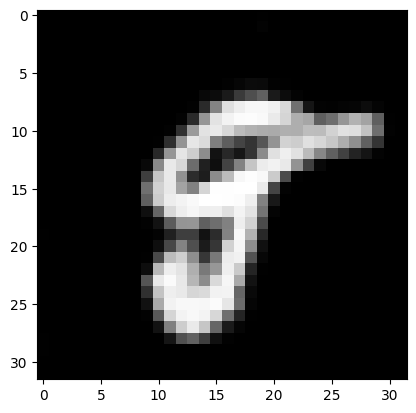

batch 300 gen loss: -3.902723789215088, discr loss: 44.19621658325195


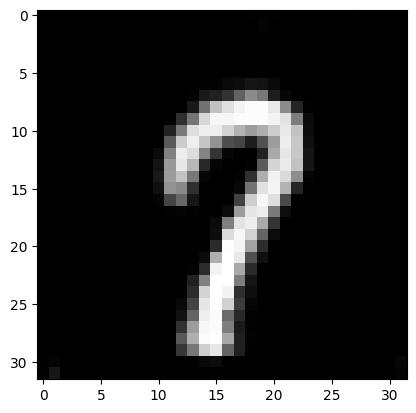

batch 400 gen loss: -7.3682732582092285, discr loss: 44.228981018066406


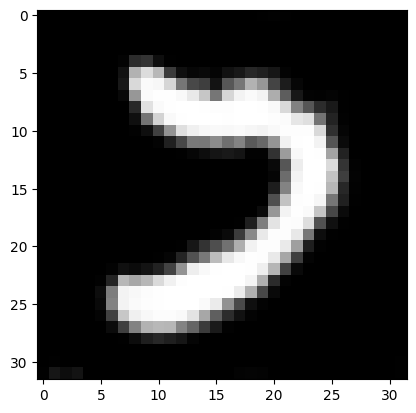

batch 500 gen loss: -4.500334739685059, discr loss: 42.195350646972656


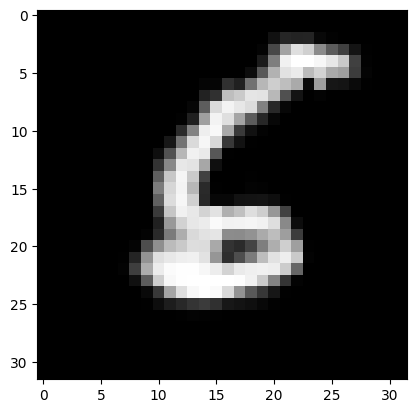

batch 600 gen loss: -6.4780144691467285, discr loss: 40.05718994140625


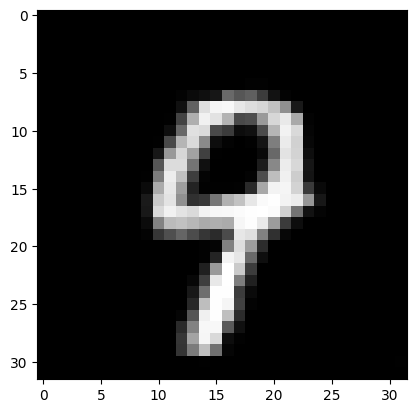

batch 700 gen loss: 0.3397060036659241, discr loss: 40.03418731689453


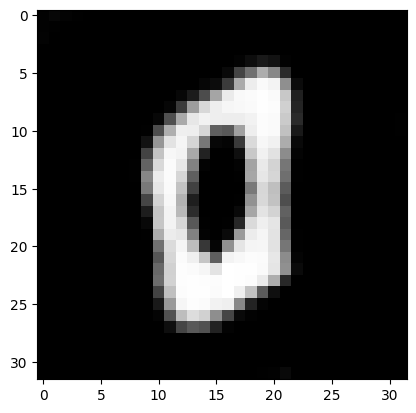

batch 800 gen loss: 0.25044816732406616, discr loss: 35.76047897338867


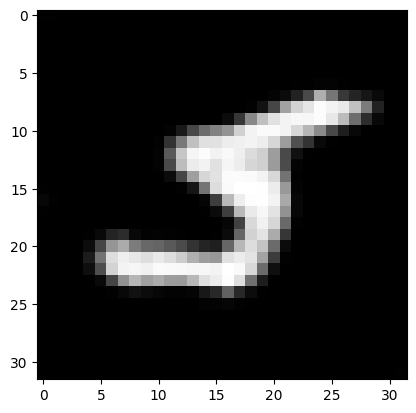

batch 900 gen loss: 0.018786609172821045, discr loss: 36.479461669921875


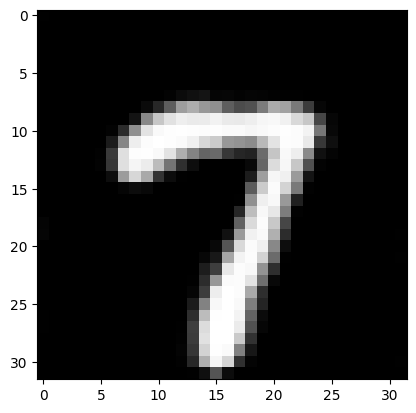

-5405.59814453125 38741.91015625


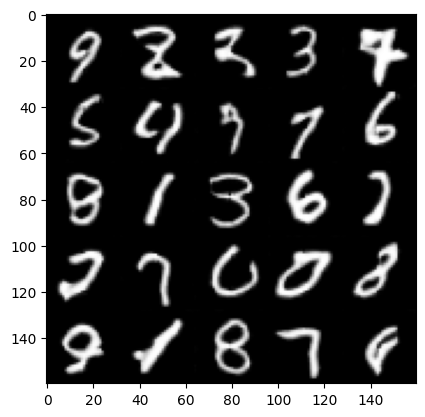

epoch 44:
batch 0 gen loss: -4.014263153076172, discr loss: 35.52775192260742


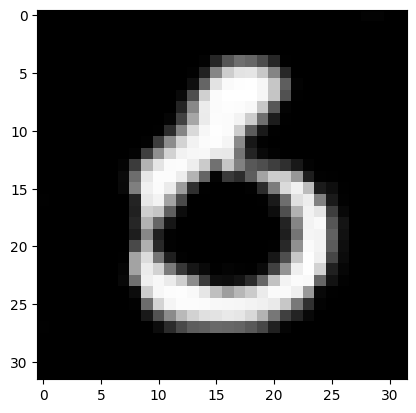

batch 100 gen loss: -6.764739513397217, discr loss: 35.662776947021484


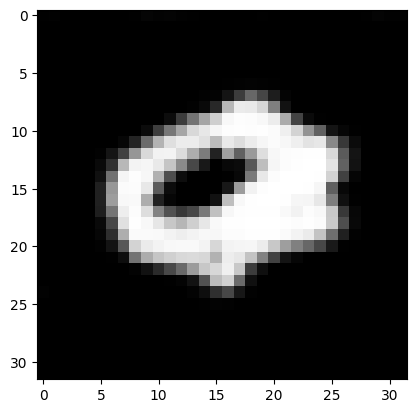

batch 200 gen loss: 0.0, discr loss: 35.611167907714844


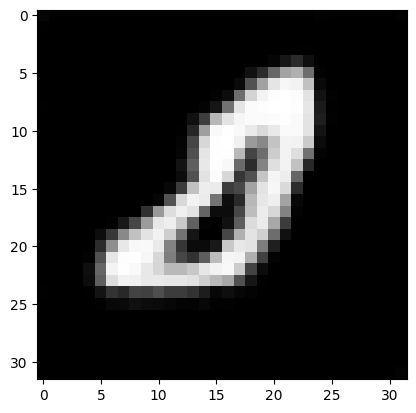

batch 300 gen loss: -6.804243087768555, discr loss: 39.293418884277344


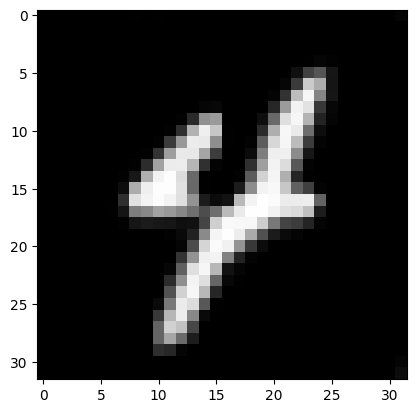

batch 400 gen loss: -3.239718198776245, discr loss: 39.07107162475586


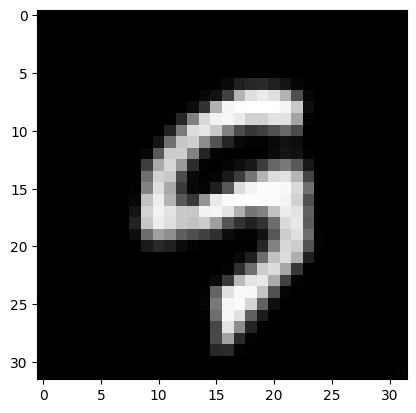

batch 500 gen loss: -7.3682732582092285, discr loss: 38.75940704345703


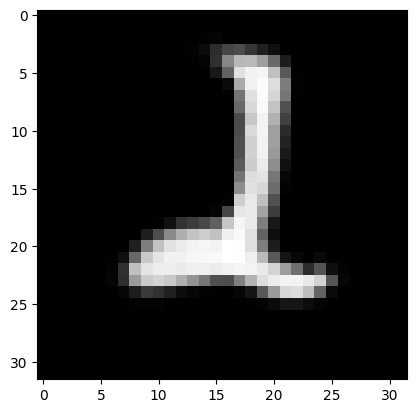

batch 600 gen loss: -11.052410125732422, discr loss: 46.84763717651367


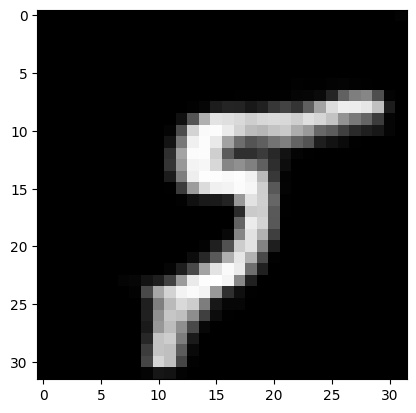

batch 700 gen loss: -3.4811160564422607, discr loss: 42.951171875


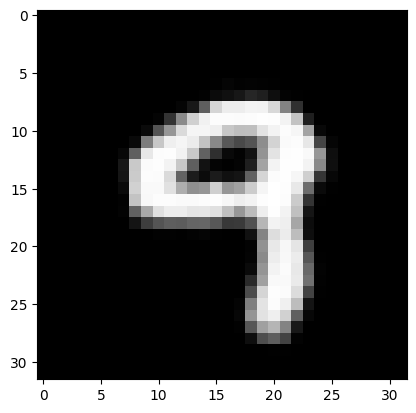

batch 800 gen loss: -7.166223526000977, discr loss: 42.90882110595703


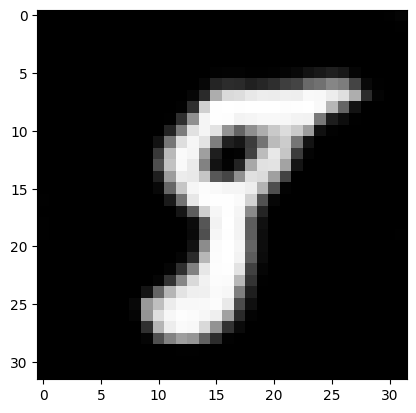

batch 900 gen loss: -10.783736228942871, discr loss: 42.84431838989258


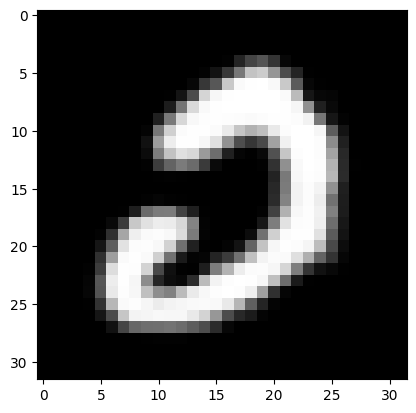

-5468.48583984375 37586.05859375


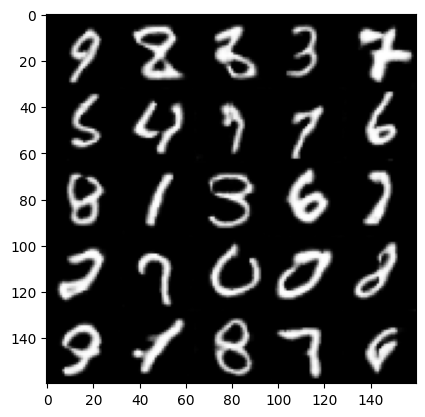

epoch 45:
batch 0 gen loss: -7.3682732582092285, discr loss: 42.79747772216797


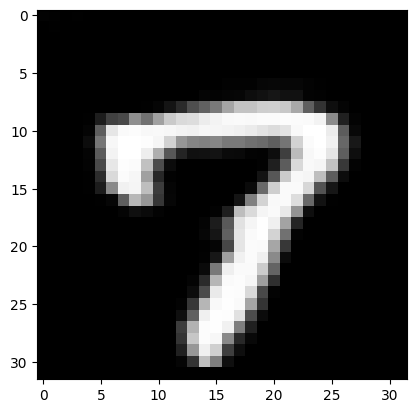

batch 100 gen loss: -7.110991477966309, discr loss: 42.763973236083984


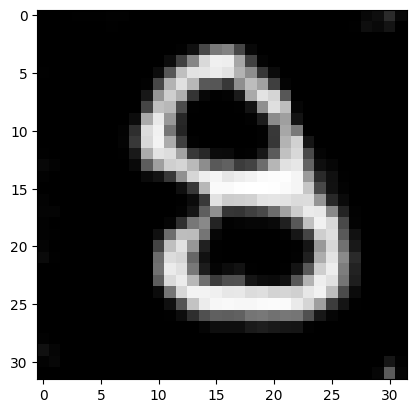

batch 200 gen loss: -7.3682732582092285, discr loss: 42.660430908203125


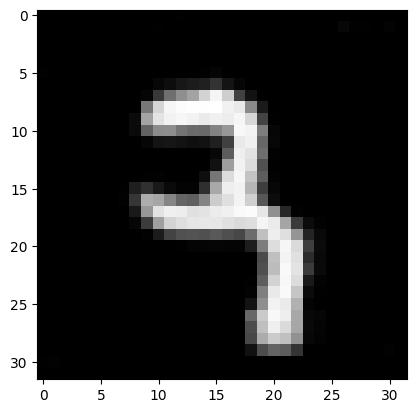

batch 300 gen loss: -10.628085136413574, discr loss: 38.76121520996094


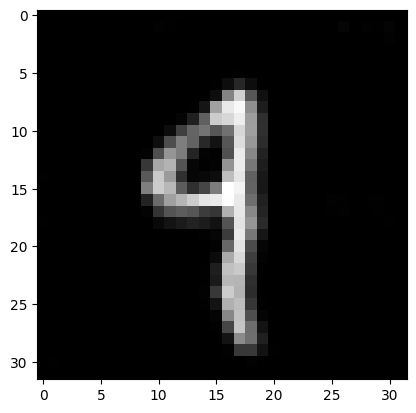

batch 400 gen loss: -4.0132575035095215, discr loss: 47.883079528808594


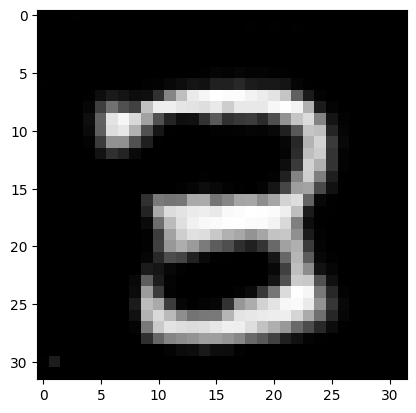

batch 500 gen loss: 0.43427762389183044, discr loss: 36.19796371459961


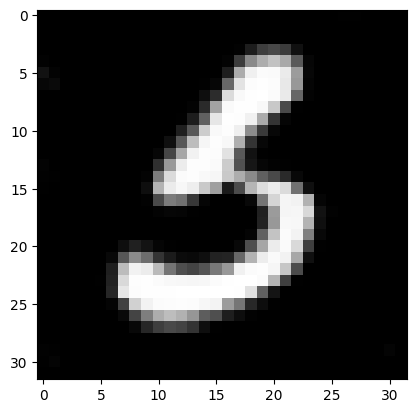

batch 600 gen loss: 0.1250404715538025, discr loss: 36.604827880859375


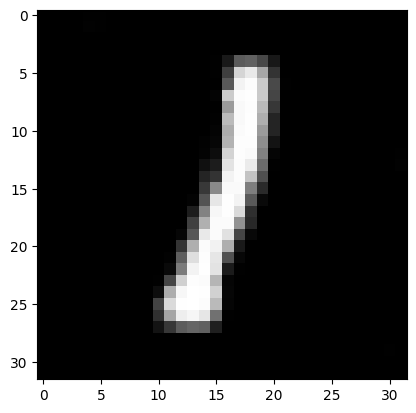

batch 700 gen loss: -3.0015604496002197, discr loss: 35.76437759399414


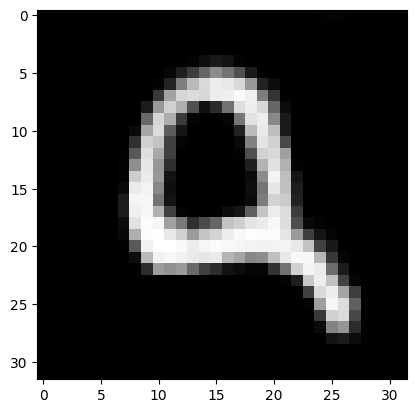

batch 800 gen loss: -6.556865215301514, discr loss: 35.79084014892578


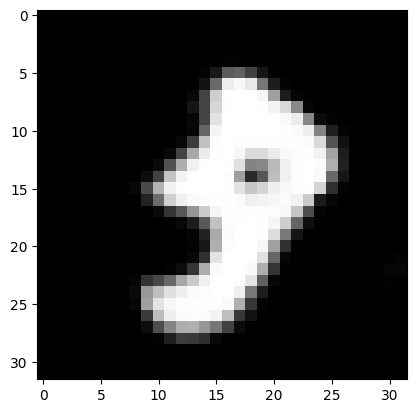

batch 900 gen loss: -2.606945514678955, discr loss: 36.017066955566406


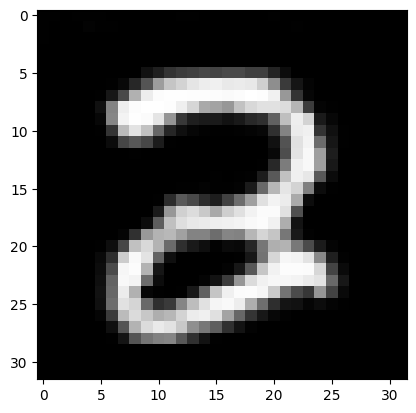

-4280.7041015625 36253.125


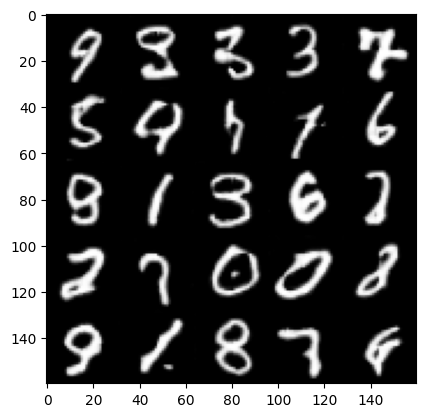

epoch 46:
batch 0 gen loss: -6.464179515838623, discr loss: 35.234596252441406


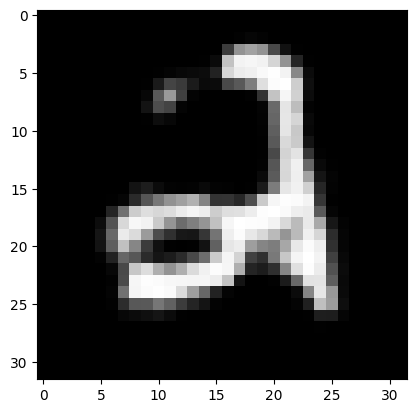

batch 100 gen loss: -6.366434097290039, discr loss: 38.9218635559082


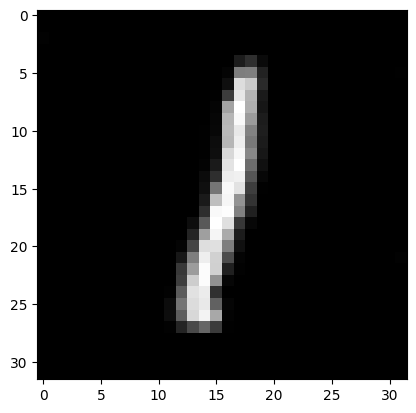

batch 200 gen loss: -6.8247504234313965, discr loss: 35.40946578979492


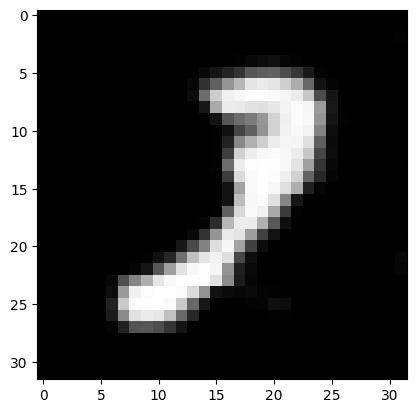

batch 300 gen loss: -3.293029546737671, discr loss: 35.4893913269043


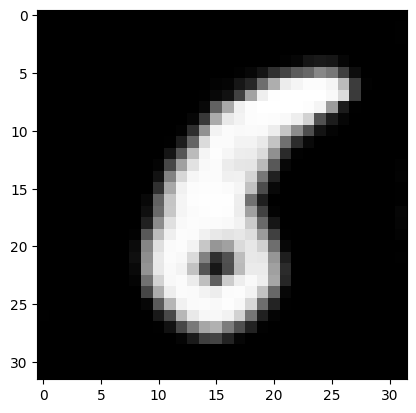

batch 400 gen loss: -2.6000425815582275, discr loss: 34.144439697265625


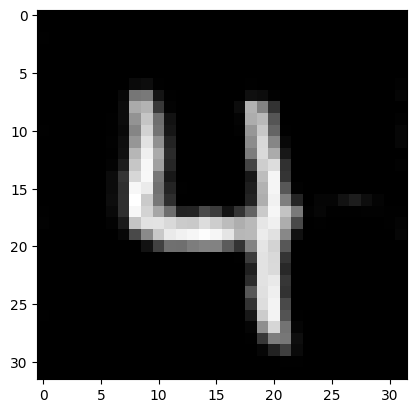

batch 500 gen loss: -3.323972225189209, discr loss: 35.32320022583008


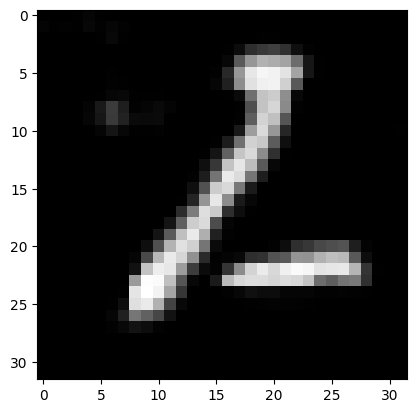

batch 600 gen loss: -2.9275667667388916, discr loss: 35.27071762084961


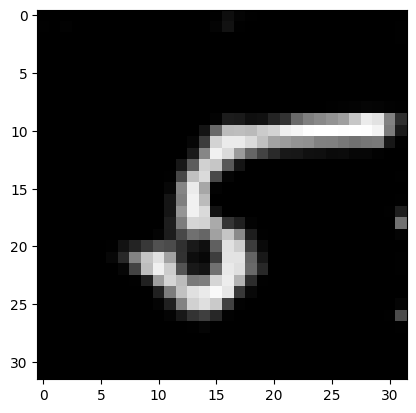

batch 700 gen loss: -7.000402450561523, discr loss: 34.97978210449219


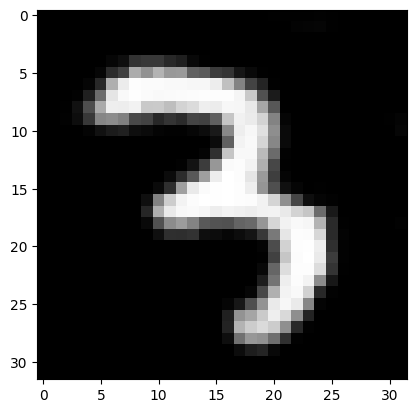

batch 800 gen loss: -3.8398313522338867, discr loss: 43.39688491821289


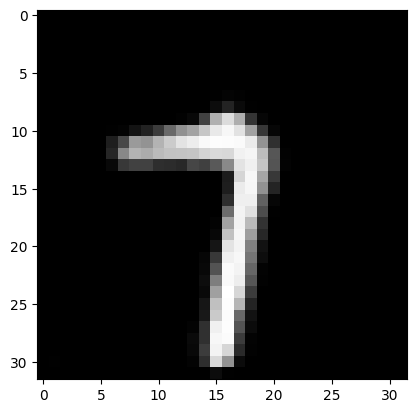

batch 900 gen loss: -7.4132161140441895, discr loss: 39.2251091003418


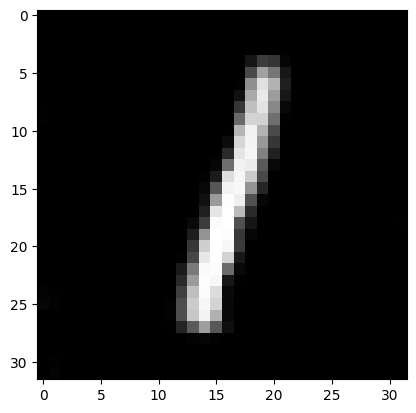

-3819.15966796875 34285.63671875


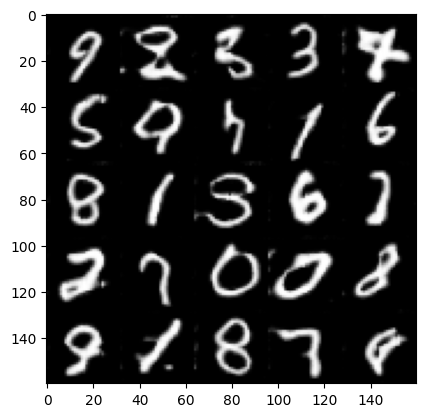

epoch 47:
batch 0 gen loss: -0.2459147423505783, discr loss: 39.24375534057617


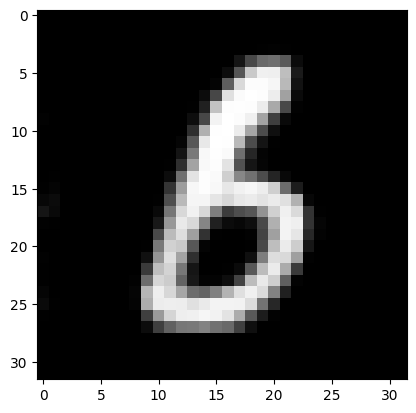

batch 100 gen loss: -6.933398246765137, discr loss: 39.14039611816406


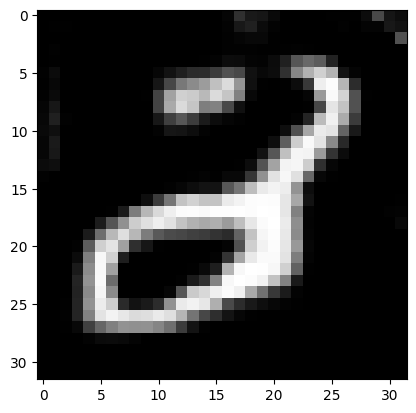

batch 200 gen loss: -3.1418063640594482, discr loss: 38.89772415161133


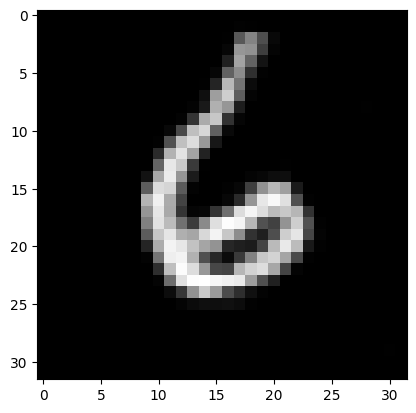

batch 300 gen loss: -7.167035102844238, discr loss: 34.638336181640625


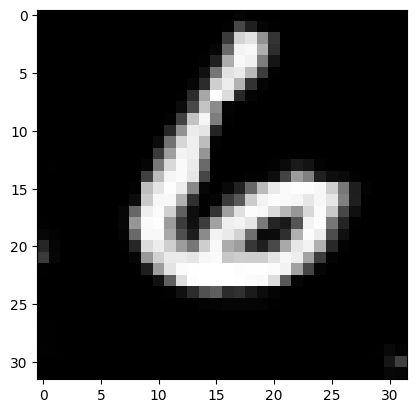

batch 400 gen loss: -7.3682732582092285, discr loss: 34.36080551147461


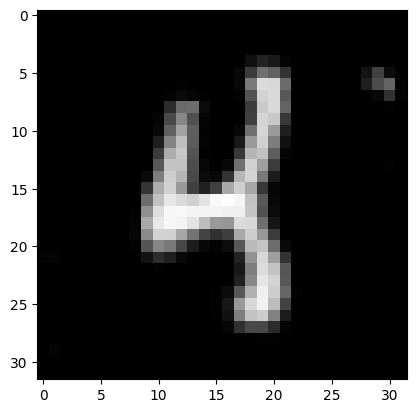

batch 500 gen loss: -2.8055877685546875, discr loss: 34.26651382446289


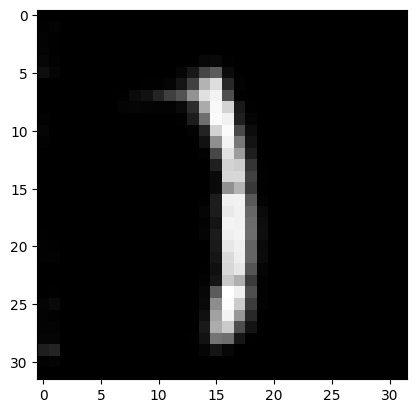

batch 600 gen loss: -2.7224278450012207, discr loss: 34.18699264526367


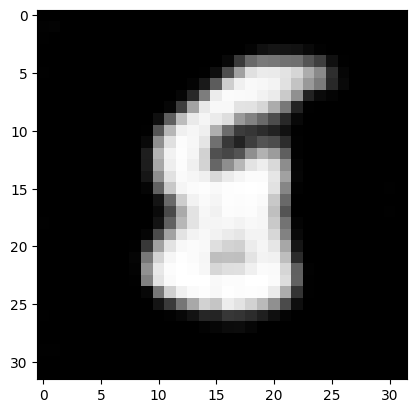

batch 700 gen loss: -6.900407791137695, discr loss: 42.5401611328125


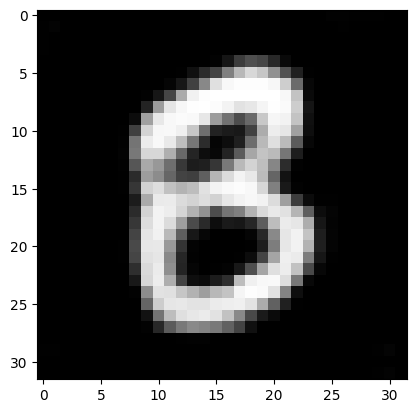

batch 800 gen loss: -3.6841366291046143, discr loss: 44.148048400878906


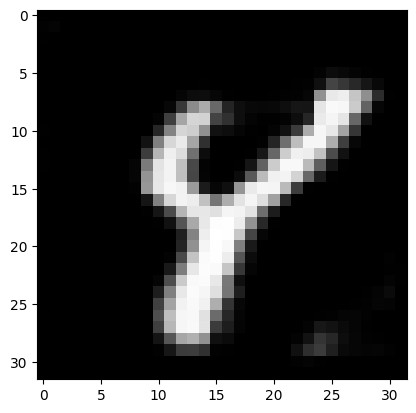

batch 900 gen loss: -11.059101104736328, discr loss: 43.25353240966797


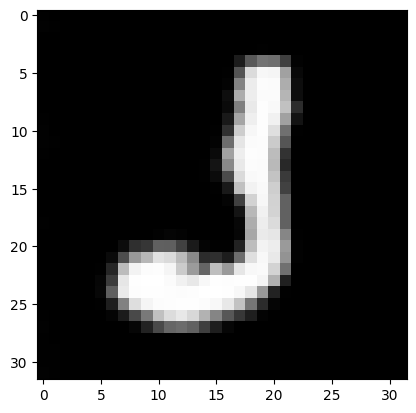

-4624.88232421875 35963.29296875


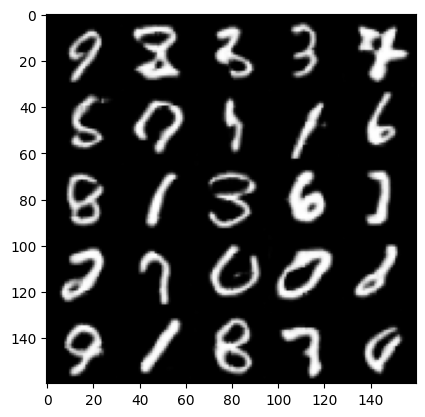

epoch 48:
batch 0 gen loss: -7.3682732582092285, discr loss: 43.32836151123047


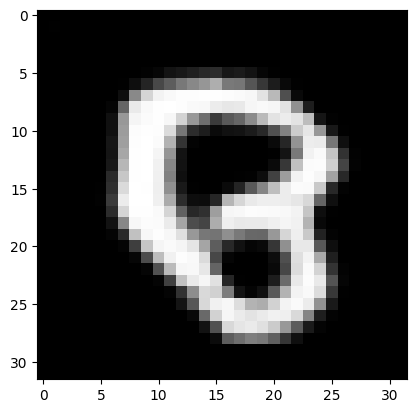

batch 100 gen loss: -3.8678395748138428, discr loss: 40.06621551513672


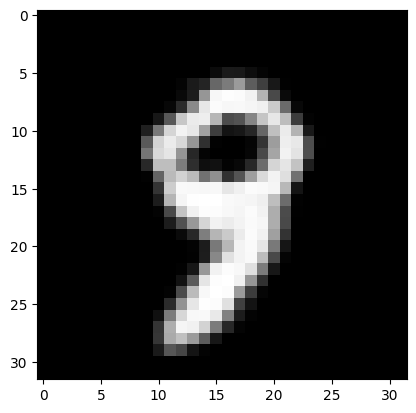

batch 200 gen loss: -3.6841366291046143, discr loss: 39.406166076660156


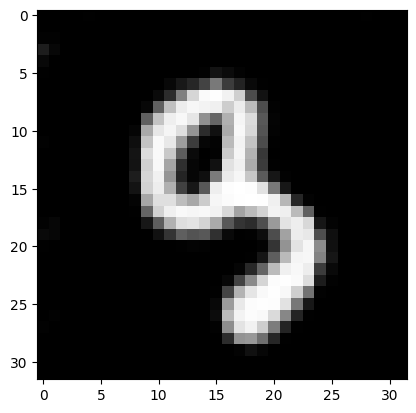

batch 300 gen loss: -3.6841366291046143, discr loss: 39.309024810791016


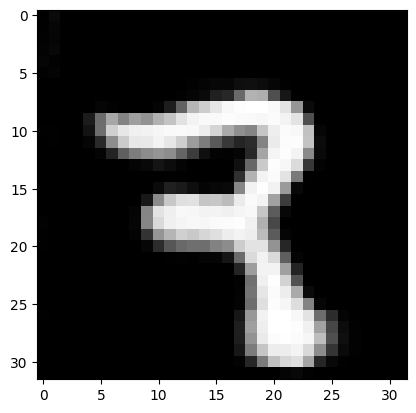

batch 400 gen loss: -3.467038154602051, discr loss: 40.05012512207031


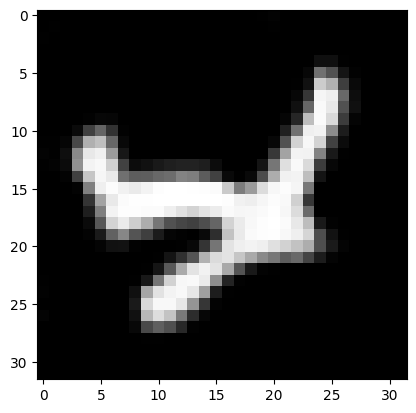

batch 500 gen loss: -10.74318790435791, discr loss: 39.33695602416992


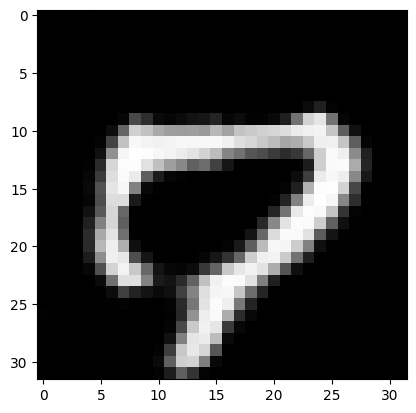

batch 600 gen loss: -6.946170330047607, discr loss: 42.394657135009766


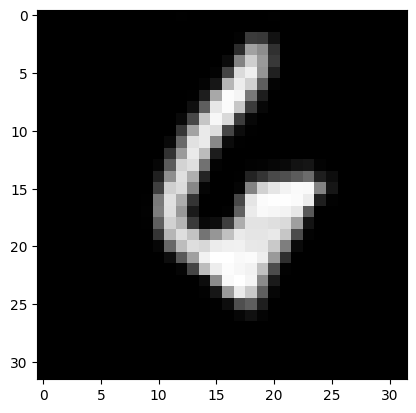

batch 700 gen loss: -3.3222153186798096, discr loss: 35.77063751220703


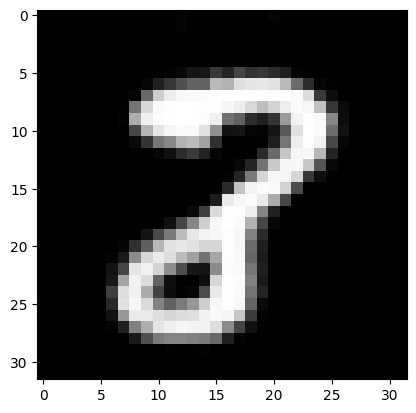

batch 800 gen loss: -2.633760690689087, discr loss: 34.2531852722168


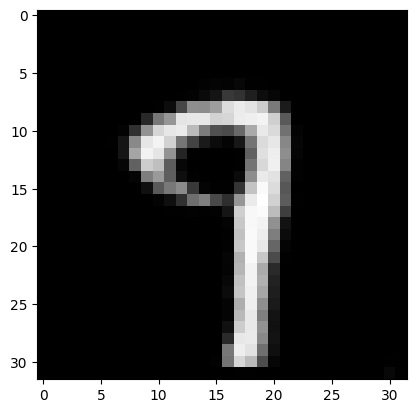

batch 900 gen loss: -6.86627721786499, discr loss: 38.283119201660156


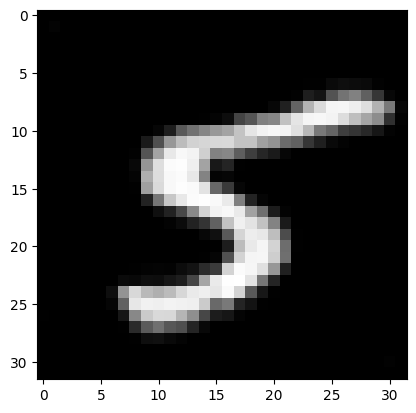

-4631.58935546875 36572.96484375


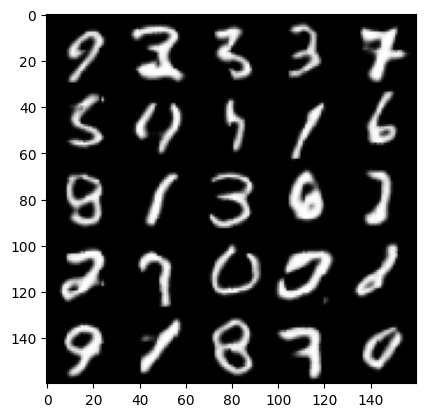

epoch 49:
batch 0 gen loss: -14.736546516418457, discr loss: 42.52172088623047


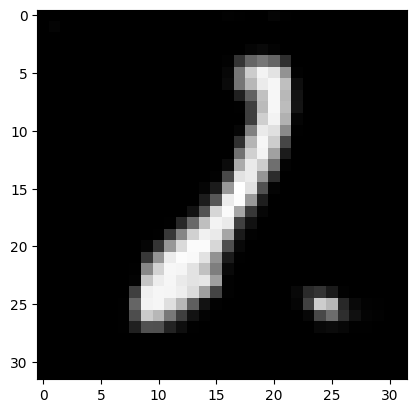

batch 100 gen loss: -10.466437339782715, discr loss: 43.27944564819336


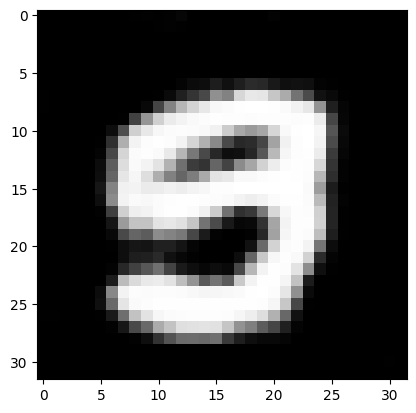

batch 200 gen loss: -6.8533124923706055, discr loss: 43.26259994506836


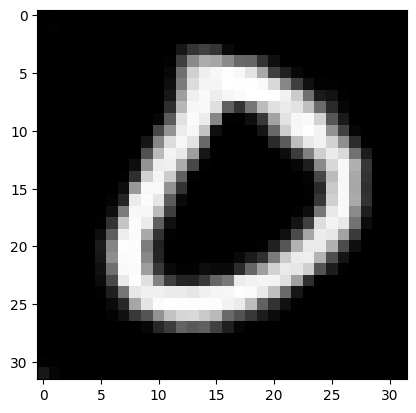

batch 300 gen loss: 0.5961126685142517, discr loss: 45.10271453857422


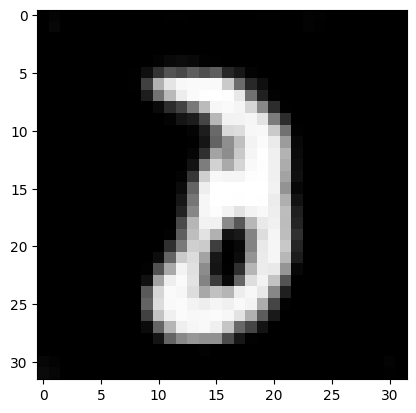

batch 400 gen loss: -3.6841366291046143, discr loss: 42.89982986450195


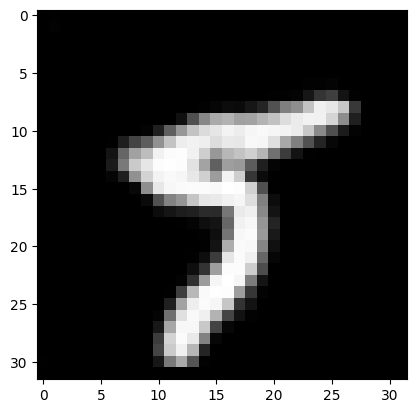

batch 500 gen loss: 0.5718639492988586, discr loss: 42.64530563354492


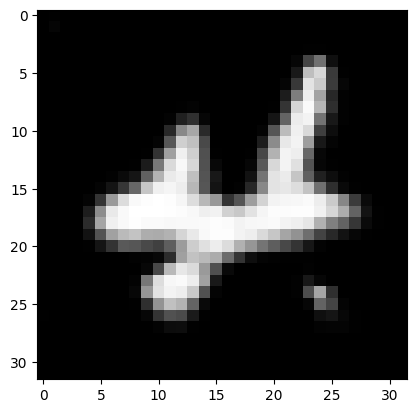

batch 600 gen loss: -11.052410125732422, discr loss: 46.78606414794922


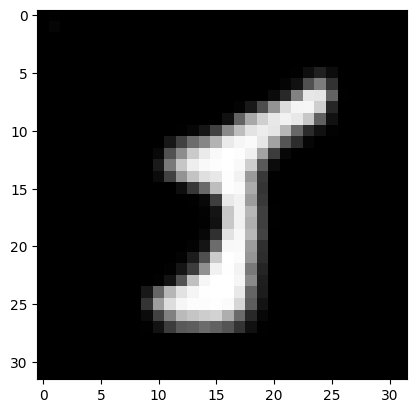

batch 700 gen loss: -3.6841366291046143, discr loss: 46.734981536865234


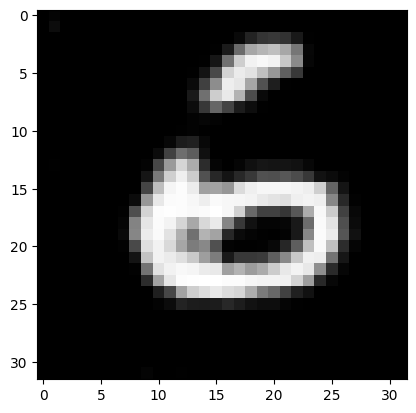

batch 800 gen loss: -7.3682732582092285, discr loss: 48.555397033691406


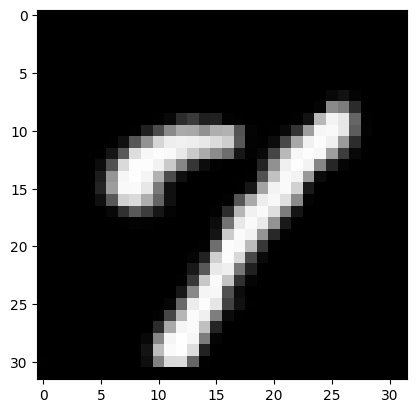

batch 900 gen loss: -7.3682732582092285, discr loss: 48.59356689453125


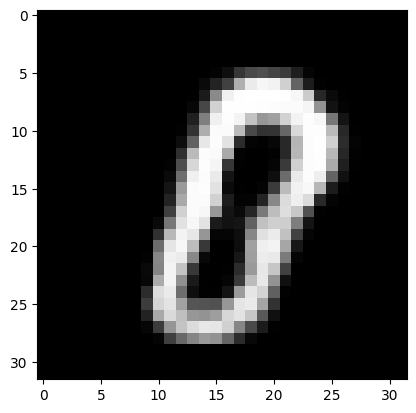

-7733.2041015625 42343.390625


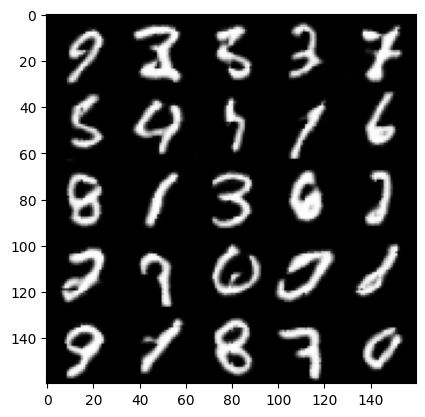

epoch 50:
batch 0 gen loss: -7.697253704071045, discr loss: 42.7774772644043


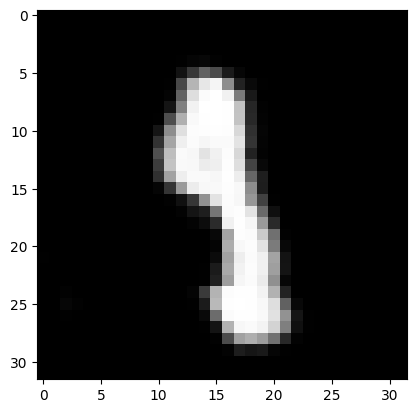

batch 100 gen loss: -7.159466743469238, discr loss: 40.612369537353516


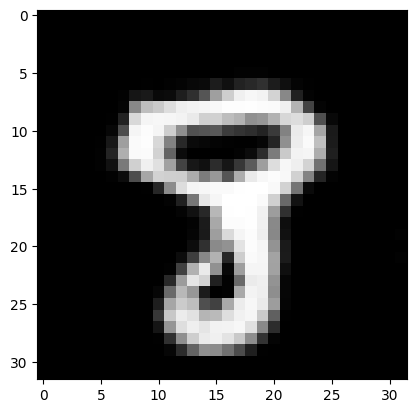

batch 200 gen loss: -11.19685173034668, discr loss: 40.4154052734375


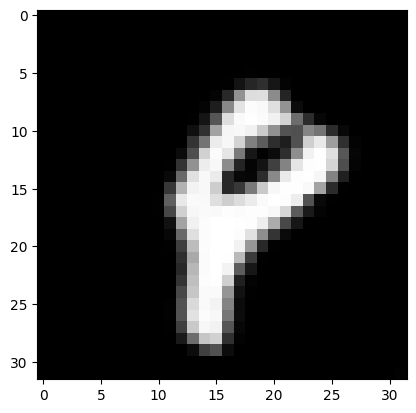

batch 300 gen loss: -11.1146821975708, discr loss: 39.85227584838867


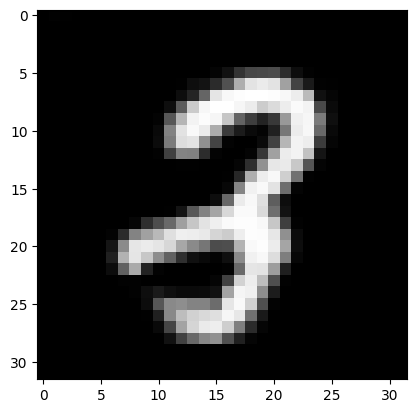

batch 400 gen loss: -3.3089563846588135, discr loss: 40.07955551147461


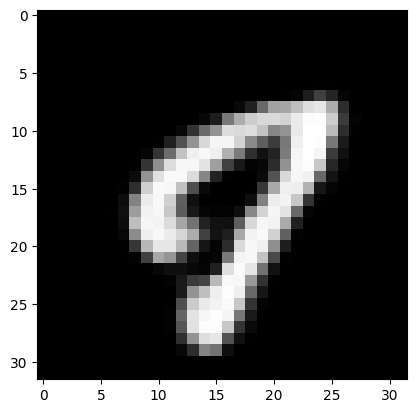

batch 500 gen loss: -3.250811815261841, discr loss: 38.84294891357422


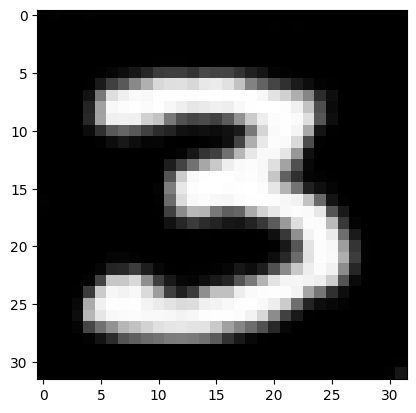

batch 600 gen loss: -3.1253249645233154, discr loss: 38.34309768676758


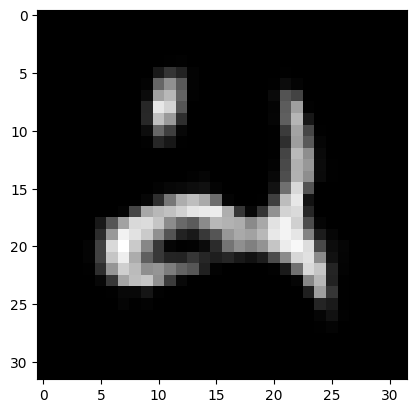

batch 700 gen loss: -10.488226890563965, discr loss: 42.471004486083984


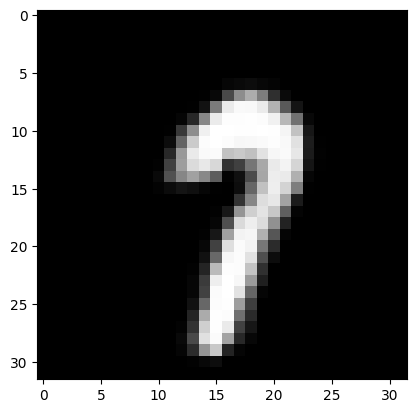

batch 800 gen loss: -11.052638053894043, discr loss: 46.706398010253906


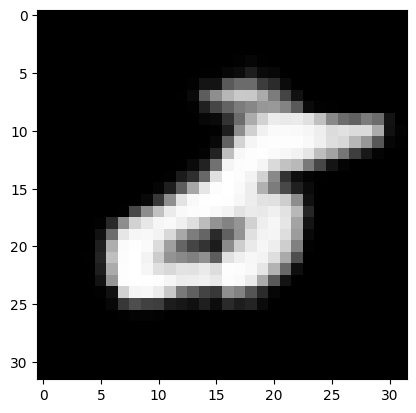

batch 900 gen loss: -3.6841366291046143, discr loss: 46.710243225097656


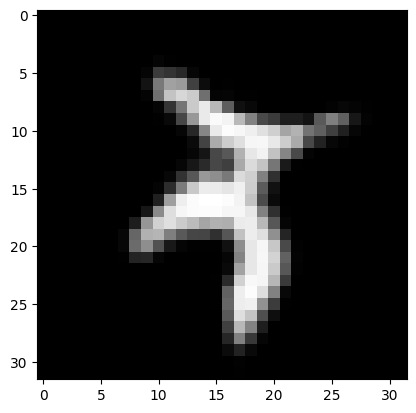

-5948.63818359375 38940.52734375


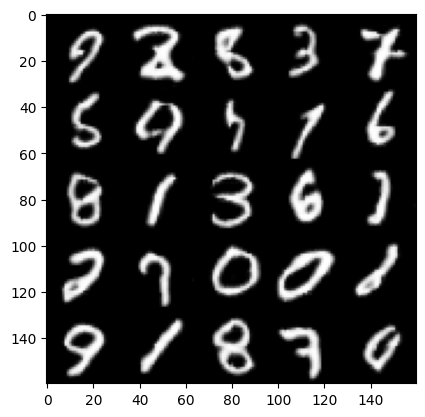

epoch 51:
batch 0 gen loss: -14.736546516418457, discr loss: 46.74159240722656


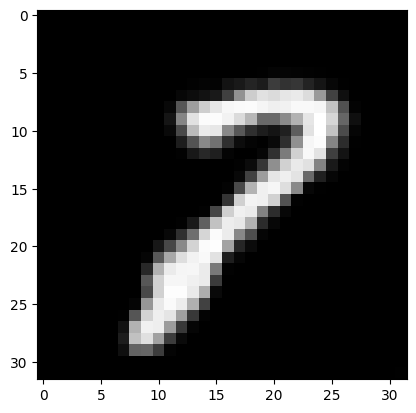

batch 100 gen loss: -11.371649742126465, discr loss: 44.16899108886719


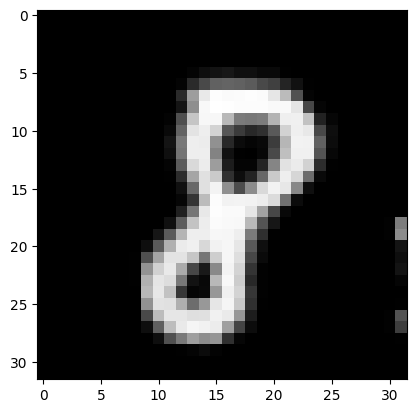

batch 200 gen loss: -11.250569343566895, discr loss: 44.267940521240234


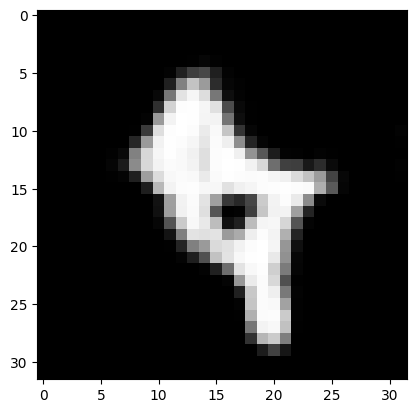

batch 300 gen loss: -3.6841366291046143, discr loss: 44.25090026855469


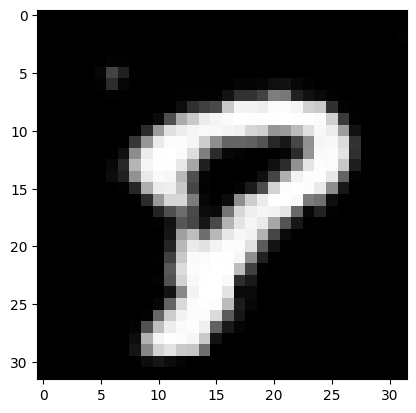

batch 400 gen loss: -3.0714025497436523, discr loss: 40.089271545410156


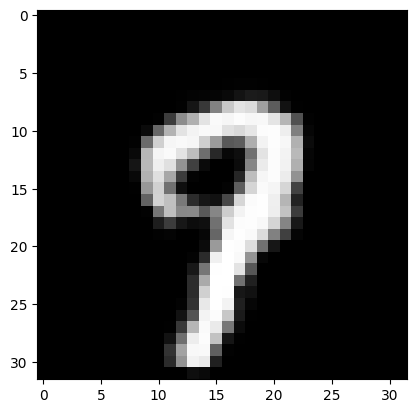

batch 500 gen loss: -7.762395858764648, discr loss: 40.02256393432617


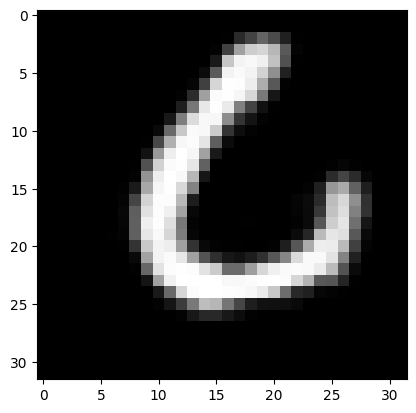

batch 600 gen loss: -2.60611891746521, discr loss: 39.84197998046875


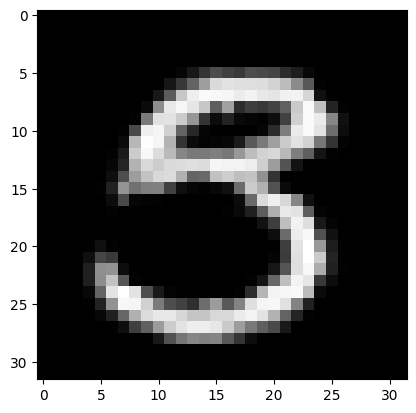

batch 700 gen loss: -3.232822895050049, discr loss: 39.187255859375


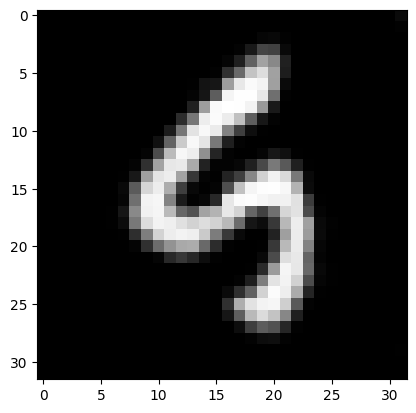

batch 800 gen loss: -11.052444458007812, discr loss: 38.64169692993164


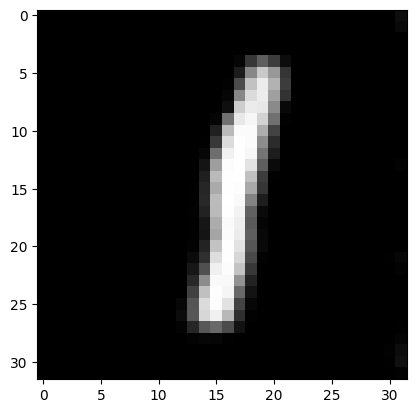

batch 900 gen loss: -6.224953651428223, discr loss: 34.712188720703125


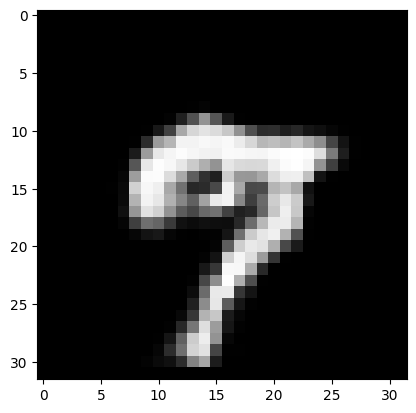

-5535.17333984375 38712.84765625


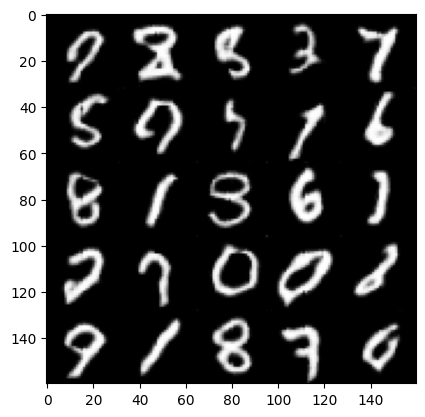

epoch 52:
batch 0 gen loss: -3.6841366291046143, discr loss: 34.163394927978516


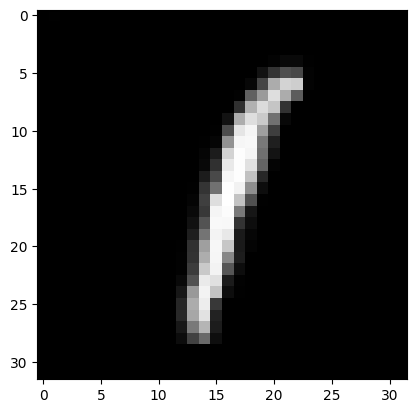

batch 100 gen loss: -6.877208232879639, discr loss: 38.42441940307617


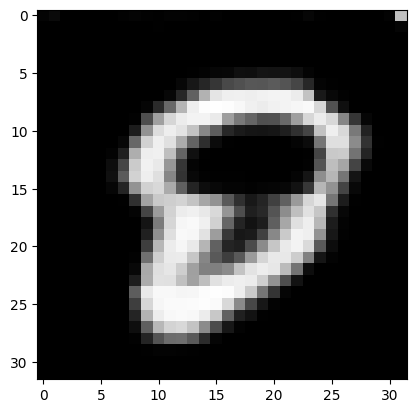

batch 200 gen loss: 0.9198665022850037, discr loss: 38.51482009887695


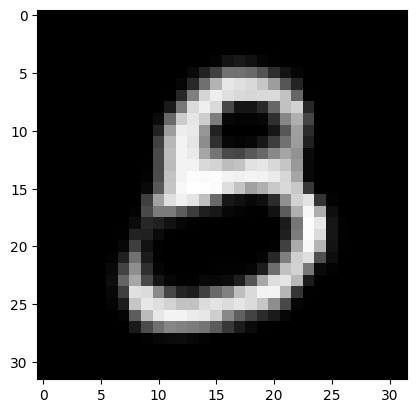

batch 300 gen loss: -3.1326708793640137, discr loss: 42.37744903564453


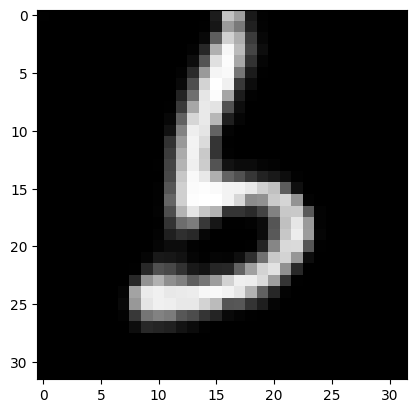

batch 400 gen loss: -3.500288963317871, discr loss: 42.99953079223633


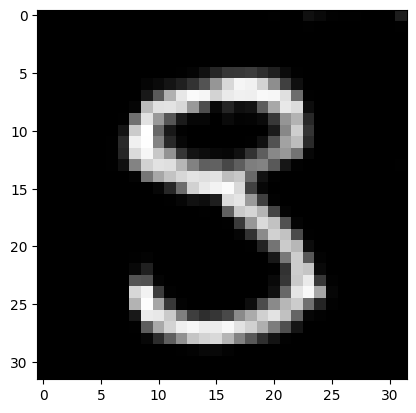

batch 500 gen loss: -4.757704257965088, discr loss: 40.7592658996582


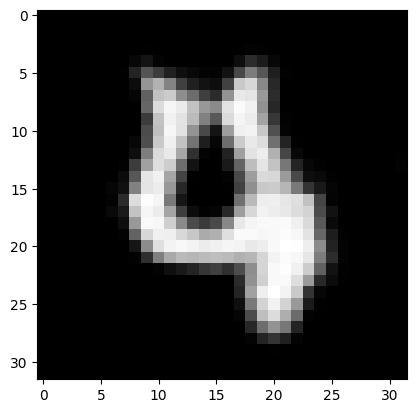

batch 600 gen loss: -3.6841366291046143, discr loss: 39.33212661743164


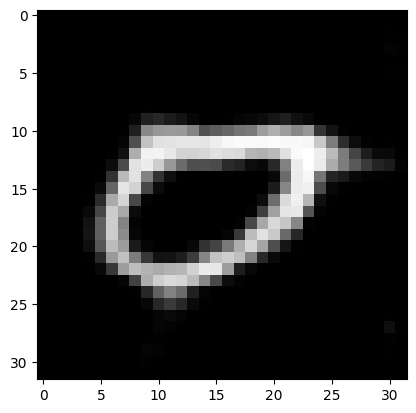

batch 700 gen loss: -3.326856851577759, discr loss: 39.28089141845703


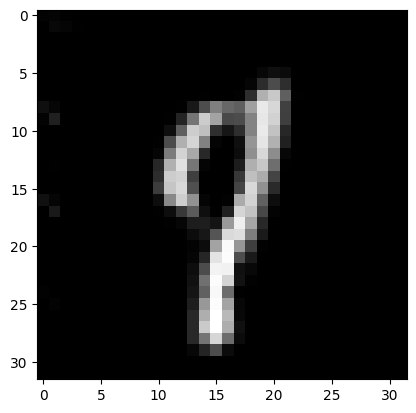

batch 800 gen loss: -11.052410125732422, discr loss: 39.19892883300781


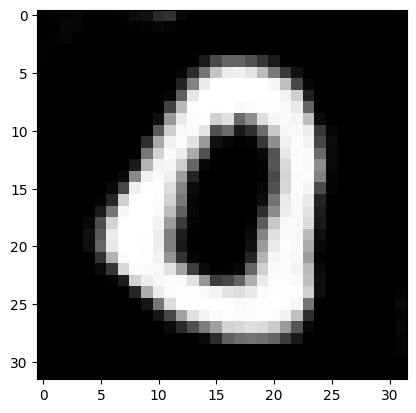

batch 900 gen loss: -6.826154708862305, discr loss: 40.1329345703125


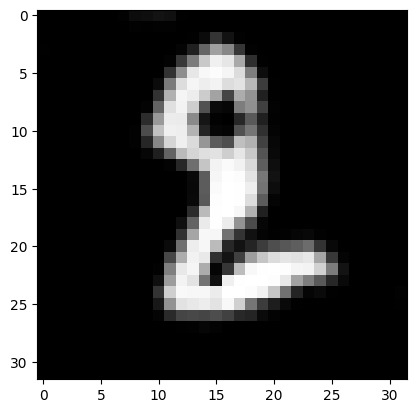

-5414.07421875 37200.64453125


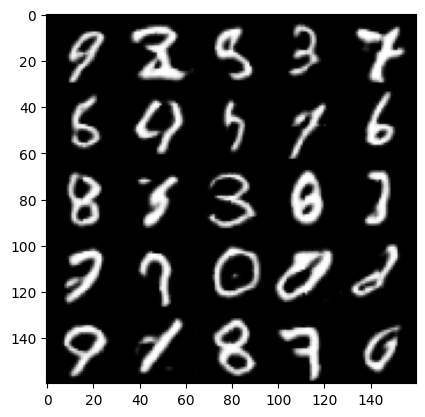

epoch 53:
batch 0 gen loss: -10.59683609008789, discr loss: 39.12812423706055


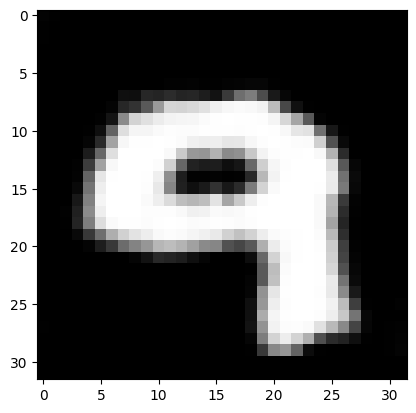

batch 100 gen loss: 0.5832023620605469, discr loss: 38.92304992675781


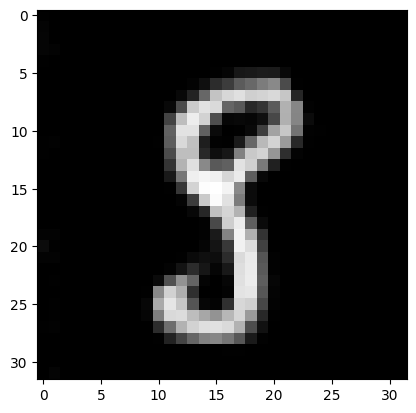

batch 200 gen loss: -7.3682732582092285, discr loss: 38.91023254394531


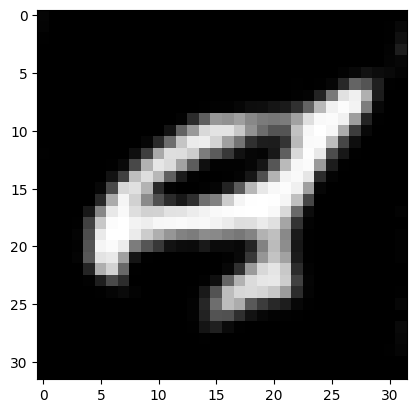

batch 300 gen loss: -6.659272193908691, discr loss: 38.71384048461914


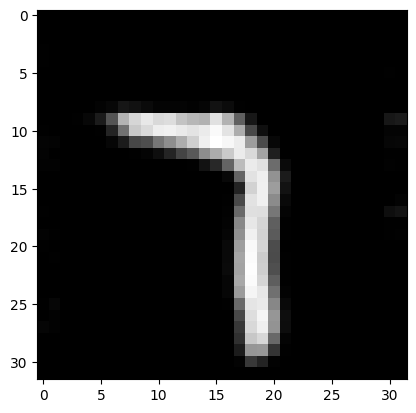

batch 400 gen loss: -6.7713823318481445, discr loss: 38.57344055175781


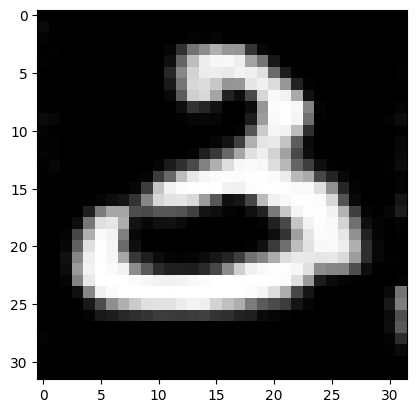

batch 500 gen loss: -2.832178831100464, discr loss: 38.17332077026367


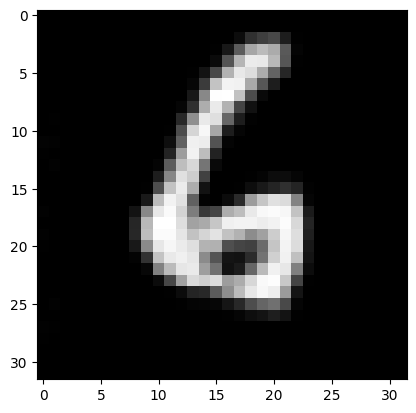

batch 600 gen loss: -3.333186149597168, discr loss: 34.64305114746094


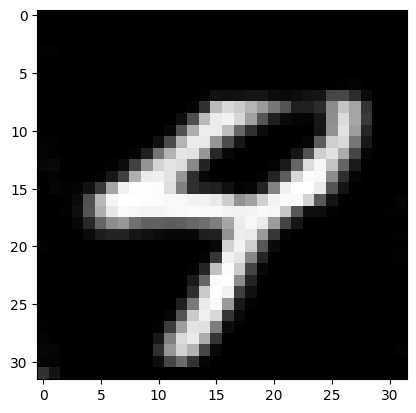

batch 700 gen loss: -3.249504327774048, discr loss: 38.64005661010742


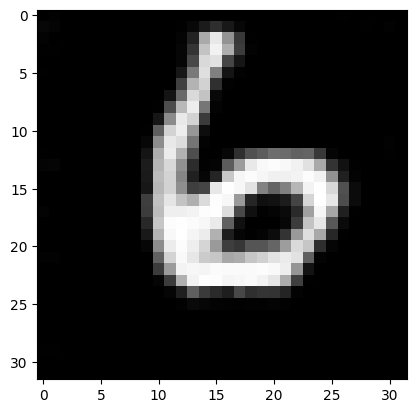

batch 800 gen loss: -3.135214328765869, discr loss: 38.39570999145508


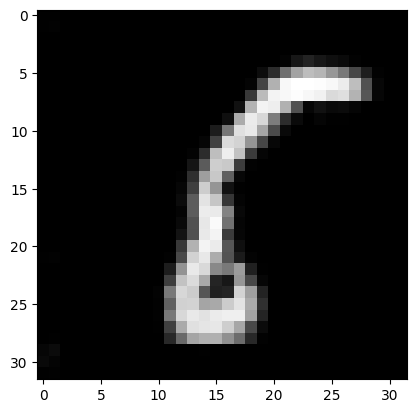

batch 900 gen loss: -0.16566236317157745, discr loss: 39.0239372253418


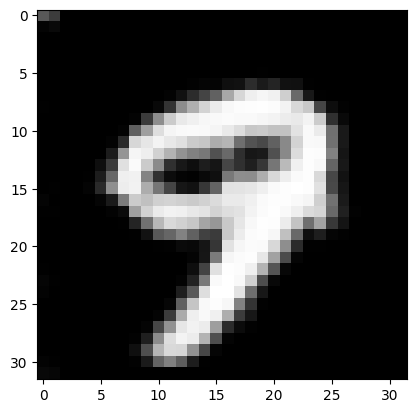

-4566.0029296875 35656.11328125


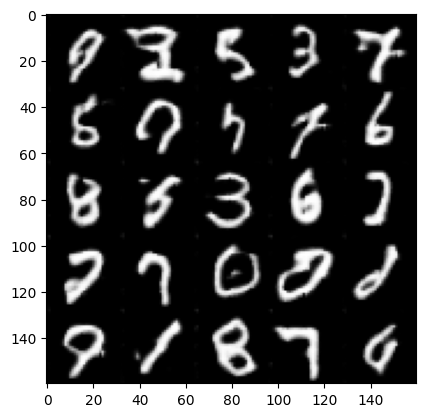

epoch 54:
batch 0 gen loss: -2.8022828102111816, discr loss: 38.41206359863281


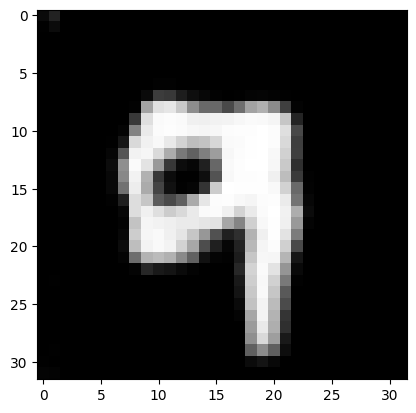

batch 100 gen loss: -7.3682732582092285, discr loss: 39.10585403442383


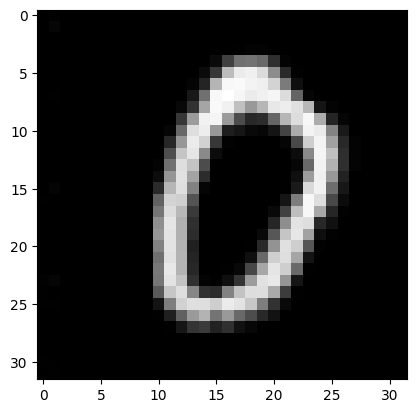

batch 200 gen loss: -6.587890625, discr loss: 38.65473937988281


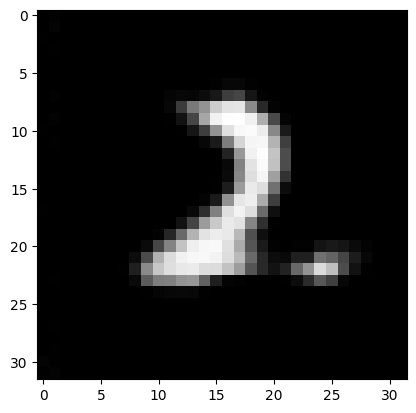

batch 300 gen loss: -10.598658561706543, discr loss: 42.64298629760742


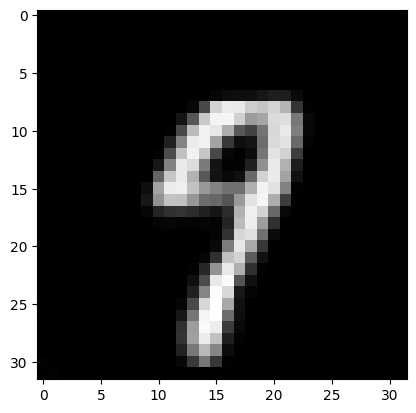

batch 400 gen loss: -3.6841366291046143, discr loss: 42.46883773803711


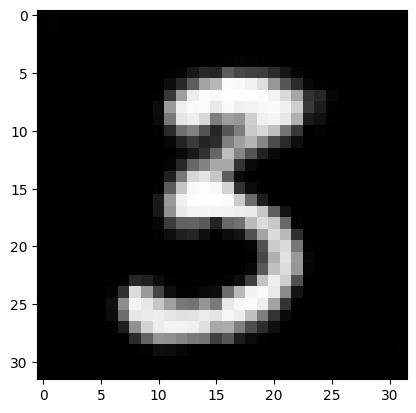

batch 500 gen loss: -3.6841366291046143, discr loss: 42.50007629394531


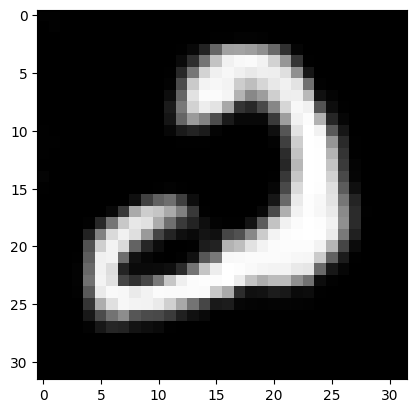

batch 600 gen loss: -3.1143808364868164, discr loss: 42.441261291503906


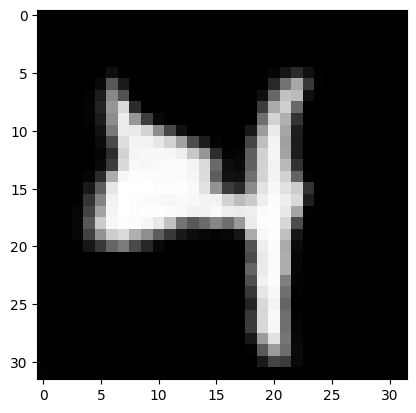

batch 700 gen loss: -7.3682732582092285, discr loss: 42.41249465942383


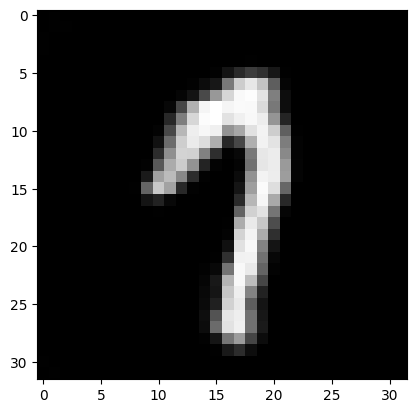

batch 800 gen loss: -7.036454200744629, discr loss: 42.65312194824219


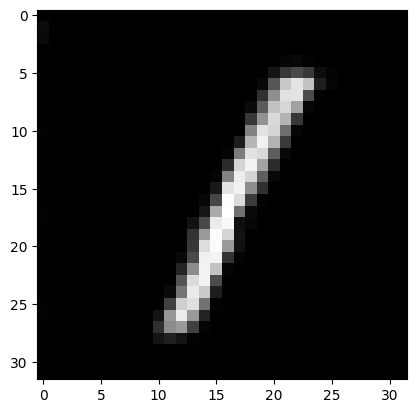

batch 900 gen loss: -7.3682732582092285, discr loss: 42.48767852783203


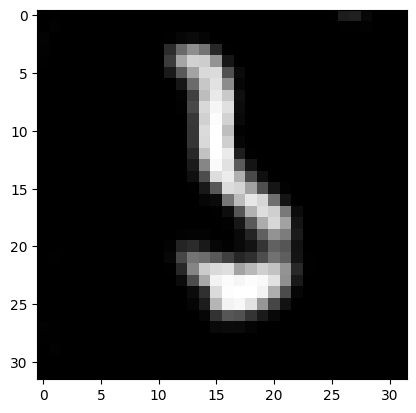

-6219.701171875 39167.95703125


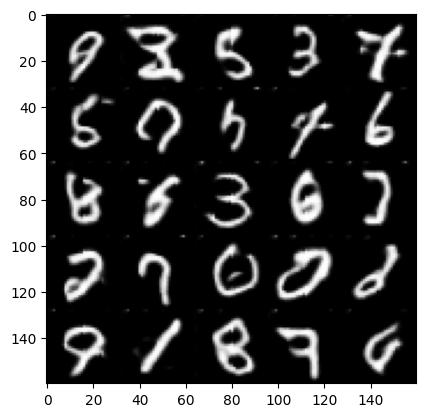

epoch 55:
batch 0 gen loss: -6.841861724853516, discr loss: 42.4534912109375


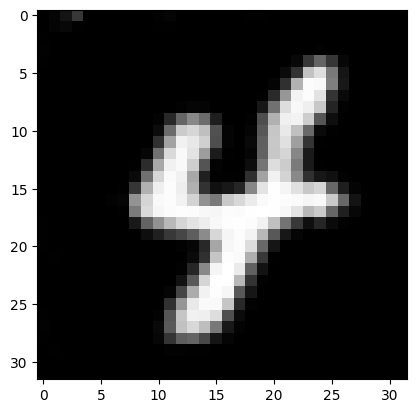

batch 100 gen loss: -6.816624641418457, discr loss: 42.452415466308594


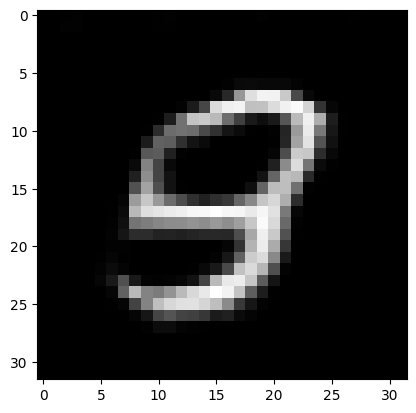

batch 200 gen loss: 0.7221335172653198, discr loss: 36.74689483642578


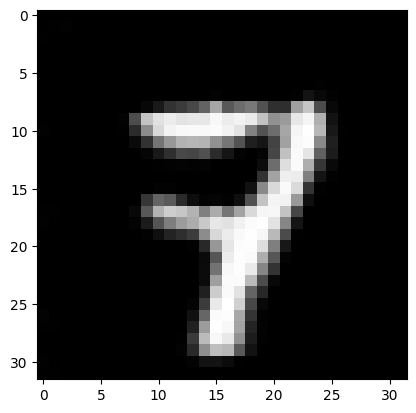

batch 300 gen loss: -3.6841366291046143, discr loss: 39.8353385925293


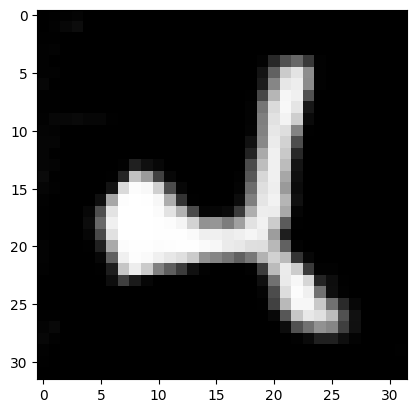

batch 400 gen loss: 1.0297969579696655, discr loss: 39.57368850708008


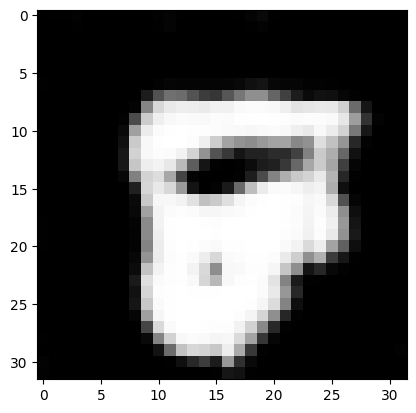

batch 500 gen loss: -3.1226437091827393, discr loss: 39.50008773803711


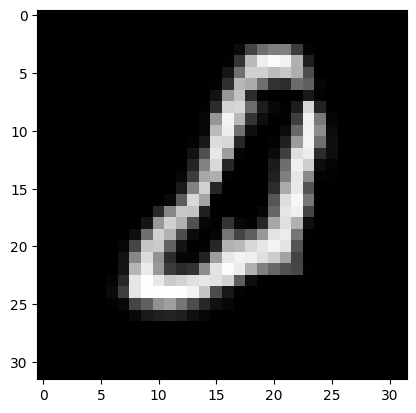

batch 600 gen loss: -10.489385604858398, discr loss: 38.986515045166016


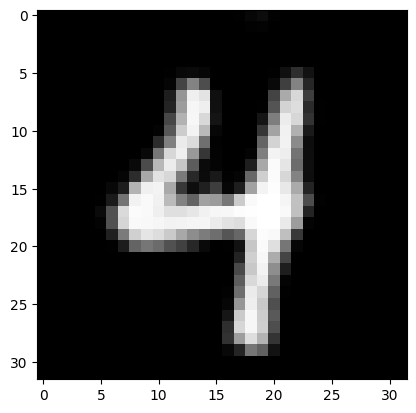

batch 700 gen loss: -2.499880790710449, discr loss: 39.25616455078125


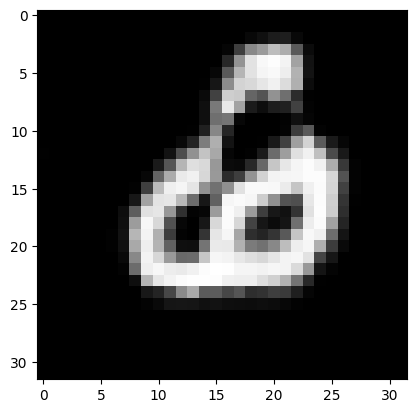

batch 800 gen loss: -7.3682732582092285, discr loss: 38.93553161621094


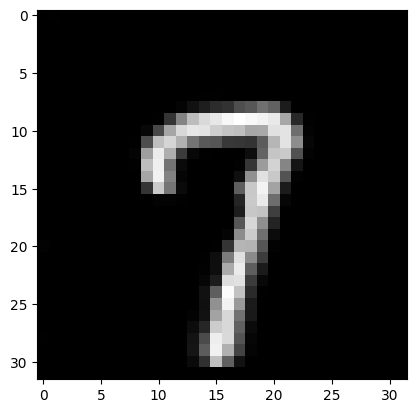

batch 900 gen loss: -7.3682732582092285, discr loss: 42.347412109375


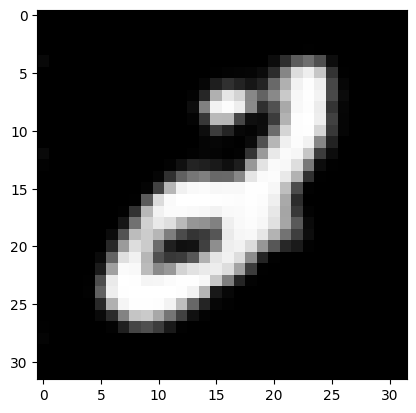

-4903.76220703125 37437.484375


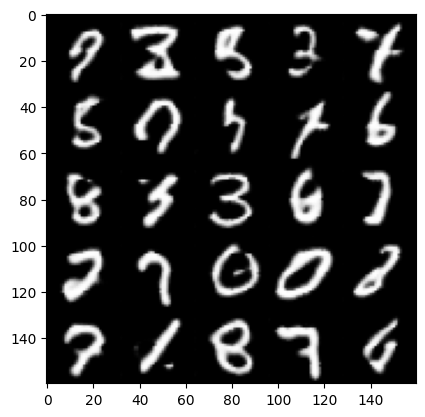

epoch 56:
batch 0 gen loss: -6.731754302978516, discr loss: 39.131351470947266


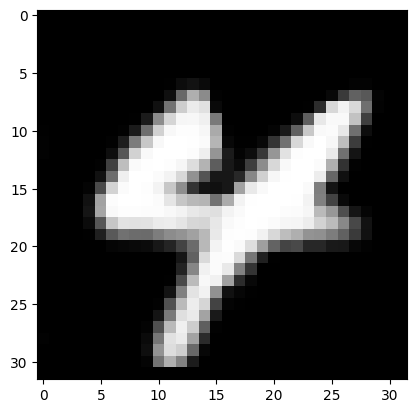

batch 100 gen loss: -10.47532844543457, discr loss: 47.14232635498047


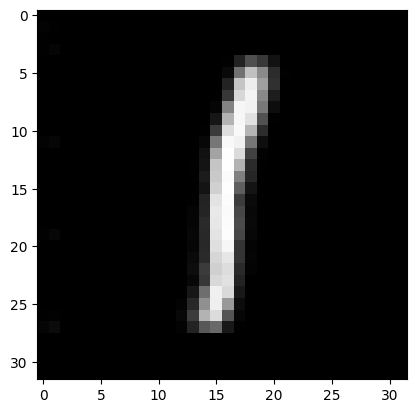

batch 200 gen loss: -6.499752998352051, discr loss: 47.061370849609375


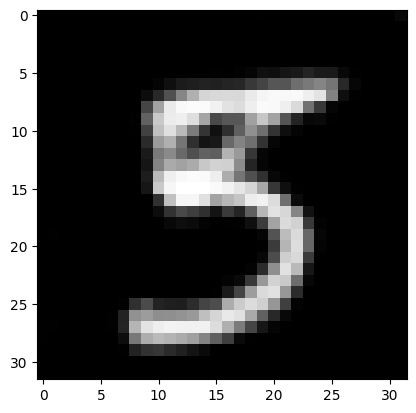

batch 300 gen loss: -7.036605358123779, discr loss: 51.24755096435547


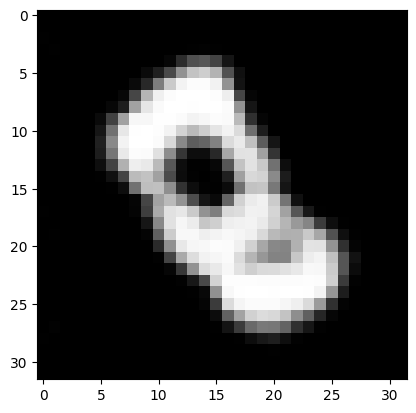

batch 400 gen loss: 0.0, discr loss: 51.270450592041016


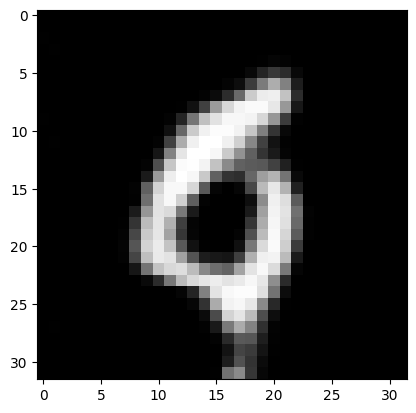

batch 500 gen loss: -3.6841366291046143, discr loss: 55.26203918457031


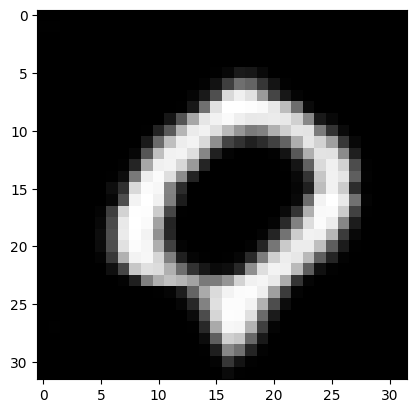

batch 600 gen loss: -14.736546516418457, discr loss: 55.26203918457031


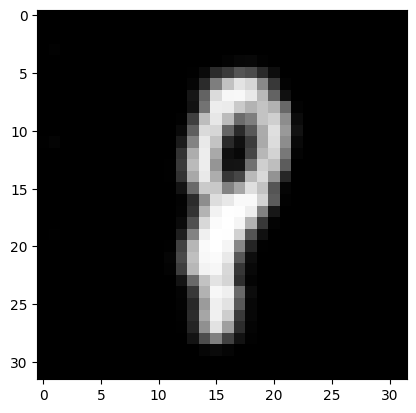

batch 700 gen loss: -3.6841366291046143, discr loss: 55.26203918457031


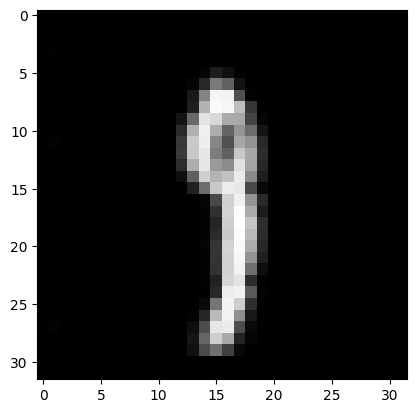

batch 800 gen loss: -3.6841366291046143, discr loss: 55.26203918457031


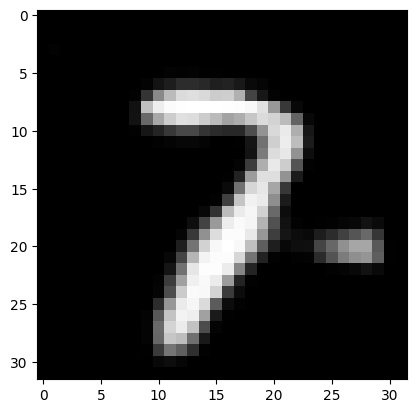

batch 900 gen loss: -7.3682732582092285, discr loss: 55.26203918457031


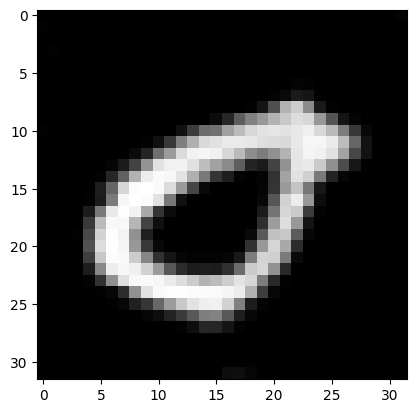

-7258.9326171875 49153.33984375


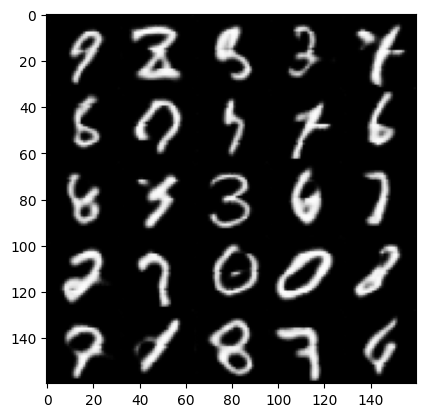

epoch 57:
batch 0 gen loss: -11.052410125732422, discr loss: 55.26203918457031


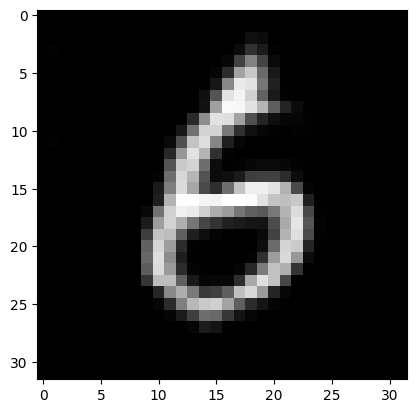

batch 100 gen loss: -11.052410125732422, discr loss: 55.26203918457031


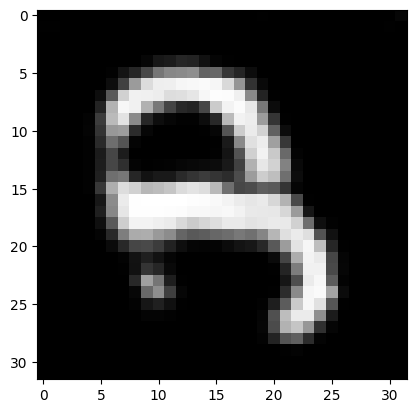

batch 200 gen loss: -14.736546516418457, discr loss: 55.26203918457031


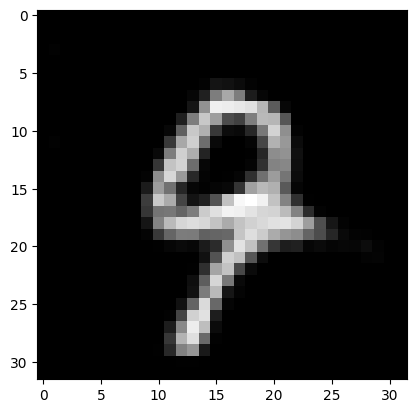

batch 300 gen loss: -7.3682732582092285, discr loss: 55.26203918457031


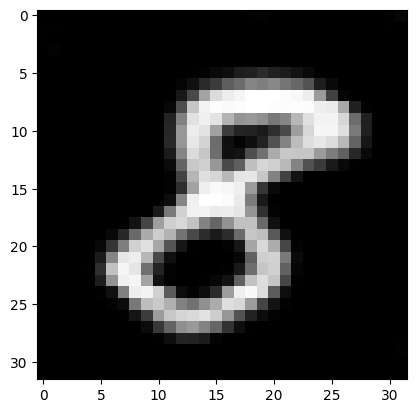

batch 400 gen loss: -7.3682732582092285, discr loss: 55.26203918457031


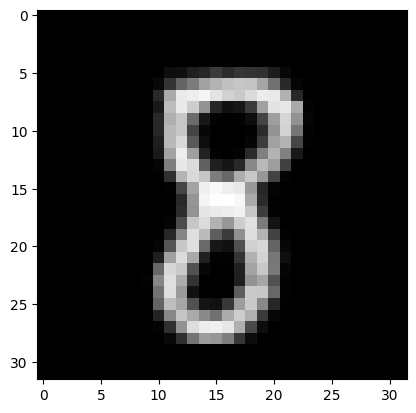

batch 500 gen loss: -7.3682732582092285, discr loss: 55.26203918457031


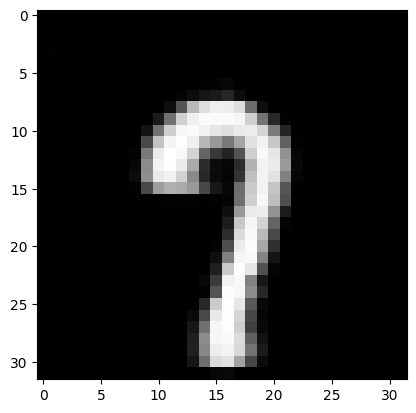

batch 600 gen loss: -7.3682732582092285, discr loss: 55.26203918457031


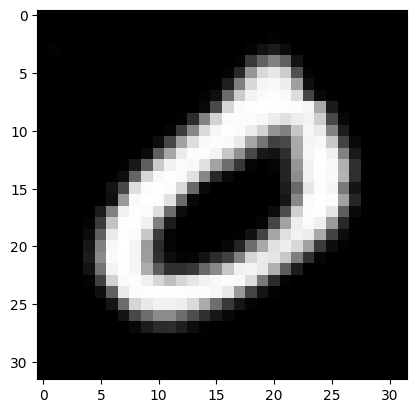

batch 700 gen loss: -11.052410125732422, discr loss: 55.26203918457031


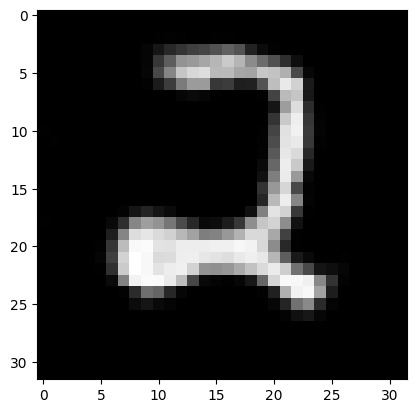

batch 800 gen loss: -7.3682732582092285, discr loss: 55.26203918457031


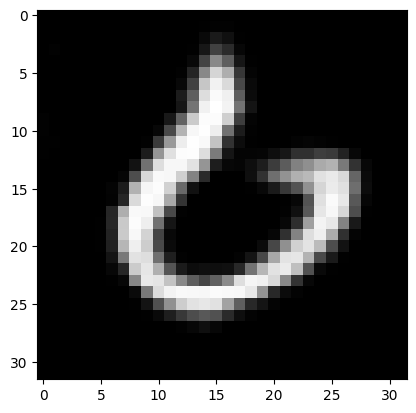

batch 900 gen loss: -11.052410125732422, discr loss: 55.26203918457031


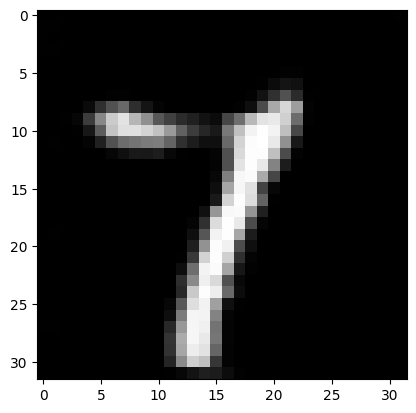

-8738.7236328125 51780.2890625


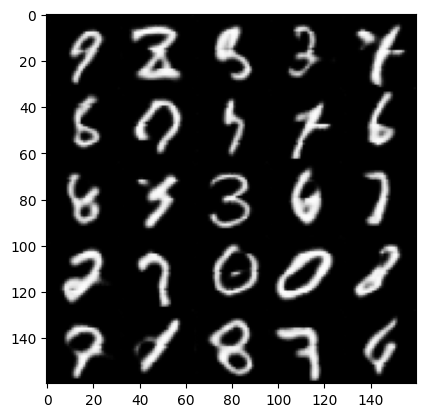

epoch 58:
batch 0 gen loss: -11.052410125732422, discr loss: 55.26203918457031


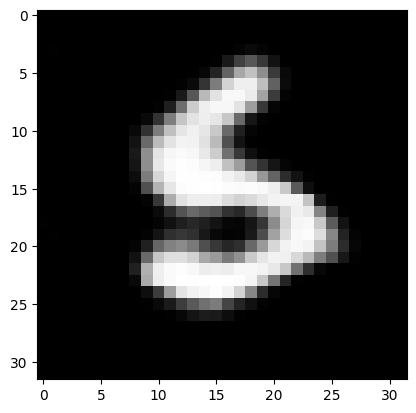

batch 100 gen loss: -7.3682732582092285, discr loss: 55.26203918457031


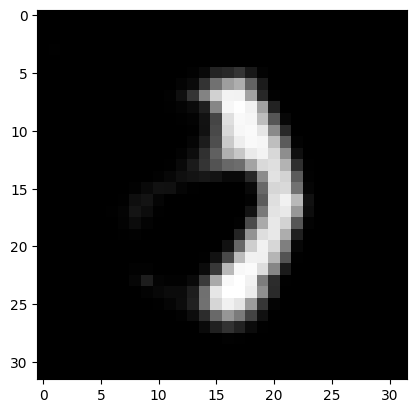

batch 200 gen loss: -3.6841366291046143, discr loss: 55.26203918457031


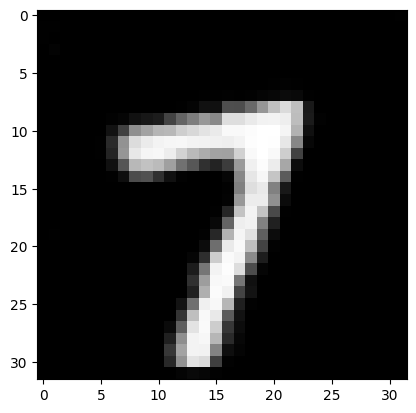

batch 300 gen loss: -11.052410125732422, discr loss: 55.26203918457031


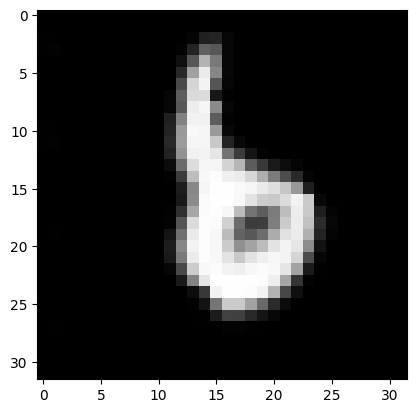

batch 400 gen loss: -11.052410125732422, discr loss: 55.26203918457031


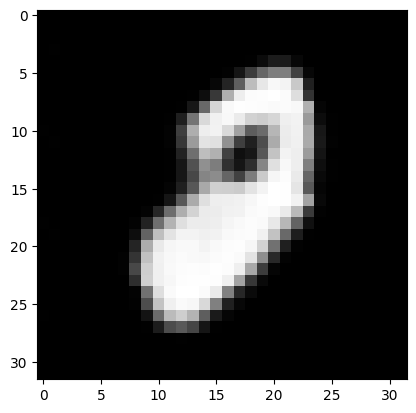

batch 500 gen loss: -14.736546516418457, discr loss: 55.26203918457031


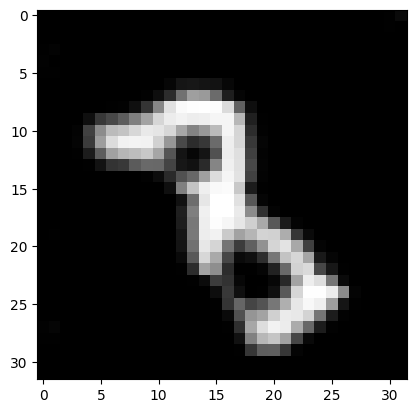

batch 600 gen loss: -7.3682732582092285, discr loss: 55.26203918457031


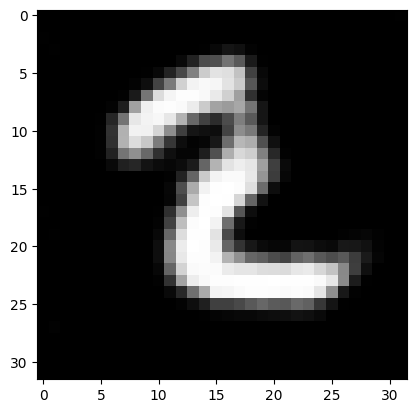

batch 700 gen loss: -7.3682732582092285, discr loss: 55.26203918457031


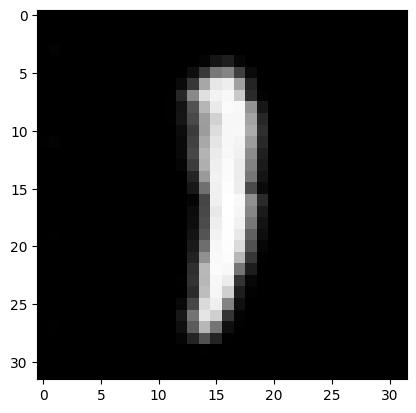

batch 800 gen loss: -14.736546516418457, discr loss: 55.26203918457031


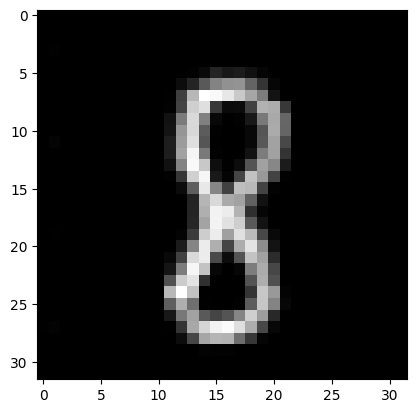

batch 900 gen loss: -11.052410125732422, discr loss: 55.26203918457031


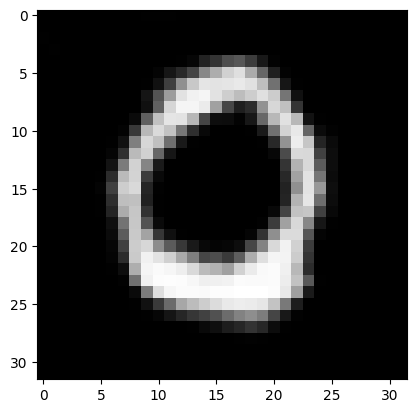

-8727.669921875 51780.2890625


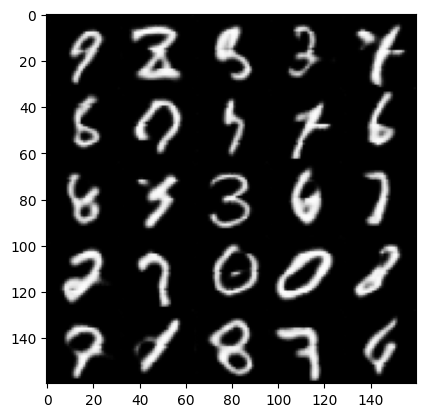

epoch 59:
batch 0 gen loss: -3.6841366291046143, discr loss: 55.26203918457031


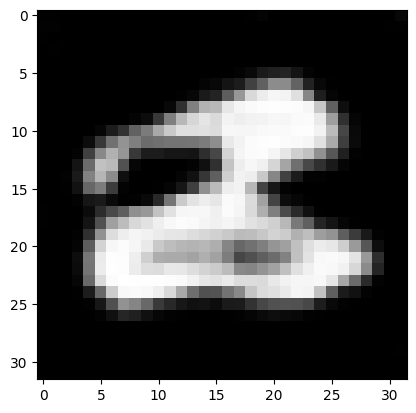

batch 100 gen loss: -14.736546516418457, discr loss: 55.26203918457031


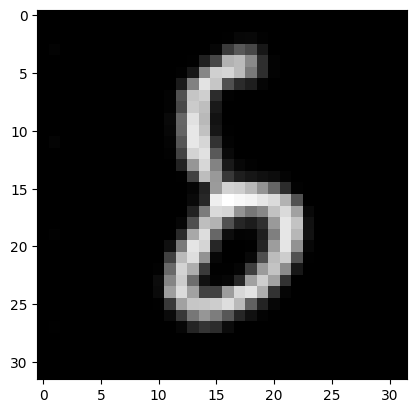

batch 200 gen loss: -11.052410125732422, discr loss: 55.26203918457031


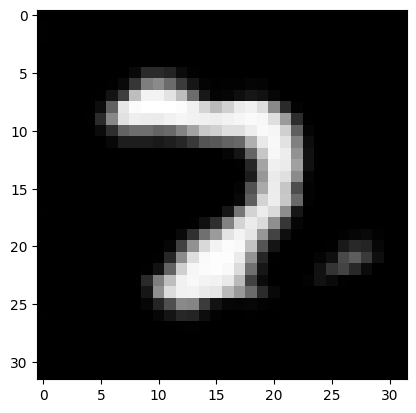

batch 300 gen loss: -14.736546516418457, discr loss: 55.26203918457031


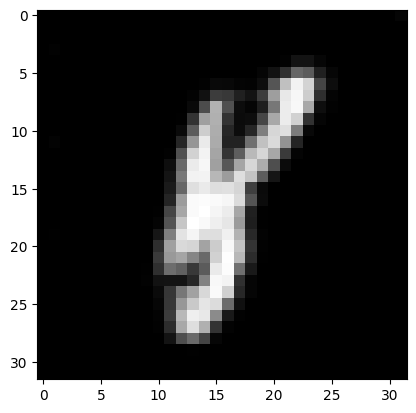

batch 400 gen loss: -3.6841366291046143, discr loss: 55.26203918457031


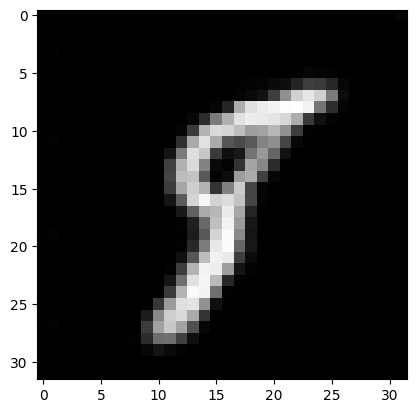

batch 500 gen loss: -14.736546516418457, discr loss: 55.26203918457031


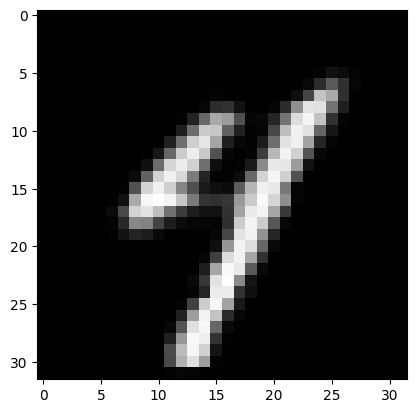

batch 600 gen loss: -11.052410125732422, discr loss: 55.26203918457031


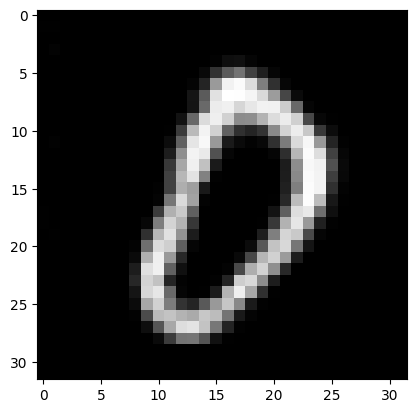

batch 700 gen loss: -11.052410125732422, discr loss: 55.26203918457031


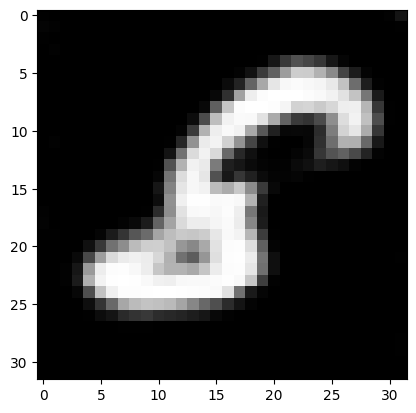

batch 800 gen loss: -11.052410125732422, discr loss: 55.26203918457031


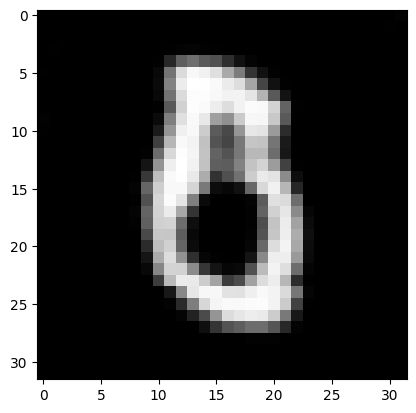

batch 900 gen loss: -3.6841366291046143, discr loss: 55.26203918457031


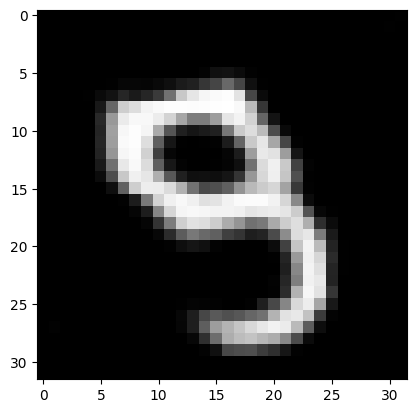

-8819.7724609375 51780.2890625


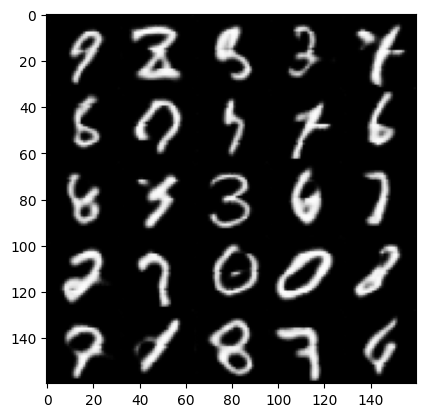

epoch 60:
batch 0 gen loss: -7.3682732582092285, discr loss: 55.26203918457031


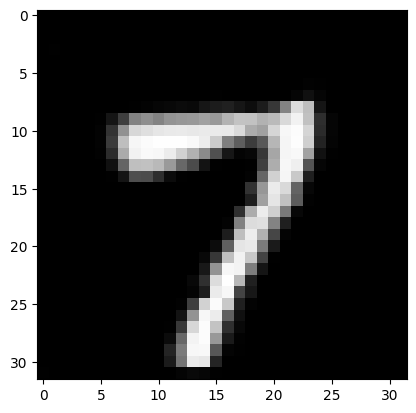

batch 100 gen loss: -11.052410125732422, discr loss: 55.26203918457031


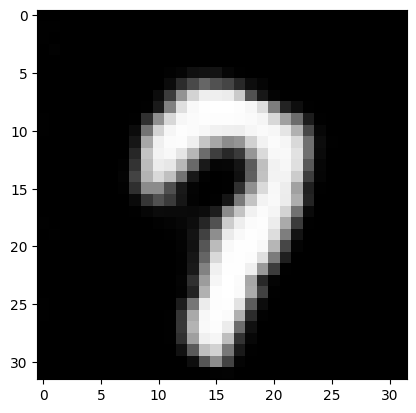

batch 200 gen loss: -3.6841366291046143, discr loss: 55.26203918457031


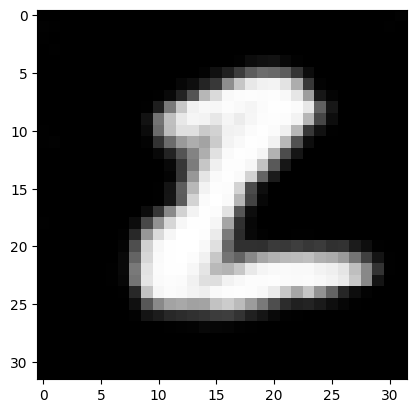

batch 300 gen loss: -7.3682732582092285, discr loss: 55.26203918457031


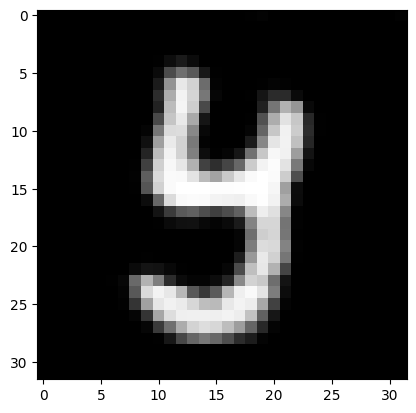

batch 400 gen loss: -14.736546516418457, discr loss: 55.26203918457031


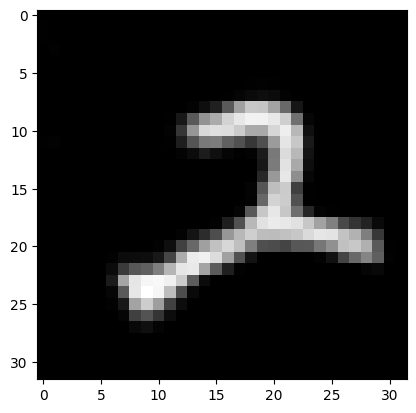

batch 500 gen loss: -14.736546516418457, discr loss: 55.26203918457031


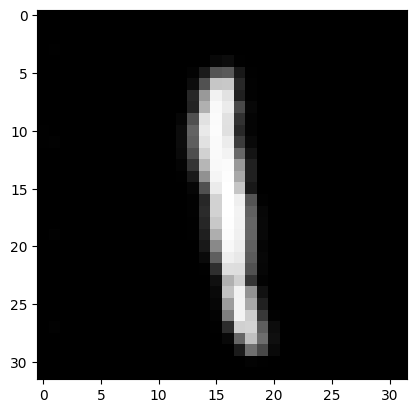

batch 600 gen loss: -7.3682732582092285, discr loss: 55.26203918457031


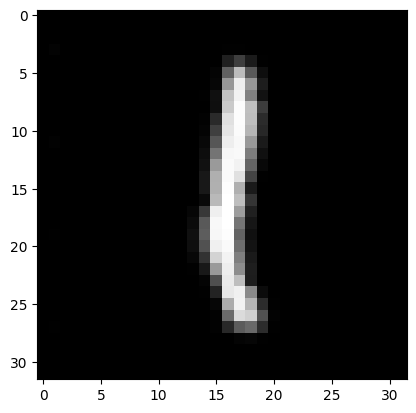

batch 700 gen loss: -3.6841366291046143, discr loss: 55.26203918457031


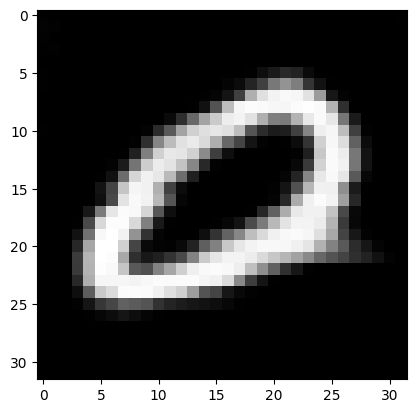

batch 800 gen loss: -14.736546516418457, discr loss: 55.26203918457031


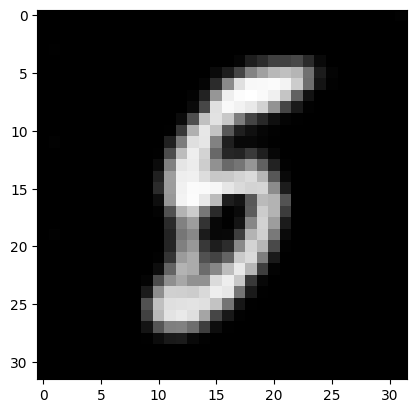

batch 900 gen loss: -14.736546516418457, discr loss: 55.26203918457031


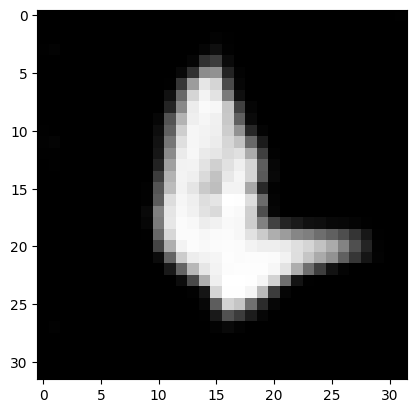

-8926.6181640625 51780.2890625


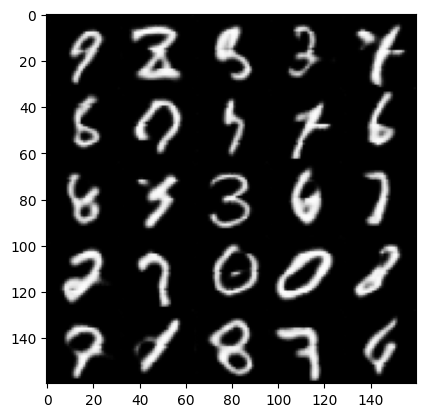

epoch 61:
batch 0 gen loss: -11.052410125732422, discr loss: 55.26203918457031


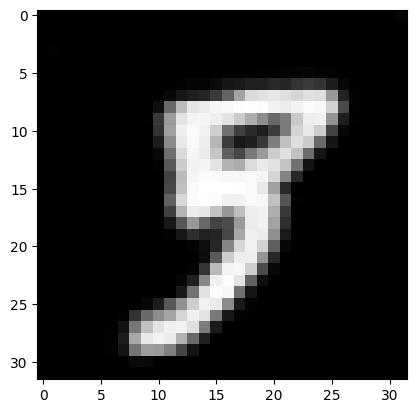

batch 100 gen loss: -18.420682907104492, discr loss: 55.26203918457031


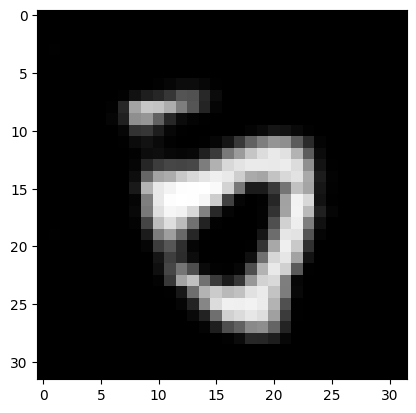

batch 200 gen loss: -11.052410125732422, discr loss: 55.26203918457031


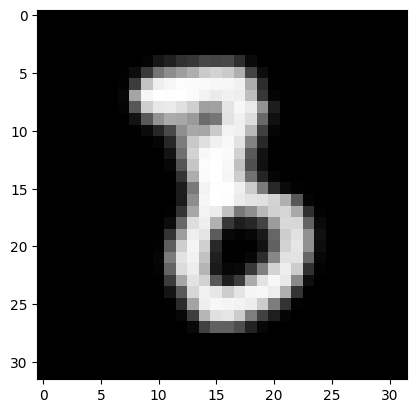

batch 300 gen loss: -7.3682732582092285, discr loss: 55.26203918457031


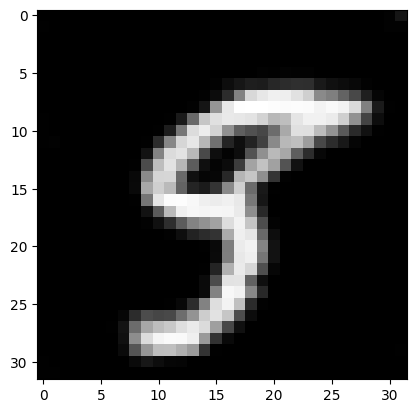

batch 400 gen loss: -7.3682732582092285, discr loss: 55.26203918457031


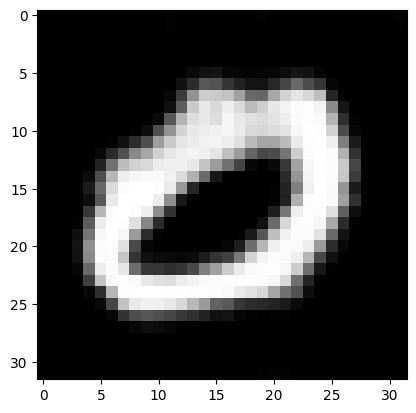

batch 500 gen loss: -11.052410125732422, discr loss: 55.26203918457031


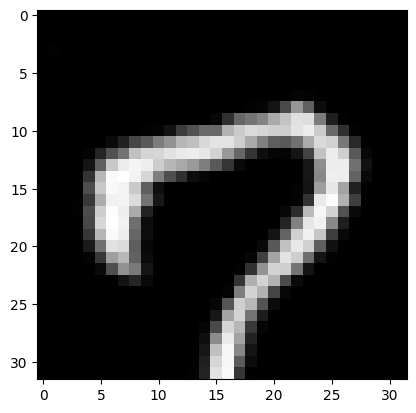

batch 600 gen loss: -7.3682732582092285, discr loss: 55.26203918457031


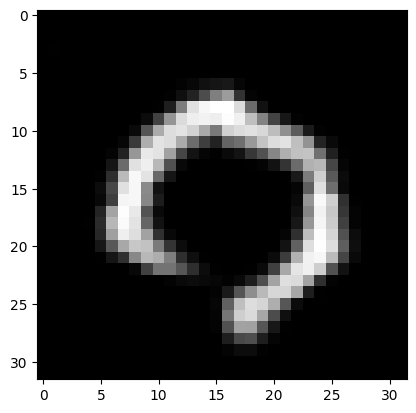

batch 700 gen loss: -3.6841366291046143, discr loss: 55.26203918457031


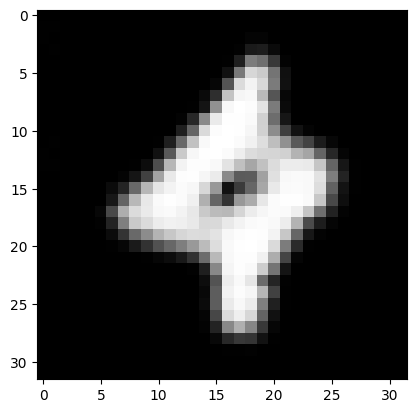

batch 800 gen loss: -7.3682732582092285, discr loss: 55.26203918457031


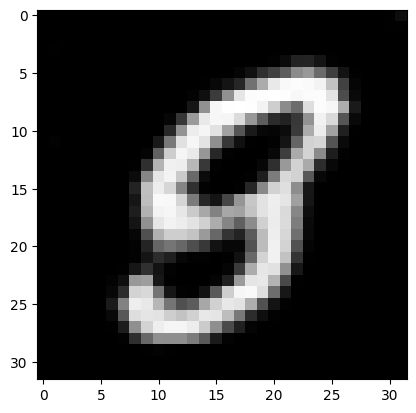

batch 900 gen loss: -3.6841366291046143, discr loss: 55.26203918457031


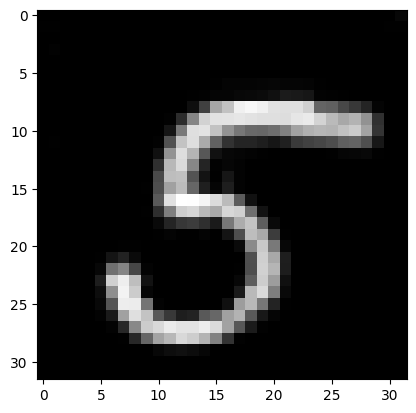

-8561.8798828125 51780.2890625


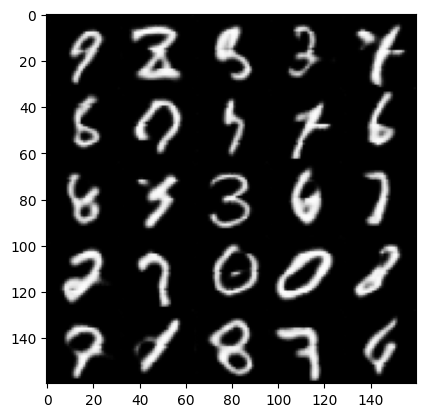

epoch 62:
batch 0 gen loss: -14.736546516418457, discr loss: 55.26203918457031


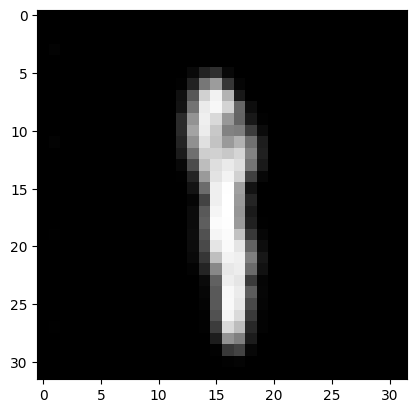

batch 100 gen loss: -11.052410125732422, discr loss: 55.26203918457031


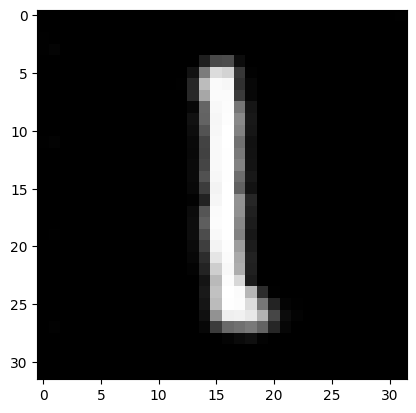

batch 200 gen loss: -11.052410125732422, discr loss: 55.26203918457031


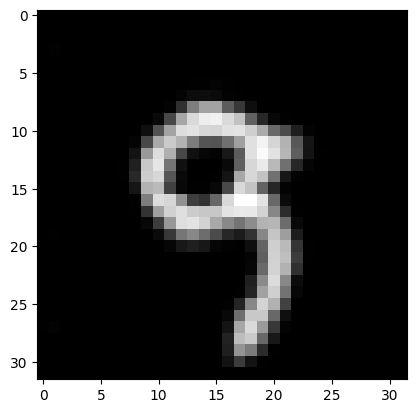

batch 300 gen loss: -14.736546516418457, discr loss: 55.26203918457031


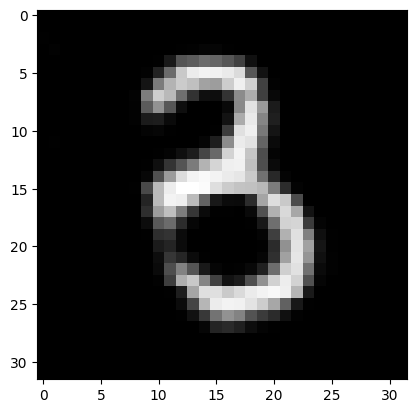

batch 400 gen loss: -3.6841366291046143, discr loss: 55.26203918457031


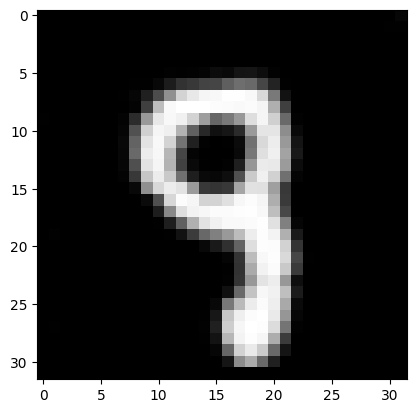

batch 500 gen loss: -7.3682732582092285, discr loss: 55.26203918457031


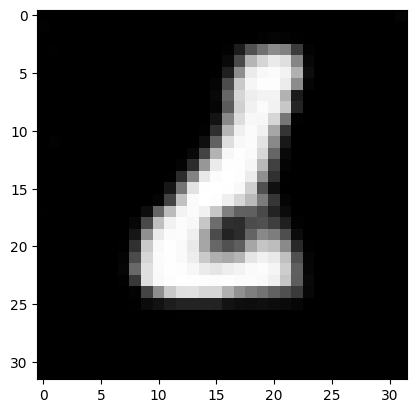

batch 600 gen loss: -7.3682732582092285, discr loss: 55.26203918457031


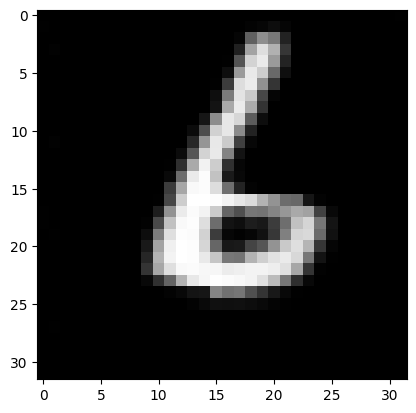

batch 700 gen loss: -7.3682732582092285, discr loss: 55.26203918457031


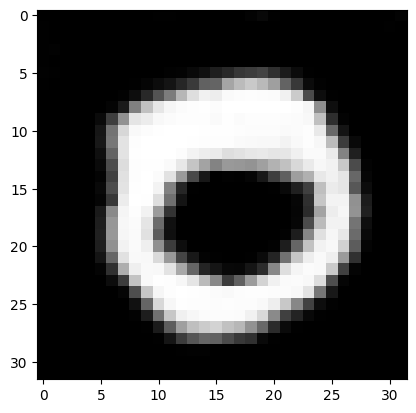

batch 800 gen loss: -7.3682732582092285, discr loss: 55.26203918457031


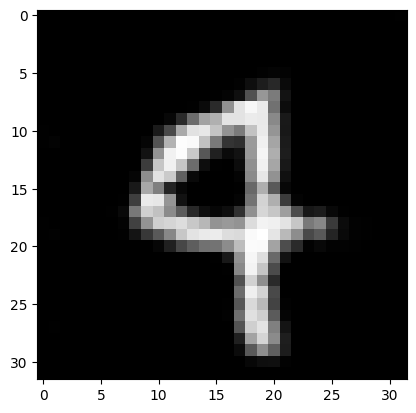

batch 900 gen loss: -7.3682732582092285, discr loss: 55.26203918457031


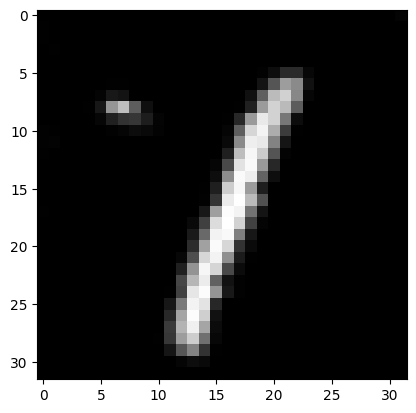

-8609.7763671875 51780.2890625


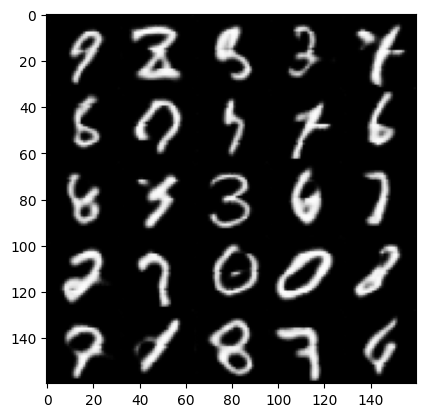

epoch 63:
batch 0 gen loss: -7.3682732582092285, discr loss: 55.26203918457031


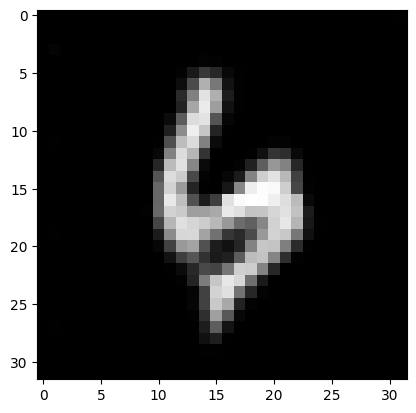

batch 100 gen loss: -14.736546516418457, discr loss: 55.26203918457031


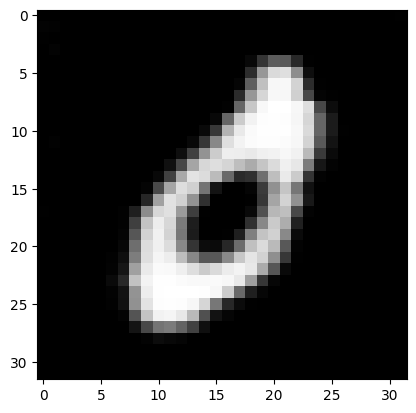

batch 200 gen loss: -7.3682732582092285, discr loss: 55.26203918457031


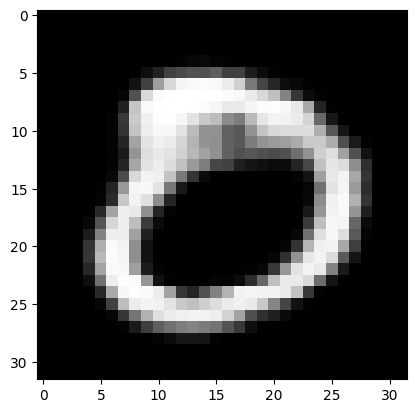

batch 300 gen loss: -7.3682732582092285, discr loss: 55.26203918457031


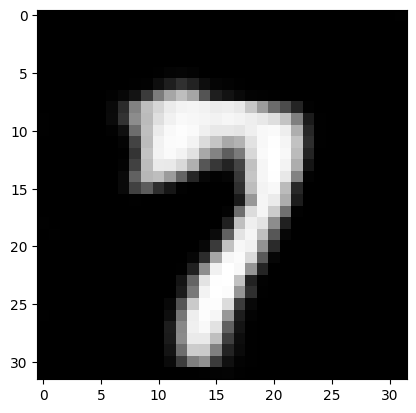

batch 400 gen loss: -11.052410125732422, discr loss: 55.26203918457031


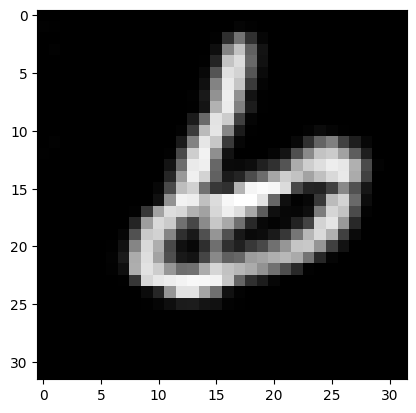

batch 500 gen loss: -11.052410125732422, discr loss: 55.26203918457031


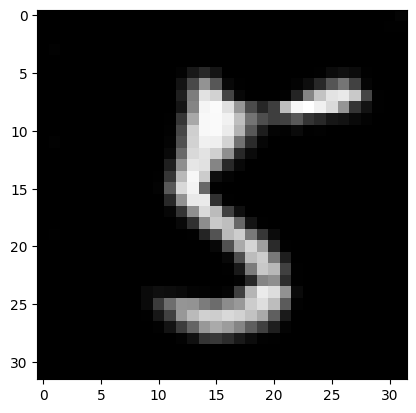

batch 600 gen loss: -7.3682732582092285, discr loss: 55.26203918457031


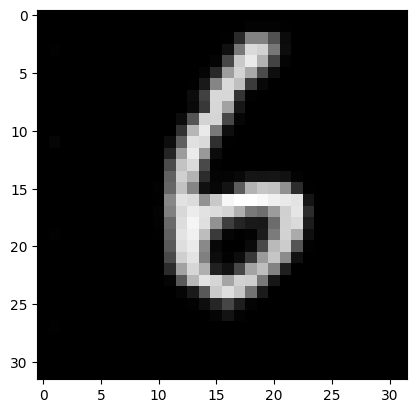

batch 700 gen loss: -7.3682732582092285, discr loss: 55.26203918457031


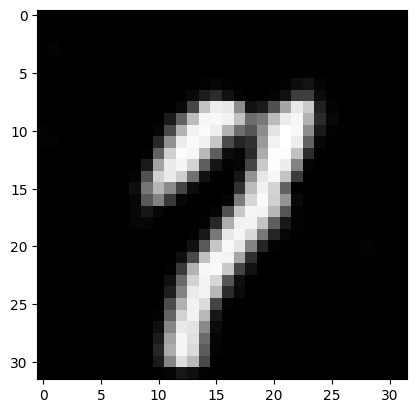

batch 800 gen loss: -11.052410125732422, discr loss: 55.26203918457031


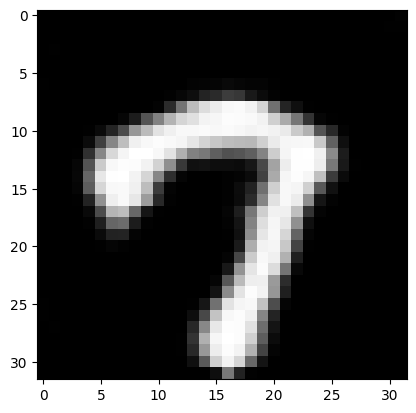

batch 900 gen loss: -7.3682732582092285, discr loss: 55.26203918457031


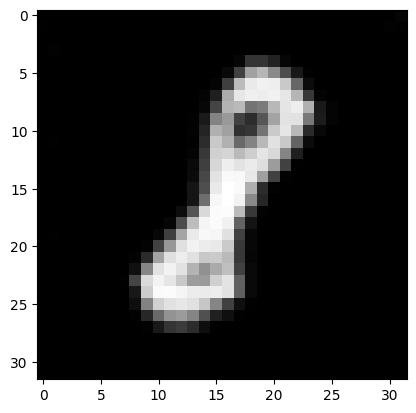

-8591.3505859375 51780.2890625


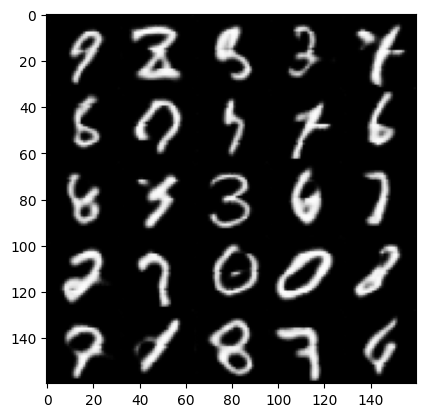

epoch 64:
batch 0 gen loss: -3.6841366291046143, discr loss: 55.26203918457031


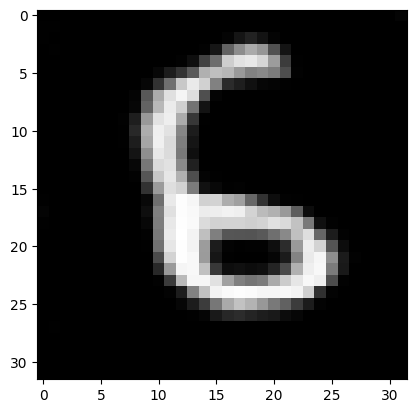

batch 100 gen loss: -14.736546516418457, discr loss: 55.26203918457031


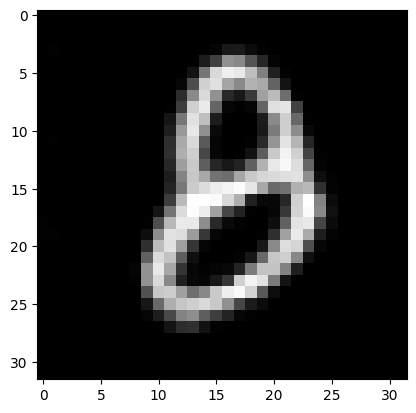

batch 200 gen loss: -11.052410125732422, discr loss: 55.26203918457031


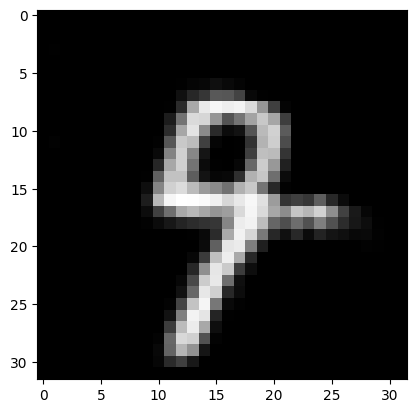

batch 300 gen loss: -14.736546516418457, discr loss: 55.26203918457031


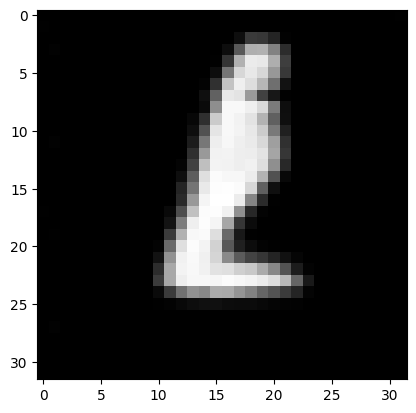

batch 400 gen loss: -3.6841366291046143, discr loss: 55.26203918457031


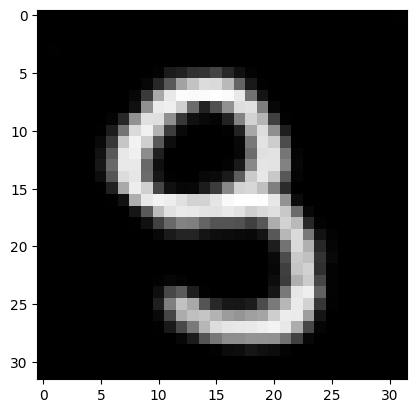

batch 500 gen loss: -11.052410125732422, discr loss: 55.26203918457031


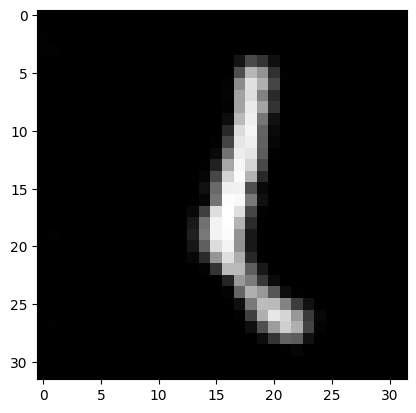

batch 600 gen loss: -7.3682732582092285, discr loss: 55.26203918457031


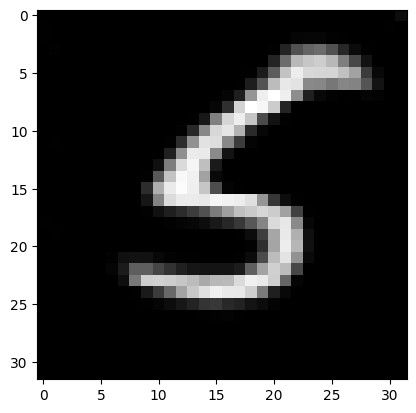

batch 700 gen loss: -14.736546516418457, discr loss: 55.26203918457031


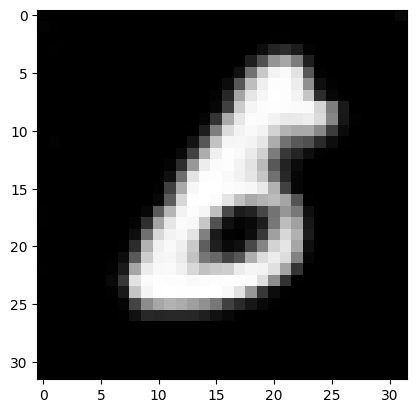

batch 800 gen loss: -18.420682907104492, discr loss: 55.26203918457031


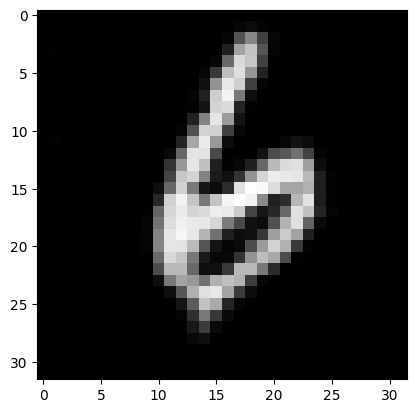

batch 900 gen loss: -11.052410125732422, discr loss: 55.26203918457031


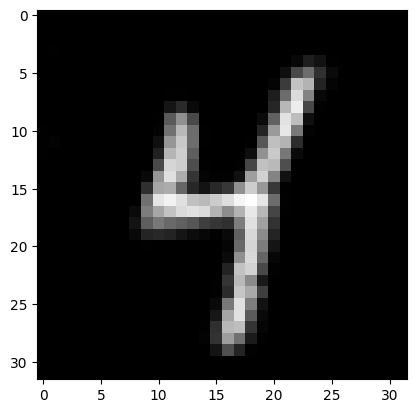

-8698.193359375 51780.2890625


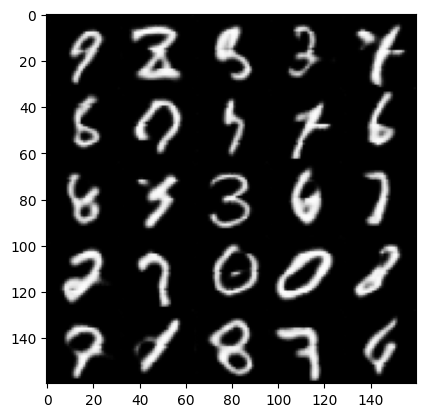

epoch 65:
batch 0 gen loss: -18.420682907104492, discr loss: 55.26203918457031


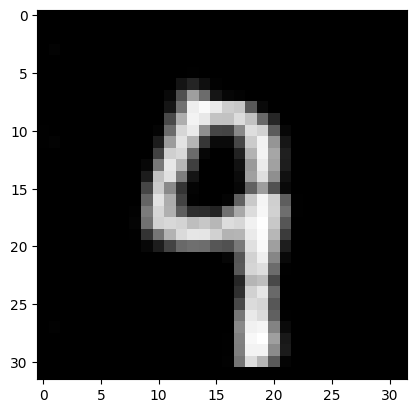

batch 100 gen loss: -11.052410125732422, discr loss: 55.26203918457031


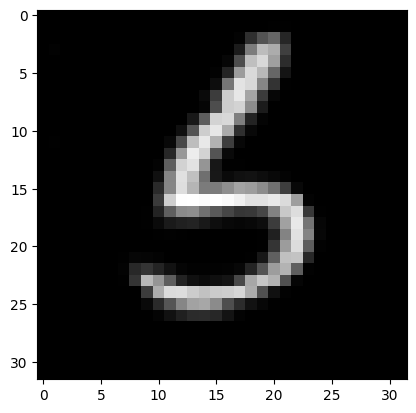

batch 200 gen loss: -14.736546516418457, discr loss: 55.26203918457031


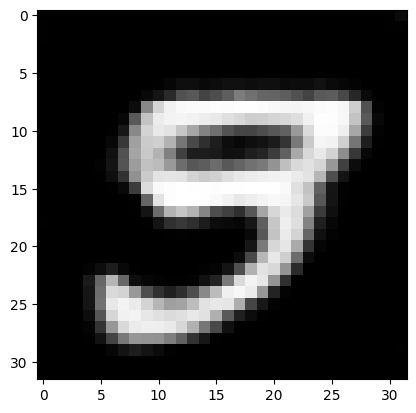

batch 300 gen loss: -7.3682732582092285, discr loss: 55.26203918457031


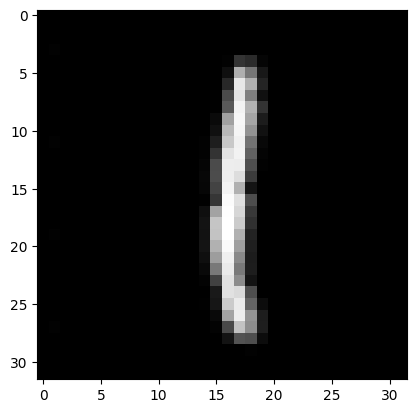

batch 400 gen loss: -7.3682732582092285, discr loss: 55.26203918457031


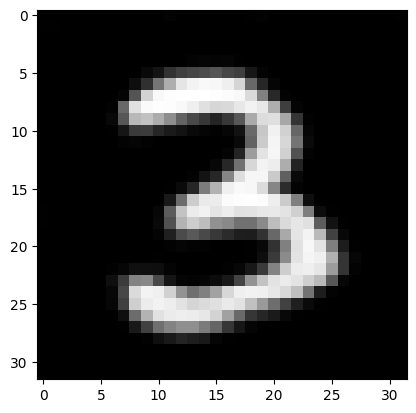

batch 500 gen loss: -3.6841366291046143, discr loss: 55.26203918457031


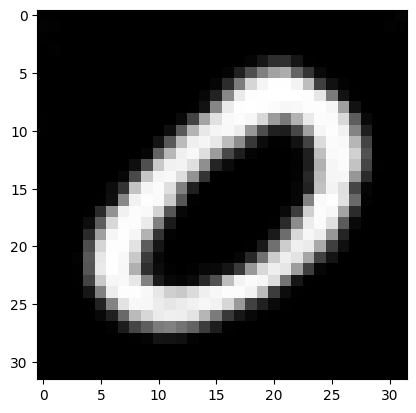

batch 600 gen loss: -7.3682732582092285, discr loss: 55.26203918457031


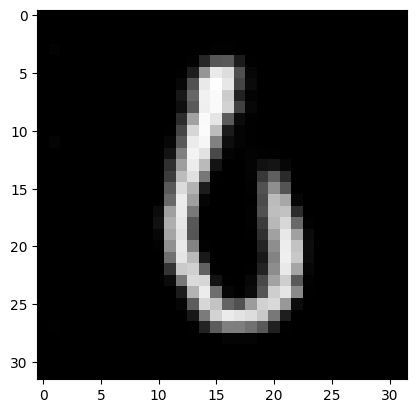

batch 700 gen loss: -7.3682732582092285, discr loss: 55.26203918457031


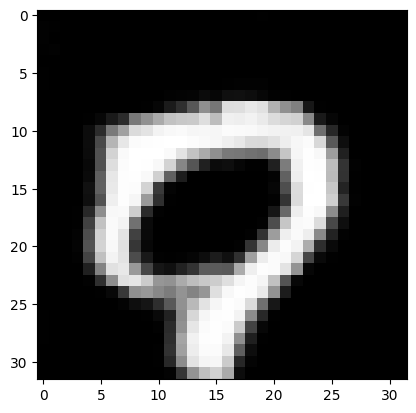

batch 800 gen loss: -7.3682732582092285, discr loss: 55.26203918457031


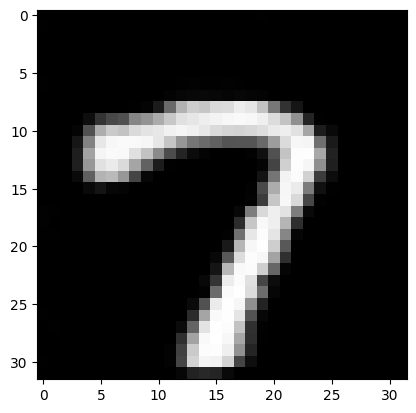

batch 900 gen loss: -3.6841366291046143, discr loss: 55.26203918457031


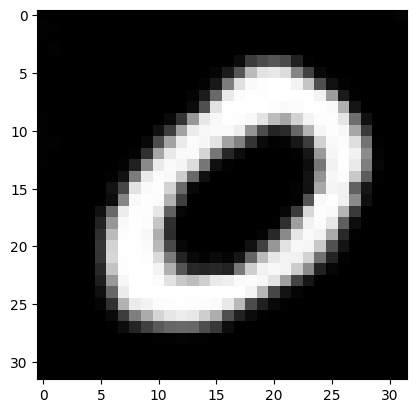

-8889.771484375 51780.2890625


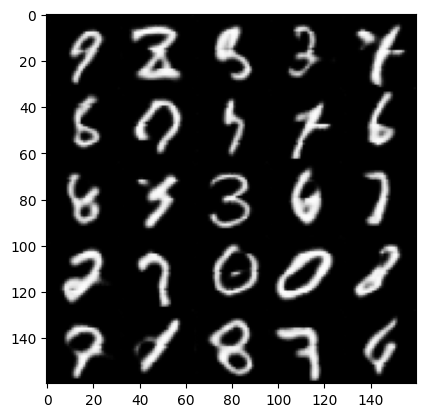

epoch 66:
batch 0 gen loss: -7.3682732582092285, discr loss: 55.26203918457031


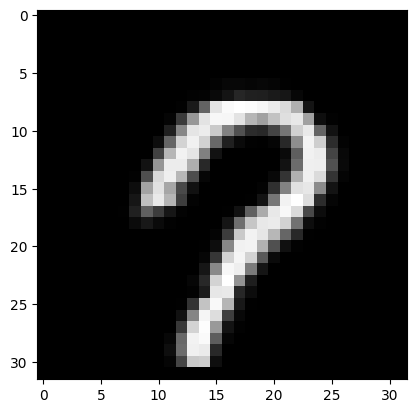

batch 100 gen loss: -7.3682732582092285, discr loss: 55.26203918457031


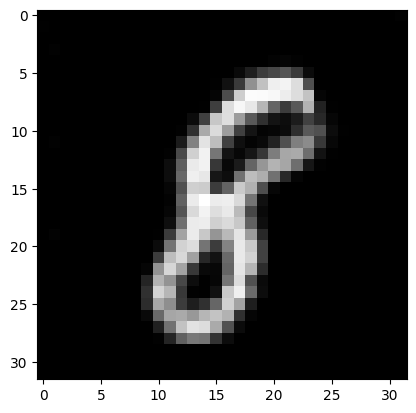

batch 200 gen loss: -7.3682732582092285, discr loss: 55.26203918457031


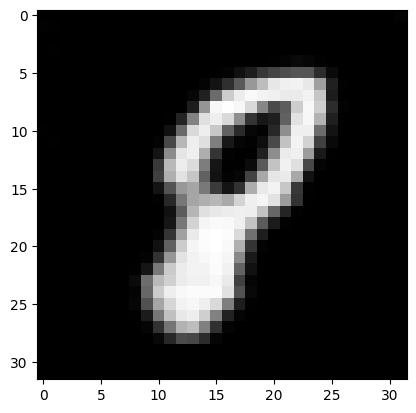

batch 300 gen loss: -14.736546516418457, discr loss: 55.26203918457031


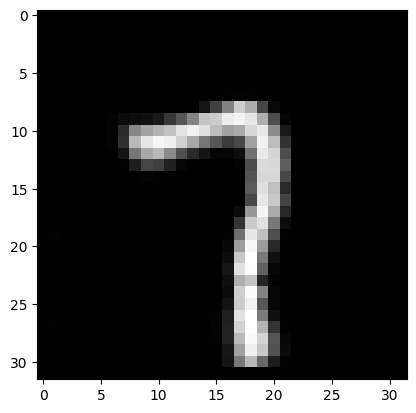

batch 400 gen loss: -11.052410125732422, discr loss: 55.26203918457031


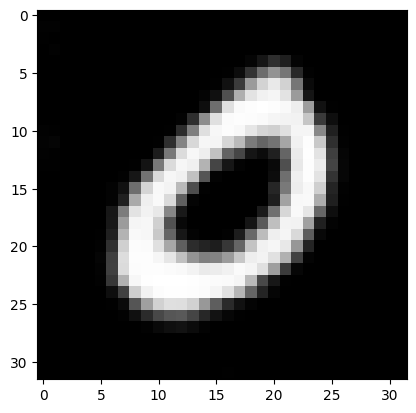

batch 500 gen loss: -11.052410125732422, discr loss: 55.26203918457031


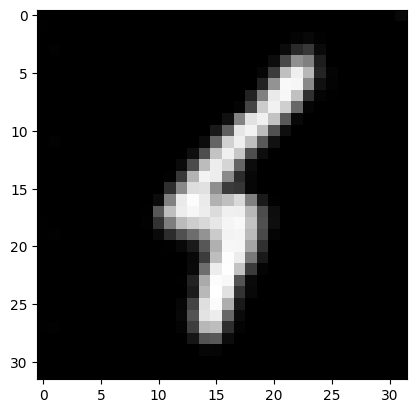

batch 600 gen loss: -18.420682907104492, discr loss: 55.26203918457031


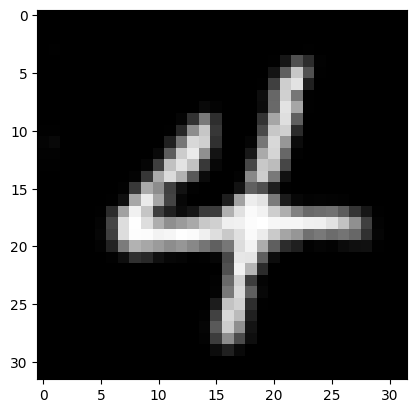

batch 700 gen loss: -11.052410125732422, discr loss: 55.26203918457031


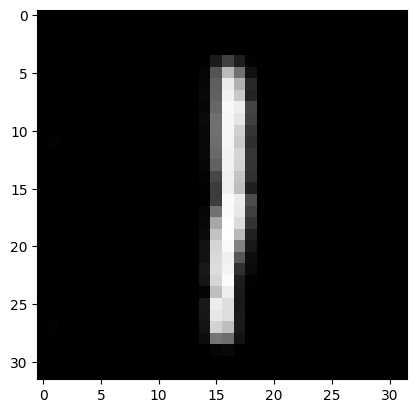

batch 800 gen loss: -7.3682732582092285, discr loss: 55.26203918457031


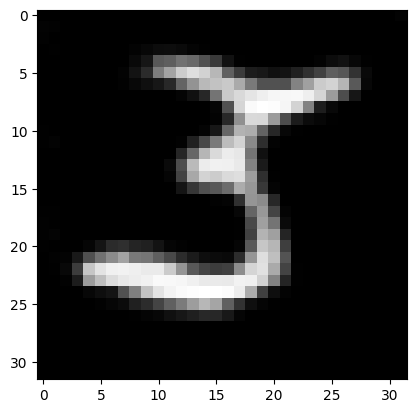

batch 900 gen loss: -11.052410125732422, discr loss: 55.26203918457031


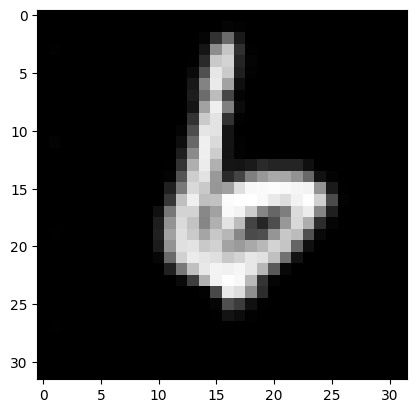

-8561.8759765625 51780.2890625


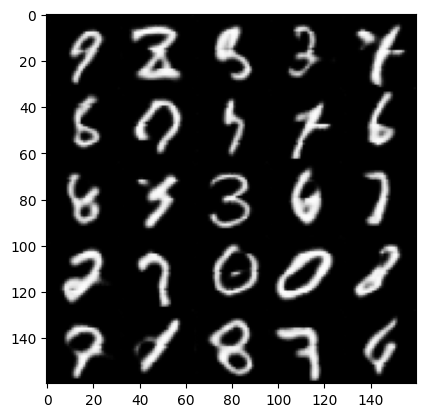

epoch 67:
batch 0 gen loss: -3.6841366291046143, discr loss: 55.26203918457031


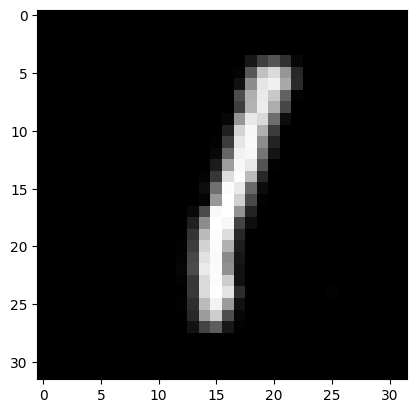

batch 100 gen loss: -11.052410125732422, discr loss: 55.26203918457031


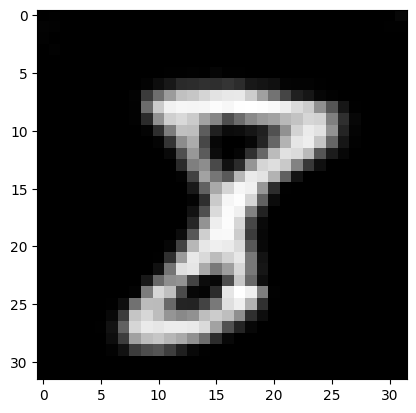

batch 200 gen loss: -14.736546516418457, discr loss: 55.26203918457031


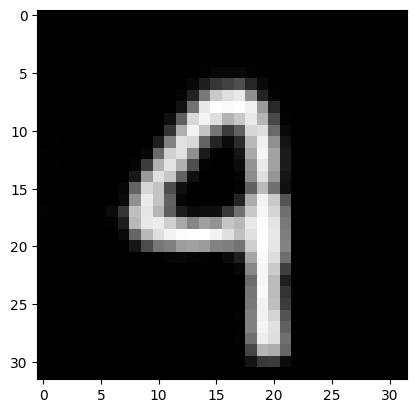

batch 300 gen loss: -14.736546516418457, discr loss: 55.26203918457031


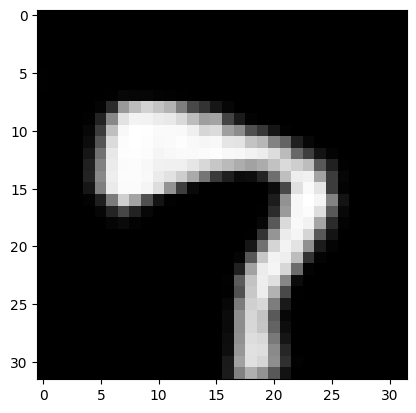

batch 400 gen loss: -14.736546516418457, discr loss: 55.26203918457031


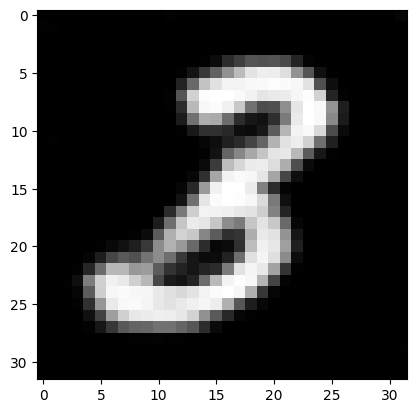

batch 500 gen loss: -7.3682732582092285, discr loss: 55.26203918457031


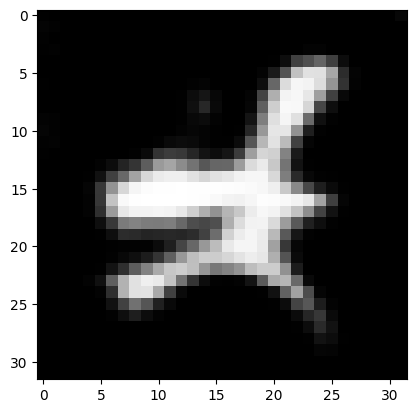

batch 600 gen loss: -7.3682732582092285, discr loss: 55.26203918457031


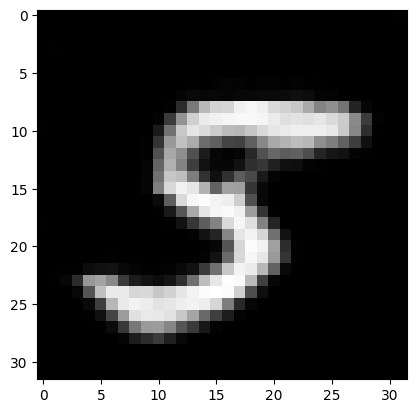

batch 700 gen loss: -11.052410125732422, discr loss: 55.26203918457031


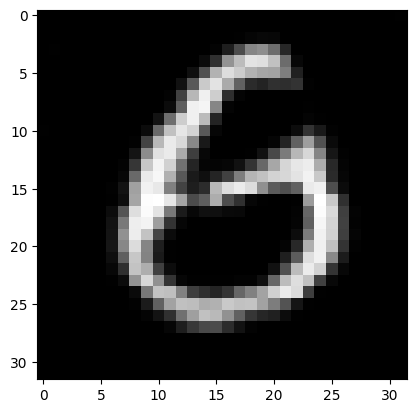

batch 800 gen loss: -7.3682732582092285, discr loss: 55.26203918457031


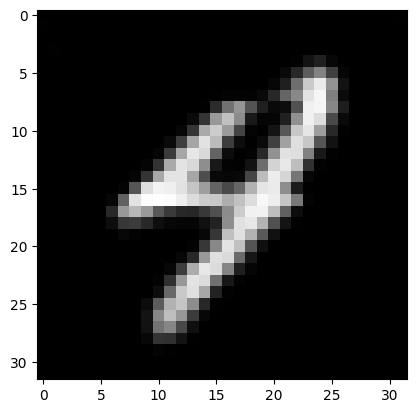

batch 900 gen loss: -3.6841366291046143, discr loss: 55.26203918457031


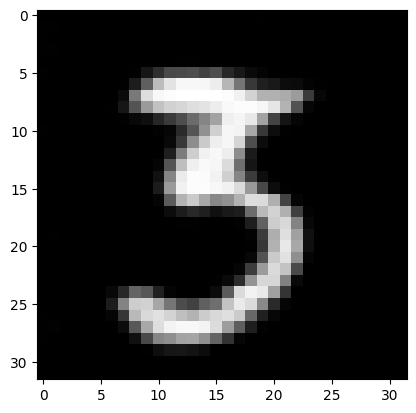

-8550.82421875 51780.2890625


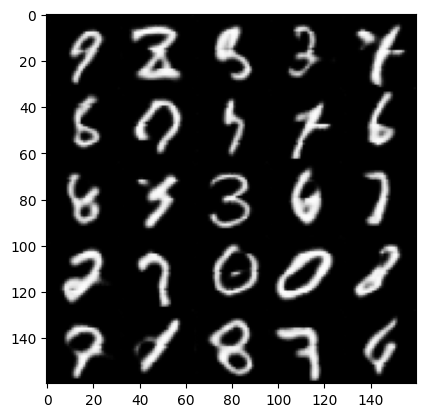

epoch 68:
batch 0 gen loss: -7.3682732582092285, discr loss: 55.26203918457031


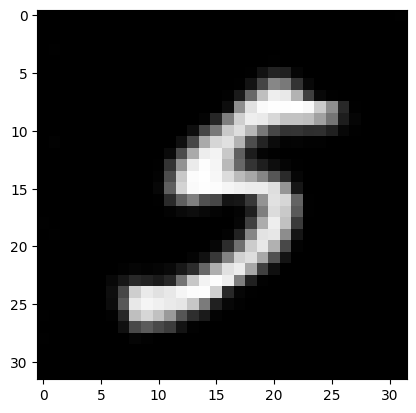

batch 100 gen loss: -14.736546516418457, discr loss: 55.26203918457031


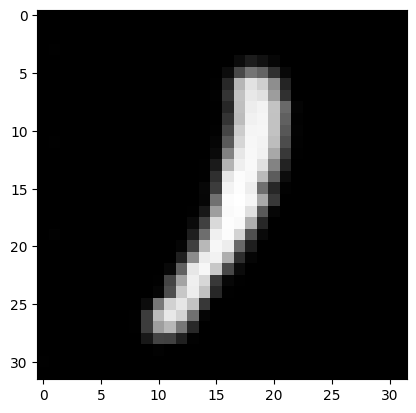

batch 200 gen loss: -11.052410125732422, discr loss: 55.26203918457031


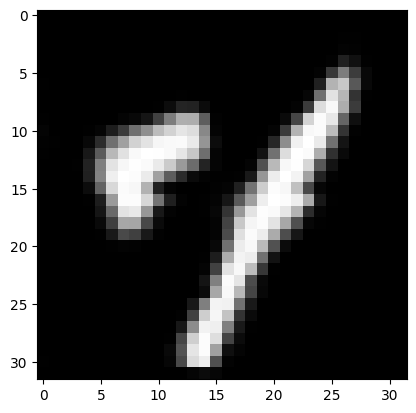

batch 300 gen loss: -11.052410125732422, discr loss: 55.26203918457031


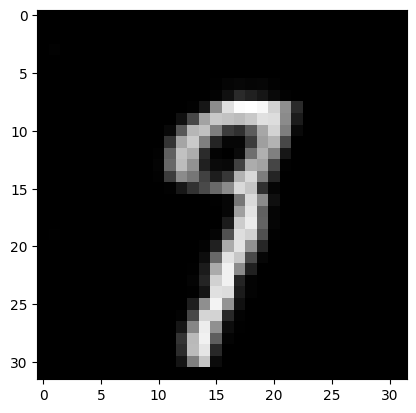

batch 400 gen loss: -7.3682732582092285, discr loss: 55.26203918457031


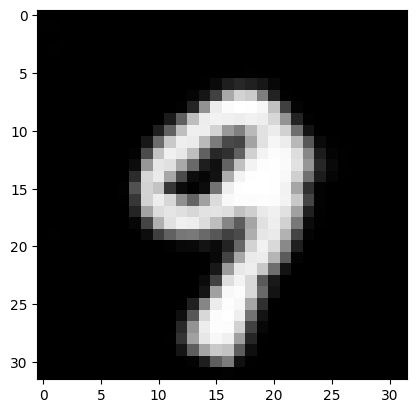

batch 500 gen loss: -3.6841366291046143, discr loss: 55.26203918457031


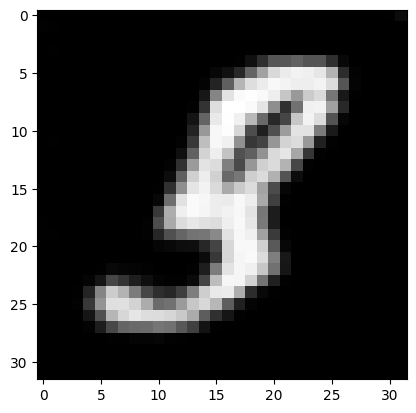

batch 600 gen loss: -14.736546516418457, discr loss: 55.26203918457031


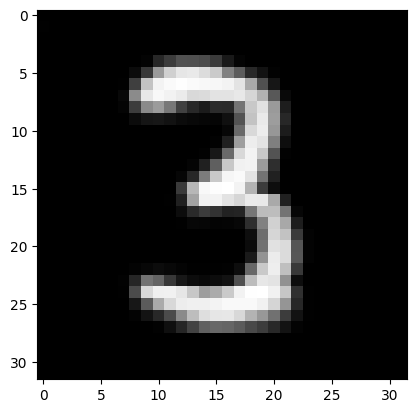

batch 700 gen loss: -11.052410125732422, discr loss: 55.26203918457031


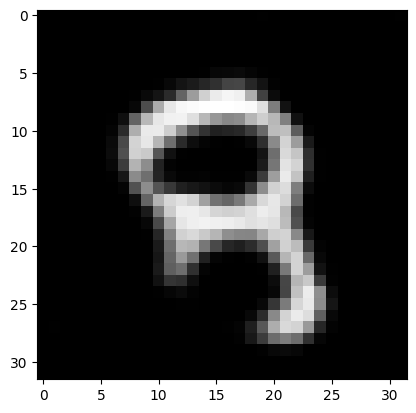

batch 800 gen loss: -3.6841366291046143, discr loss: 55.26203918457031


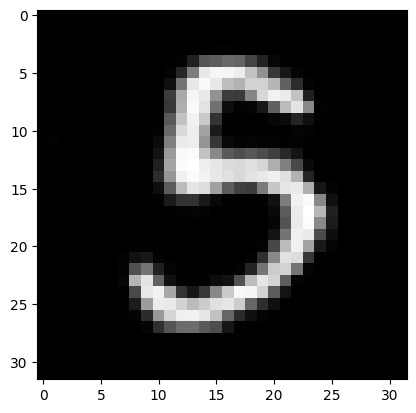

batch 900 gen loss: -11.052410125732422, discr loss: 55.26203918457031


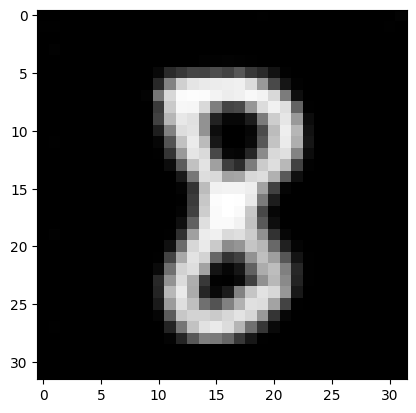

-8451.3486328125 51780.2890625


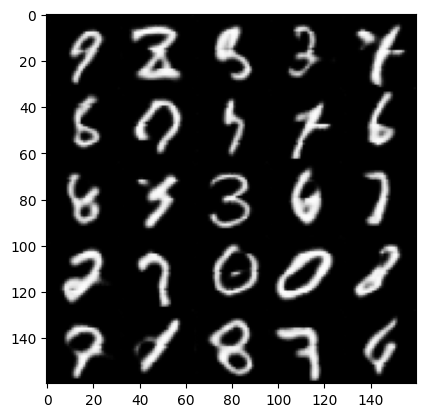

epoch 69:
batch 0 gen loss: -11.052410125732422, discr loss: 55.26203918457031


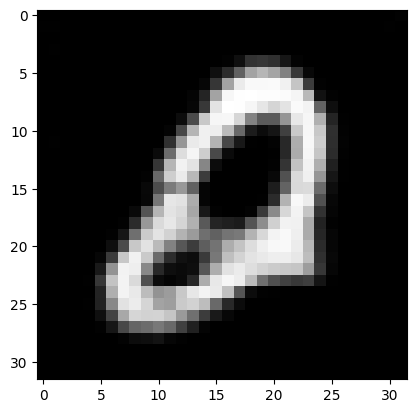

batch 100 gen loss: -11.052410125732422, discr loss: 55.26203918457031


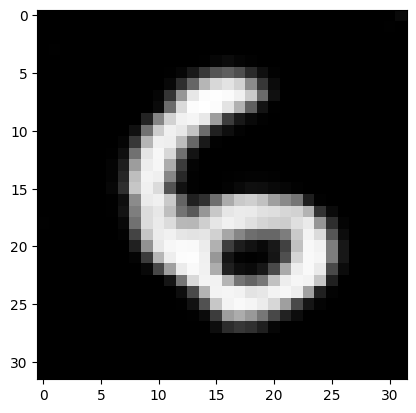

batch 200 gen loss: -7.3682732582092285, discr loss: 55.26203918457031


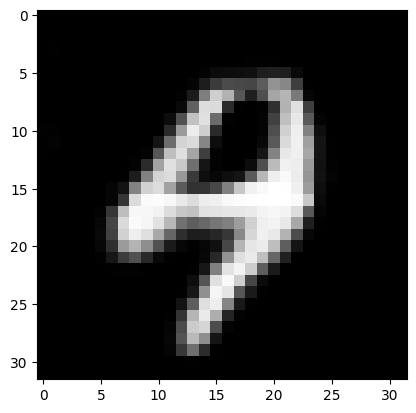

batch 300 gen loss: -11.052410125732422, discr loss: 55.26203918457031


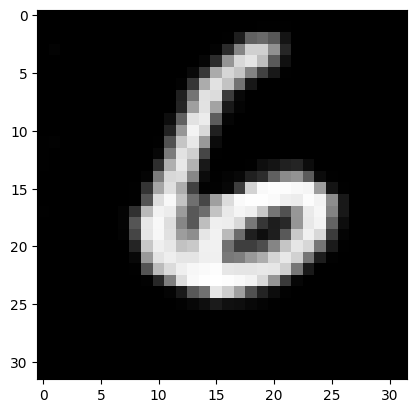

batch 400 gen loss: -3.6841366291046143, discr loss: 55.26203918457031


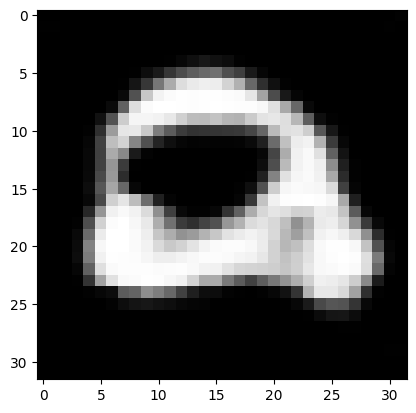

batch 500 gen loss: -7.3682732582092285, discr loss: 55.26203918457031


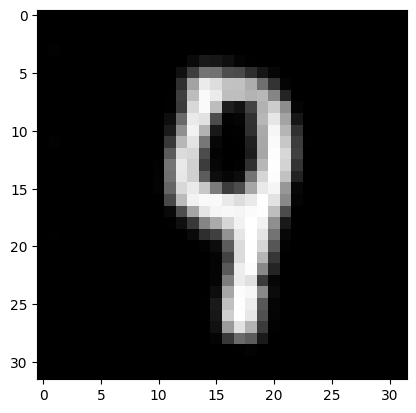

batch 600 gen loss: -7.3682732582092285, discr loss: 55.26203918457031


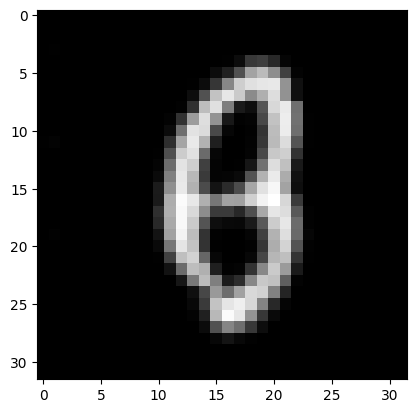

batch 700 gen loss: -11.052410125732422, discr loss: 55.26203918457031


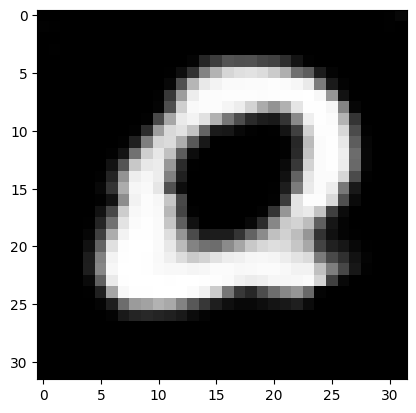

batch 800 gen loss: -11.052410125732422, discr loss: 55.26203918457031


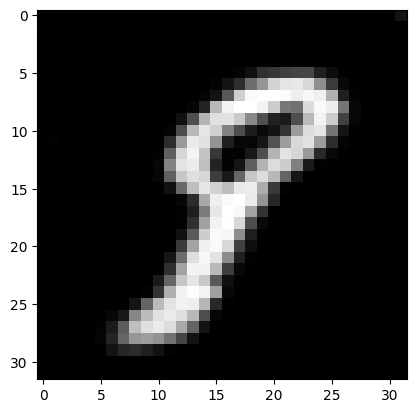

batch 900 gen loss: -7.3682732582092285, discr loss: 55.26203918457031


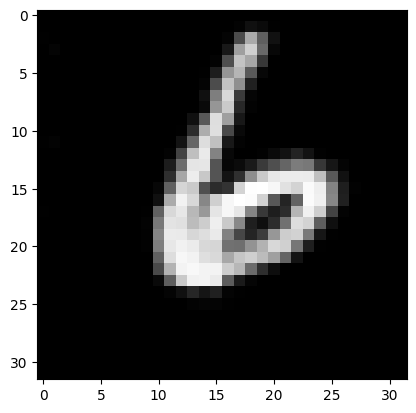

-8827.140625 51780.2890625


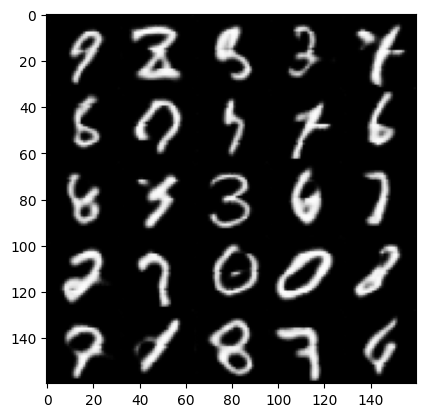

epoch 70:
batch 0 gen loss: -7.3682732582092285, discr loss: 55.26203918457031


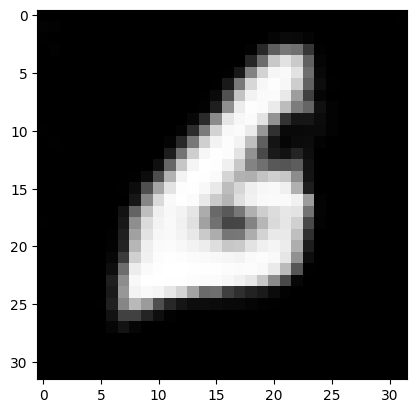

batch 100 gen loss: -11.052410125732422, discr loss: 55.26203918457031


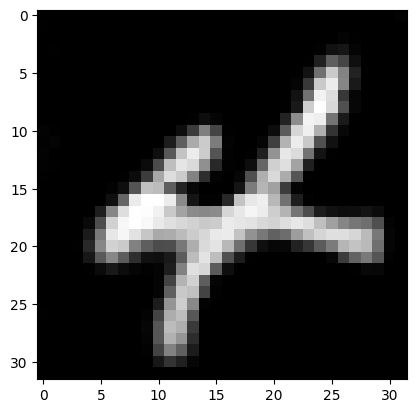

batch 200 gen loss: -3.6841366291046143, discr loss: 55.26203918457031


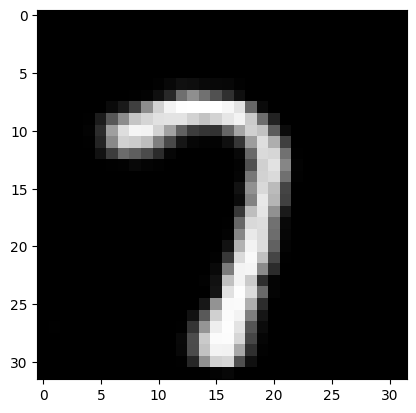

batch 300 gen loss: -7.3682732582092285, discr loss: 55.26203918457031


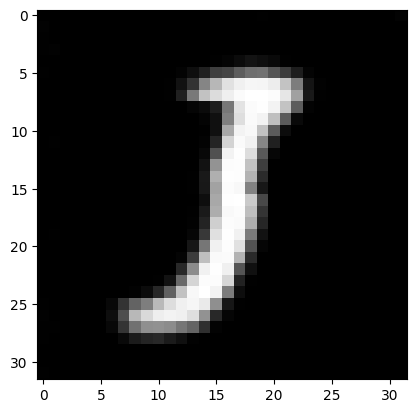

batch 400 gen loss: -7.3682732582092285, discr loss: 55.26203918457031


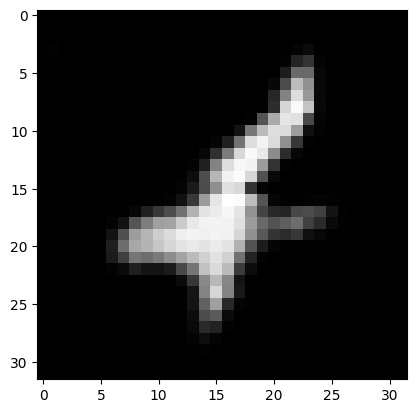

batch 500 gen loss: -11.052410125732422, discr loss: 55.26203918457031


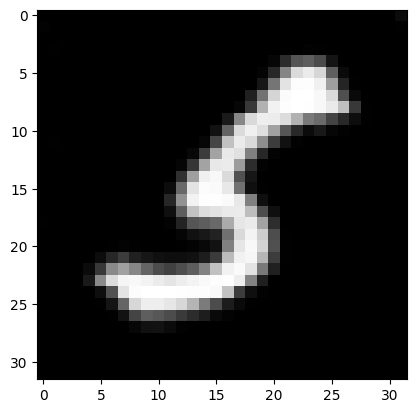

batch 600 gen loss: -11.052410125732422, discr loss: 55.26203918457031


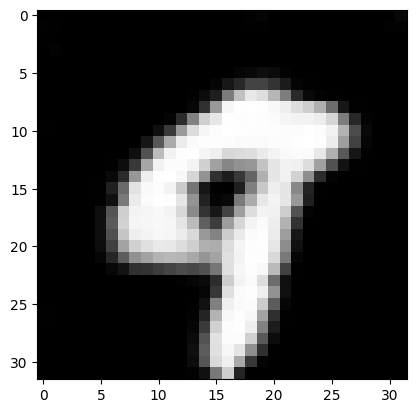

batch 700 gen loss: -3.6841366291046143, discr loss: 55.26203918457031


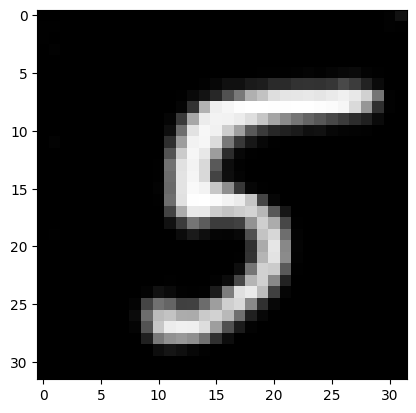

batch 800 gen loss: -7.3682732582092285, discr loss: 55.26203918457031


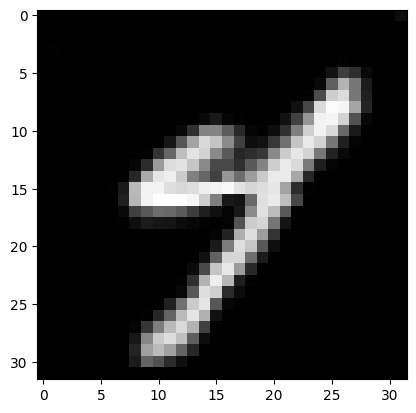

batch 900 gen loss: -14.736546516418457, discr loss: 55.26203918457031


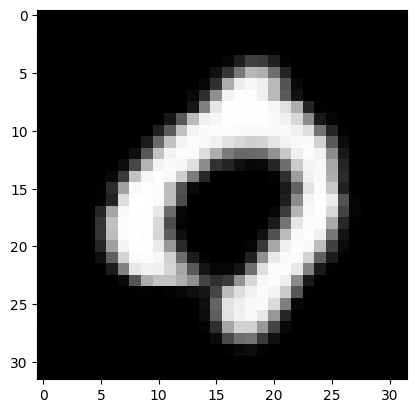

-8764.5078125 51780.2890625


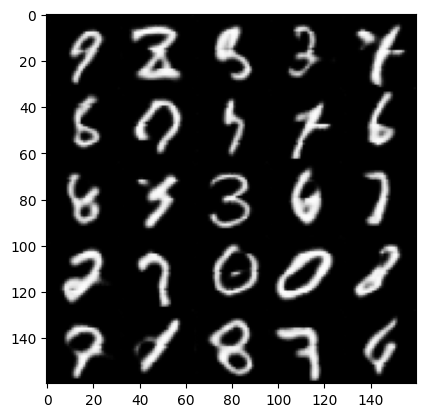

epoch 71:
batch 0 gen loss: -18.420682907104492, discr loss: 55.26203918457031


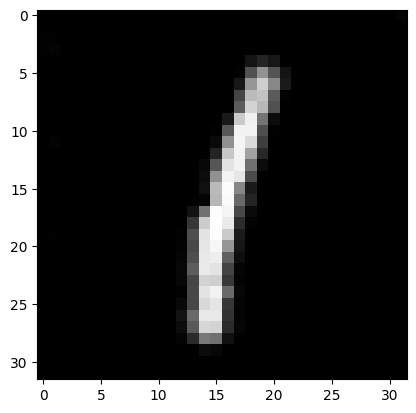

batch 100 gen loss: -11.052410125732422, discr loss: 55.26203918457031


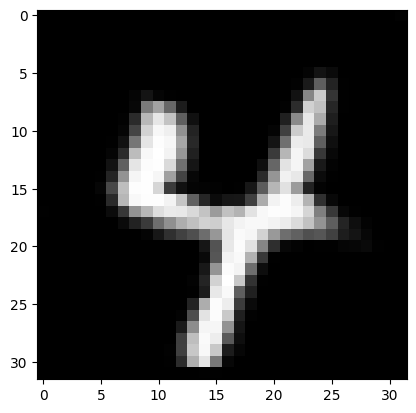

batch 200 gen loss: -11.052410125732422, discr loss: 55.26203918457031


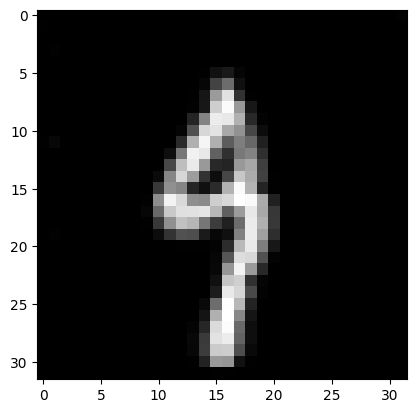

batch 300 gen loss: -7.3682732582092285, discr loss: 55.26203918457031


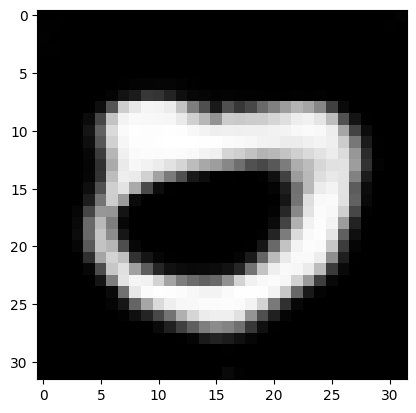

batch 400 gen loss: -3.6841366291046143, discr loss: 55.26203918457031


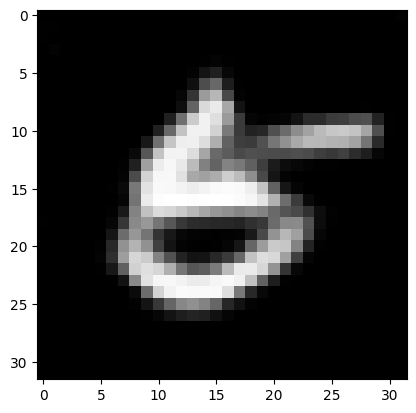

batch 500 gen loss: -3.6841366291046143, discr loss: 55.26203918457031


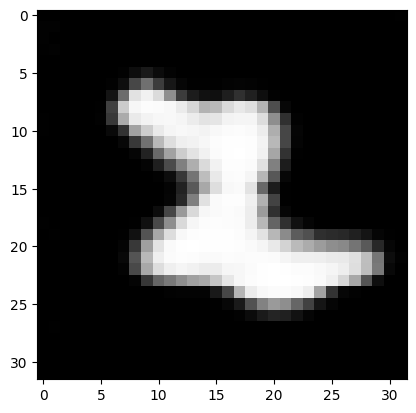

batch 600 gen loss: -3.6841366291046143, discr loss: 55.26203918457031


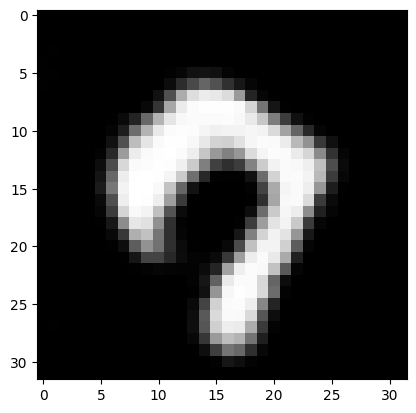

batch 700 gen loss: -7.3682732582092285, discr loss: 55.26203918457031


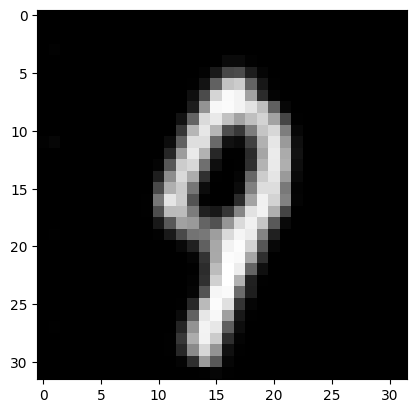

batch 800 gen loss: -14.736546516418457, discr loss: 55.26203918457031


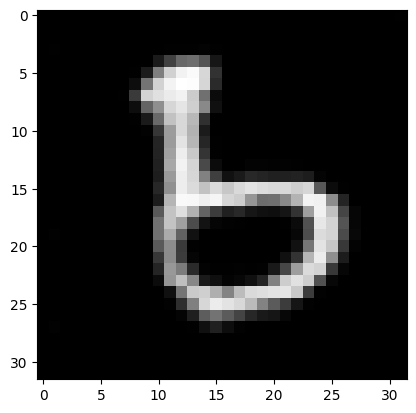

batch 900 gen loss: -7.3682732582092285, discr loss: 55.26203918457031


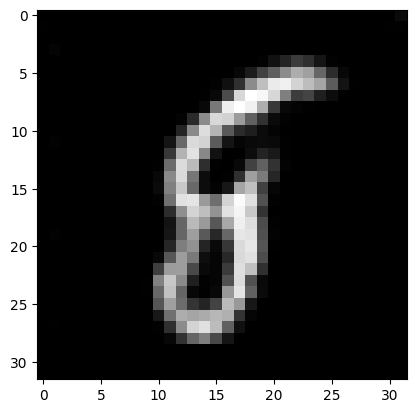

-8838.1923828125 51780.2890625


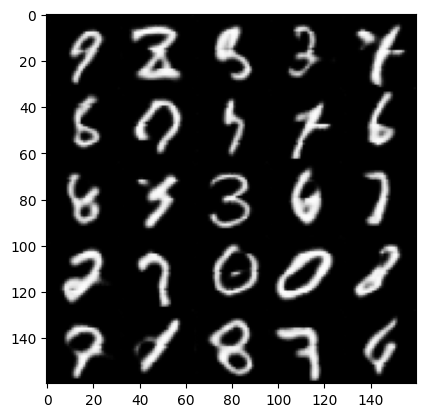

epoch 72:
batch 0 gen loss: -7.3682732582092285, discr loss: 55.26203918457031


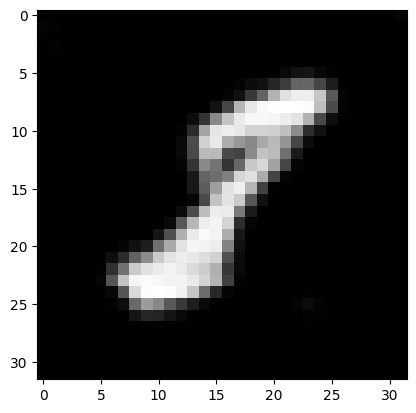

batch 100 gen loss: -7.3682732582092285, discr loss: 55.26203918457031


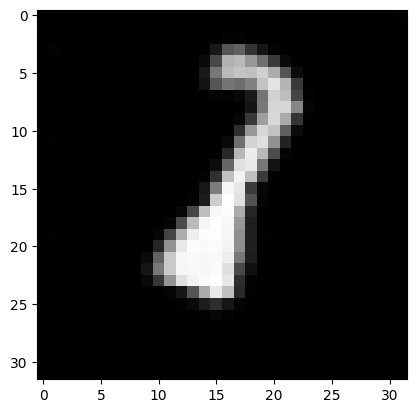

batch 200 gen loss: -7.3682732582092285, discr loss: 55.26203918457031


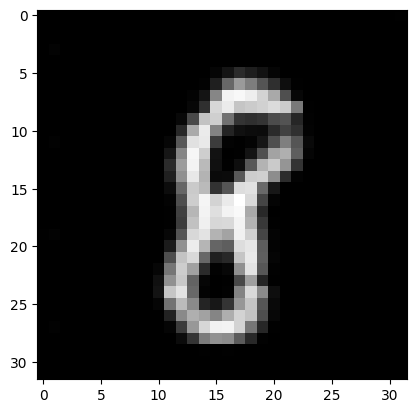

batch 300 gen loss: -7.3682732582092285, discr loss: 55.26203918457031


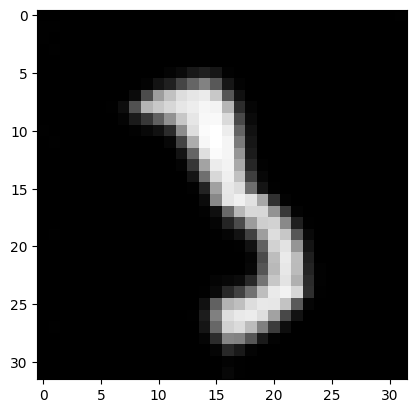

batch 400 gen loss: -3.6841366291046143, discr loss: 55.26203918457031


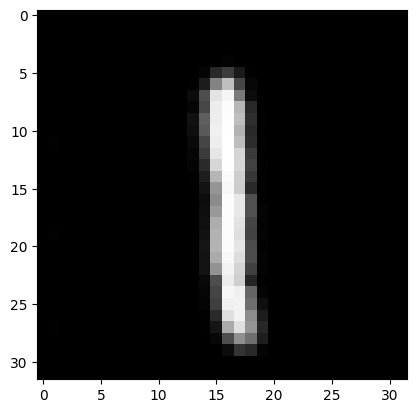

batch 500 gen loss: -7.3682732582092285, discr loss: 55.26203918457031


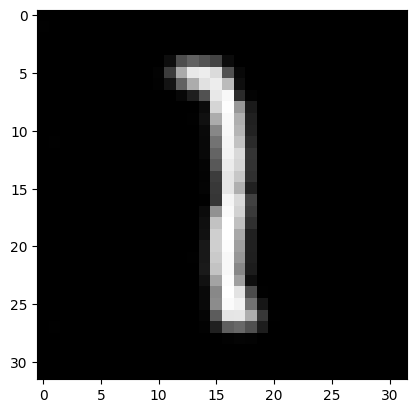

batch 600 gen loss: -11.052410125732422, discr loss: 55.26203918457031


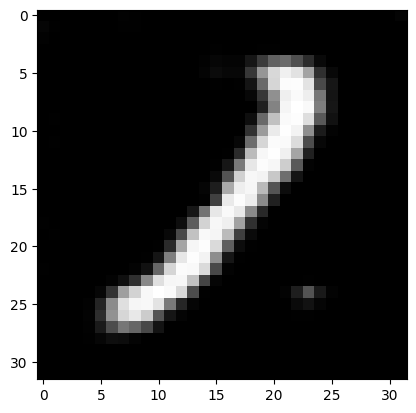

batch 700 gen loss: -3.6841366291046143, discr loss: 55.26203918457031


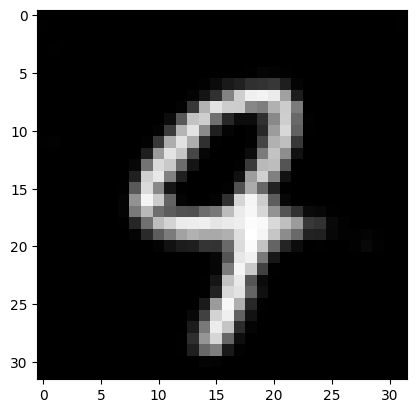

batch 800 gen loss: -7.3682732582092285, discr loss: 55.26203918457031


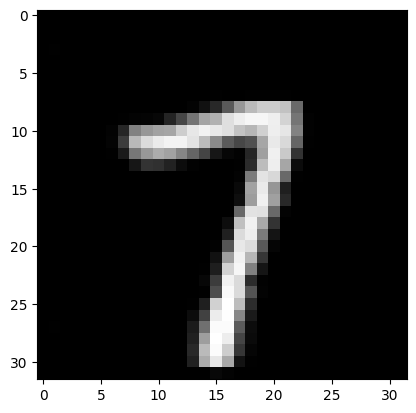

batch 900 gen loss: -3.6841366291046143, discr loss: 55.26203918457031


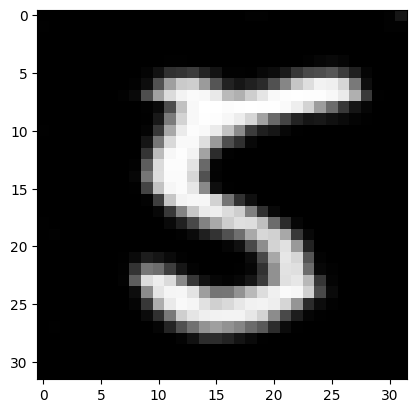

-8764.51171875 51780.2890625


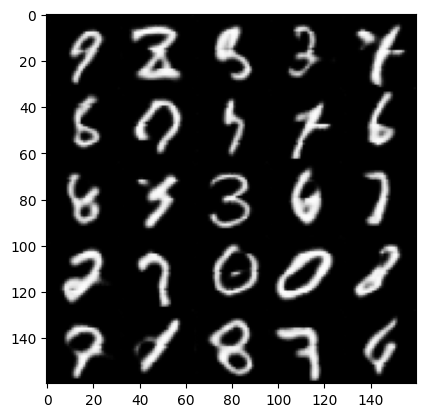

epoch 73:
batch 0 gen loss: -7.3682732582092285, discr loss: 55.26203918457031


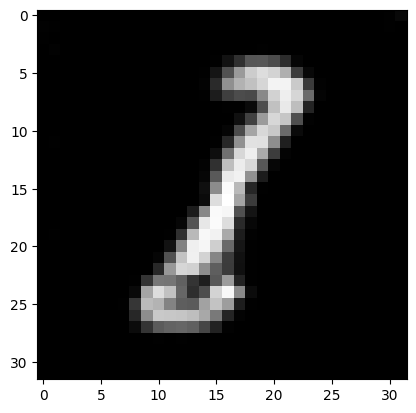

batch 100 gen loss: -14.736546516418457, discr loss: 55.26203918457031


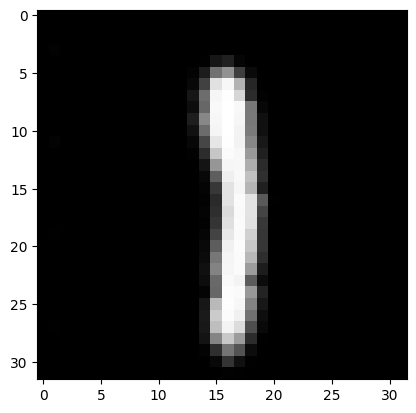

batch 200 gen loss: -3.6841366291046143, discr loss: 55.26203918457031


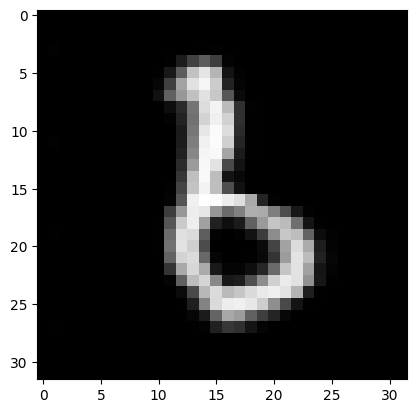

batch 300 gen loss: -3.6841366291046143, discr loss: 55.26203918457031


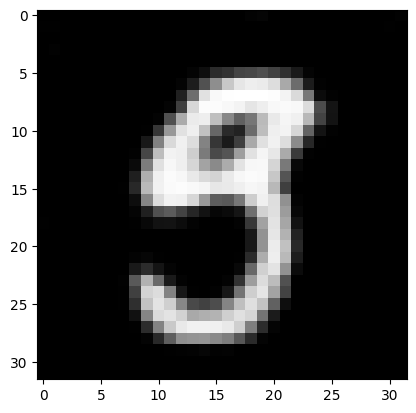

batch 400 gen loss: -11.052410125732422, discr loss: 55.26203918457031


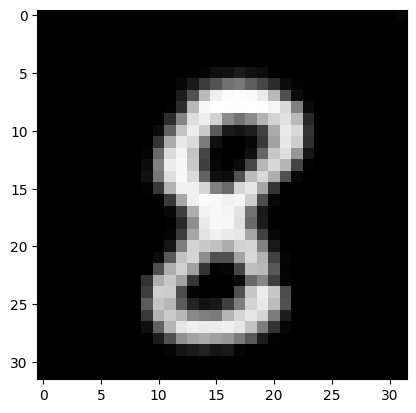

batch 500 gen loss: -14.736546516418457, discr loss: 55.26203918457031


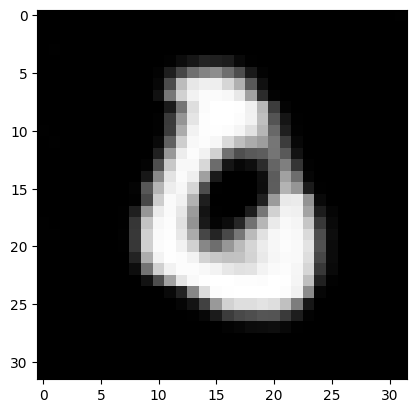

batch 600 gen loss: -3.6841366291046143, discr loss: 55.26203918457031


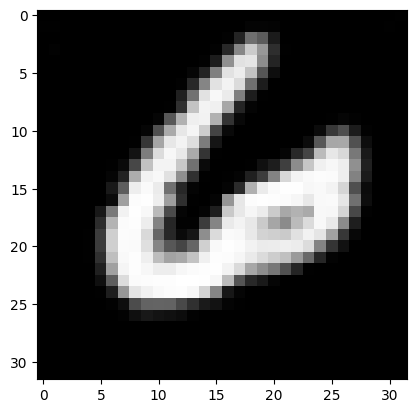

batch 700 gen loss: -11.052410125732422, discr loss: 55.26203918457031


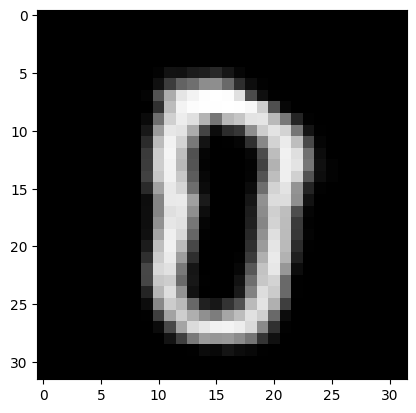

batch 800 gen loss: -11.052410125732422, discr loss: 55.26203918457031


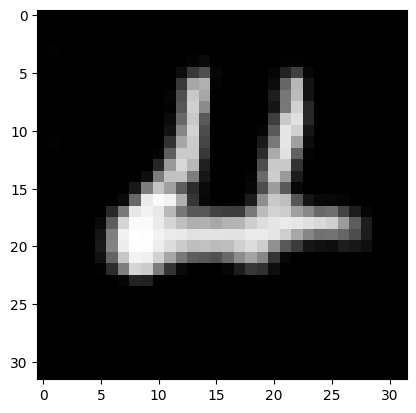

batch 900 gen loss: -18.420682907104492, discr loss: 55.26203918457031


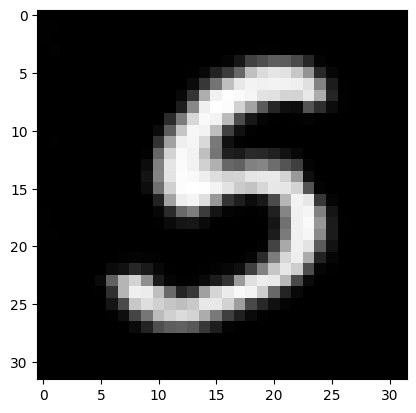

-8687.1376953125 51780.2890625


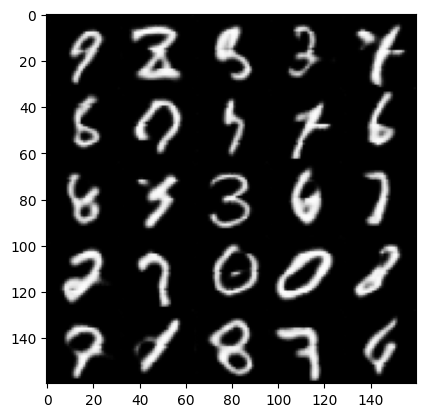

epoch 74:
batch 0 gen loss: -11.052410125732422, discr loss: 55.26203918457031


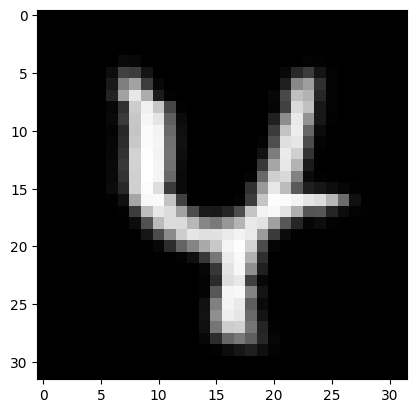

batch 100 gen loss: -3.6841366291046143, discr loss: 55.26203918457031


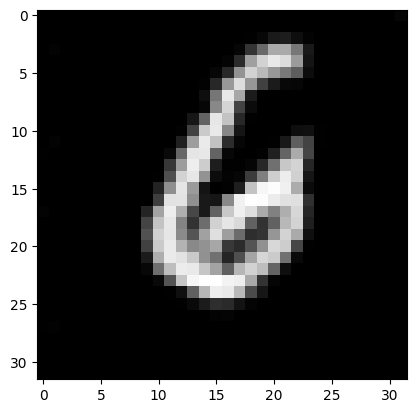

batch 200 gen loss: -3.6841366291046143, discr loss: 55.26203918457031


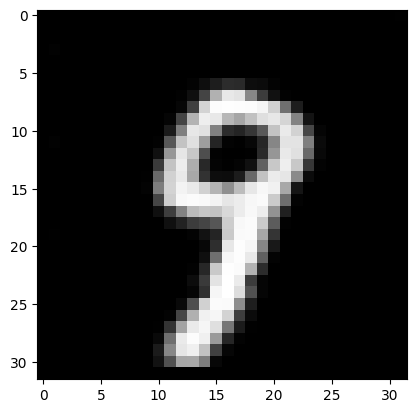

batch 300 gen loss: -3.6841366291046143, discr loss: 55.26203918457031


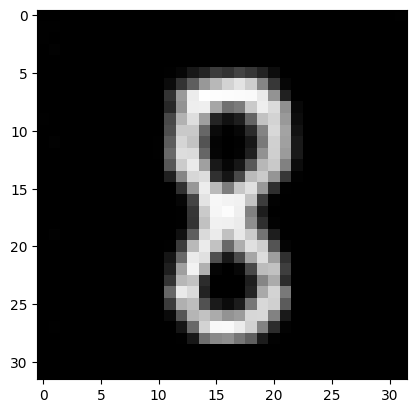

batch 400 gen loss: -7.3682732582092285, discr loss: 55.26203918457031


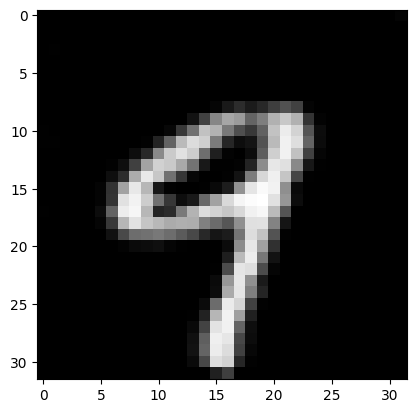

batch 500 gen loss: -3.6841366291046143, discr loss: 55.26203918457031


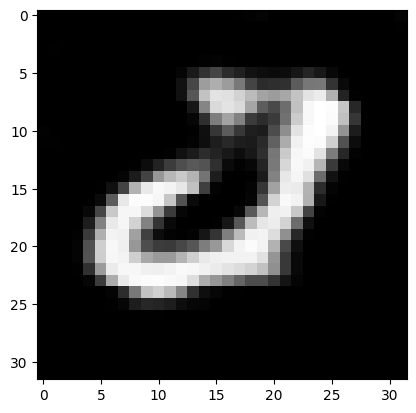

batch 600 gen loss: -3.6841366291046143, discr loss: 55.26203918457031


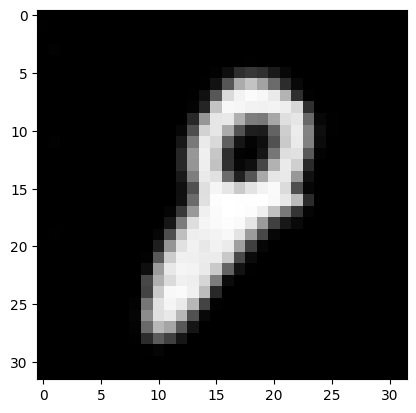

batch 700 gen loss: -11.052410125732422, discr loss: 55.26203918457031


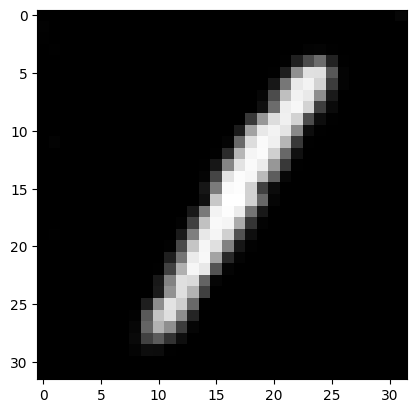

batch 800 gen loss: -14.736546516418457, discr loss: 55.26203918457031


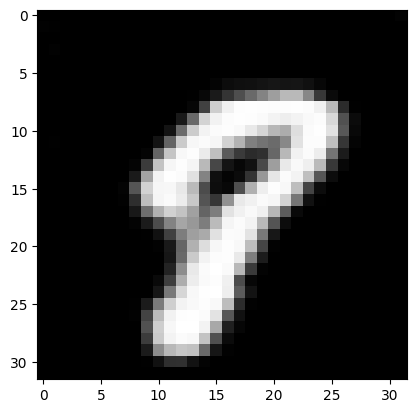

batch 900 gen loss: -11.052410125732422, discr loss: 55.26203918457031


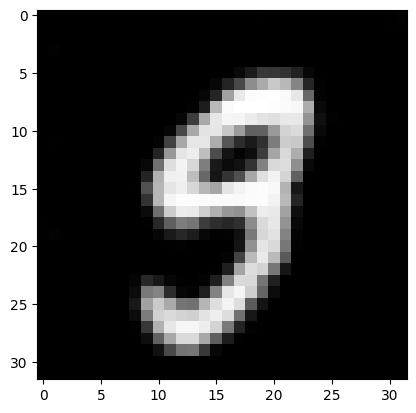

-8797.669921875 51780.2890625


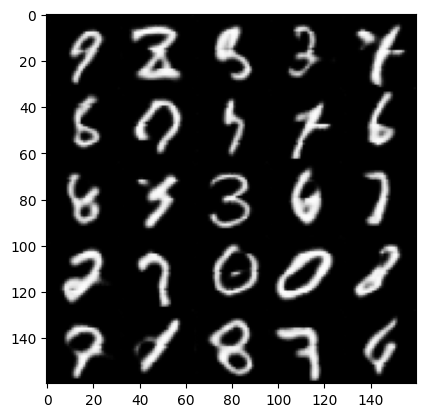

epoch 75:
batch 0 gen loss: -18.420682907104492, discr loss: 55.26203918457031


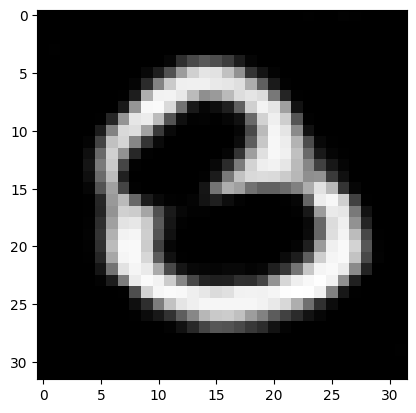

batch 100 gen loss: -7.3682732582092285, discr loss: 55.26203918457031


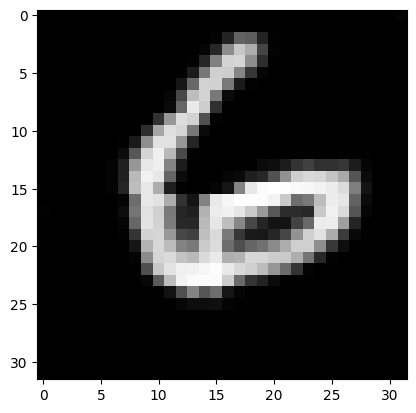

batch 200 gen loss: 0.0, discr loss: 55.26203918457031


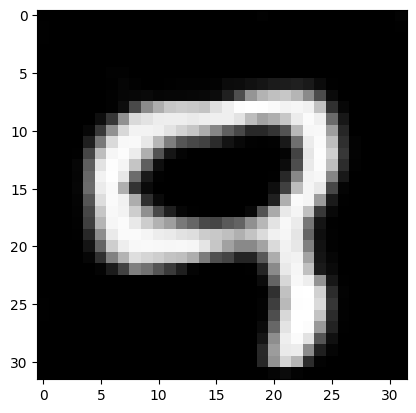

batch 300 gen loss: -18.420682907104492, discr loss: 55.26203918457031


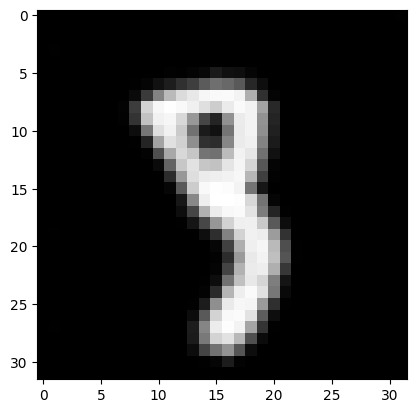

batch 400 gen loss: -11.052410125732422, discr loss: 55.26203918457031


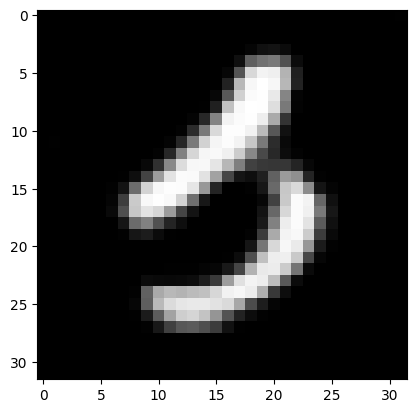

batch 500 gen loss: -18.420682907104492, discr loss: 55.26203918457031


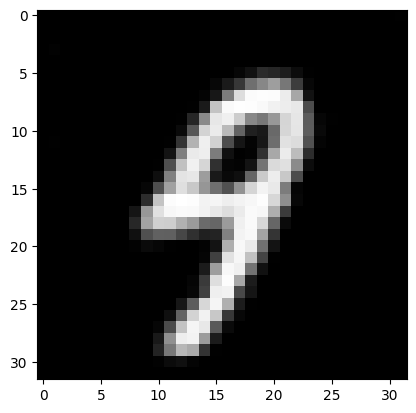

batch 600 gen loss: -11.052410125732422, discr loss: 55.26203918457031


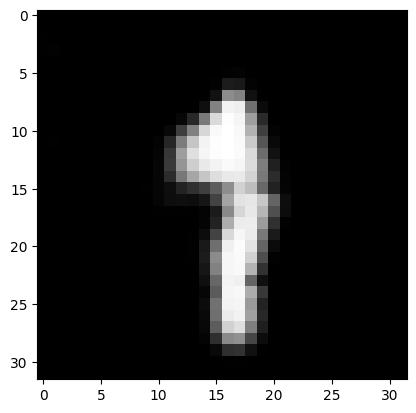

batch 700 gen loss: -7.3682732582092285, discr loss: 55.26203918457031


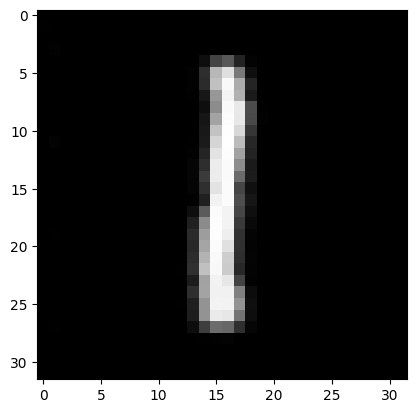

batch 800 gen loss: -18.420682907104492, discr loss: 55.26203918457031


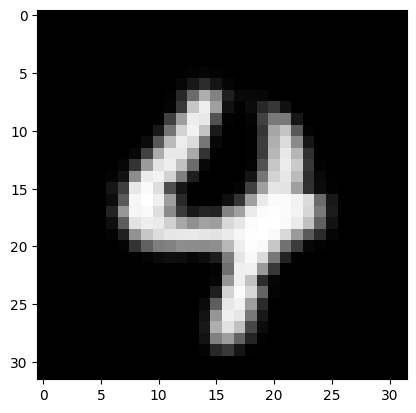

batch 900 gen loss: -7.3682732582092285, discr loss: 55.26203918457031


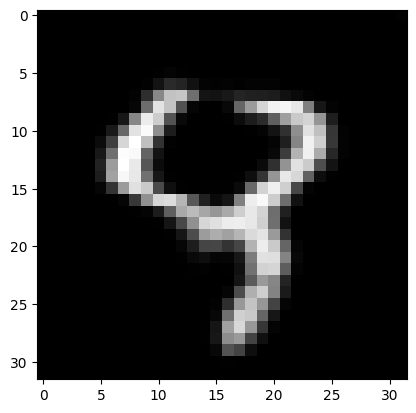

-8698.1982421875 51780.2890625


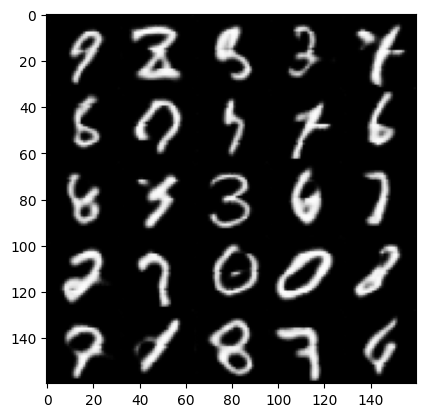

epoch 76:
batch 0 gen loss: -3.6841366291046143, discr loss: 55.26203918457031


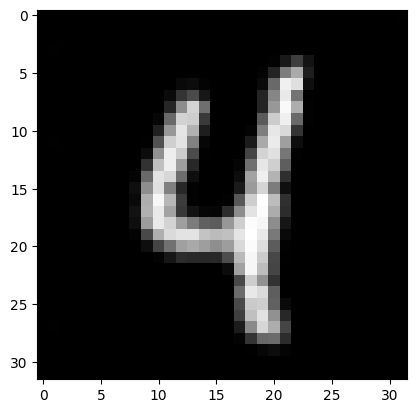

batch 100 gen loss: -3.6841366291046143, discr loss: 55.26203918457031


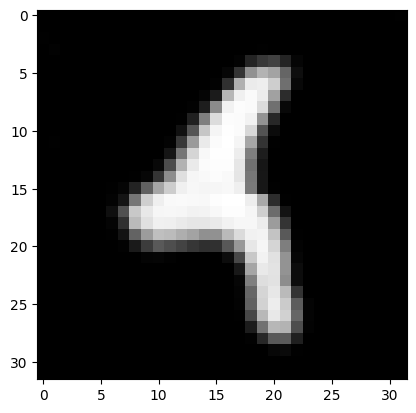

batch 200 gen loss: -7.3682732582092285, discr loss: 55.26203918457031


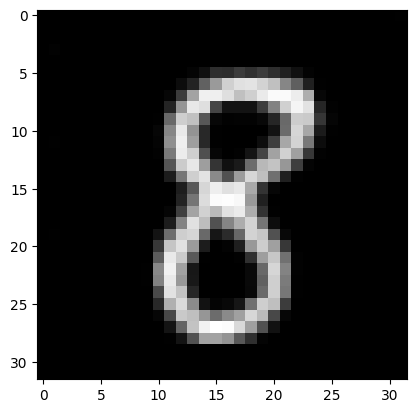

batch 300 gen loss: -14.736546516418457, discr loss: 55.26203918457031


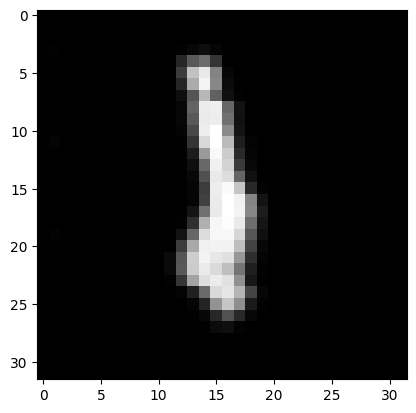

batch 400 gen loss: -11.052410125732422, discr loss: 55.26203918457031


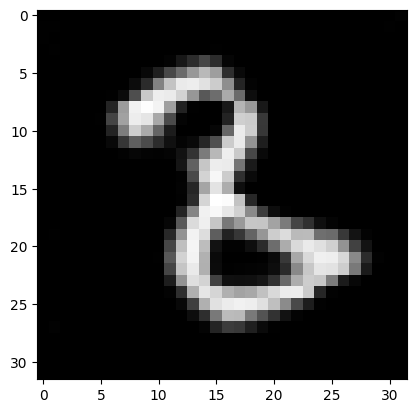

batch 500 gen loss: -7.3682732582092285, discr loss: 55.26203918457031


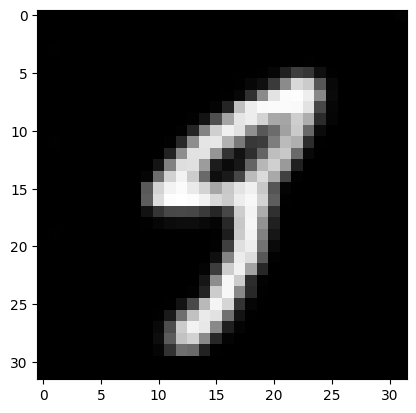

batch 600 gen loss: -11.052410125732422, discr loss: 55.26203918457031


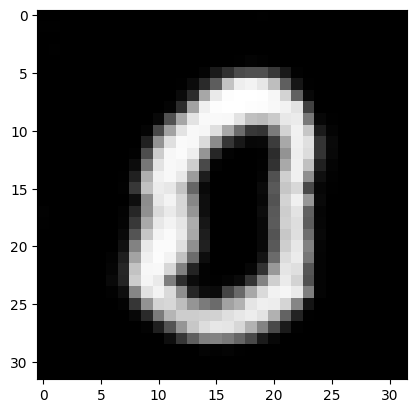

batch 700 gen loss: -7.3682732582092285, discr loss: 55.26203918457031


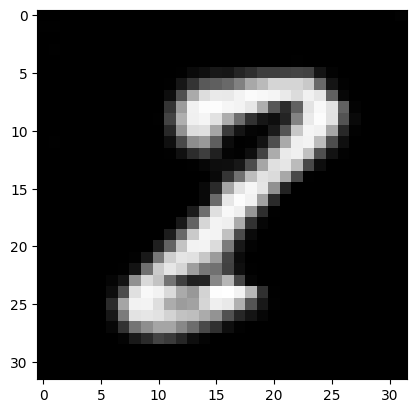

batch 800 gen loss: -11.052410125732422, discr loss: 55.26203918457031


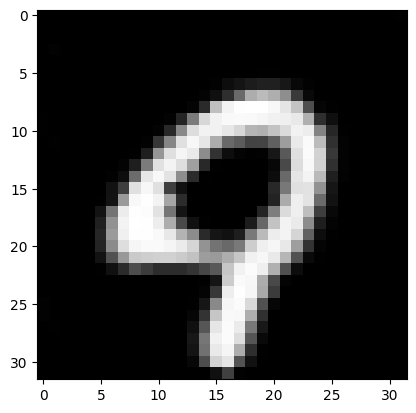

batch 900 gen loss: -11.052410125732422, discr loss: 55.26203918457031


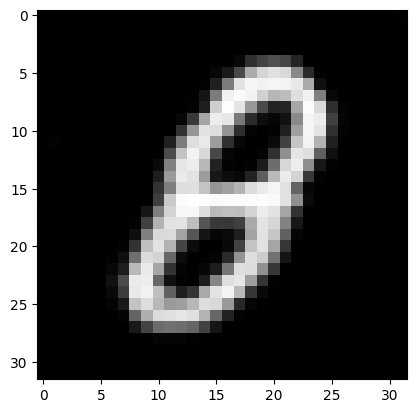

-8624.5146484375 51780.2890625


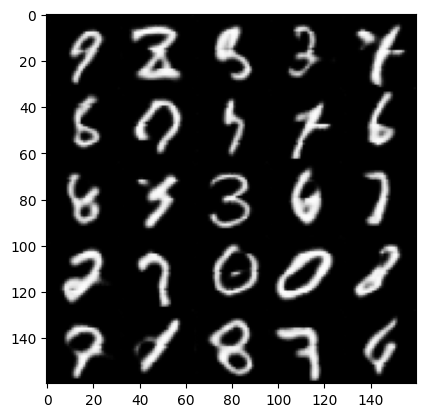

epoch 77:
batch 0 gen loss: -11.052410125732422, discr loss: 55.26203918457031


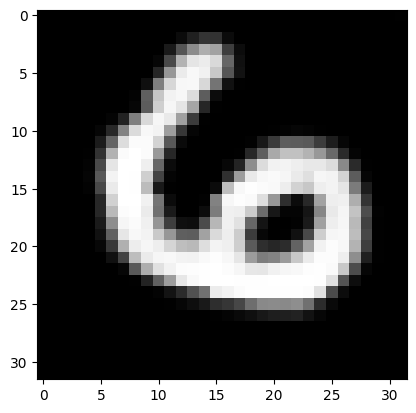

batch 100 gen loss: -11.052410125732422, discr loss: 55.26203918457031


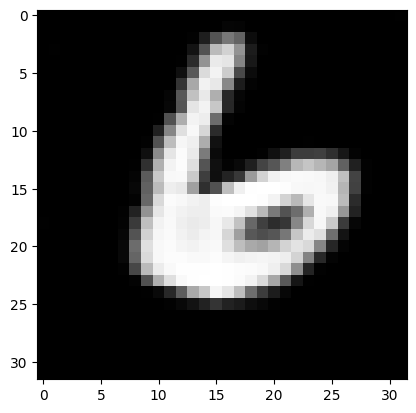

batch 200 gen loss: -7.3682732582092285, discr loss: 55.26203918457031


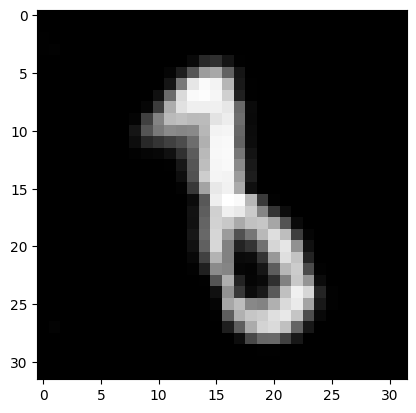

batch 300 gen loss: -7.3682732582092285, discr loss: 55.26203918457031


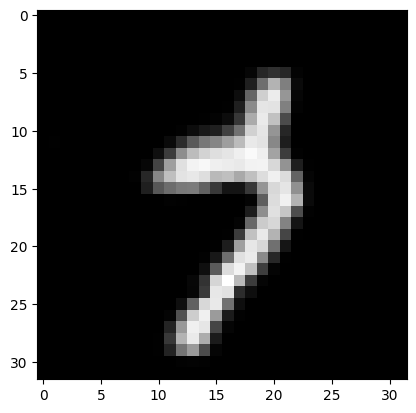

batch 400 gen loss: -7.3682732582092285, discr loss: 55.26203918457031


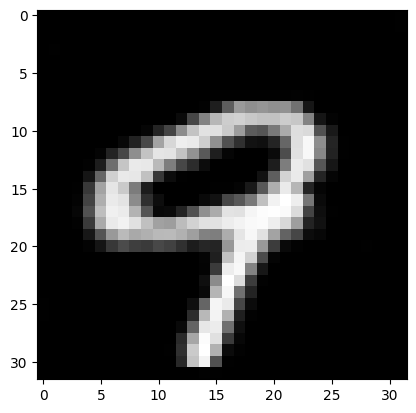

batch 500 gen loss: -3.6841366291046143, discr loss: 55.26203918457031


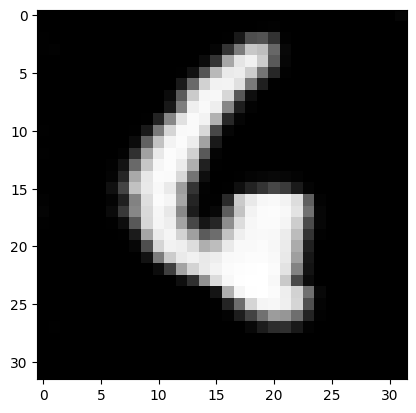

batch 600 gen loss: -11.052410125732422, discr loss: 55.26203918457031


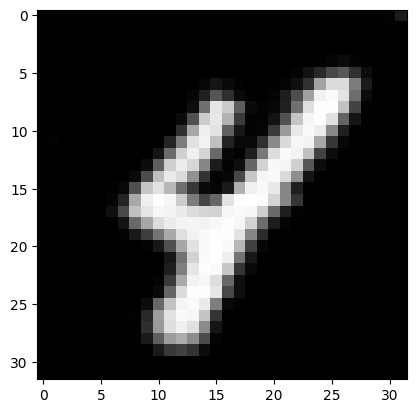

batch 700 gen loss: -3.6841366291046143, discr loss: 55.26203918457031


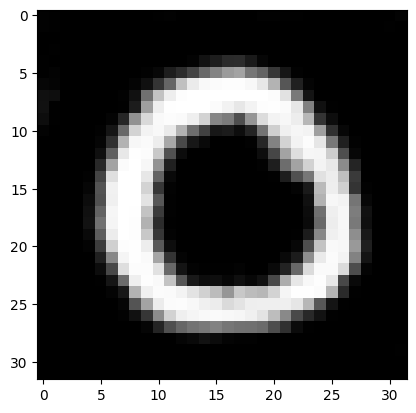

batch 800 gen loss: -7.3682732582092285, discr loss: 55.26203918457031


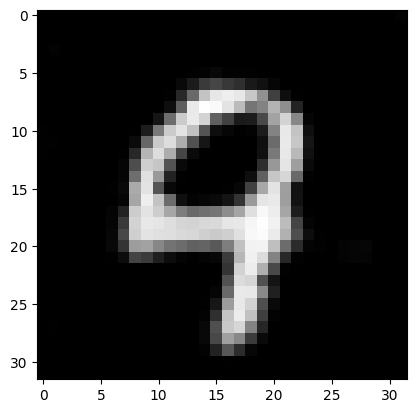

batch 900 gen loss: -11.052410125732422, discr loss: 55.26203918457031


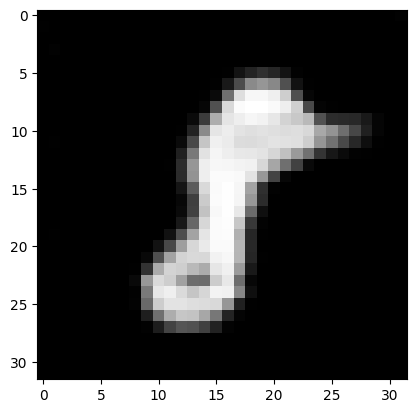

-8738.7216796875 51780.2890625


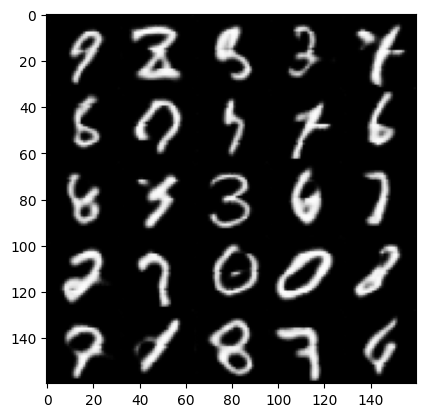

epoch 78:
batch 0 gen loss: -7.3682732582092285, discr loss: 55.26203918457031


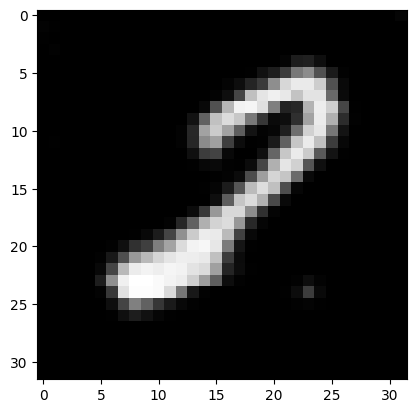

batch 100 gen loss: -11.052410125732422, discr loss: 55.26203918457031


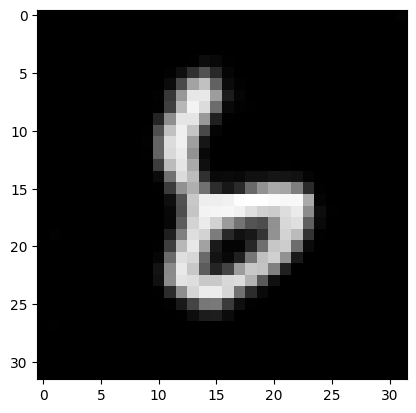

batch 200 gen loss: -14.736546516418457, discr loss: 55.26203918457031


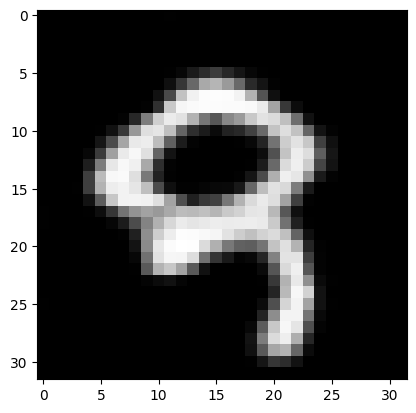

batch 300 gen loss: -7.3682732582092285, discr loss: 55.26203918457031


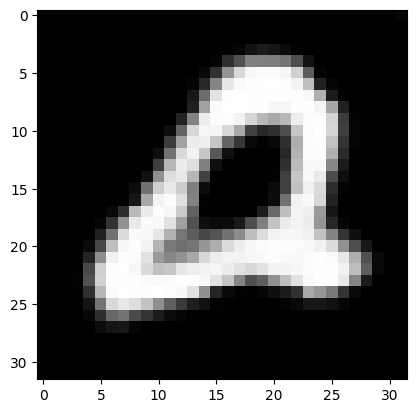

batch 400 gen loss: -3.6841366291046143, discr loss: 55.26203918457031


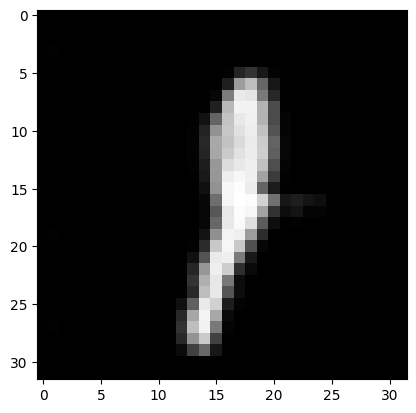

batch 500 gen loss: -14.736546516418457, discr loss: 55.26203918457031


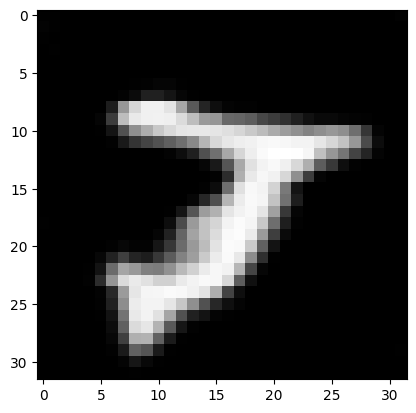

batch 600 gen loss: -11.052410125732422, discr loss: 55.26203918457031


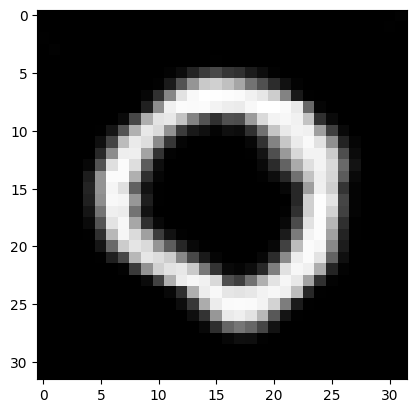

batch 700 gen loss: -7.3682732582092285, discr loss: 55.26203918457031


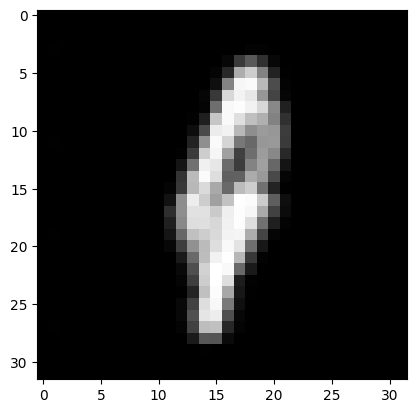

batch 800 gen loss: -3.6841366291046143, discr loss: 55.26203918457031


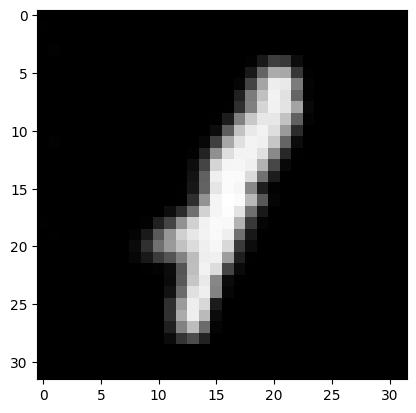

batch 900 gen loss: -14.736546516418457, discr loss: 55.26203918457031


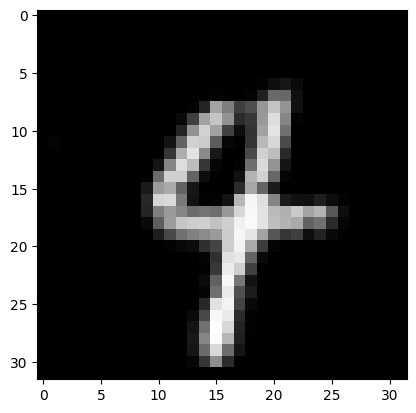

-8583.9814453125 51780.2890625


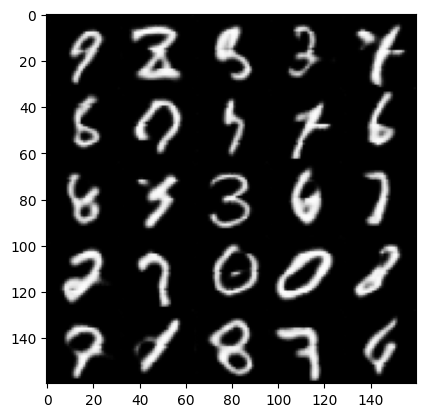

epoch 79:
batch 0 gen loss: -14.736546516418457, discr loss: 55.26203918457031


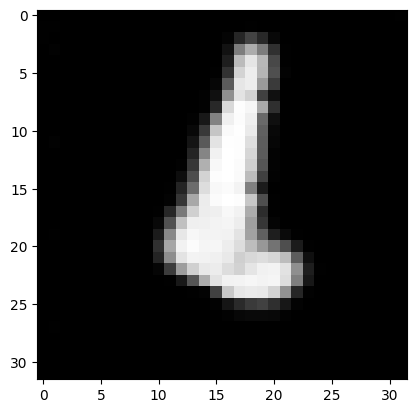

batch 100 gen loss: -14.736546516418457, discr loss: 55.26203918457031


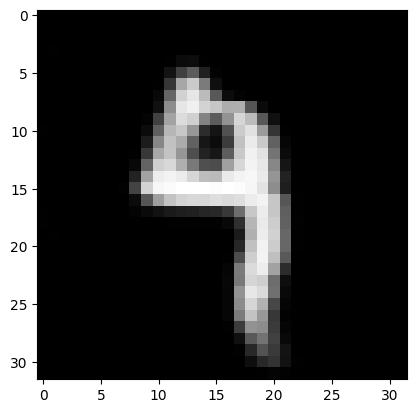

batch 200 gen loss: -7.3682732582092285, discr loss: 55.26203918457031


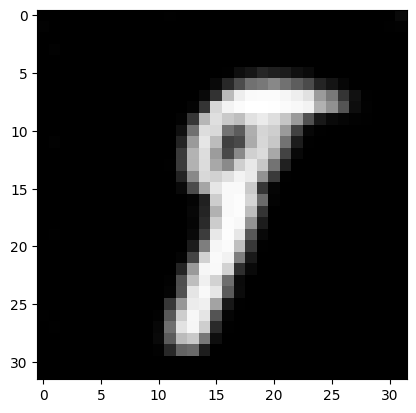

batch 300 gen loss: -11.052410125732422, discr loss: 55.26203918457031


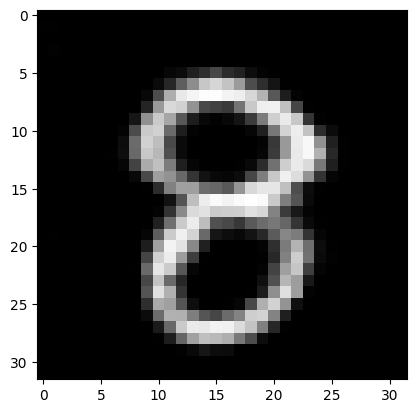

batch 400 gen loss: -11.052410125732422, discr loss: 55.26203918457031


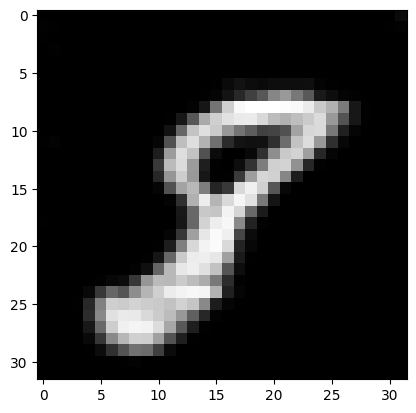

batch 500 gen loss: -14.736546516418457, discr loss: 55.26203918457031


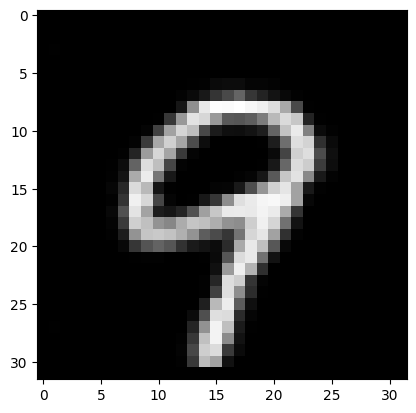

batch 600 gen loss: -3.6841366291046143, discr loss: 55.26203918457031


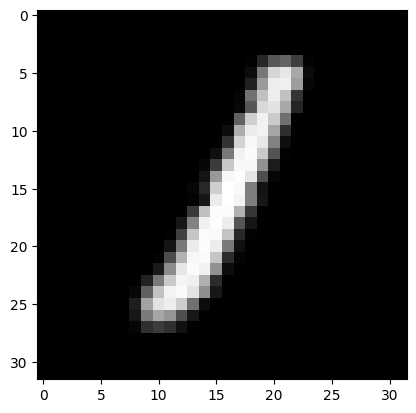

batch 700 gen loss: -11.052410125732422, discr loss: 55.26203918457031


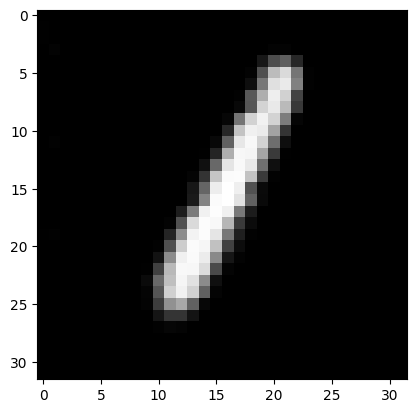

batch 800 gen loss: -3.6841366291046143, discr loss: 55.26203918457031


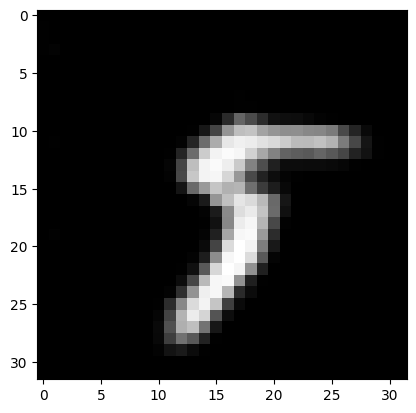

batch 900 gen loss: -7.3682732582092285, discr loss: 55.26203918457031


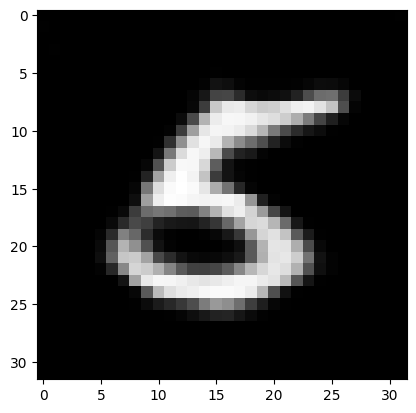

-8650.298828125 51780.2890625


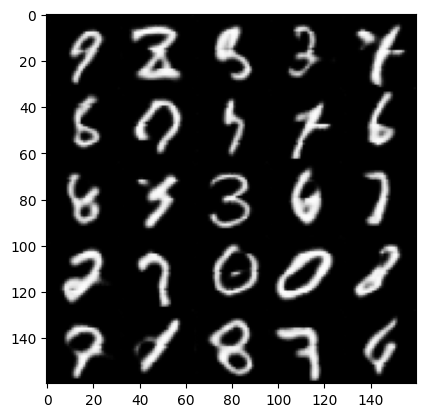

epoch 80:
batch 0 gen loss: -14.736546516418457, discr loss: 55.26203918457031


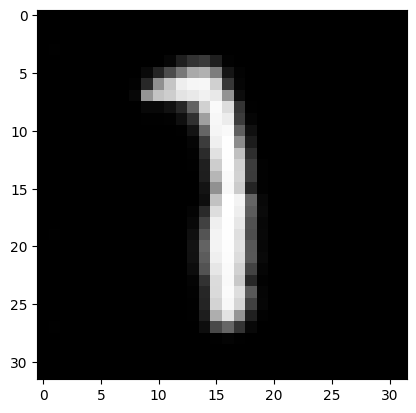

batch 100 gen loss: -7.3682732582092285, discr loss: 55.26203918457031


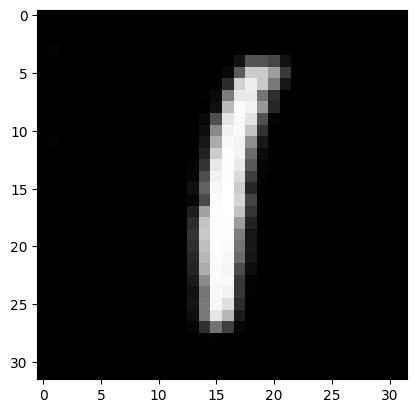

batch 200 gen loss: -3.6841366291046143, discr loss: 55.26203918457031


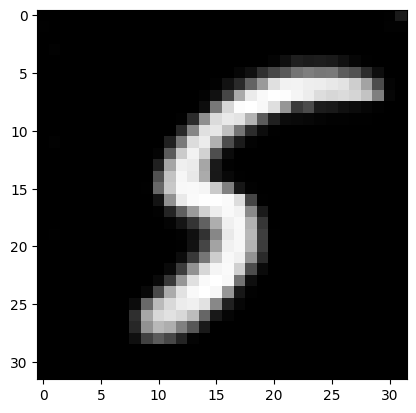

batch 300 gen loss: -11.052410125732422, discr loss: 55.26203918457031


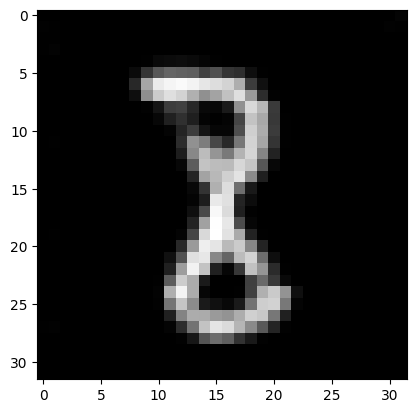

batch 400 gen loss: -7.3682732582092285, discr loss: 55.26203918457031


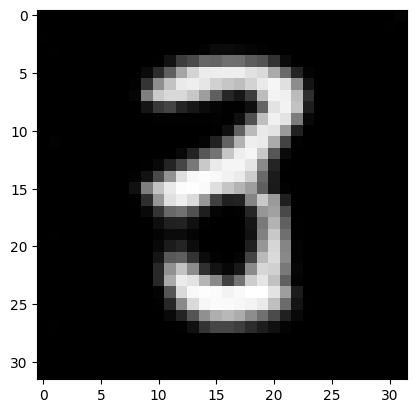

batch 500 gen loss: -11.052410125732422, discr loss: 55.26203918457031


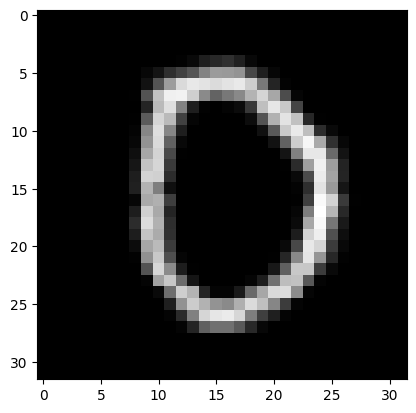

batch 600 gen loss: -11.052410125732422, discr loss: 55.26203918457031


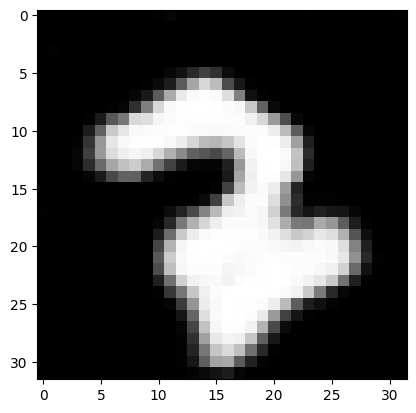

batch 700 gen loss: -14.736546516418457, discr loss: 55.26203918457031


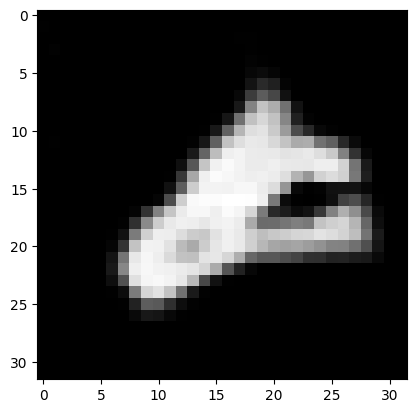

batch 800 gen loss: -3.6841366291046143, discr loss: 55.26203918457031


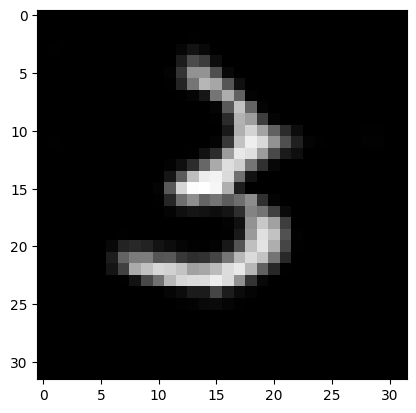

batch 900 gen loss: -14.736546516418457, discr loss: 55.26203918457031


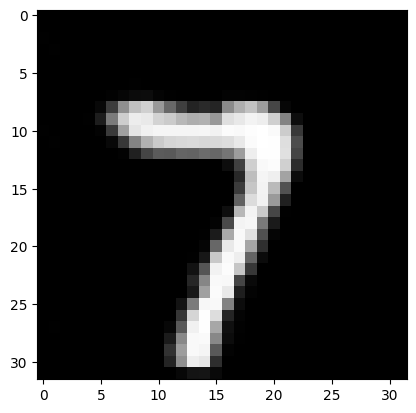

-8790.298828125 51780.2890625


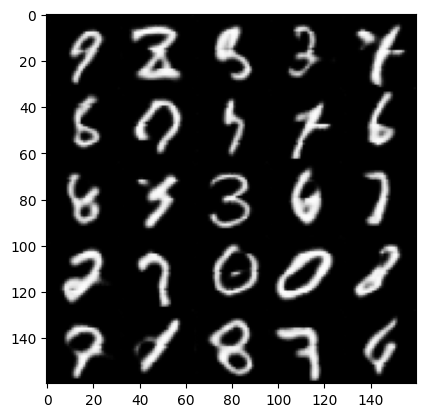

epoch 81:
batch 0 gen loss: -7.3682732582092285, discr loss: 55.26203918457031


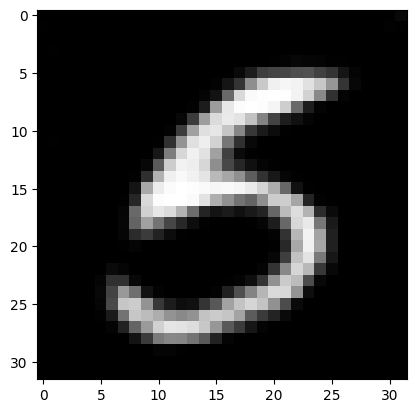

batch 100 gen loss: -3.6841366291046143, discr loss: 55.26203918457031


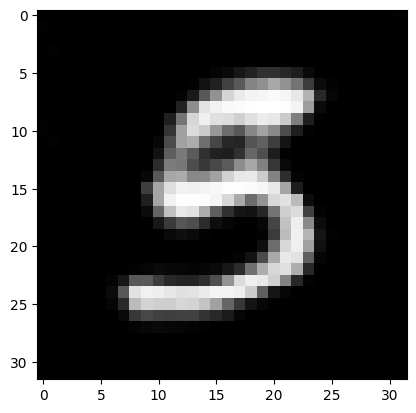

batch 200 gen loss: -14.736546516418457, discr loss: 55.26203918457031


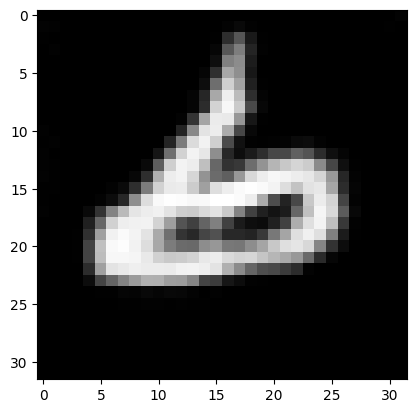

batch 300 gen loss: -11.052410125732422, discr loss: 55.26203918457031


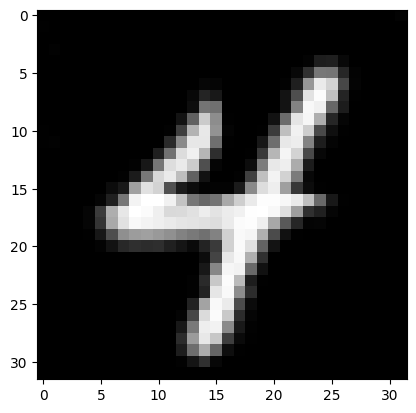

batch 400 gen loss: -3.6841366291046143, discr loss: 55.26203918457031


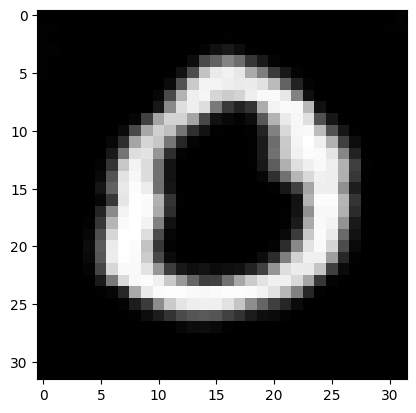

batch 500 gen loss: -7.3682732582092285, discr loss: 55.26203918457031


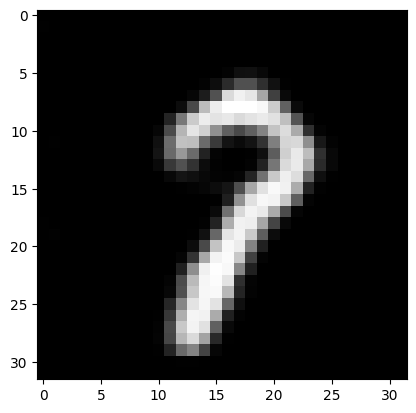

batch 600 gen loss: -7.3682732582092285, discr loss: 55.26203918457031


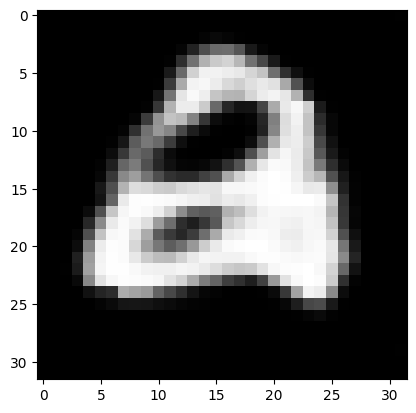

batch 700 gen loss: -3.6841366291046143, discr loss: 55.26203918457031


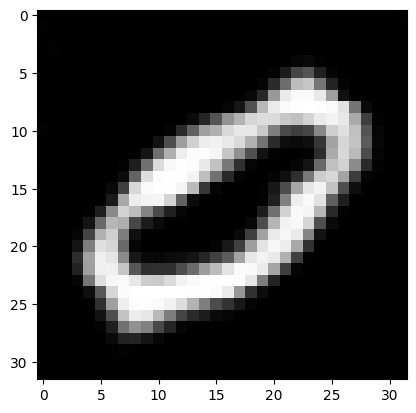

batch 800 gen loss: -3.6841366291046143, discr loss: 55.26203918457031


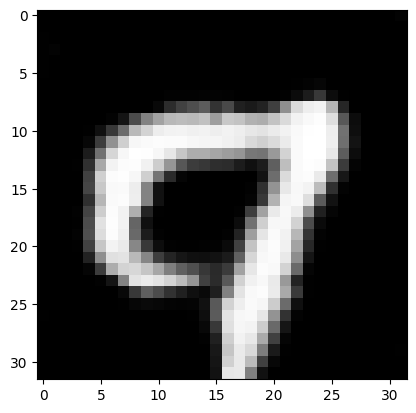

batch 900 gen loss: -11.052410125732422, discr loss: 55.26203918457031


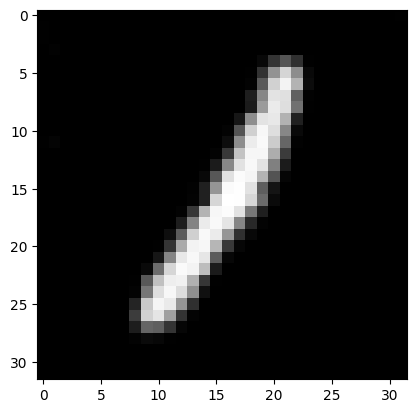

-8595.0380859375 51780.2890625


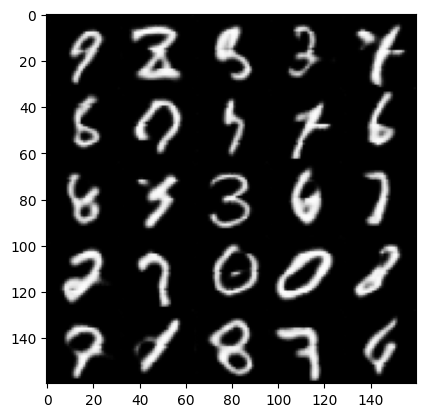

epoch 82:
batch 0 gen loss: -7.3682732582092285, discr loss: 55.26203918457031


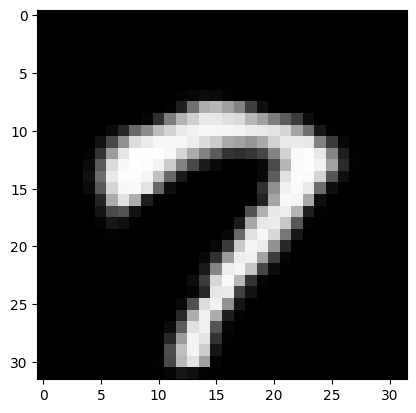

batch 100 gen loss: -11.052410125732422, discr loss: 55.26203918457031


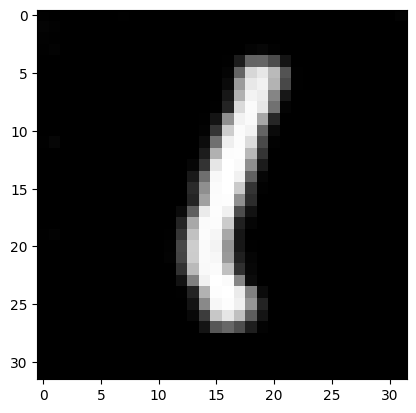

batch 200 gen loss: -7.3682732582092285, discr loss: 55.26203918457031


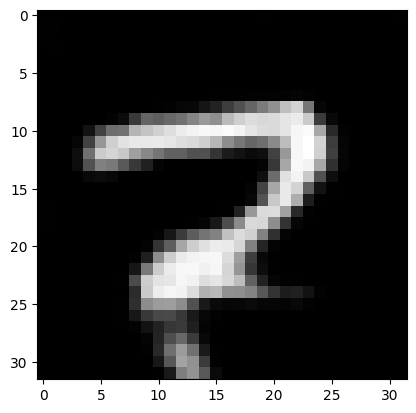

batch 300 gen loss: -3.6841366291046143, discr loss: 55.26203918457031


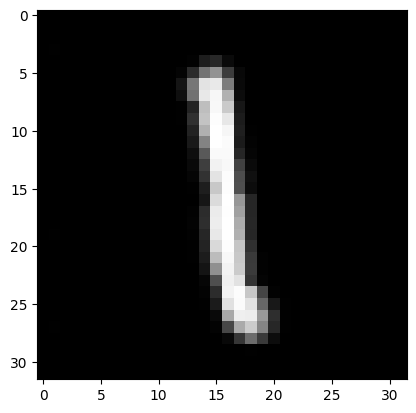

batch 400 gen loss: -7.3682732582092285, discr loss: 55.26203918457031


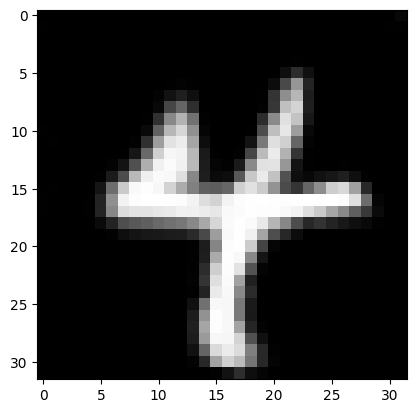

batch 500 gen loss: -7.3682732582092285, discr loss: 55.26203918457031


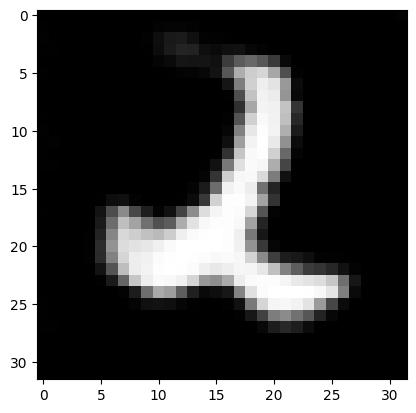

batch 600 gen loss: -3.6841366291046143, discr loss: 55.26203918457031


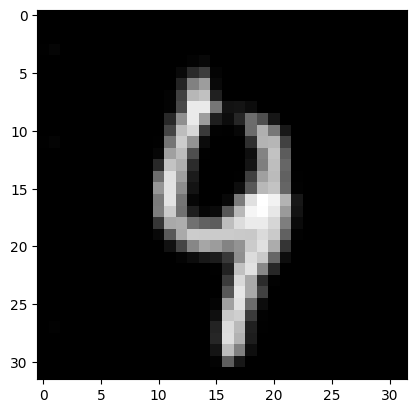

batch 700 gen loss: -14.736546516418457, discr loss: 55.26203918457031


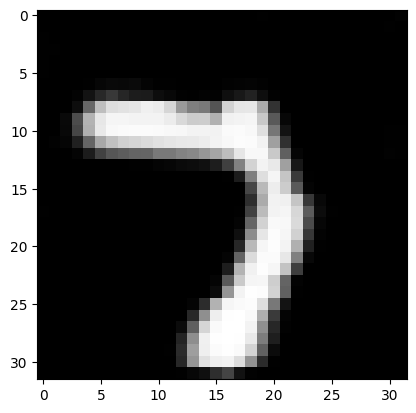

batch 800 gen loss: -7.3682732582092285, discr loss: 55.26203918457031


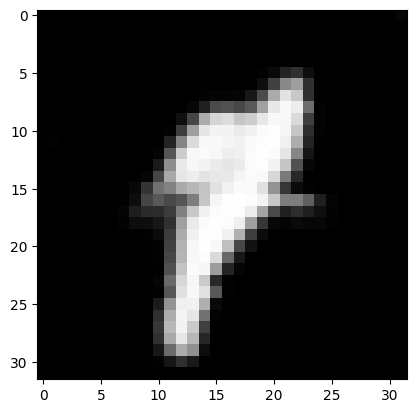

batch 900 gen loss: -14.736546516418457, discr loss: 55.26203918457031


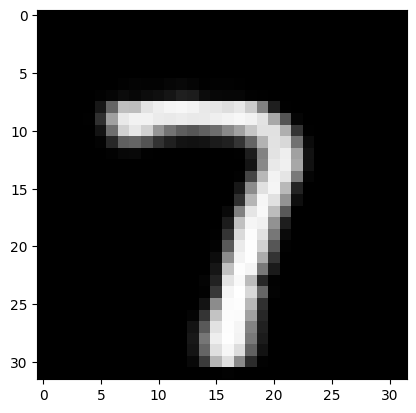

-8642.9287109375 51780.2890625


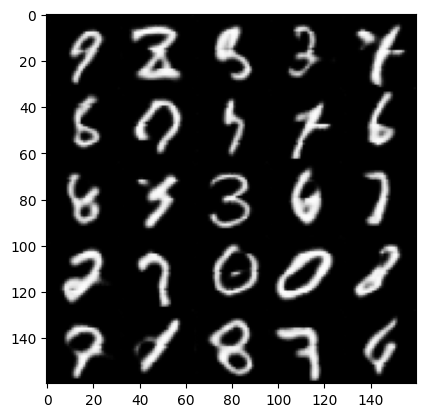

epoch 83:
batch 0 gen loss: -14.736546516418457, discr loss: 55.26203918457031


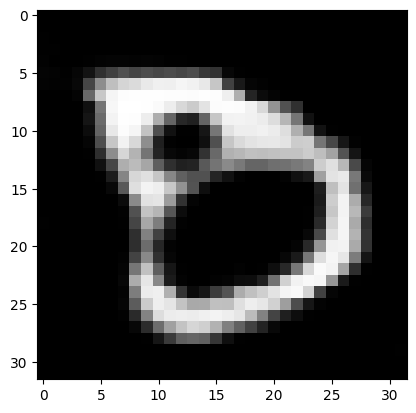

batch 100 gen loss: -7.3682732582092285, discr loss: 55.26203918457031


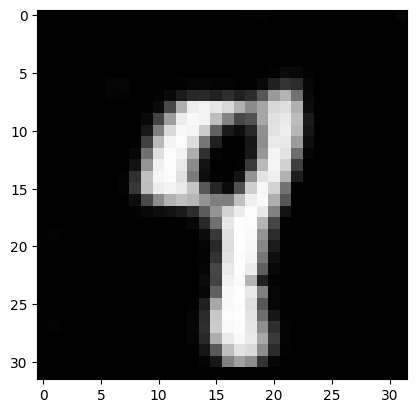

batch 200 gen loss: -18.420682907104492, discr loss: 55.26203918457031


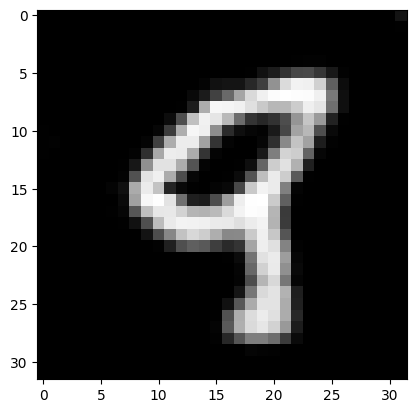

batch 300 gen loss: -7.3682732582092285, discr loss: 55.26203918457031


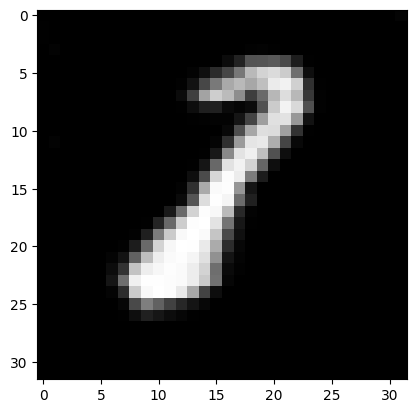

batch 400 gen loss: -11.052410125732422, discr loss: 55.26203918457031


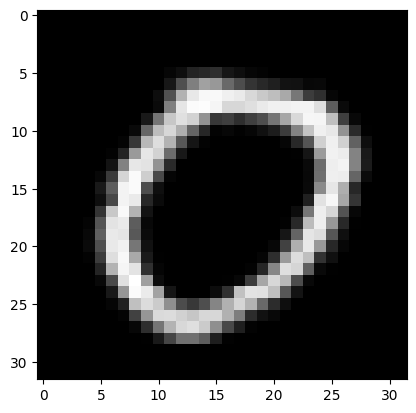

batch 500 gen loss: -3.6841366291046143, discr loss: 55.26203918457031


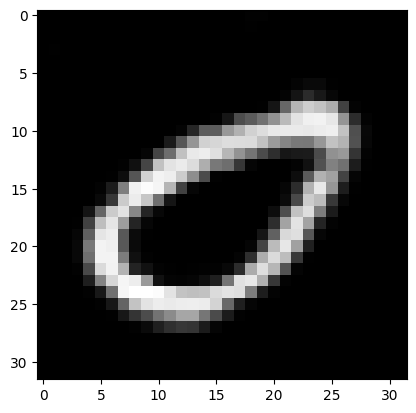

batch 600 gen loss: -11.052410125732422, discr loss: 55.26203918457031


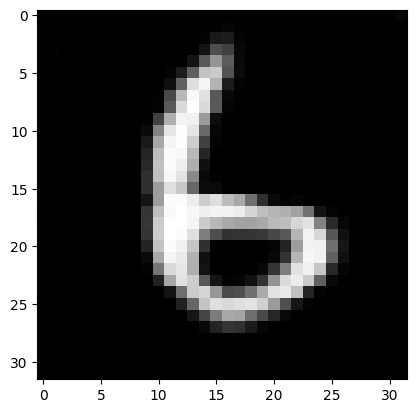

batch 700 gen loss: -7.3682732582092285, discr loss: 55.26203918457031


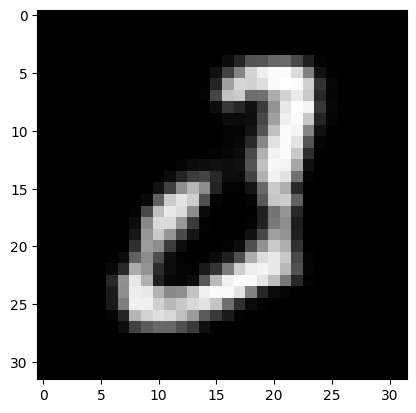

batch 800 gen loss: -11.052410125732422, discr loss: 55.26203918457031


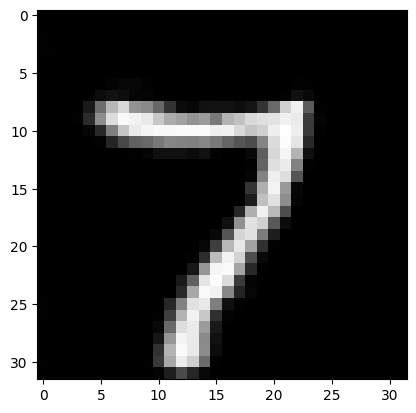

batch 900 gen loss: -18.420682907104492, discr loss: 55.26203918457031


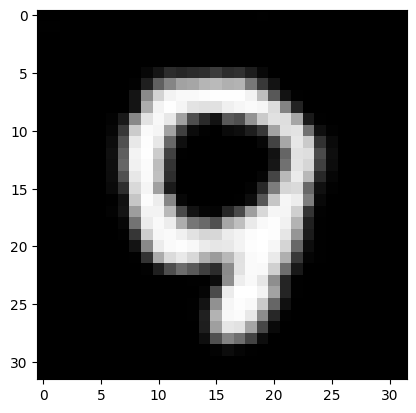

-8771.8798828125 51780.2890625


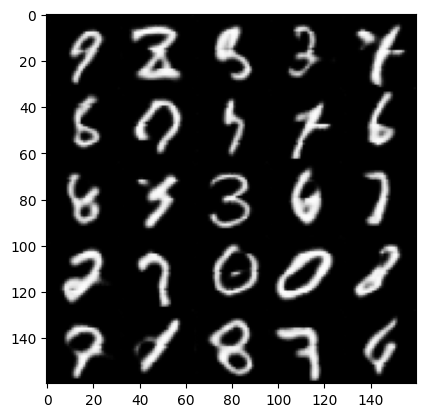

epoch 84:
batch 0 gen loss: -11.052410125732422, discr loss: 55.26203918457031


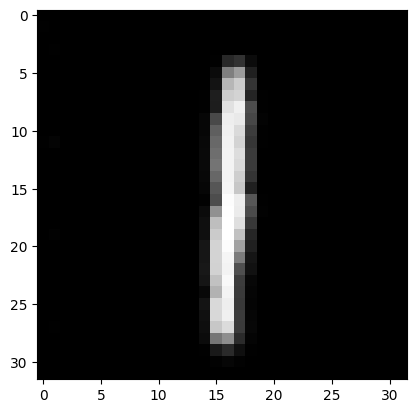

batch 100 gen loss: -11.052410125732422, discr loss: 55.26203918457031


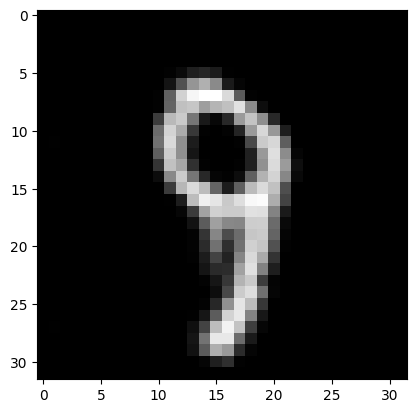

batch 200 gen loss: -18.420682907104492, discr loss: 55.26203918457031


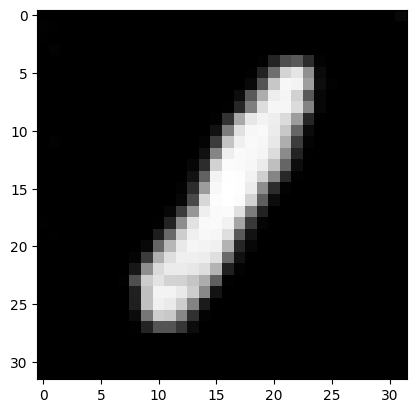

batch 300 gen loss: -7.3682732582092285, discr loss: 55.26203918457031


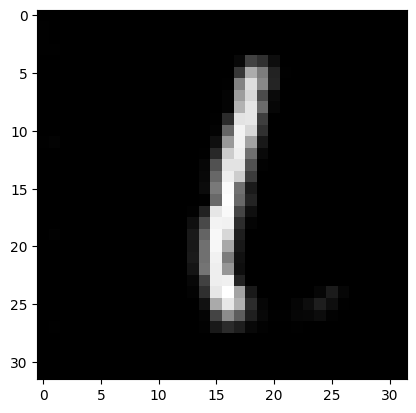

batch 400 gen loss: -14.736546516418457, discr loss: 55.26203918457031


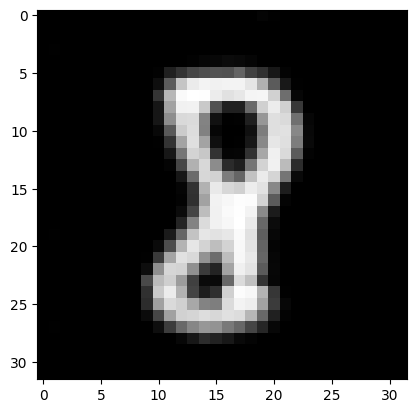

batch 500 gen loss: -7.3682732582092285, discr loss: 55.26203918457031


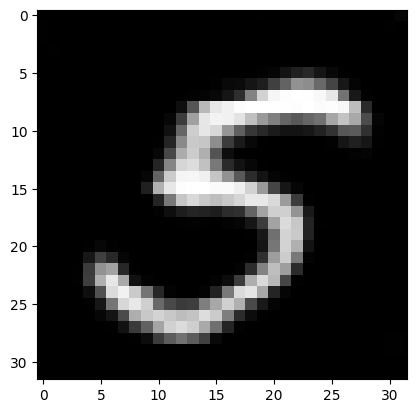

batch 600 gen loss: -3.6841366291046143, discr loss: 55.26203918457031


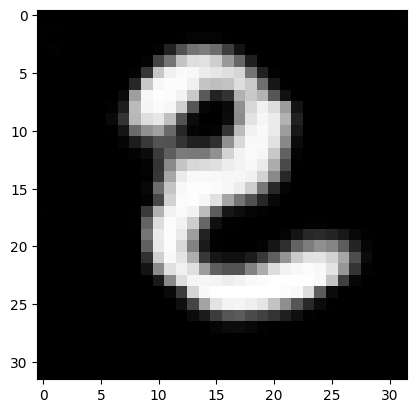

batch 700 gen loss: -3.6841366291046143, discr loss: 55.26203918457031


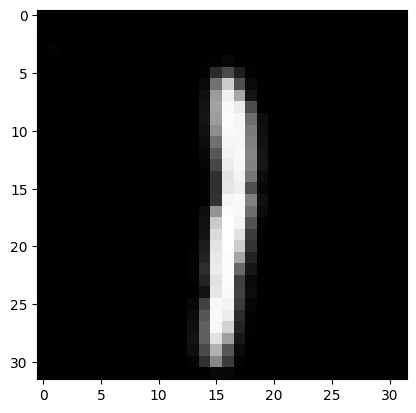

batch 800 gen loss: -7.3682732582092285, discr loss: 55.26203918457031


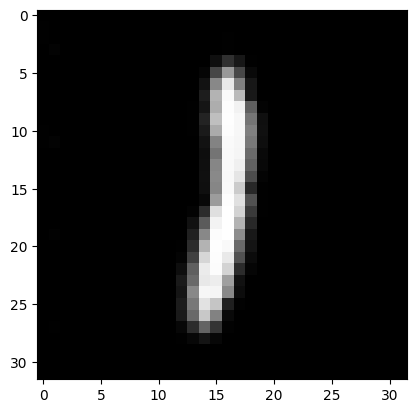

batch 900 gen loss: -14.736546516418457, discr loss: 55.26203918457031


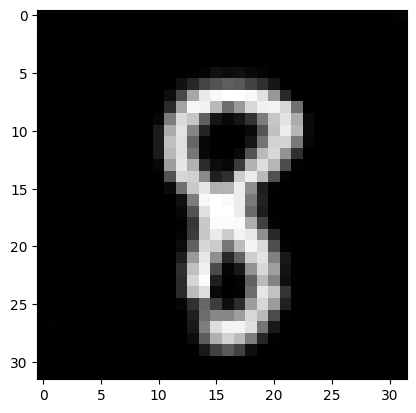

-8801.353515625 51780.2890625


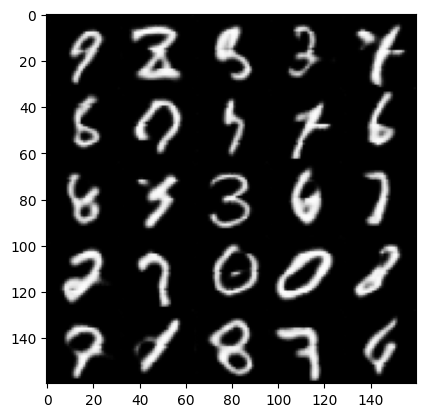

epoch 85:
batch 0 gen loss: -11.052410125732422, discr loss: 55.26203918457031


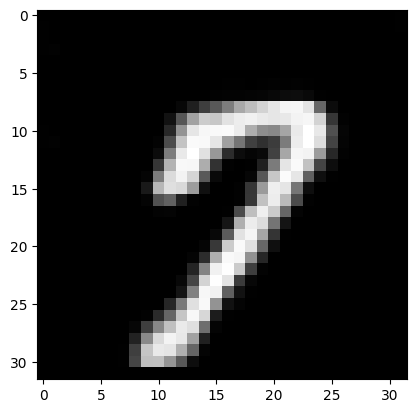

batch 100 gen loss: -18.420682907104492, discr loss: 55.26203918457031


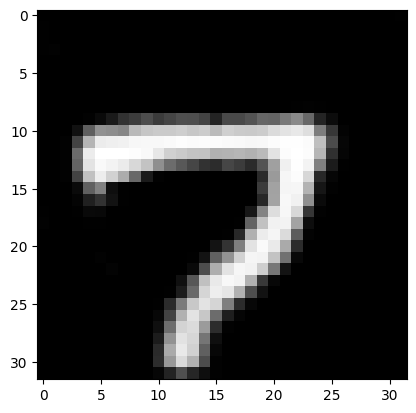

batch 200 gen loss: -7.3682732582092285, discr loss: 55.26203918457031


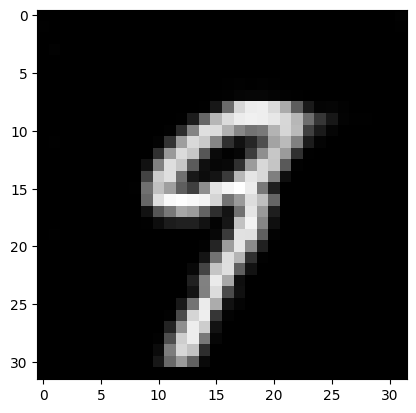

batch 300 gen loss: -7.3682732582092285, discr loss: 55.26203918457031


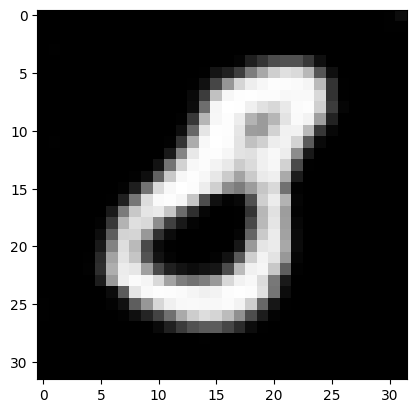

batch 400 gen loss: -11.052410125732422, discr loss: 55.26203918457031


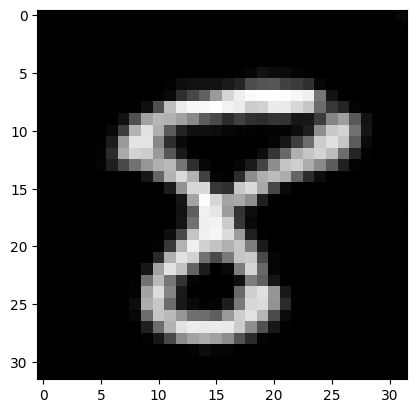

batch 500 gen loss: -11.052410125732422, discr loss: 55.26203918457031


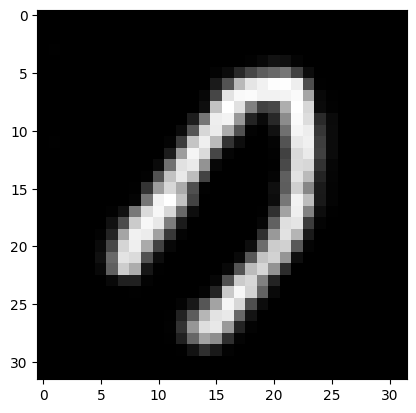

batch 600 gen loss: -3.6841366291046143, discr loss: 55.26203918457031


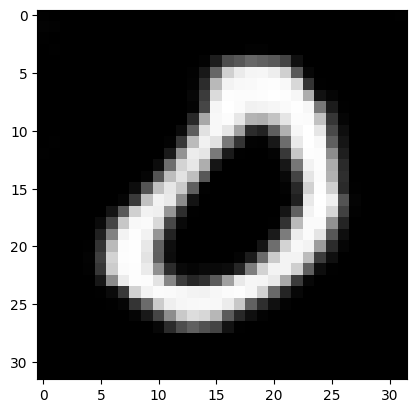

batch 700 gen loss: -14.736546516418457, discr loss: 55.26203918457031


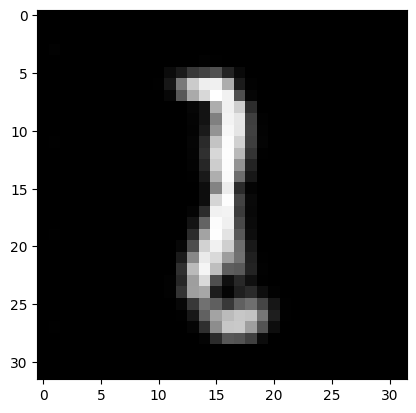

batch 800 gen loss: -7.3682732582092285, discr loss: 55.26203918457031


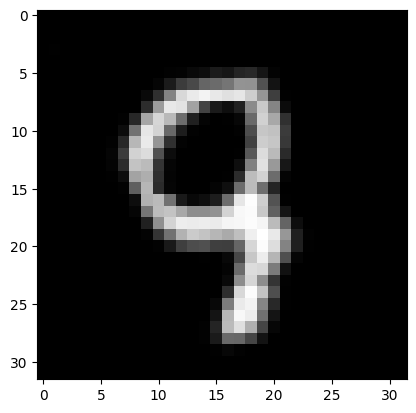

batch 900 gen loss: -11.052410125732422, discr loss: 55.26203918457031


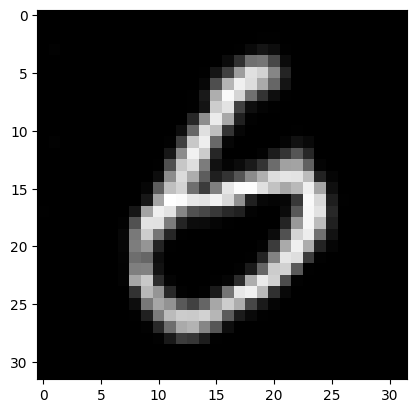

-8742.408203125 51780.2890625


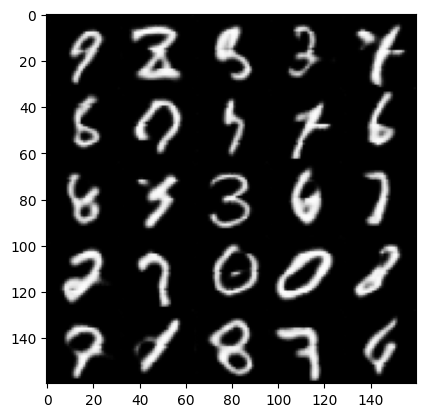

epoch 86:
batch 0 gen loss: -11.052410125732422, discr loss: 55.26203918457031


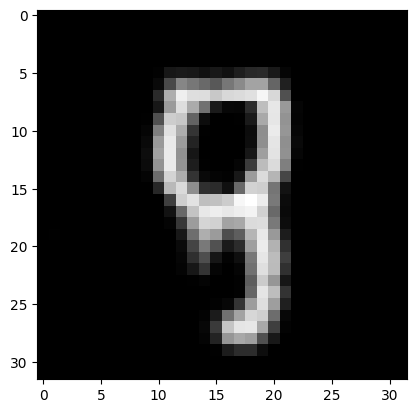

batch 100 gen loss: -14.736546516418457, discr loss: 55.26203918457031


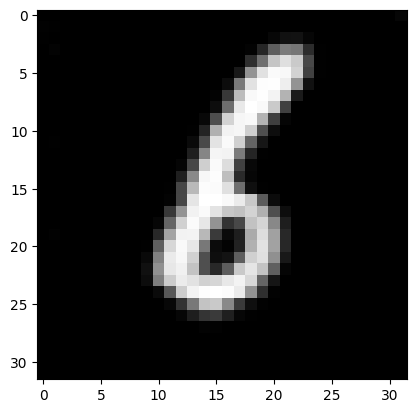

batch 200 gen loss: -11.052410125732422, discr loss: 55.26203918457031


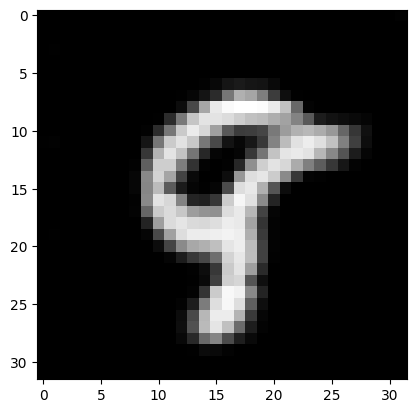

batch 300 gen loss: -3.6841366291046143, discr loss: 55.26203918457031


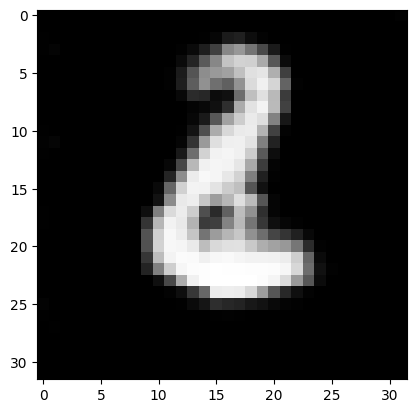

batch 400 gen loss: -14.736546516418457, discr loss: 55.26203918457031


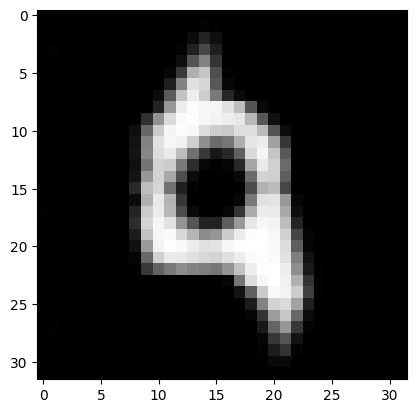

batch 500 gen loss: -11.052410125732422, discr loss: 55.26203918457031


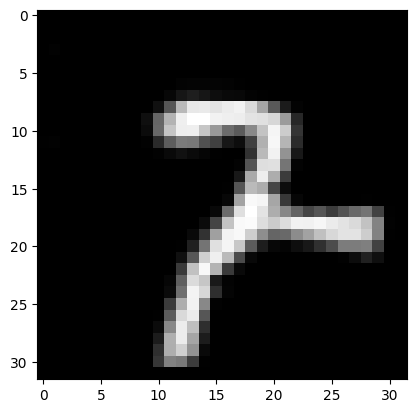

batch 600 gen loss: -11.052410125732422, discr loss: 55.26203918457031


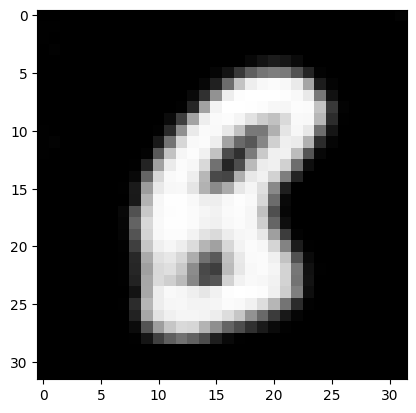

batch 700 gen loss: -3.6841366291046143, discr loss: 55.26203918457031


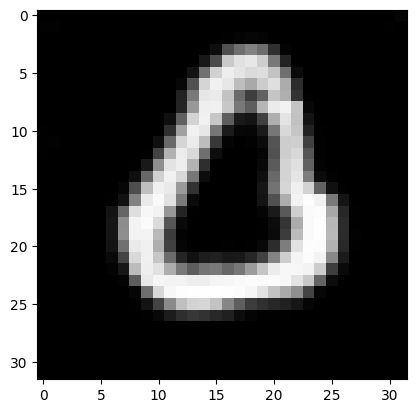

batch 800 gen loss: -7.3682732582092285, discr loss: 55.26203918457031


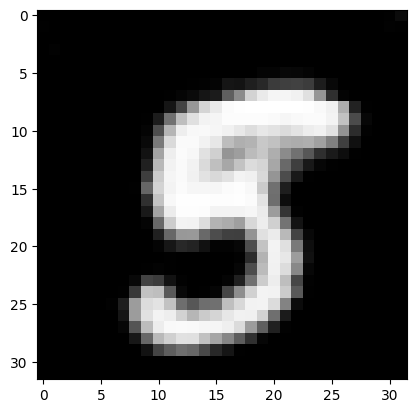

batch 900 gen loss: -7.3682732582092285, discr loss: 55.26203918457031


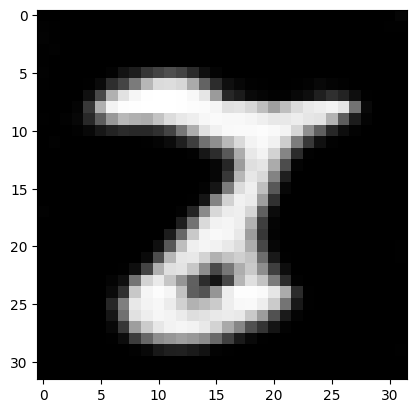

-8705.5625 51780.2890625


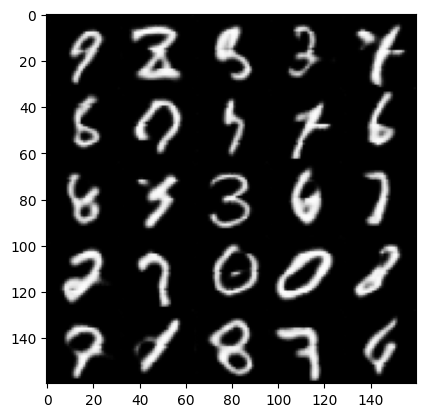

epoch 87:
batch 0 gen loss: -3.6841366291046143, discr loss: 55.26203918457031


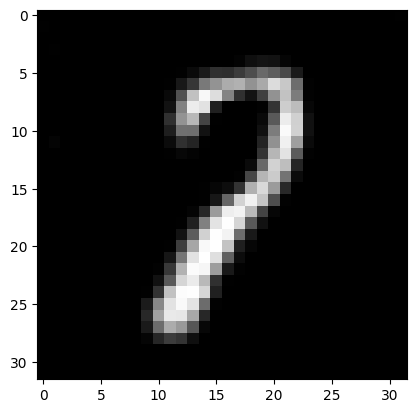

batch 100 gen loss: -11.052410125732422, discr loss: 55.26203918457031


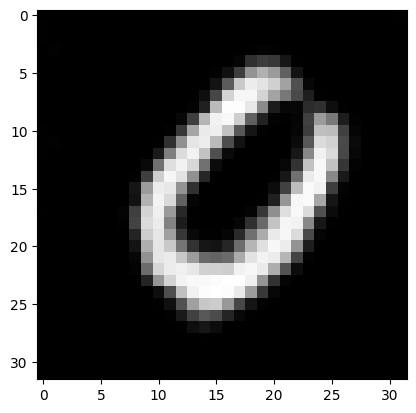

batch 200 gen loss: -3.6841366291046143, discr loss: 55.26203918457031


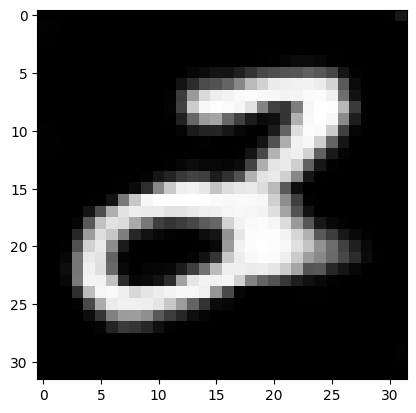

batch 300 gen loss: -14.736546516418457, discr loss: 55.26203918457031


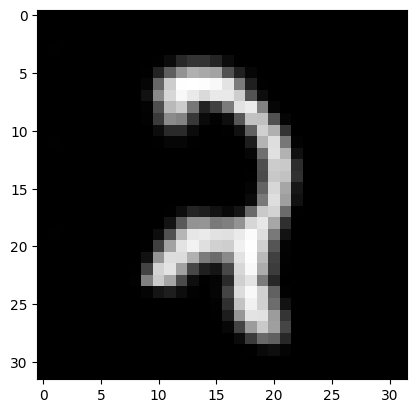

batch 400 gen loss: -11.052410125732422, discr loss: 55.26203918457031


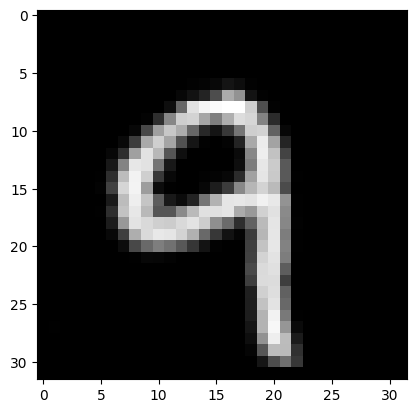

batch 500 gen loss: -7.3682732582092285, discr loss: 55.26203918457031


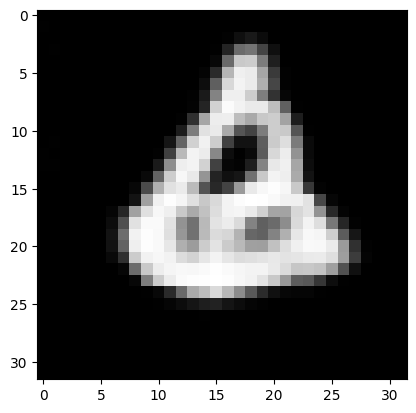

batch 600 gen loss: -7.3682732582092285, discr loss: 55.26203918457031


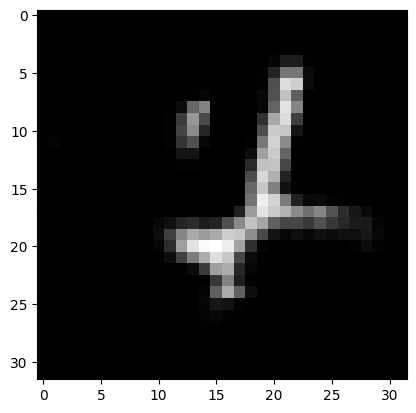

batch 700 gen loss: -3.6841366291046143, discr loss: 55.26203918457031


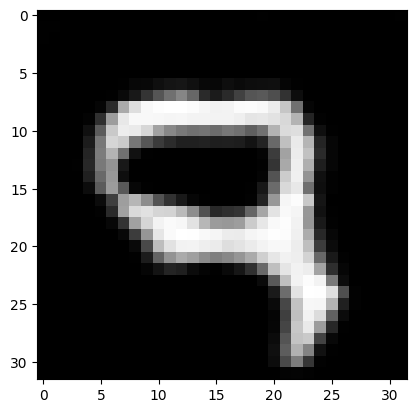

batch 800 gen loss: -11.052410125732422, discr loss: 55.26203918457031


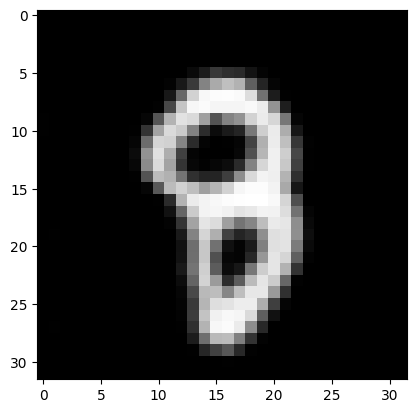

batch 900 gen loss: -7.3682732582092285, discr loss: 55.26203918457031


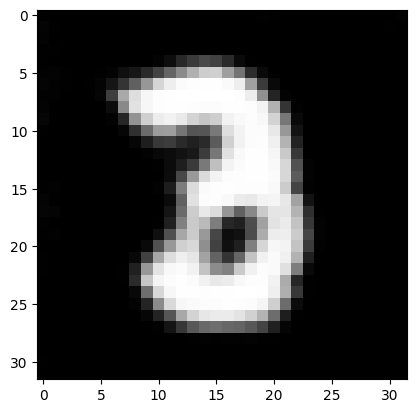

-8727.6708984375 51780.2890625


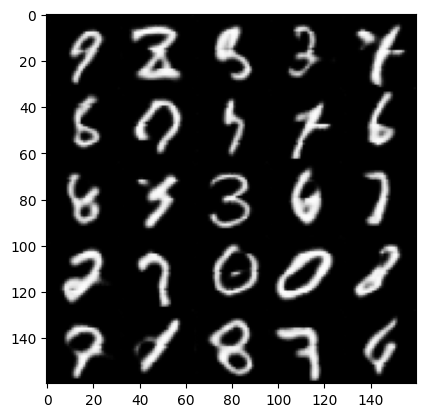

epoch 88:
batch 0 gen loss: -7.3682732582092285, discr loss: 55.26203918457031


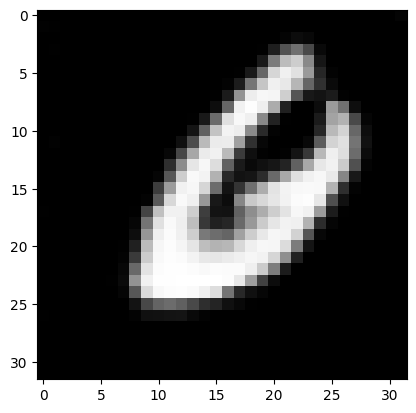

batch 100 gen loss: -3.6841366291046143, discr loss: 55.26203918457031


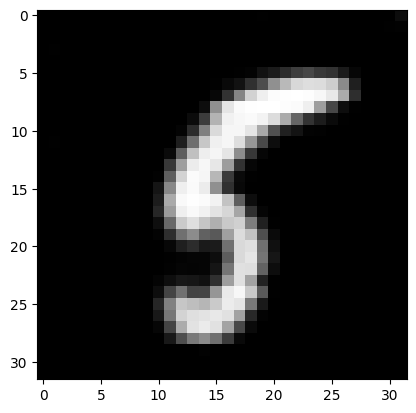

batch 200 gen loss: -14.736546516418457, discr loss: 55.26203918457031


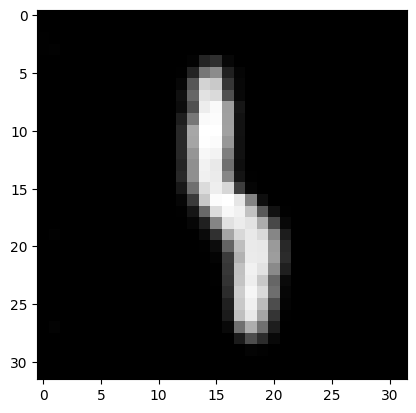

batch 300 gen loss: -11.052410125732422, discr loss: 55.26203918457031


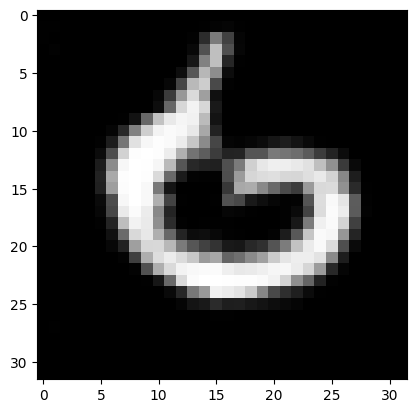

batch 400 gen loss: -14.736546516418457, discr loss: 55.26203918457031


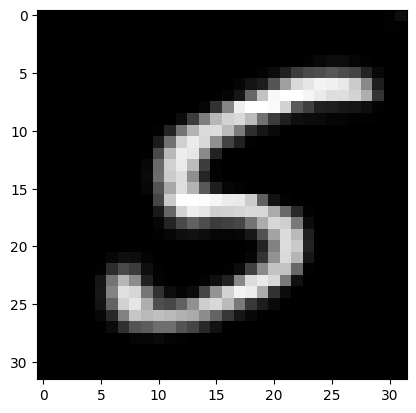

batch 500 gen loss: -7.3682732582092285, discr loss: 55.26203918457031


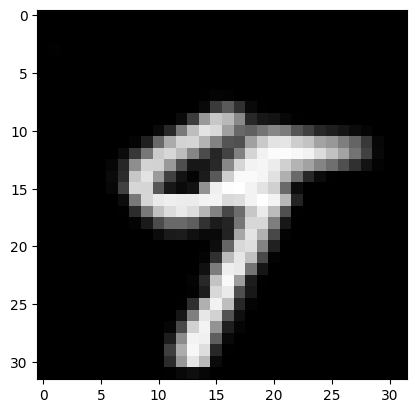

batch 600 gen loss: -3.6841366291046143, discr loss: 55.26203918457031


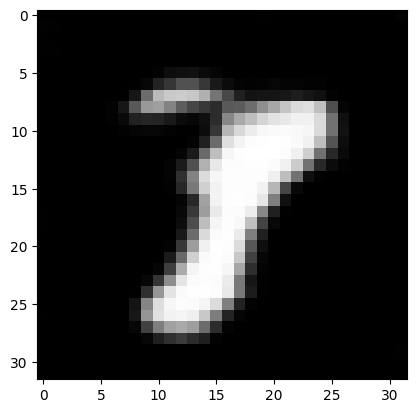

batch 700 gen loss: -7.3682732582092285, discr loss: 55.26203918457031


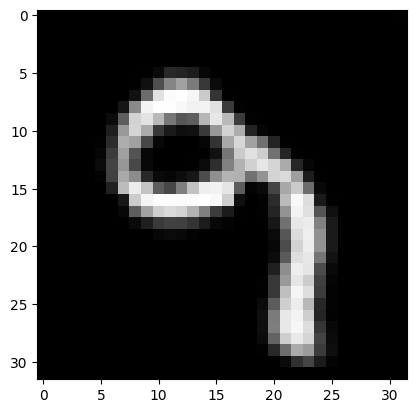

batch 800 gen loss: -3.6841366291046143, discr loss: 55.26203918457031


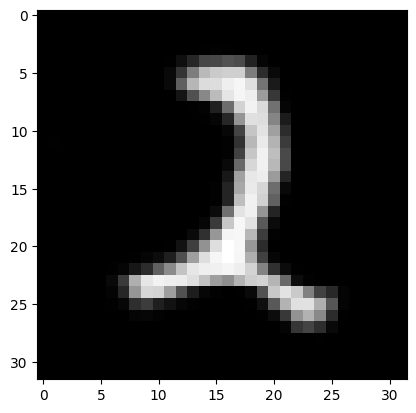

batch 900 gen loss: -14.736546516418457, discr loss: 55.26203918457031


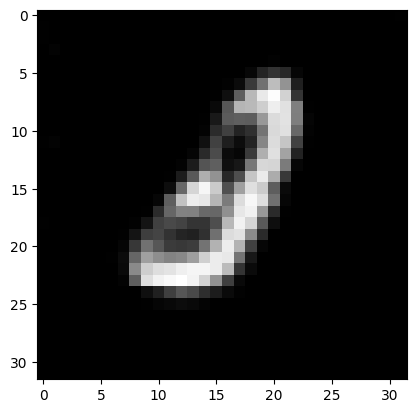

-8797.6669921875 51780.2890625


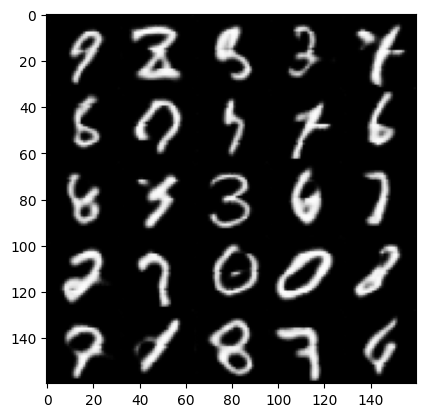

epoch 89:
batch 0 gen loss: -11.052410125732422, discr loss: 55.26203918457031


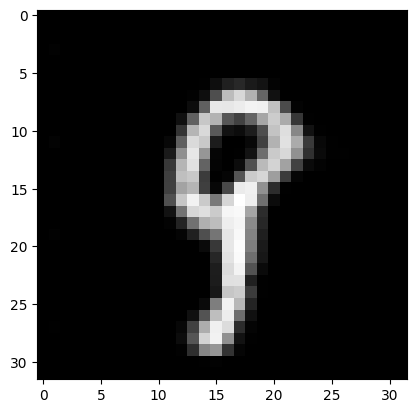

batch 100 gen loss: -7.3682732582092285, discr loss: 55.26203918457031


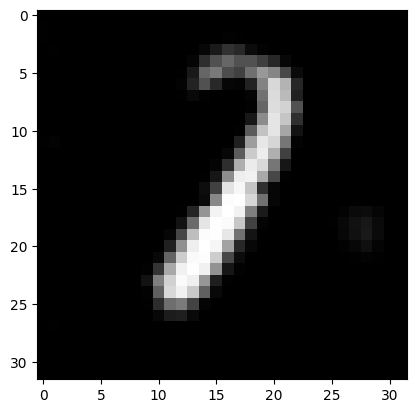

batch 200 gen loss: -7.3682732582092285, discr loss: 55.26203918457031


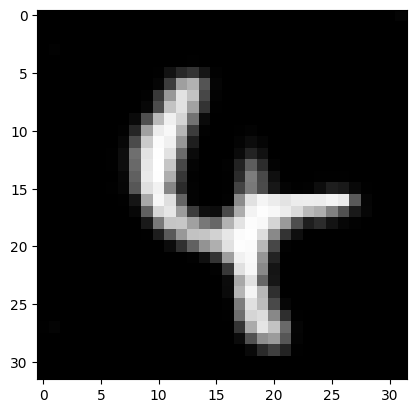

batch 300 gen loss: -7.3682732582092285, discr loss: 55.26203918457031


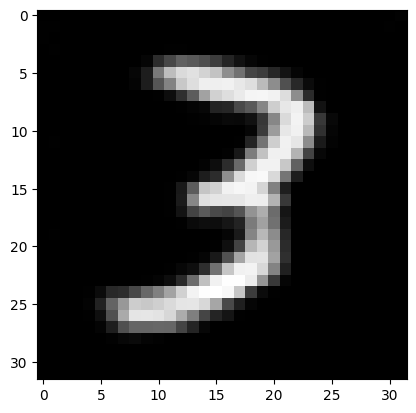

batch 400 gen loss: -7.3682732582092285, discr loss: 55.26203918457031


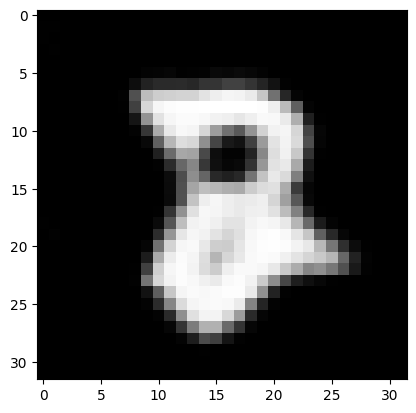

batch 500 gen loss: -7.3682732582092285, discr loss: 55.26203918457031


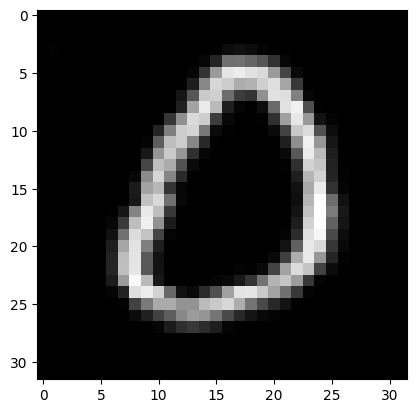

batch 600 gen loss: -11.052410125732422, discr loss: 55.26203918457031


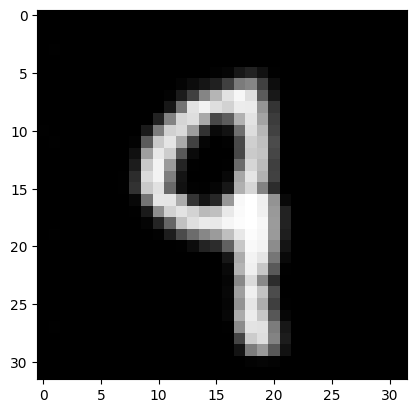

batch 700 gen loss: -3.6841366291046143, discr loss: 55.26203918457031


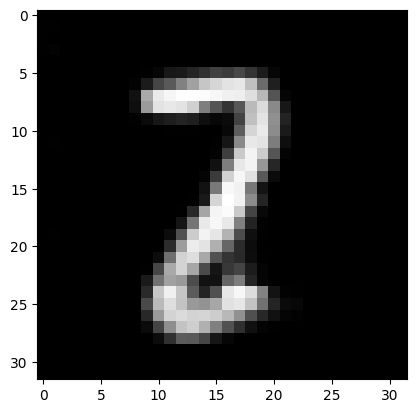

batch 800 gen loss: -3.6841366291046143, discr loss: 55.26203918457031


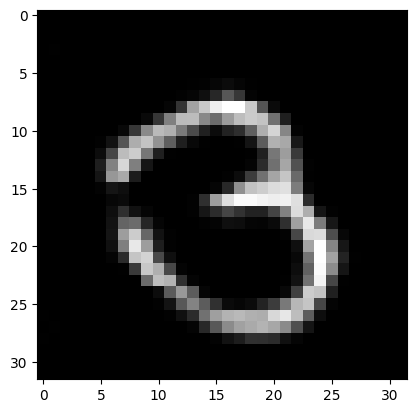

batch 900 gen loss: -7.3682732582092285, discr loss: 55.26203918457031


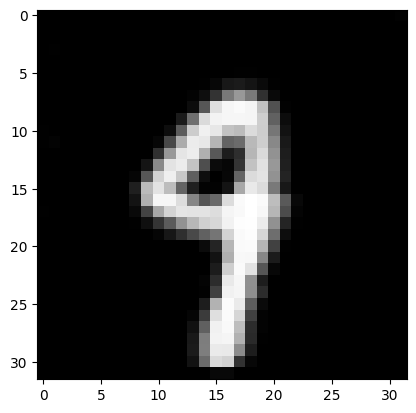

-8738.7236328125 51780.2890625


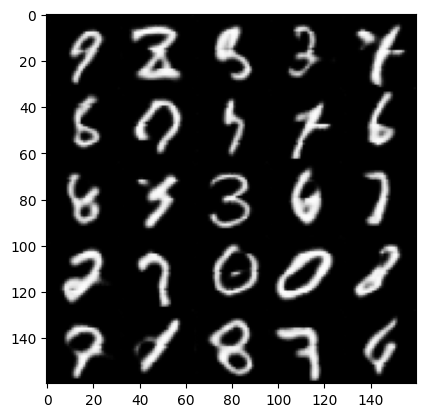

epoch 90:
batch 0 gen loss: -11.052410125732422, discr loss: 55.26203918457031


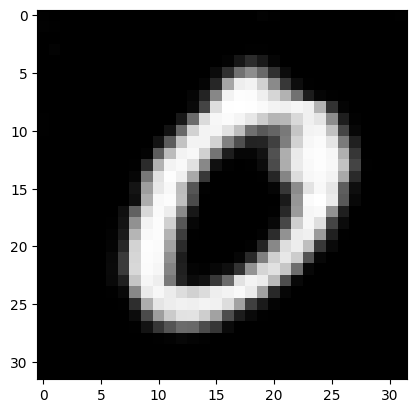

batch 100 gen loss: -3.6841366291046143, discr loss: 55.26203918457031


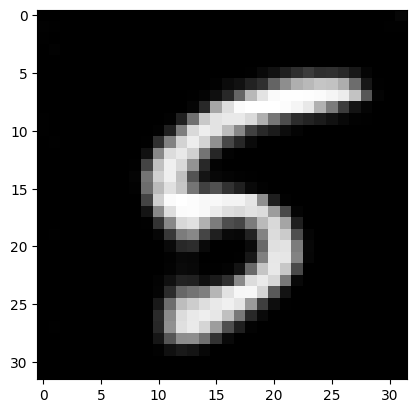

batch 200 gen loss: -11.052410125732422, discr loss: 55.26203918457031


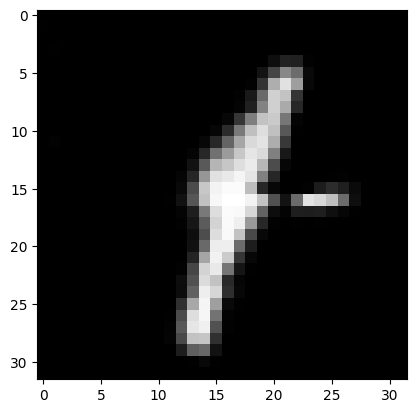

batch 300 gen loss: -11.052410125732422, discr loss: 55.26203918457031


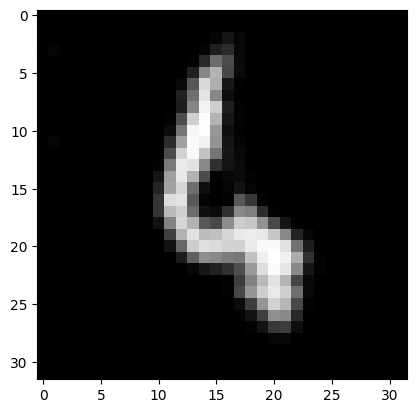

batch 400 gen loss: -11.052410125732422, discr loss: 55.26203918457031


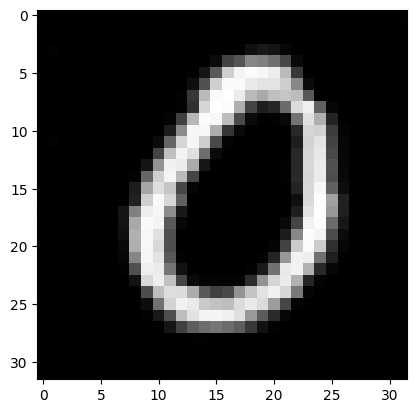

batch 500 gen loss: -14.736546516418457, discr loss: 55.26203918457031


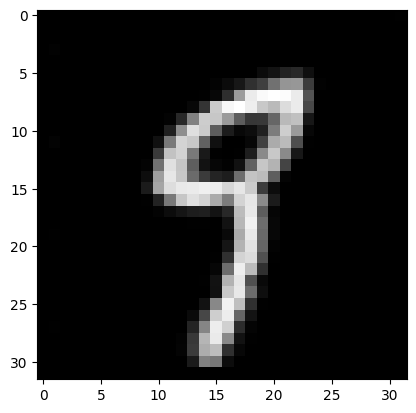

batch 600 gen loss: -14.736546516418457, discr loss: 55.26203918457031


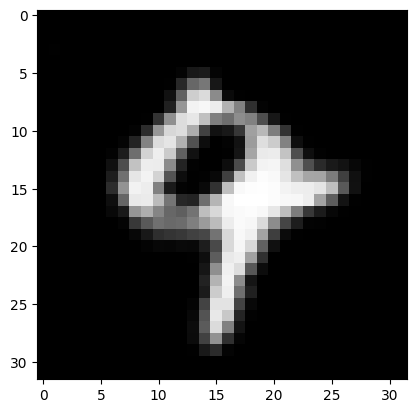

batch 700 gen loss: -14.736546516418457, discr loss: 55.26203918457031


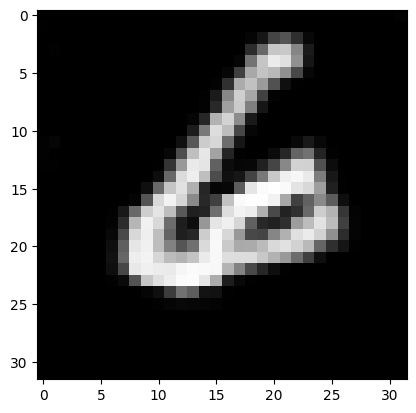

batch 800 gen loss: -3.6841366291046143, discr loss: 55.26203918457031


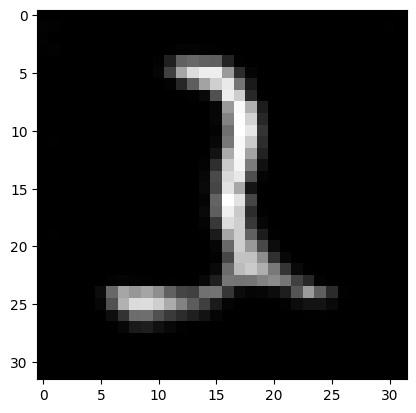

batch 900 gen loss: -11.052410125732422, discr loss: 55.26203918457031


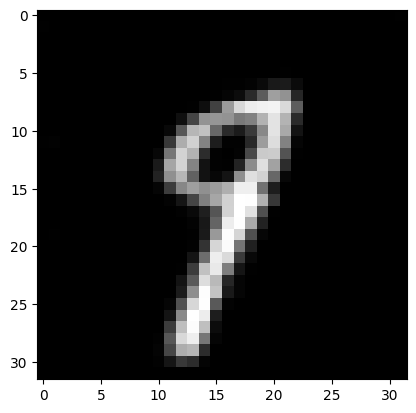

-8771.880859375 51780.2890625


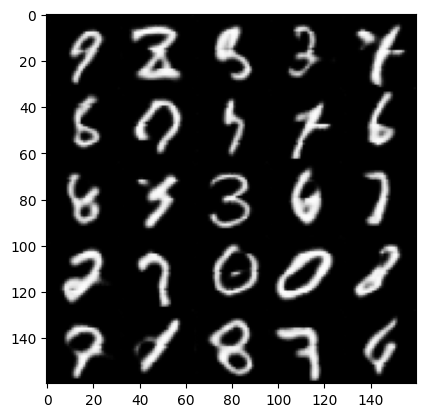

epoch 91:
batch 0 gen loss: -14.736546516418457, discr loss: 55.26203918457031


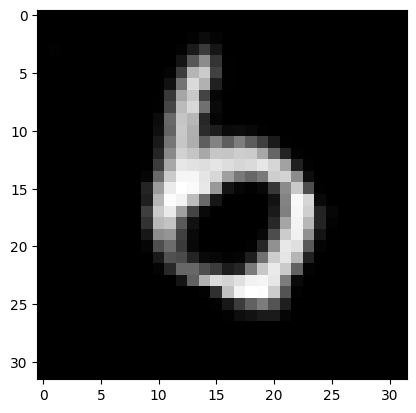

batch 100 gen loss: -14.736546516418457, discr loss: 55.26203918457031


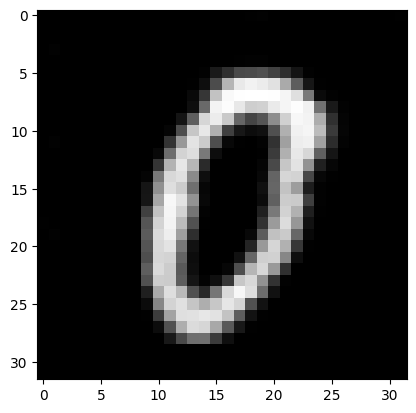

batch 200 gen loss: -18.420682907104492, discr loss: 55.26203918457031


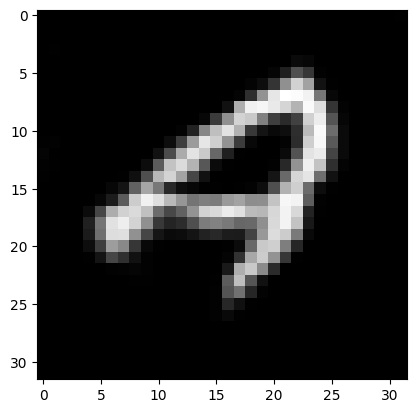

batch 300 gen loss: -7.3682732582092285, discr loss: 55.26203918457031


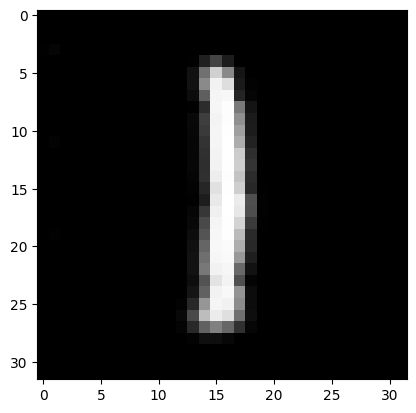

batch 400 gen loss: -3.6841366291046143, discr loss: 55.26203918457031


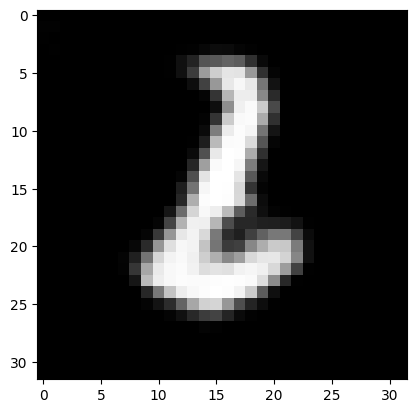

batch 500 gen loss: -11.052410125732422, discr loss: 55.26203918457031


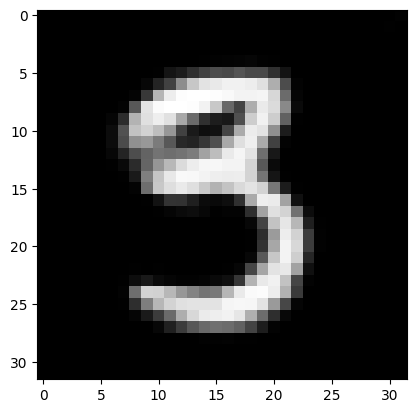

batch 600 gen loss: -14.736546516418457, discr loss: 55.26203918457031


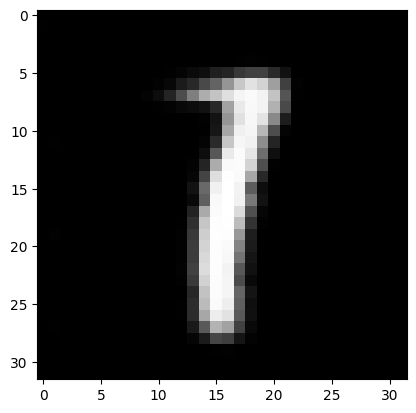

batch 700 gen loss: -7.3682732582092285, discr loss: 55.26203918457031


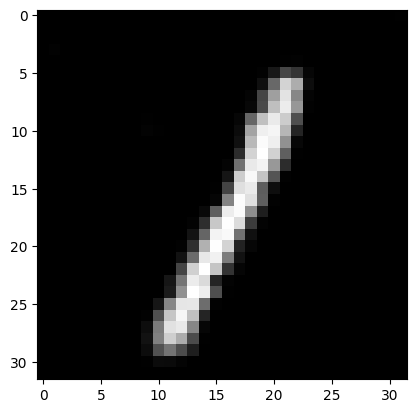

batch 800 gen loss: -11.052410125732422, discr loss: 55.26203918457031


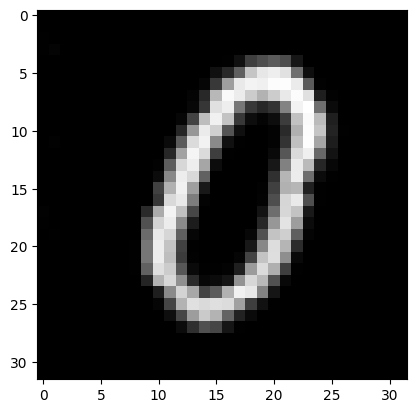

batch 900 gen loss: -14.736546516418457, discr loss: 55.26203918457031


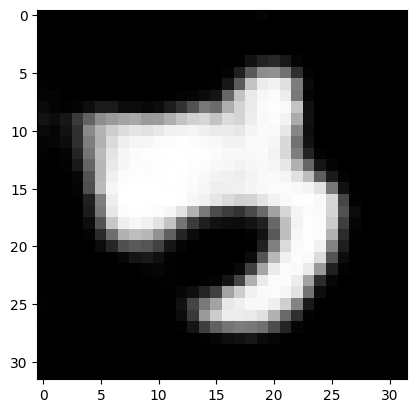

-8746.0869140625 51780.2890625


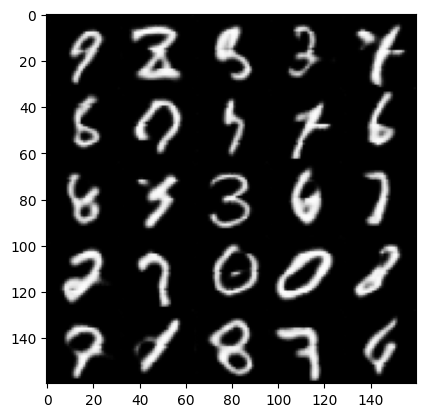

epoch 92:
batch 0 gen loss: -7.3682732582092285, discr loss: 55.26203918457031


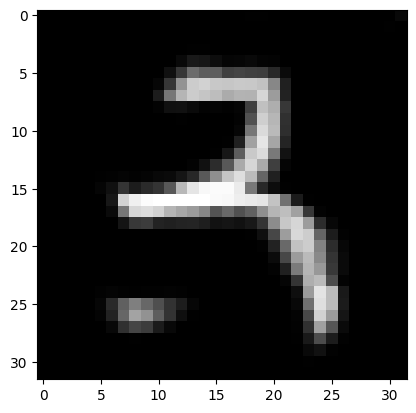

batch 100 gen loss: -3.6841366291046143, discr loss: 55.26203918457031


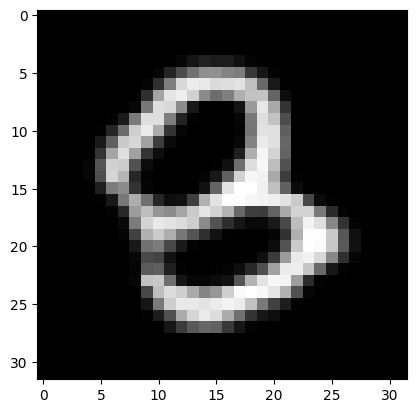

batch 200 gen loss: -7.3682732582092285, discr loss: 55.26203918457031


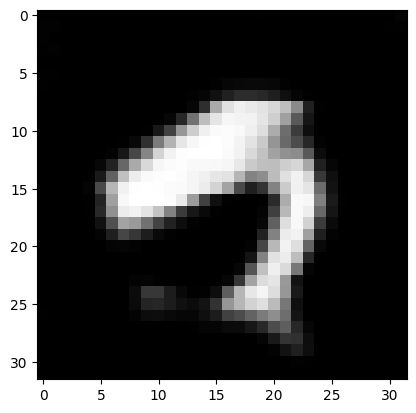

batch 300 gen loss: -11.052410125732422, discr loss: 55.26203918457031


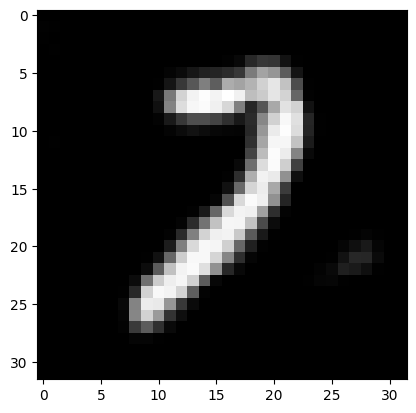

batch 400 gen loss: -7.3682732582092285, discr loss: 55.26203918457031


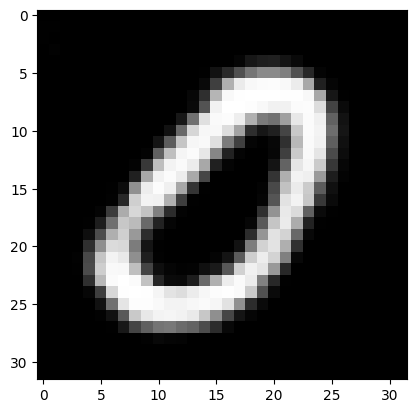

batch 500 gen loss: -7.3682732582092285, discr loss: 55.26203918457031


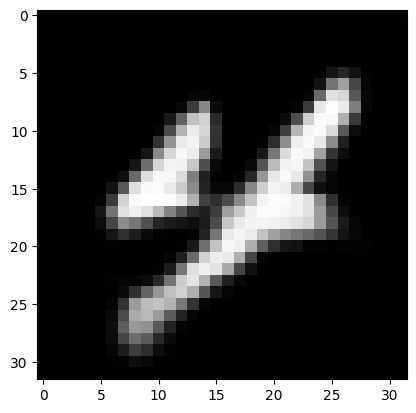

batch 600 gen loss: -3.6841366291046143, discr loss: 55.26203918457031


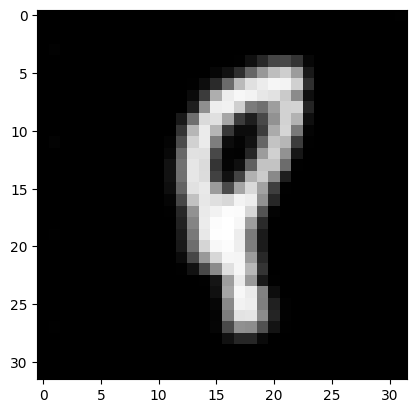

batch 700 gen loss: -18.420682907104492, discr loss: 55.26203918457031


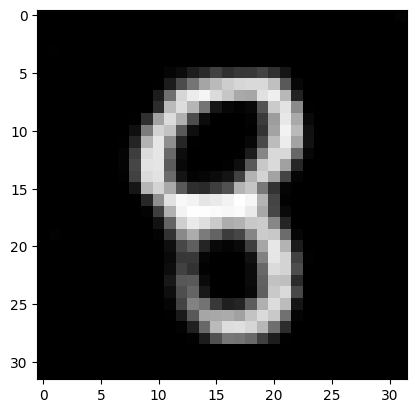

batch 800 gen loss: -14.736546516418457, discr loss: 55.26203918457031


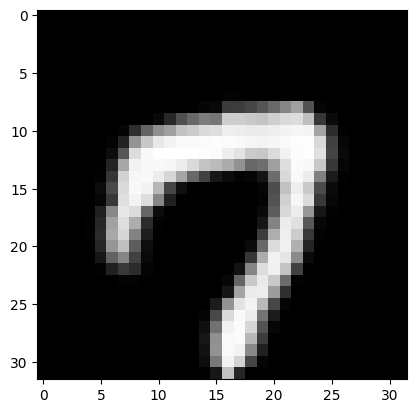

batch 900 gen loss: -14.736546516418457, discr loss: 55.26203918457031


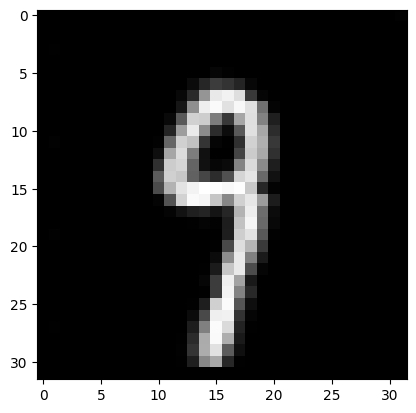

-8945.03125 51780.2890625


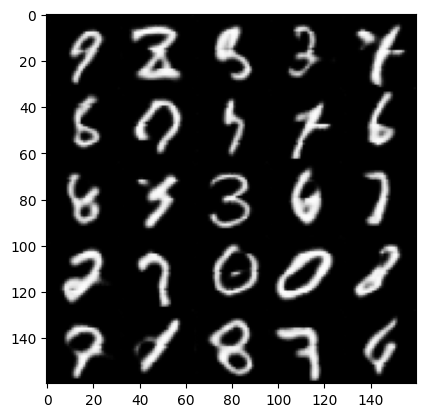

epoch 93:
batch 0 gen loss: -11.052410125732422, discr loss: 55.26203918457031


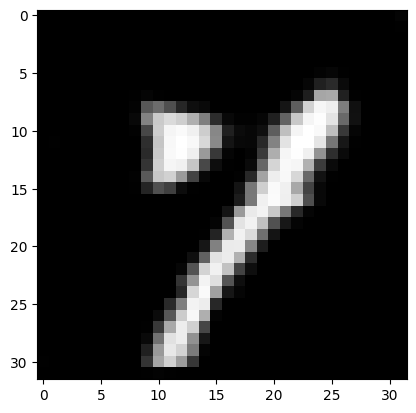

batch 100 gen loss: -3.6841366291046143, discr loss: 55.26203918457031


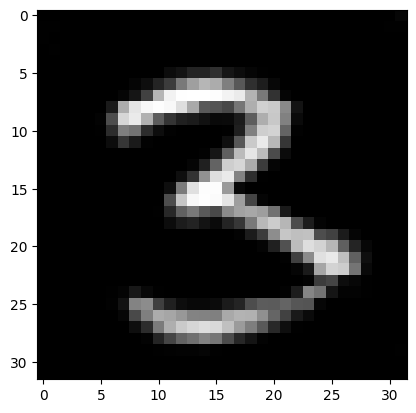

batch 200 gen loss: -14.736546516418457, discr loss: 55.26203918457031


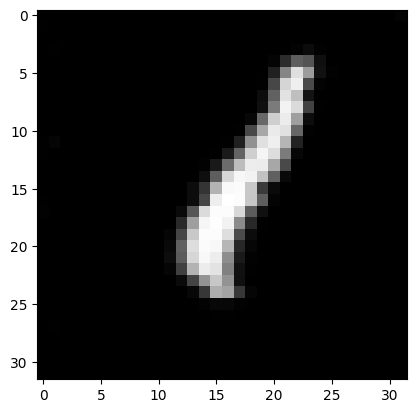

batch 300 gen loss: -14.736546516418457, discr loss: 55.26203918457031


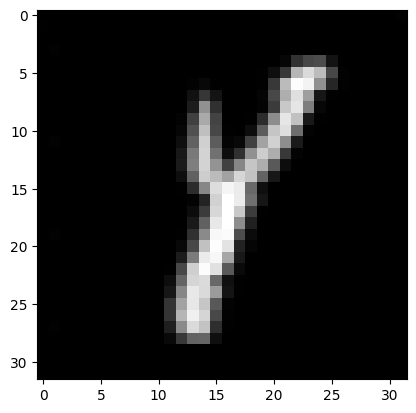

batch 400 gen loss: -11.052410125732422, discr loss: 55.26203918457031


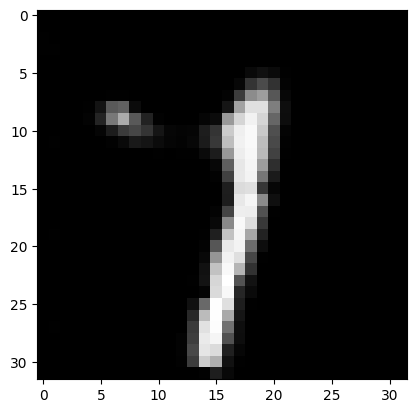

batch 500 gen loss: -11.052410125732422, discr loss: 55.26203918457031


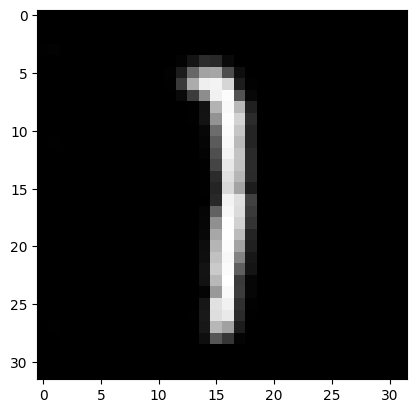

batch 600 gen loss: -11.052410125732422, discr loss: 55.26203918457031


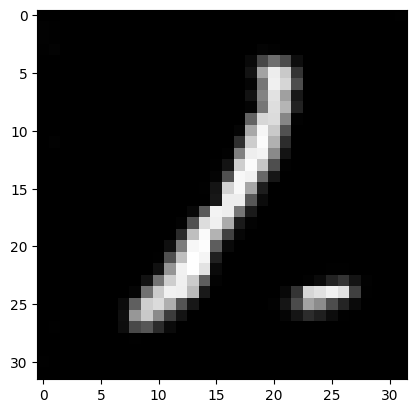

batch 700 gen loss: -3.6841366291046143, discr loss: 55.26203918457031


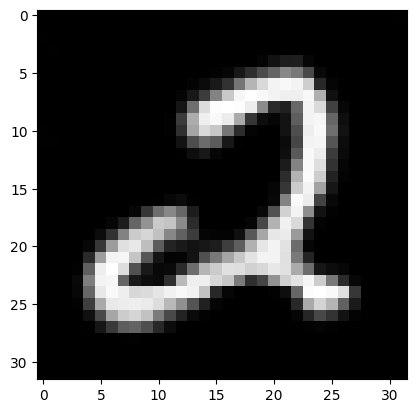

batch 800 gen loss: -7.3682732582092285, discr loss: 55.26203918457031


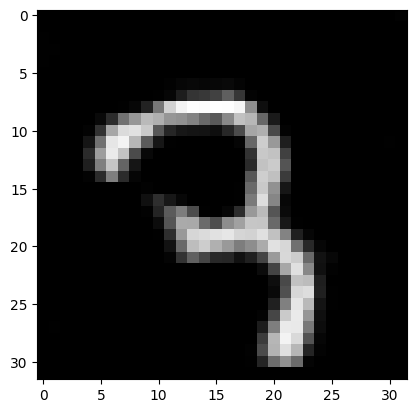

batch 900 gen loss: -7.3682732582092285, discr loss: 55.26203918457031


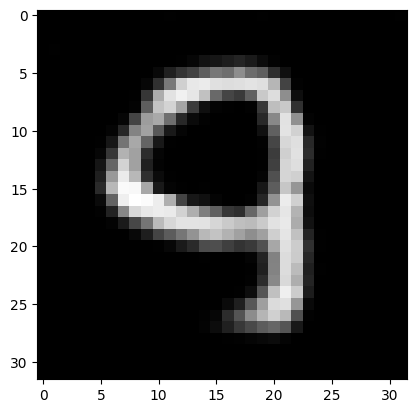

-8528.7197265625 51780.2890625


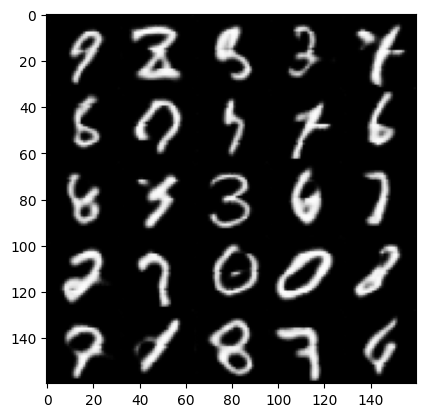

epoch 94:
batch 0 gen loss: -11.052410125732422, discr loss: 55.26203918457031


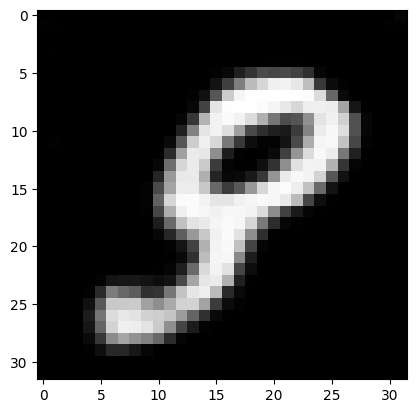

batch 100 gen loss: -11.052410125732422, discr loss: 55.26203918457031


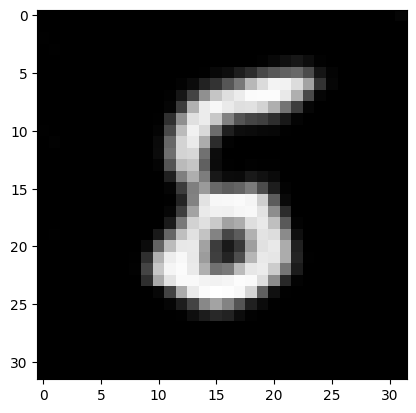

batch 200 gen loss: -11.052410125732422, discr loss: 55.26203918457031


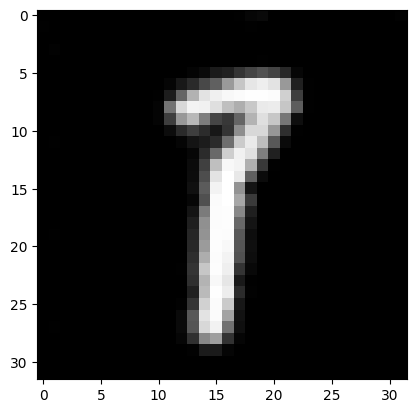

batch 300 gen loss: -7.3682732582092285, discr loss: 55.26203918457031


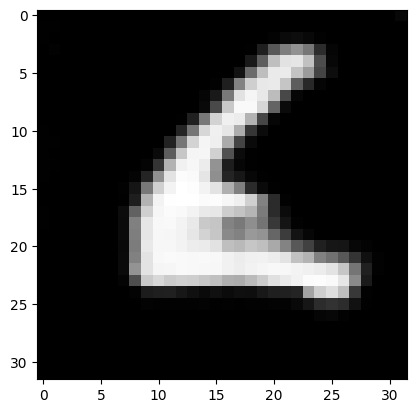

batch 400 gen loss: -11.052410125732422, discr loss: 55.26203918457031


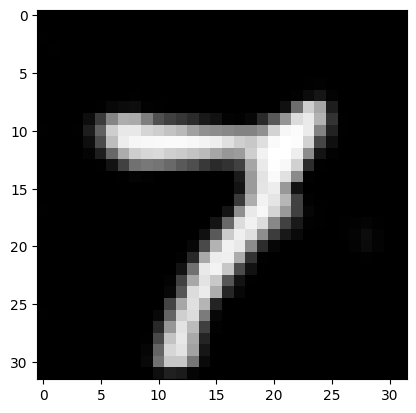

batch 500 gen loss: -11.052410125732422, discr loss: 55.26203918457031


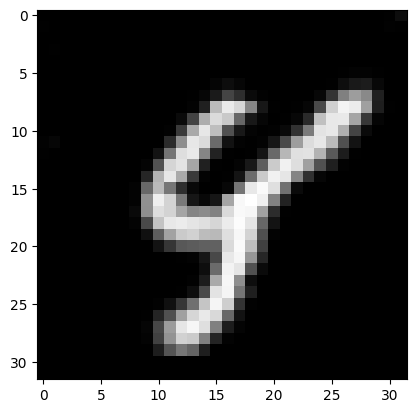

batch 600 gen loss: -11.052410125732422, discr loss: 55.26203918457031


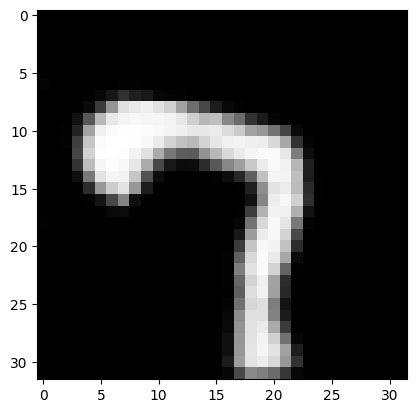

batch 700 gen loss: -3.6841366291046143, discr loss: 55.26203918457031


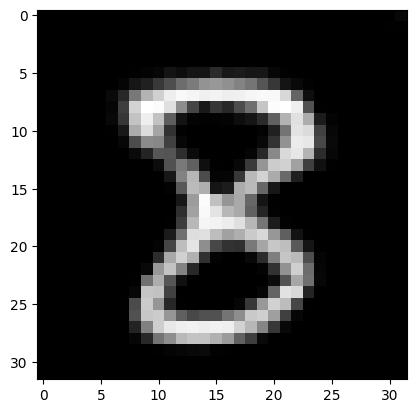

batch 800 gen loss: -3.6841366291046143, discr loss: 55.26203918457031


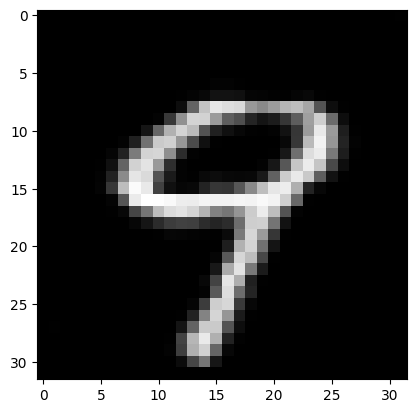

batch 900 gen loss: -14.736546516418457, discr loss: 55.26203918457031


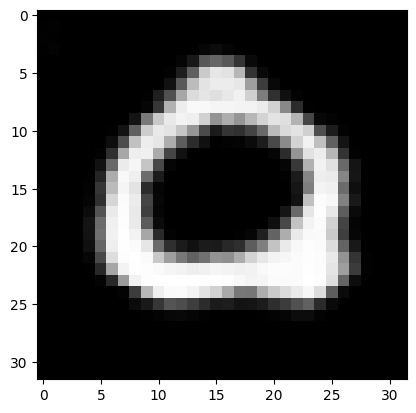

-8569.2451171875 51780.2890625


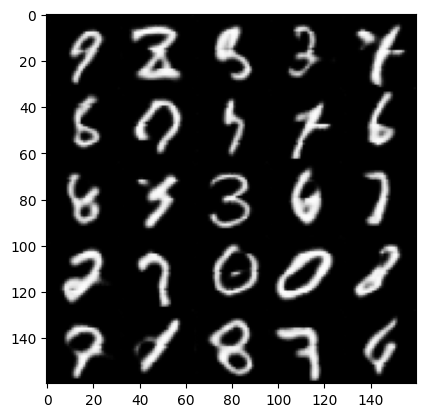

epoch 95:
batch 0 gen loss: -7.3682732582092285, discr loss: 55.26203918457031


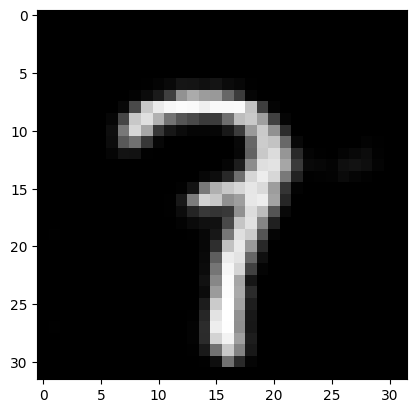

batch 100 gen loss: -7.3682732582092285, discr loss: 55.26203918457031


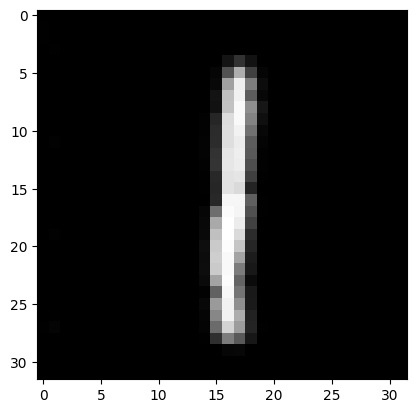

batch 200 gen loss: -3.6841366291046143, discr loss: 55.26203918457031


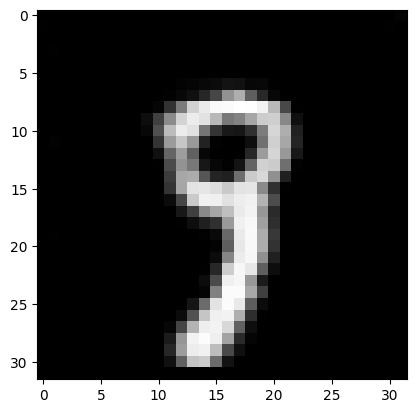

batch 300 gen loss: -14.736546516418457, discr loss: 55.26203918457031


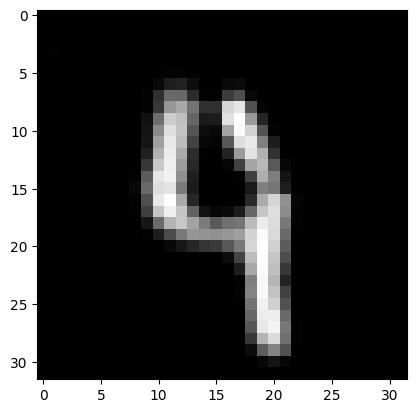

batch 400 gen loss: -7.3682732582092285, discr loss: 55.26203918457031


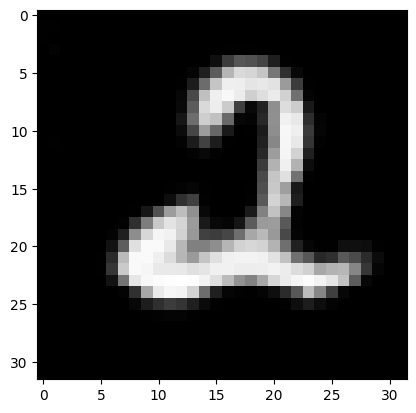

batch 500 gen loss: -7.3682732582092285, discr loss: 55.26203918457031


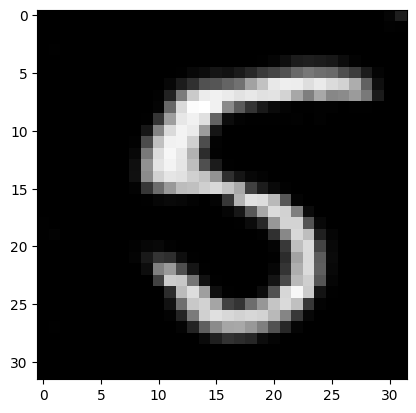

batch 600 gen loss: -3.6841366291046143, discr loss: 55.26203918457031


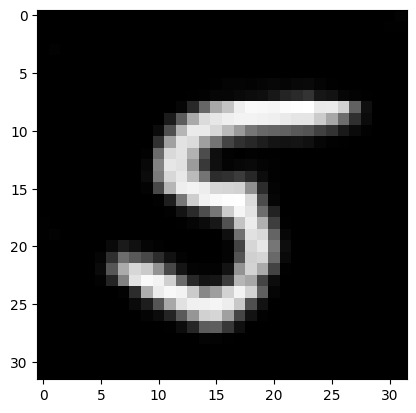

batch 700 gen loss: -7.3682732582092285, discr loss: 55.26203918457031


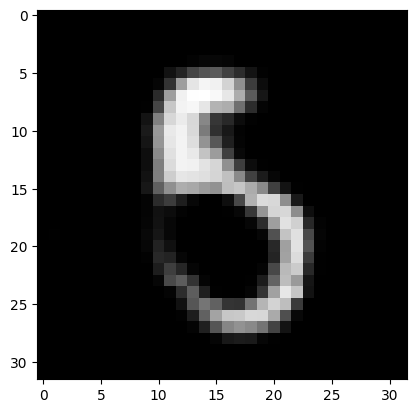

batch 800 gen loss: -14.736546516418457, discr loss: 55.26203918457031


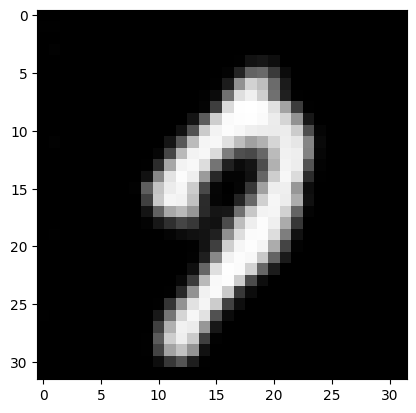

batch 900 gen loss: -7.3682732582092285, discr loss: 55.26203918457031


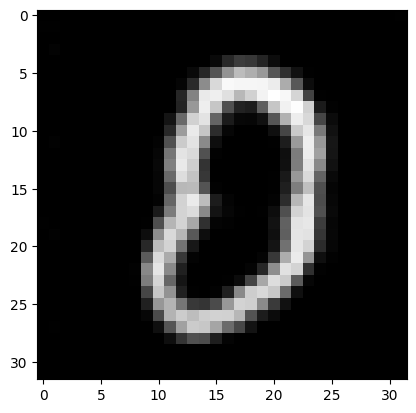

-8823.4580078125 51780.2890625


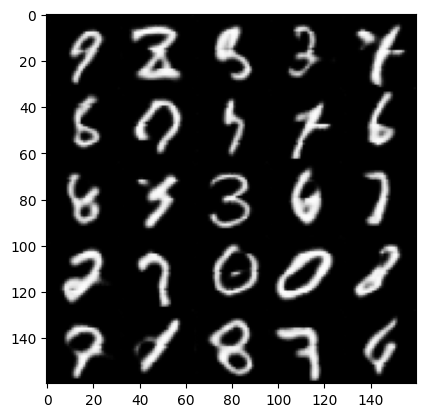

epoch 96:
batch 0 gen loss: -3.6841366291046143, discr loss: 55.26203918457031


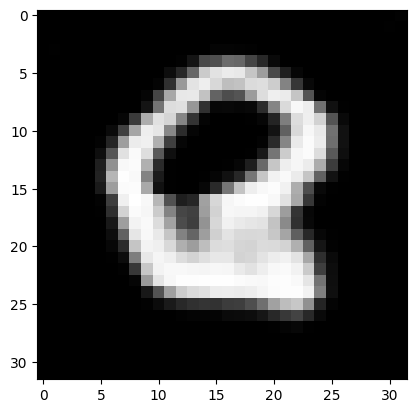

batch 100 gen loss: -3.6841366291046143, discr loss: 55.26203918457031


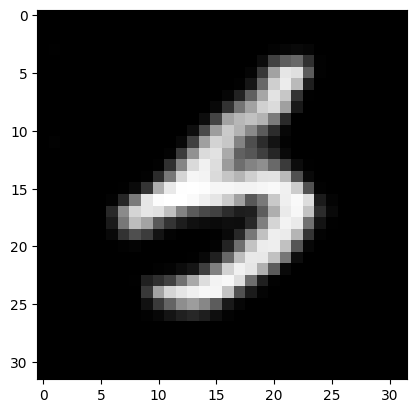

batch 200 gen loss: -14.736546516418457, discr loss: 55.26203918457031


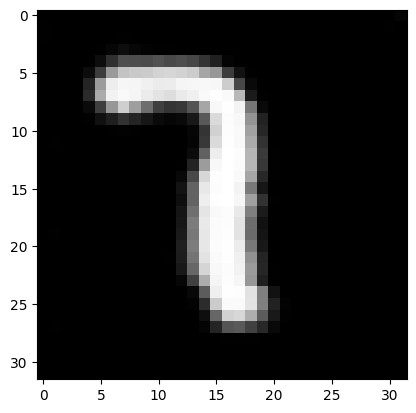

batch 300 gen loss: -11.052410125732422, discr loss: 55.26203918457031


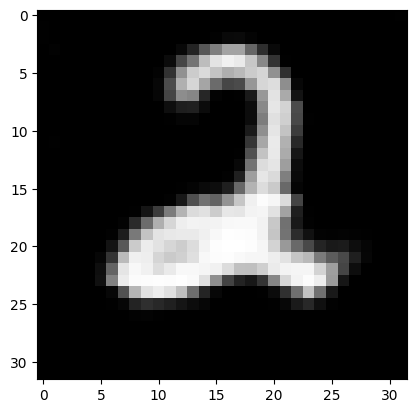

batch 400 gen loss: -7.3682732582092285, discr loss: 55.26203918457031


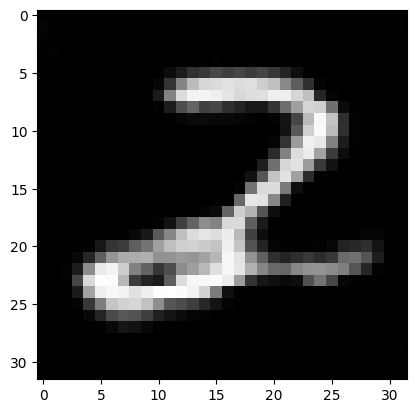

batch 500 gen loss: -7.3682732582092285, discr loss: 55.26203918457031


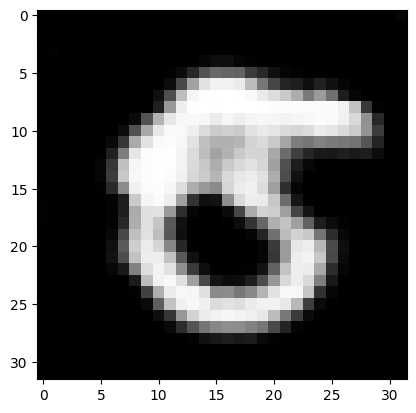

batch 600 gen loss: -3.6841366291046143, discr loss: 55.26203918457031


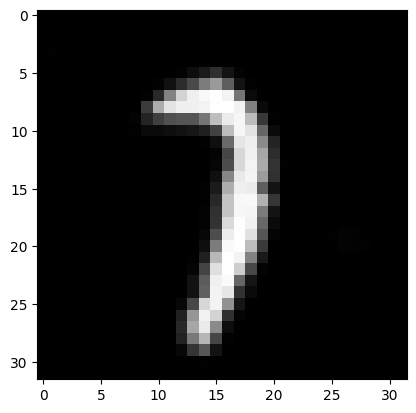

batch 700 gen loss: -3.6841366291046143, discr loss: 55.26203918457031


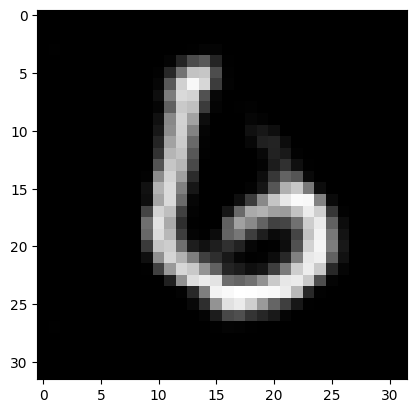

batch 800 gen loss: -3.6841366291046143, discr loss: 55.26203918457031


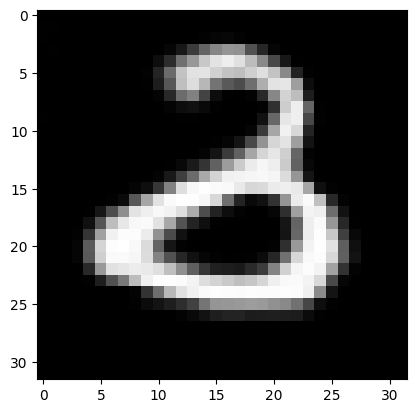

batch 900 gen loss: -3.6841366291046143, discr loss: 55.26203918457031


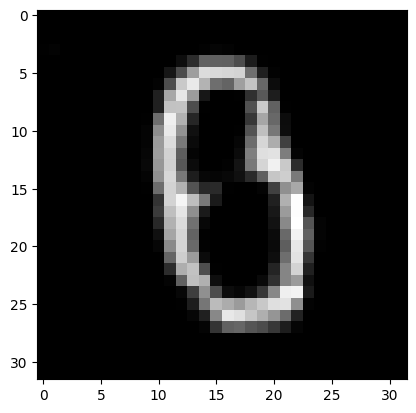

-8532.41015625 51780.2890625


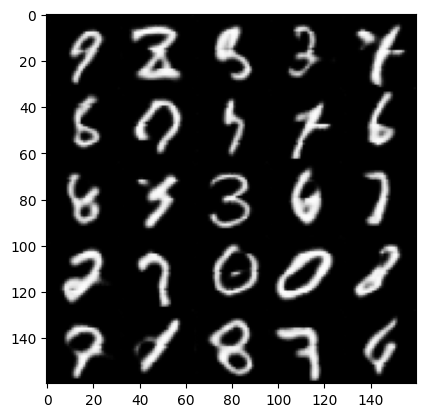

epoch 97:
batch 0 gen loss: -14.736546516418457, discr loss: 55.26203918457031


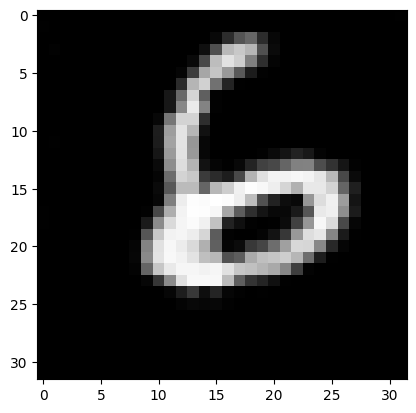

batch 100 gen loss: -18.420682907104492, discr loss: 55.26203918457031


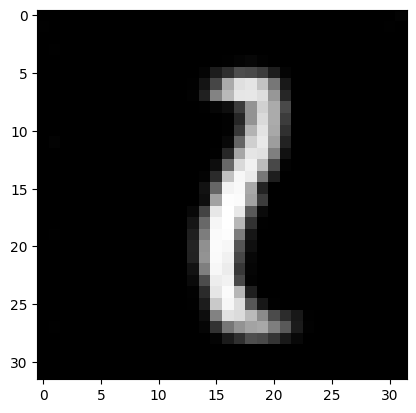

batch 200 gen loss: -14.736546516418457, discr loss: 55.26203918457031


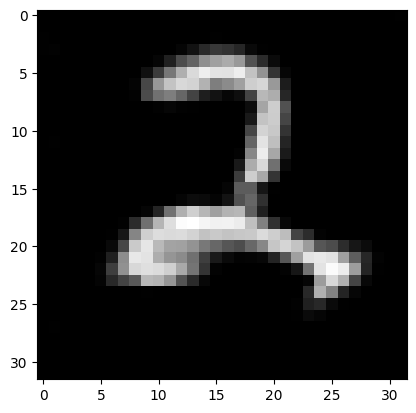

batch 300 gen loss: -7.3682732582092285, discr loss: 55.26203918457031


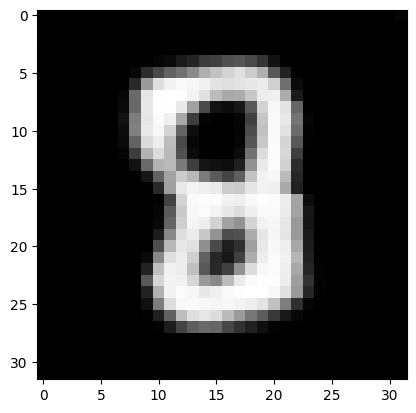

batch 400 gen loss: -11.052410125732422, discr loss: 55.26203918457031


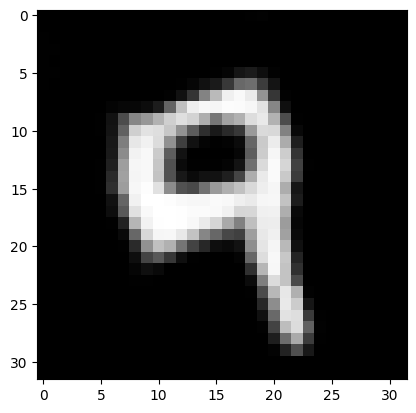

batch 500 gen loss: -3.6841366291046143, discr loss: 55.26203918457031


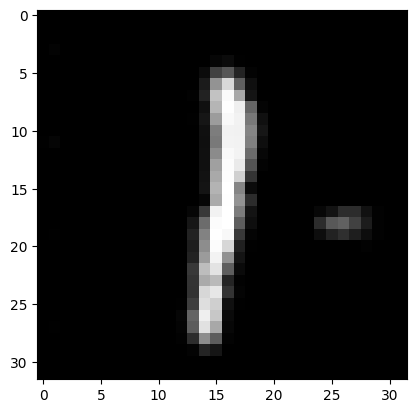

batch 600 gen loss: -3.6841366291046143, discr loss: 55.26203918457031


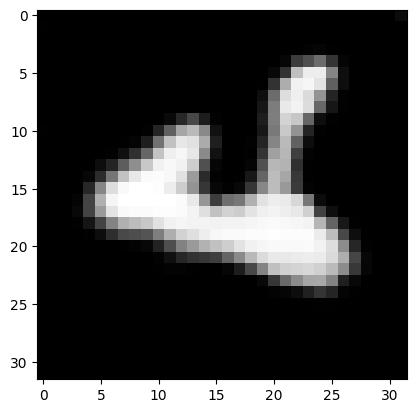

batch 700 gen loss: -11.052410125732422, discr loss: 55.26203918457031


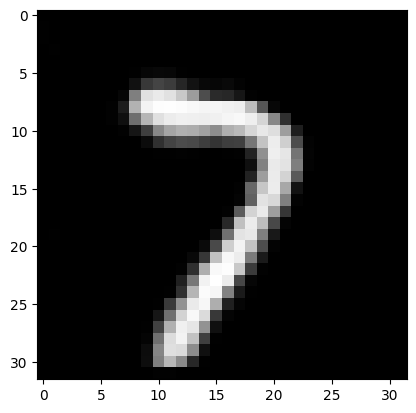

batch 800 gen loss: -14.736546516418457, discr loss: 55.26203918457031


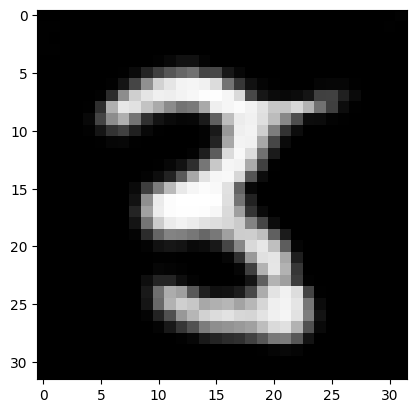

batch 900 gen loss: -11.052410125732422, discr loss: 55.26203918457031


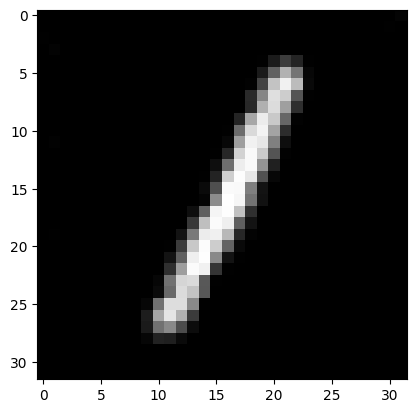

-8672.404296875 51780.2890625


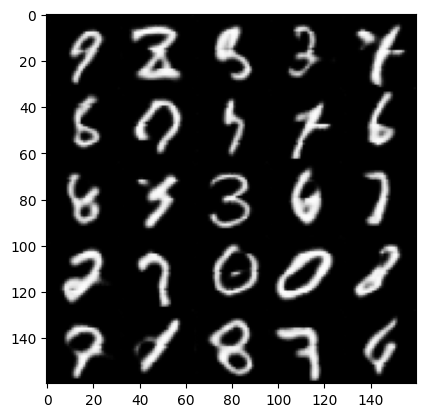

epoch 98:
batch 0 gen loss: -3.6841366291046143, discr loss: 55.26203918457031


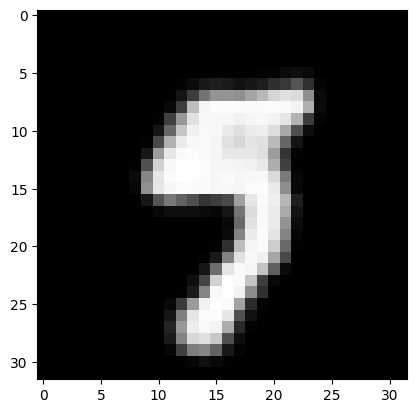

batch 100 gen loss: -11.052410125732422, discr loss: 55.26203918457031


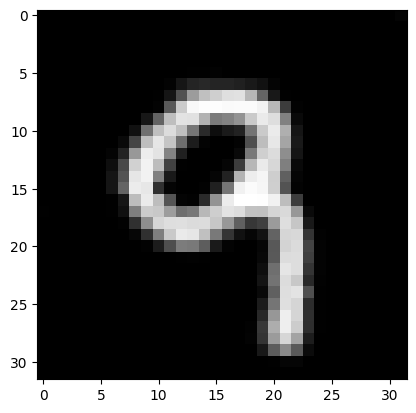

batch 200 gen loss: -14.736546516418457, discr loss: 55.26203918457031


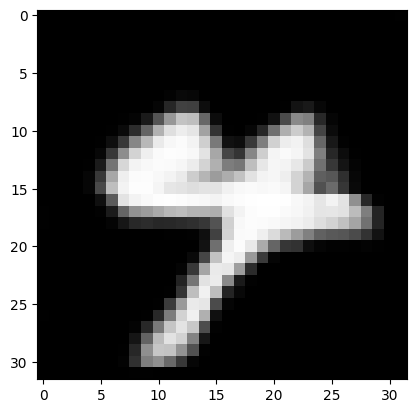

batch 300 gen loss: -7.3682732582092285, discr loss: 55.26203918457031


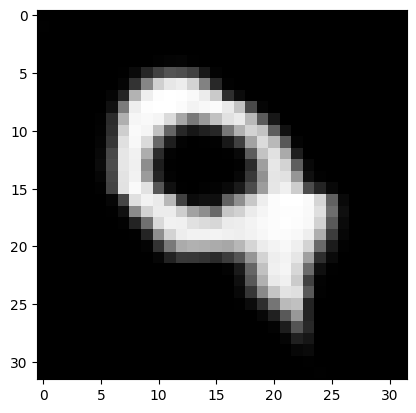

batch 400 gen loss: -3.6841366291046143, discr loss: 55.26203918457031


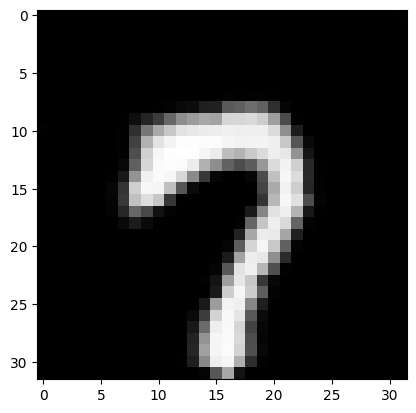

batch 500 gen loss: -3.6841366291046143, discr loss: 55.26203918457031


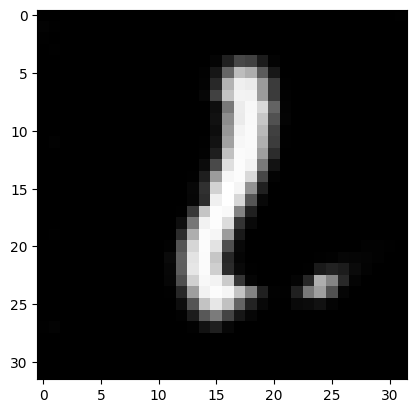

batch 600 gen loss: -11.052410125732422, discr loss: 55.26203918457031


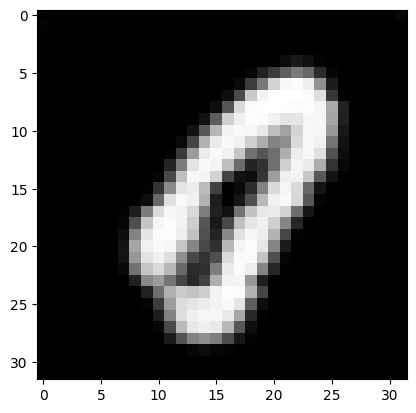

batch 700 gen loss: -11.052410125732422, discr loss: 55.26203918457031


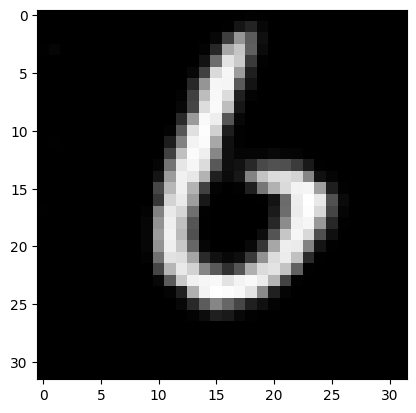

batch 800 gen loss: -7.3682732582092285, discr loss: 55.26203918457031


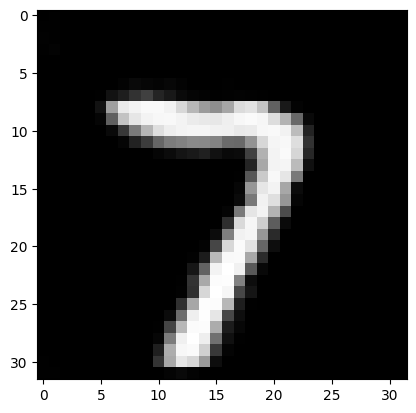

batch 900 gen loss: -11.052410125732422, discr loss: 55.26203918457031


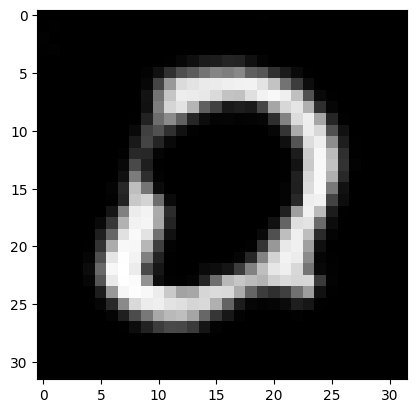

-8642.9306640625 51780.2890625


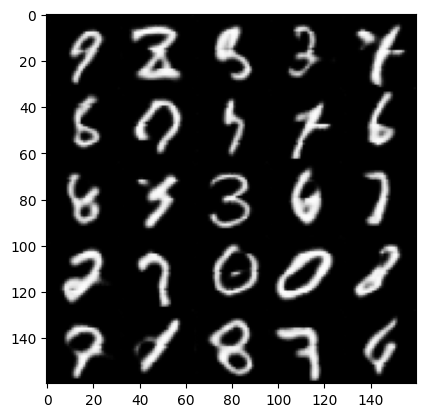

epoch 99:
batch 0 gen loss: -11.052410125732422, discr loss: 55.26203918457031


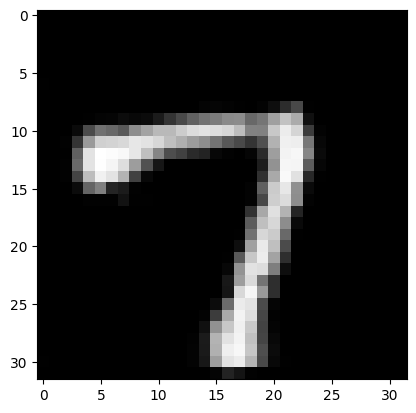

batch 100 gen loss: -11.052410125732422, discr loss: 55.26203918457031


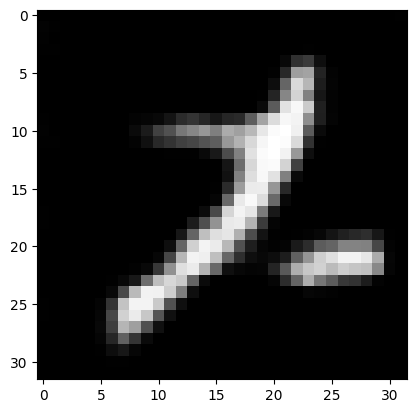

batch 200 gen loss: -11.052410125732422, discr loss: 55.26203918457031


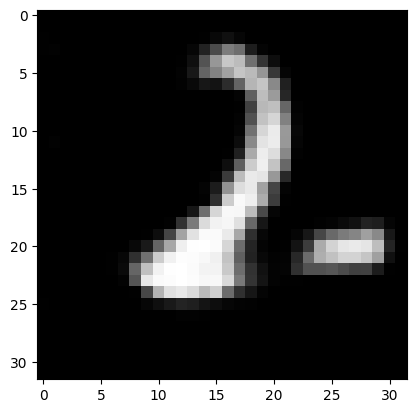

batch 300 gen loss: -11.052410125732422, discr loss: 55.26203918457031


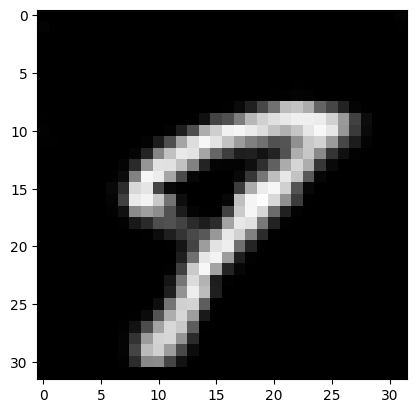

batch 400 gen loss: -11.052410125732422, discr loss: 55.26203918457031


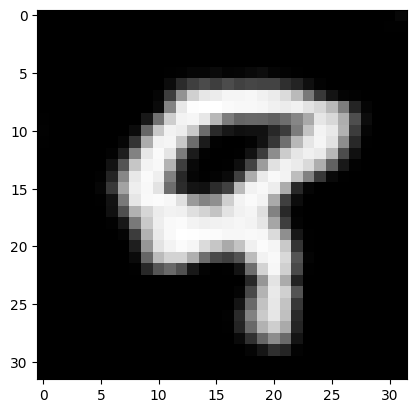

batch 500 gen loss: -14.736546516418457, discr loss: 55.26203918457031


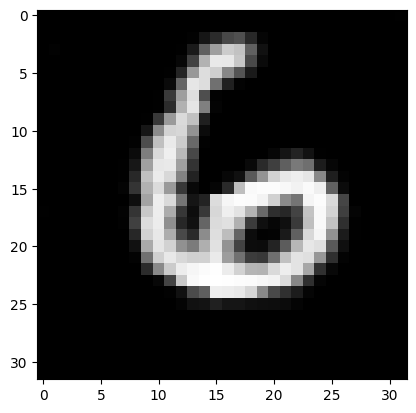

batch 600 gen loss: -7.3682732582092285, discr loss: 55.26203918457031


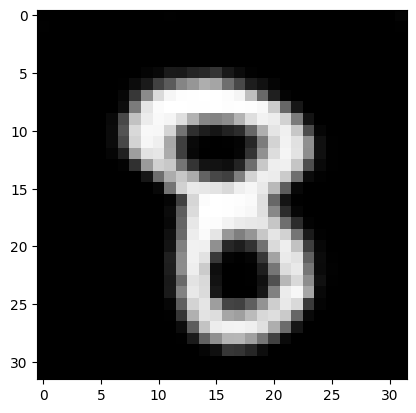

batch 700 gen loss: -7.3682732582092285, discr loss: 55.26203918457031


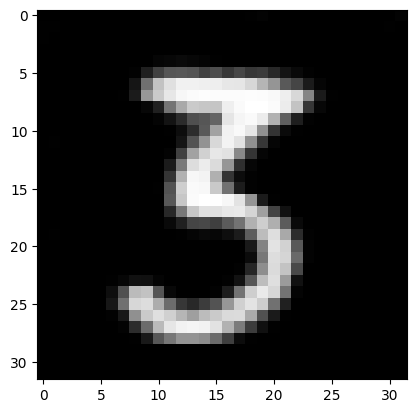

batch 800 gen loss: -11.052410125732422, discr loss: 55.26203918457031


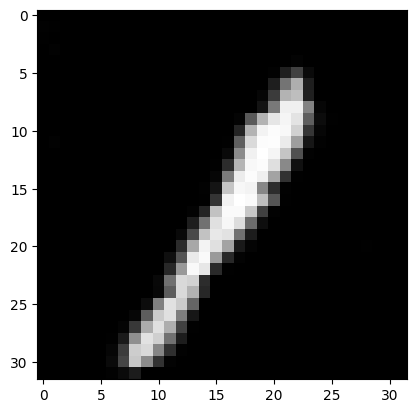

batch 900 gen loss: -14.736546516418457, discr loss: 55.26203918457031


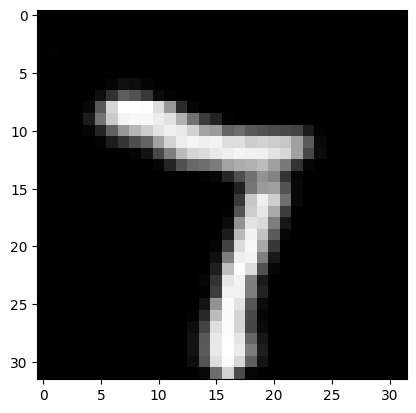

-8959.7724609375 51780.2890625


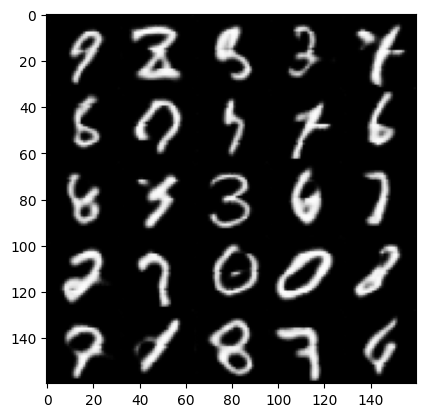

In [6]:
static_noise = torch.from_numpy(np.random.uniform(-1, 1, size=(5*5, gan.generator.input_length))).float().to("cuda")

for i in range(100):
    print(f"epoch {i}:")
    gen, discr = gan.fit(data_loader, 'cuda')

    gan_score.calc_marginal_gan(classifier, gan, z, runs, score_transform)
    gan_score.calc_posterior(classifier, gan, z, runs, score_transform)
    inception_score = gan_score.inception()
    mode_score = gan_score.mode_score()

    gen_loss, discr_loss = (gen.item(), discr.item())
    print(gen_loss, discr_loss)

    samples = gan.generator.forward(static_noise)
    grid = create_grid(samples)
    plt.imsave(f'images/e{i}.png', (grid +1) / 2)

    file.write(f'{i},{gen_loss},{discr_loss},{inception_score},{mode_score}\n')
    file.flush()
    
    plt.imshow((create_grid(samples) + 1) / 2)
    plt.show()
    
file.close()